In [1]:
%pylab inline
from ipywidgets import interact, interactive, fixed, interact_manual, FloatSlider
import ipywidgets as widgets
from pyulog import ULog
import xml.etree.ElementTree as ET
from xml.etree.ElementTree import ParseError

Populating the interactive namespace from numpy and matplotlib


In [2]:
log_data = ULog('./data/06_42_08.ulg')

In [3]:
import struct

In [4]:
f = open('./data/06_42_08.ulg','br')
data = f.read()
data[1:2000]

b'Log\x01\x125\x01,\xa8}\x05\x00\x00\x00\x00(\x00B\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x008\x00I\x0fchar[40] ver_sweda45b4df2f8f9adf2ab79f7b8e2b2180cdf7a63\x1c\x00I\x17uint32_t ver_sw_release@\x00\t\x01#\x00I\x1euint32_t ver_vendor_sw_release@\x00\x00\x00\x1a\x00I\x0fchar[10] ver_hwPX4_FMU_V5\x1b\x00I\x16char[4] ver_hw_subtypeV500\x14\x00I\x10char[3] sys_namePX4\x19\x00I\x13char[5] sys_os_nameNuttX<\x00I\x13char[40] sys_os_verc225d4a691ef4572839b19635a84f2d9bf07ea74 \x00I\x1buint32_t sys_os_ver_release\xff\x00\x16\x07\x1d\x00I\x15char[7] sys_toolchainGNU GCC[\x00I\x1achar[64] sys_toolchain_ver7.2.1 20170904 (release) [ARM/embedded-7-branch revision 255204]$\x00I\x10char[19] sys_mcuSTM32F76xxx, rev. Z6\x00I\x11char[36] sys_uuid00020000000038393738313851060033003e\x19\x00I\x14int32_t time_ref_utc\x00\x00\x00\x00\xaa\x00Fcamera_capture:uint64_t timestamp;uint64_t timesta

### ULog data structure
```
----------------------
|       Header       |
----------------------
|    Definitions     |
----------------------
|        Data        |
----------------------
```

Note: ULog file use little-endian format, which means high part of a data will be stored at low part, e.g. `0x1234567890` will be stored as
```
         | 90 | 78 | 56 | 34 | 12
Address:  Low                 High
```
In python `struct` module[3] can help to process the binary c struct data.

Below is the first 256B of the 06_42_08.ulg, which was achieved by executing `:%!xxd` in Vim. Left side is the address of data in the file. Middle is the file data content. And the right side is the ascii representation of the data. 
```vim
00000000: 554c 6f67 0112 3501 2ca8 7d05 0000 0000  ULog..5.,.}.....
00000010: 2800 4200 0000 0000 0000 0000 0000 0000  (.B.............
00000020: 0000 0000 0000 0000 0000 0000 0000 0000  ................
00000030: 0000 0000 0000 0000 0000 0038 0049 0f63  ...........8.I.c
00000040: 6861 725b 3430 5d20 7665 725f 7377 6564  har[40] ver_swed
00000050: 6134 3562 3464 6632 6638 6639 6164 6632  a45b4df2f8f9adf2
00000060: 6162 3739 6637 6238 6532 6232 3138 3063  ab79f7b8e2b2180c
00000070: 6466 3761 3633 1c00 4917 7569 6e74 3332  df7a63..I.uint32
00000080: 5f74 2076 6572 5f73 775f 7265 6c65 6173  _t ver_sw_releas
00000090: 6540 0009 0123 0049 1e75 696e 7433 325f  e@...#.I.uint32_
000000a0: 7420 7665 725f 7665 6e64 6f72 5f73 775f  t ver_vendor_sw_
000000b0: 7265 6c65 6173 6540 0000 001a 0049 0f63  release@.....I.c
000000c0: 6861 725b 3130 5d20 7665 725f 6877 5058  har[10] ver_hwPX
000000d0: 345f 464d 555f 5635 1b00 4916 6368 6172  4_FMU_V5..I.char
000000e0: 5b34 5d20 7665 725f 6877 5f73 7562 7479  [4] ver_hw_subty
000000f0: 7065 5635 3030 1400 4910 6368 6172 5b33  peV500..I.char[3
00000100: 5d20 7379 735f 6e61 6d65 5058 3419 0049  ] sys_namePX4..I
```

#### Header Section
```
----------------------------------------------------------------------
| 0x55 0x4c 0x6f 0x67 0x01 0x12 0x35 | 0x01         | uint64_t       |
| File magic (7B)                    | Version (1B) | Timestamp (8B) |
----------------------------------------------------------------------
```
In my data,
```
00000000: 554c 6f67 0112 3501 2ca8 7d05 0000 0000  ULog..5.,.}.....
```

In [5]:
# first 7B + 1B = 8B is fixed 
print(data[:8] == b'\x55\x4c\x6f\x67\x01\x12\x35\x01')
# Timestamp 8B
timestamp, = struct.unpack('<Q',data[8:16])
print('time stamp: {:d} ms'.format(timestamp))

True
time stamp: 92121132 ms


#### Definition Section

Definition section includes definitions for all the message logged in the data file, each definition of message start with 16bit `msg_size` and 8bit`msg_type` followed by special msg definition with size given in `msg_size` field. Here we create a function to parse them.

In [6]:
# define the data type map from C to struct type
# here if the length of data type is bigger than one Byte, we need add '<' to indicate 'little-endian'
dtype_map = {'int8_t':'b',
             'uint8_t':'B',
            'int16_t': '<h',
             'uint16_t': '<H',
            'int32_t': '<i',
             'uint32_t': '<I',
            'int64_t': '<q',
            'uint64_t': '<Q',
            'float': '<f',
            'double': '<d',
            'bool': '?',
            'char': 'c'}

dtype_size = {'int8_t':1,
             'uint8_t':1,
            'int16_t': 2,
             'uint16_t': 2,
            'int32_t': 4,
             'uint32_t': 4,
            'int64_t': 8,
            'uint64_t': 8,
            'float': 4,
            'double': 8,
            'bool': 1,
            'char': 1}
def unpack(ulog_dtype, data, size=1):
    dtype = dtype_map[ulog_dtype]
    dtype = dtype + dtype[-1] * (size - 1) if size > 0 else ''
    data = struct.unpack(dtype, data)
    return list(data)

def parse_message_header_s(index, data):
    msg_size = unpack('uint16_t', data[index:index+2])
    msg_type = unpack('char', data[index+2:index+3])
    message_definition_data = data[index+3:index+3+msg_size[0]]
    next_index = msg_size[0] + index
    return msg_size, msg_type[0].decode('ascii'), message_definition_data, next_index

The first message definition is always the `'B'` type. which has fixed size of 8B + 8B + 8B * 3 = 40B. The `'B'` type message was designed to indicate the compatiability of the ULog file, which is unused, and to tell the parser whether the log file is need to append to another file.

In my data,
```
00000010: 2800 4200 0000 0000 0000 0000 0000 0000  (.B.............
00000020: 0000 0000 0000 0000 0000 0000 0000 0000  ................
00000030: 0000 0000 0000 0000 0000 00
```

In [7]:
index = 16
msg_size, msg_type, msg_definition_data, index = parse_message_header_s(index, data)
print(msg_size, msg_type, msg_definition_data, index)

[40] B b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00' 56


In [8]:
def parse_msg_B(data):
    compat_flags = [unpack('uint8_t', data[i:i+1]) for i in range(8)]
    incompat_flags = [unpack('uint8_t', data[i+8:i+1+8]) for i in range(8)]
    appended_offsets = [unpack('uint64_t', data[i*8+16:i*8+24]) for i in range(3)]
    return {'compat_flags':compat_flags, 
            'incompat_flags':incompat_flags,
            'appended_offsets':appended_offsets}

parse_msg_B(msg_definition_data)

{'compat_flags': [[0], [0], [0], [0], [0], [0], [0], [0]],
 'incompat_flags': [[0], [0], [0], [0], [0], [0], [0], [0]],
 'appended_offsets': [[0], [0], [0]]}

As shown above, a function was defined to parse the `B` type msg according to the info given in the [1], which was pasted below
```
struct ulog_message_flag_bits_s {
  uint8_t compat_flags[8];
  uint8_t incompat_flags[8];
  uint64_t appended_offsets[3]; ///< file offset(s) for appended data if appending bit is set
};
```
Apparently, the `parse_msg_B` function is almost a translation of the definition. So we could define a more general function to process these definitions. `XML`, just like `json` and `yaml`, is a good format structure which balances the data description and storage, and it has been used in the PX4 project to define the mavlink message format. Similarly, `XML` is used here to describe the ULog data file. Below is the `XML` structure for the msg definitions.

In [9]:
ulog_definition = """<?xml version="1.0" encoding="ISO-8859-1"?>
<ULog global_parse='ordered'>
    <header>
        <element>
            <name>filemagic</name>
            <size>7</size>
            <!--validvalue is in hex form, while two number stardand for a byte -->
            <validvalue>554c6f67011235</validvalue>
        </element>
        <element>
            <name>version</name>
            <size>1</size>
            <validvalue>01</validvalue>
        </element>
        <element>
            <name>timestamp</name>
            <dtype>uint64_t</dtype>
            <size>1</size>
            <unit>ms</unit>
        </element>
    </header>
    <definitions parse='causal'>
        <message_header_s>
            <element>
                <name>msg_size</name>
                <dtype>uint16_t</dtype>
            </element>
            <element>
                <name>msg_type</name>
                <dtype>uint8_t</dtype>
            </element>
        </message_header_s>
        <B alias='ulog_message_flag_bits_s'>
            <include>.//message_header_s</include>
            <element>
                <name>compat_flags</name>
                <dtype>uint8_t</dtype>
                <size>8</size>
            </element>
            <element>
                <name>incompat_flags</name>
                <dtype>uint8_t</dtype>
                <size>8</size>
            </element>
            <element>
                <name>appended_offsets</name>
                <dtype>uint64_t</dtype>
                <size>3</size>
            </element>
        </B>
        <F alias='message_format_s'>
            <include>.//message_header_s</include>
            <element>
                <name>format</name>
                <size>
                    <!-- 'left' denotes whether the value is calculate by subtracting sum of other element size from msg_size -->
                    <left>1</left>
                </size>
            </element>
        </F>
        <I alias='message_info_s'>
            <include>.//message_header_s</include>
            <element>
                <name>key_len</name>
                <dtype>uint8_t</dtype>
            </element>
            <element>
                <name>key</name>
                <dtype>char</dtype>
                <size>
                    <valueof>.//I/*[name='key_len']</valueof>
                </size>
            </element>
            <element>
                <name>value</name>
                <dtype>char</dtype>
                <size>
                    <left>1</left>
                </size>
            </element>
        </I>
        <M alias='ulog_message_info_multiple_header_s'>
            <include>.//message_header_s</include>
            <element>
                <name>is_continued</name>
                <dtype>uint8_t</dtype>
            </element>
            <element>
                <name>key_len</name>
                <dtype>uint8_t</dtype>
            </element>
            <element>
                <name>key</name>
                <dtype>char</dtype>
                <size>
                    <valueof>.//M/*[name='key_len']</valueof>
                </size>
            </element>
            <element>
                <name>value</name>
                <dtype>char</dtype>
                <size>
                    <left>1</left>
                </size>
            </element>
        </M>
        <P>
            <include>.//message_header_s</include>
            <element>
                <name>key_len</name>
                <dtype>uint8_t</dtype>
            </element>
            <element>
                <name>key</name>
                <dtype>char</dtype>
                <size>
                    <valueof>.//P/*[name='key_len']</valueof>
                </size>
            </element>
            <element>
                <name>value</name>
                <dtype>
                    <valueof>.//P/*[name='key']</valueof>
                </dtype>
                <size>1</size>
            </element>
        </P>
    </definitions>
    <datasection parse='causal'>
        <A alias='message_add_logged_s'>
            <include>.//definitions/message_header_s</include>
            <element>
                <name>multi_id</name>
                <dtype>uint8_t</dtype>
            </element>
            <element>
                <name>msg_id</name>
                <dtype>uint16_t</dtype>
            </element>
            <element>
                <name>message_name</name>
                <dtype>char</dtype>
                <size>
                    <left>1</left>
                </size>
            </element>
        </A>
        <R alias='message_remove_logged_s'>
            <include>.//definitions/message_header_s</include>
            <element>
                <name>msg_id</name>
                <dtype>uint16_t</dtype>
            </element>
        </R>
        <D alias='message_data_s'>
            <include>.//definitions/message_header_s</include>
            <element>
                <name>msg_id</name>
                <dtype>uint16_t</dtype>
            </element>
            <element>
                <name>data</name>
                <dtype>uint8_t</dtype>
                <size>
                    <left>1</left>
                </size>
            </element>
        </D>
        <L alias='message_logging_s'>
            <include>.//definitions/message_header_s</include>
            <element>
                <name>log_level</name>
                <dtype>uint8_t</dtype>
            </element>
            <element>
                <name>timestamp</name>
                <dtype>uint64_t</dtype>
            </element>
            <element>
                <name>message</name>
                <dtype>char</dtype>
                <size>
                    <left>1</left>
                </size>
            </element>
        </L>
        <S alias='message_sync_s'>
            <include>.//definitions/message_header_s</include>
            <element>
                <name>sync_magic</name>
                <dtype>uint8_t</dtype>
                <size>8</size>
            </element>
        </S>
        <O alias='message_dropout_s'>
            <include>.//definitions/message_header_s</include>
            <element>
                <name>duration</name>
                <dtype>uint16_t</dtype>
            </element>
        </O>
        <include>.//definitions/I</include>
        <include>.//definitions/M</include>
        <include>.//definitions/P</include>
    </datasection>
</ULog>"""
ulog_xml_tree = ET.fromstring(ulog_definition)

In [10]:
for child in ulog_xml_tree:
    print(child.tag, child.attrib)
for element in ulog_xml_tree[1].find('message_header_s'):
    print(element.tag, element.attrib)

header {}
definitions {'parse': 'causal'}
datasection {'parse': 'causal'}
element {}
element {}


In [11]:
ulog_xml_tree.findall(".//P/*[name='key_len']")[0][0]

<Element 'name' at 0x00000225F2C73E58>

Here we start parse the structure of the xml file.

In [12]:
# import xml.etree.ElementTree as ET
from collections import OrderedDict
import pdb
class ULogUnpacker:
    def __init__(self, definition_xml, ULog_file):
        self.definition_xml = definition_xml
        self.xml_tree = ET.fromstring(definition_xml)
#         self.xml_tree = ET.parse(definition_xml)
        self._sections = ['header', 'definitions', 'datasection']
        self.check_xml_sections()
        self.ULog_file = ULog_file
        self.data = open(self.ULog_file, 'rb').read()
        # parse read place index
        self.index = 0
        self.max_index = len(self.data)
        self.ulog_data = {}
    
    def check_xml_sections(self):
        # check whether the xml include three defined sections
        section_tags = [section.tag for section in self.xml_tree]
        if section_tags != self._sections:
            raise IOError('The structure of the xml definition file is invalid for ULog file. Check the xml structure. It must include ' +
                          ','.join(self._sections[:-1] + ' and' + self._section[-1]))
    
    def _unpack_header(self):
        header_data = self._unpack_sub_section(self.xml_tree[0])
        self.ulog_data['header'] = header_data
    
    def _unpack_definitions(self):
        definitions = []
        self.ulog_data['definitions']  = definitions
        while True:
            msg_type = self._probe_message_type()
            # check whether definitions section ends and data section starts
            if msg_type in ['A','L']:
                break
            msg_definition = self.xml_tree.find('.//' + msg_type)
            definitions.append(self._unpack_sub_section(msg_definition))
            
    def _unpack_data(self):
        data = []
        self.ulog_data['data'] = data
        while True:
            msg_type = self._probe_message_type()
            msg_definition = self.xml_tree.find('.//' + msg_type)
            data.append(self._unpack_sub_section(msg_definition))
            if self.index >= self.max_index:
                break
        
            
    def unpack_ulog(self):
        self._unpack_header()
        self._unpack_definitions()
        self._unpack_data()
        # TODO: process the unpacked data to eleminate some auxiliary info and tranfer
        #      data to readable format.
        
    def _probe_message_type(self):
        message_header_s = self.xml_tree.find('.//message_header_s')
        _index = self.index
        message_header_s_data = self._unpack_sub_section(message_header_s)
        self.index = _index
        return chr(message_header_s_data['msg_type'][0])
        
    @staticmethod
    def _parse_element(element):
        straight_content = {'name', 'dtype', 'validvalue', 'unit'}
        element_structure = {}
        for item in straight_content:
            a = element.find(item)
            if a is not None:
                if a.find('valueof') is not None:
                    element_structure[item] = a.find('valueof').text
                else:
                    element_structure[item] = a.text
                
        size_item = element.find('size')
        if size_item is not None:
            if size_item.find('left') is None and size_item.find('valueof') is None:
                size = int(size_item.text)
            elif size_item.find('left') is not None:
                #depend on total size of sub_section and other siblings. 
                size = -1
            else:
                size = size_item.find('valueof').text
            element_structure['size'] = size
        else:
            element_structure['size'] = 1
        if 'dtype' not in element_structure:
            element_structure['dtype'] = 'char'
        if 'validvalue' in element_structure:
            validvalue = []
            validvalue_size = len(element_structure['validvalue'])
            for i in range(0, validvalue_size, 2):
                validvalue.extend(unpack(element_structure['dtype'], 
                                         eval("b'\\x" + element_structure['validvalue'][i:i+2] + "'")))
            if element_structure['dtype'] == 'char':
                element_structure['validvalue'] = b''.join(validvalue)
        return element_structure
    
    @staticmethod
    def _unpack_element(data, element_structure):
        unpacked_data = unpack(element_structure['dtype'], data, element_structure['size'])
        if element_structure['dtype'] == 'char':
            unpacked_data = b''.join(unpacked_data)
        return {element_structure['name']:unpacked_data}
    
    def _unpack_reference_value(self, tagtext, sub_section_content):
        tag_str = self.xml_tree.find(tagtext+"/name").text
        if tag_str in sub_section_content:
            return sub_section_content[tag_str]
    @staticmethod
    def _probe_dtype(astr):
        valid_dtype = list(dtype_size.keys())
        for dtype in valid_dtype:
            if astr[:3] in [b'uin', b'int']:
                if astr[:5].decode('ascii') == dtype[:5]:
                    return dtype
            else:
                if astr[:3].decode('ascii') == dtype[:3]:
                    return dtype
            
    def _unpack_sub_section(self, sub_section):
        print(sub_section.tag)
        sub_section_content = {}
        # size up to the end of the massage_header_s
        content_size = 0
        for element in sub_section:
            if element.tag == 'include':
                element_location = element.text
                sub_section_included = self.xml_tree.find(element_location)
                element_data = self._unpack_sub_section(sub_section_included)
                sub_section_content.update(element_data)
            else:
                element_structure = self._parse_element(element)
                # process the dtype tag
                if element_structure['dtype'] not in list(dtype_size.keys()):
                    element_structure['dtype'] = self._probe_dtype(
                                                    self._unpack_reference_value(element_structure['dtype'], 
                                                                                 sub_section_content))
                # process the size tag
                if element_structure['size'] == -1:
                    sub_section_size = sub_section_content['msg_size'][0]
#                     print(element_structure)
                    type_size = dtype_size[element_structure['dtype']]
                    element_structure['size'] = int((sub_section_size - content_size)/type_size)
                else:
                    # process the reference in size tag
                    if isinstance(element_structure['size'], str):
                        # here we simplify the process of relative reference. Since the value reference is
                        # limited in the subsection struct. it can alway be found in the sub_section_content
#                         pdb.set_trace()
                        element_structure['size'] = self._unpack_reference_value(element_structure['size'], sub_section_content)[0]
#                 pdb.set_trace()
                data_size = element_structure['size']
                type_size = dtype_size[element_structure['dtype']]
                data_section_size = data_size * type_size
                content_size += data_section_size
                element_data = self._unpack_element(self.data[self.index:self.index + data_section_size], element_structure)
                print('element_data:',element_data)
                # check whether the data value is equal to valid value
                if 'validvalue' in element_structure:
                    if element_structure['validvalue'] != list(element_data.values())[0]:
                        raise ValueError('The value in the data is invalid, the valid data is', element_structure['validvalue'])
                self.index += data_section_size
                sub_section_content.update(element_data)
        return sub_section_content

In [13]:
log_data = ULogUnpacker(ulog_definition, './data/06_42_08.ulg')
print(log_data.data[:100])
print(log_data._unpack_header())
log_data._unpack_definitions()
log_data._unpack_data()

b'ULog\x01\x125\x01,\xa8}\x05\x00\x00\x00\x00(\x00B\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x008\x00I\x0fchar[40] ver_sweda45b4df2f8f9adf2ab79'
header
element_data: {'filemagic': b'ULog\x01\x125'}
element_data: {'version': b'\x01'}
element_data: {'timestamp': [92121132]}
None
message_header_s
element_data: {'msg_size': [40]}
element_data: {'msg_type': [66]}
B
message_header_s
element_data: {'msg_size': [40]}
element_data: {'msg_type': [66]}
element_data: {'compat_flags': [0, 0, 0, 0, 0, 0, 0, 0]}
element_data: {'incompat_flags': [0, 0, 0, 0, 0, 0, 0, 0]}
element_data: {'appended_offsets': [0, 0, 0]}
message_header_s
element_data: {'msg_size': [56]}
element_data: {'msg_type': [73]}
I
message_header_s
element_data: {'msg_size': [56]}
element_data: {'msg_type': [73]}
element_data: {'key_len': [15]}
element_data: {'key': b'char[40] ver_sw'}
element_data: {'value': b'eda45b4df

element_data: {'key': b'float CAL_GYRO1_XOFF'}
element_data: {'value': [-0.001482676831074059]}
message_header_s
element_data: {'msg_size': [27]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [27]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [22]}
element_data: {'key': b'float CAL_GYRO1_XSCALE'}
element_data: {'value': [1.0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'float CAL_GYRO1_YOFF'}
element_data: {'value': [0.004048561677336693]}
message_header_s
element_data: {'msg_size': [27]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [27]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [22]}
element_data: {'key': b'float CAL_GYRO1_YSCALE'}
element_data: {'value': [1.0]}
message_header_s
element_data: {'msg_size': [25]}

element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'float COM_ARM_IMU_ACC'}
element_data: {'value': [0.699999988079071]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'float COM_ARM_IMU_GYR'}
element_data: {'value': [0.25]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [17]}
element_data: {'key': b'float COM_ARM_MAG'}
element_data: {'value': [0.15000000596046448]}
message_header_s
element_data: {'msg_size': [28]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [28]}
element_data: {'ms

element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'float EKF2_AVEL_DELAY'}
element_data: {'value': [5.0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'float EKF2_BARO_DELAY'}
element_data: {'value': [0.0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'float EKF2_BARO_GATE'}
element_data: {'value': [5.0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data:

element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'float EKF2_RNG_POS_X'}
element_data: {'value': [0.0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'float EKF2_RNG_POS_Y'}
element_data: {'value': [0.0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'float EKF2_RNG_POS_Z'}
element_data: {'value': [0.0]}
message_header_s
element_data: {'msg_size': [23]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [23]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [18]}
element_data: {'key': b'float EKF2_RNG_SFE'}
element_data: {'value': [0.05000000074505806]}
message_h

element_data: {'msg_type': [80]}
element_data: {'key_len': [22]}
element_data: {'key': b'float MC_ACRO_SUPEXPOY'}
element_data: {'value': [0.699999988079071]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [19]}
element_data: {'key': b'float MC_ACRO_Y_MAX'}
element_data: {'value': [540.0]}
message_header_s
element_data: {'msg_size': [23]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [23]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [18]}
element_data: {'key': b'int32_t MC_AIRMODE'}
element_data: {'value': [0]}
message_header_s
element_data: {'msg_size': [28]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [28]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [23]}
element_data: {'key': b'int32_t MC_BAT_SCALE_EN'}
element_data: {'value': [0]}
message_h

P
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [19]}
element_data: {'key': b'float MPC_LAND_ALT2'}
element_data: {'value': [5.0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'float MPC_LAND_SPEED'}
element_data: {'value': [0.699999988079071]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'float MPC_MANTHR_MIN'}
element_data: {'value': [0.07999999821186066]}
message_header_s
element_data: {'msg_size': [27]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [27]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [22]}
element_data: {'key'

message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'int32_t PWM_AUX_DIS5'}
element_data: {'value': [-1]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'int32_t PWM_AUX_DIS6'}
element_data: {'value': [-1]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'int32_t PWM_AUX_DIS7'}
element_data: {'value': [-1]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'int32_t PWM_AUX_DIS8'}
element

element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'int32_t PWM_MAIN_DIS3'}
element_data: {'value': [-1]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'int32_t PWM_MAIN_DIS4'}
element_data: {'value': [-1]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'int32_t PWM_MAIN_DIS5'}
element_data: {'value': [-1]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'

message_header_s
element_data: {'msg_size': [19]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [19]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [14]}
element_data: {'key': b'float RC15_MIN'}
element_data: {'value': [1000.0]}
message_header_s
element_data: {'msg_size': [19]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [19]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [14]}
element_data: {'key': b'float RC15_REV'}
element_data: {'value': [1.0]}
message_header_s
element_data: {'msg_size': [20]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [20]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [15]}
element_data: {'key': b'float RC15_TRIM'}
element_data: {'value': [1500.0]}
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [80]}
element_d

message_header_s
element_data: {'msg_size': [17]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [12]}
element_data: {'key': b'float RC9_DZ'}
element_data: {'value': [0.0]}
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [13]}
element_data: {'key': b'float RC9_MAX'}
element_data: {'value': [2000.0]}
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [13]}
element_data: {'key': b'float RC9_MIN'}
element_data: {'value': [1000.0]}
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [13]}
element_data: {'key': b'float RC9_REV'}
element_data: {'value': [1.

element_data: {'value': [0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'int32_t SYS_AUTOSTART'}
element_data: {'value': [6001]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [21]}
element_data: {'key': b'int32_t SYS_CAL_ACCEL'}
element_data: {'value': [0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
element_data: {'key_len': [20]}
element_data: {'key': b'int32_t SYS_CAL_BARO'}
element_data: {'value': [0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [80]}
P
message_header_s
element_data: {'msg_size': [25]}
ele

element_data: {'msg_size': [68]}
element_data: {'msg_type': [77]}
M
message_header_s
element_data: {'msg_size': [68]}
element_data: {'msg_type': [77]}
element_data: {'is_continued': [1]}
element_data: {'key_len': [31]}
element_data: {'key': b'char[35] perf_counter_preflight'}
element_data: {'value': b'bmi055_gyro_bad_registers: 0 events'}
message_header_s
element_data: {'msg_size': [68]}
element_data: {'msg_type': [77]}
M
message_header_s
element_data: {'msg_size': [68]}
element_data: {'msg_type': [77]}
element_data: {'is_continued': [1]}
element_data: {'key_len': [31]}
element_data: {'key': b'char[35] perf_counter_preflight'}
element_data: {'value': b'bmi055_gyro_bad_transfers: 0 events'}
message_header_s
element_data: {'msg_size': [121]}
element_data: {'msg_type': [77]}
M
message_header_s
element_data: {'msg_size': [121]}
element_data: {'msg_type': [77]}
element_data: {'is_continued': [1]}
element_data: {'key_len': [31]}
element_data: {'key': b'char[88] perf_counter_preflight'}
eleme

element_data: {'msg_type': [68]}
element_data: {'msg_id': [0]}
element_data: {'data': [63, 140, 125, 5, 0, 0, 0, 0, 47, 0, 47, 0, 15, 0, 33, 0, 15, 0, 47, 0, 0, 2, 0, 0, 13, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [18, 17, 128, 5, 0, 0, 0, 0, 147, 16, 128, 5, 0, 0, 0, 0, 26, 80, 228, 188, 198, 88, 150, 59, 131, 42, 137, 185, 10, 215, 163, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [104, 249, 127, 5, 0, 0, 0, 0, 8, 0, 0, 0, 0, 96, 134, 68, 0, 96, 134, 68, 0, 96, 134, 68, 0, 96, 134, 68, 0, 96, 134, 68, 0, 96, 134, 68, 0, 0, 0, 0, 0, 

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [72, 71, 129, 5, 0, 0, 0, 0, 80, 247, 160, 61, 52, 253, 158, 62, 162, 227, 236, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 88, 129, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 104, 129, 5, 0, 0, 0, 0, 181, 66, 79, 59, 75, 45, 26, 59, 159, 46, 80, 58, 159, 15, 0, 0, 0, 0, 0, 0, 159, 168, 54, 189, 12, 42, 151, 190, 100, 184, 28, 193, 15

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 207, 130, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 223, 130, 5, 0, 0, 0, 0, 236, 27, 93, 59, 237, 22, 233, 58, 159, 79, 22, 186, 159, 15, 0, 0, 0, 0, 0, 0, 36, 163, 130, 189, 168, 51, 154, 190, 225, 144, 28, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 223, 130, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 1

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 86, 132, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 101, 132, 5, 0, 0, 0, 0, 210, 104, 149, 58, 131, 105, 60, 59, 252, 46, 242, 57, 160, 15, 0, 0, 0, 0, 0, 0, 91, 40, 71, 189, 214, 123, 160, 190, 20, 184, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 101, 132, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 210, 255, 202, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}


element_data: {'data': [20, 174, 133, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 189, 133, 5, 0, 0, 0, 0, 67, 19, 233, 58, 50, 146, 67, 59, 20, 201, 19, 58, 159, 15, 0, 0, 0, 0, 0, 0, 160, 88, 133, 189, 30, 208, 155, 190, 88, 117, 28, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [162, 178, 133, 5, 0, 0, 0, 0, 29, 199, 232, 65, 0, 0, 250, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: 

element_data: {'data': [52, 40, 135, 5, 0, 0, 0, 0, 66, 243, 148, 59, 233, 60, 75, 59, 51, 163, 101, 58, 161, 15, 0, 0, 0, 0, 0, 0, 162, 113, 142, 189, 240, 81, 152, 190, 241, 98, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 40, 135, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 186, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [241, 55, 135, 5, 0, 0, 0, 0, 249, 67, 65, 59, 42, 179, 74, 59, 254, 183, 240, 57, 189, 15, 0, 0, 0, 0, 0, 0, 131, 239, 135, 189, 143, 186, 158, 190, 27, 174, 28, 193, 189, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'m

message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [41, 104, 136, 5, 0, 0, 0, 0, 68, 29, 230, 65, 0, 0, 250, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [184, 100, 136, 5, 0, 0, 0, 0, 176, 248, 135, 61, 52, 253, 158, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [113, 112, 136, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]

element_data: {'msg_id': [8]}
element_data: {'data': [138, 154, 137, 5, 0, 0, 0, 0, 220, 103, 150, 61, 75, 46, 163, 62, 4, 44, 49, 59, 1]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 153, 137, 5, 0, 0, 0, 0, 240, 86, 40, 59, 119, 38, 118, 57, 197, 7, 239, 60, 160, 15, 0, 0, 0, 0, 0, 0, 56, 28, 166, 60, 166, 184, 134, 190, 172, 1, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [17]}
element_data: {'data': [156, 152, 137, 5, 0, 0, 0, 0, 175, 59, 122, 5, 0, 0, 0, 0, 0, 0, 150, 68, 159, 185, 185, 62, 2, 214, 170, 60, 246, 14, 139, 63, 0, 0, 0, 0, 0, 255, 0, 0, 0, 1, 1, 1, 36]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 78, 139, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 94, 139, 5, 0, 0, 0, 0, 103, 101, 149, 188, 118, 7, 133, 187, 87, 22, 46, 60, 160, 15, 0, 0, 0, 0, 0, 0, 158, 22, 27, 191, 241, 202, 132, 191, 187, 41, 29, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 94, 139, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 206, 255, 255, 127, 255, 127]}
m

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 166, 140, 5, 0, 0, 0, 0, 212, 29, 202, 186, 66, 15, 31, 56, 5, 127, 240, 188, 159, 15, 0, 0, 0, 0, 0, 0, 76, 32, 140, 190, 24, 98, 132, 191, 72, 29, 27, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [236, 158, 140, 5, 0, 0, 0, 0, 239, 194, 228, 65, 0, 0, 250, 65, 0, 59, 197, 71, 34, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 166, 140, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
elem

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [177, 238, 141, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 192, 255, 183, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [187, 254, 141, 5, 0, 0, 0, 0, 51, 254, 141, 5, 0, 0, 0, 0, 148, 144, 15, 189, 238, 114, 73, 187, 117, 53, 177, 187, 10, 215, 163, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [76, 184, 141, 5, 0, 0, 0, 0, 8, 0, 0, 0, 0, 160, 145, 68, 0, 9

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [249, 89, 143, 5, 0, 0, 0, 0, 6, 197, 230, 65, 0, 0, 250, 65, 128, 57, 197, 71, 247, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [246, 102, 143, 5, 0, 0, 0, 0, 126, 82, 205, 187, 211, 145, 215, 60, 254, 252, 186, 60, 9, 8, 64, 63, 252, 107, 19, 60, 188, 200, 54, 188, 180, 64, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [140, 102, 143, 5, 0, 0, 0, 0, 197, 58, 60, 190, 167, 143, 3, 61, 42, 74, 77, 185, 0, 0, 0, 0, 0, 0,

element_data: {'msg_id': [14]}
element_data: {'data': [114, 11, 145, 5, 0, 0, 0, 0, 154, 132, 36, 188, 205, 187, 73, 61, 96, 117, 26, 187, 129, 15, 0, 0, 0, 0, 0, 0, 237, 120, 123, 62, 162, 180, 73, 63, 55, 49, 25, 193, 129, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 11, 145, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [253, 11, 145, 5, 0, 0, 0, 0, 114, 11, 145, 5, 0, 0, 0, 0, 35, 243, 233, 188, 145, 223, 143, 186, 157, 28, 0, 58, 10, 215, 163, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'ms

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 89, 146, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [114, 105, 146, 5, 0, 0, 0, 0, 52, 101, 70, 61, 35, 83, 225, 60, 56, 201, 65, 61, 159, 15, 0, 0, 0, 0, 0, 0, 190, 19, 164, 61, 221, 96, 239, 60, 185, 27, 21, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 105, 146, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'ms

element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [228, 193, 147, 5, 0, 0, 0, 0, 3, 200, 184, 188, 217, 202, 140, 61, 121, 48, 54, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 193, 147, 5, 0, 0, 0, 0, 176, 38, 131, 189, 177, 193, 208, 61, 186, 41, 163, 60, 160, 15, 0, 0, 0, 0, 0, 0, 115, 5, 140, 63, 132, 9, 195, 190, 182, 81, 14, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [145, 194, 147, 5, 0, 0, 0, 0, 164, 39, 136, 189, 150, 5, 203, 61, 245, 227, 160, 60, 62, 4, 64, 63, 10, 52, 19, 60, 195, 21, 52, 188, 51, 69, 41, 19

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 56, 149, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 71, 149, 5, 0, 0, 0, 0, 150, 159, 84, 189, 105, 150, 166, 61, 209, 151, 219, 59, 159, 15, 0, 0, 0, 0, 0, 0, 162, 56, 134, 191, 103, 28, 54, 63, 109, 183, 65, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 71, 149, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [228, 160, 150, 5, 0, 0, 0, 0, 130, 89, 253, 61, 200, 45, 4, 61, 73, 51, 168, 61, 79, 17, 64, 63, 156, 129, 19, 60, 213, 244, 53, 188, 58, 54, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [130, 160, 150, 5, 0, 0, 0, 0, 251, 94, 56, 190, 213, 245, 1, 61, 108, 128, 70, 185, 0, 0, 0, 0, 0, 0, 0, 0, 10, 215, 163, 189]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 159, 150, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 69, 152, 5, 0, 0, 0, 0, 31, 211, 15, 62, 186, 231, 247, 61, 73, 225, 88, 61, 159, 15, 0, 0, 0, 0, 0, 0, 111, 231, 188, 63, 241, 100, 69, 63, 42, 104, 183, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 69, 152, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [18, 85, 152, 5, 0, 0, 0, 0, 88, 78, 34, 59, 8, 66, 189, 61, 129, 89

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 125, 153, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 141, 153, 5, 0, 0, 0, 0, 42, 3, 27, 62, 124, 246, 151, 61, 67, 84, 159, 61, 159, 15, 0, 0, 0, 0, 0, 0, 84, 152, 24, 63, 174, 127, 19, 192, 173, 106, 252, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 141, 153, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 207, 255, 198, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
e

element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [191, 248, 154, 5, 0, 0, 0, 0, 17, 49, 103, 188, 218, 170, 21, 189, 3, 168, 161, 188, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 248, 154, 5, 0, 0, 0, 0, 25, 239, 65, 60, 107, 0, 44, 59, 85, 88, 200, 188, 160, 15, 0, 0, 0, 0, 0, 0, 227, 168, 244, 190, 157, 214, 134, 58, 103, 127, 38, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [91, 249, 154, 5, 0, 0, 0, 0, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 111, 156, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 126, 156, 5, 0, 0, 0, 0, 239, 185, 147, 188, 42, 241, 14, 62, 201, 221, 189, 60, 160, 15, 0, 0, 0, 0, 0, 0, 164, 197, 64, 63, 240, 49, 149, 191, 56, 231, 208, 192, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 126, 156, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 1

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 198, 157, 5, 0, 0, 0, 0, 12, 81, 67, 189, 70, 54, 3, 61, 62, 211, 135, 60, 160, 15, 0, 0, 0, 0, 0, 0, 32, 159, 78, 188, 216, 210, 178, 191, 115, 68, 229, 192, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 198, 157, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [42, 215, 157, 5, 0, 0, 0, 0, 10, 145, 248, 188, 20, 99, 192, 189, 136, 14, 52, 188, 0, 0, 0, 0, 0, 0

element_data: {'msg_size': [23]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [8]}
element_data: {'data': [163, 0, 159, 5, 0, 0, 0, 0, 220, 103, 150, 61, 75, 46, 163, 62, 4, 44, 49, 59, 1]}
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [9]}
element_data: {'data': [163, 0, 159, 5, 0, 0, 0, 0, 246, 37, 64, 63, 138, 195, 17, 60, 107, 252, 49, 188, 34, 31, 41, 191, 157, 144, 240, 61, 69, 129, 66, 60, 71, 31, 166, 188, 172, 157, 140, 192, 235, 37, 76, 192, 246, 196, 182, 190, 90, 75, 164, 55, 40, 155, 188, 55, 10, 140, 35, 54, 98, 86, 237, 56, 141, 139, 130, 185, 16, 94, 253, 56, 152, 228, 157, 62, 168, 199, 24, 189, 185, 252, 233, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 13, 239, 90, 52, 112, 145, 42, 58, 157, 253, 92, 60, 157, 88, 130, 55, 67, 21, 217, 55, 154, 123, 216, 55, 238, 211, 170, 55, 76, 224, 128,

element_data: {'msg_id': [27]}
element_data: {'data': [147, 149, 160, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 165, 160, 5, 0, 0, 0, 0, 121, 15, 204, 58, 231, 92, 19, 62, 225, 68, 59, 61, 161, 15, 0, 0, 0, 0, 0, 0, 230, 178, 148, 188, 123, 94, 248, 191, 221, 118, 14, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [110, 153, 160, 5, 0, 0, 0, 0, 52, 201, 234, 65, 133, 235, 249, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_d

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 252, 161, 5, 0, 0, 0, 0, 203, 139, 184, 188, 213, 85, 42, 190, 200, 96, 147, 188, 159, 15, 0, 0, 0, 0, 0, 0, 197, 115, 11, 191, 130, 202, 128, 191, 144, 47, 41, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [117, 250, 161, 5, 0, 0, 0, 0, 6, 197, 230, 65, 133, 235, 249, 65, 128, 57, 197, 71, 247, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [37, 247, 161, 5, 0, 0, 0, 0, 0, 120, 148, 61, 93, 123, 157, 62, 120, 122, 245, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_

element_data: {'msg_id': [24]}
element_data: {'data': [153, 86, 163, 5, 0, 0, 0, 0, 88, 56, 142, 61, 93, 123, 157, 62, 239, 10, 242, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 100, 163, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 115, 163, 5, 0, 0, 0, 0, 73, 78, 40, 190, 153, 36, 29, 62, 51, 65, 40, 188, 159, 15, 0, 0, 0, 0, 0, 0, 19, 182, 47, 62, 54, 137, 66, 63, 102, 86, 85, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
eleme

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 250, 164, 5, 0, 0, 0, 0, 94, 159, 211, 60, 70, 163, 128, 188, 127, 240, 104, 189, 161, 15, 0, 0, 0, 0, 0, 0, 21, 38, 38, 63, 136, 173, 159, 63, 69, 148, 19, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 250, 164, 5, 0, 0, 0, 0, 255, 127, 255, 127, 190, 255, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [226, 10, 165, 5, 0, 0, 0, 0, 113, 21, 218, 61, 147, 75, 38, 190, 61, 12, 99, 188, 0, 0, 0, 0, 0, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [105, 17, 166, 5, 0, 0, 0, 0, 88, 56, 142, 61, 52, 253, 158, 62, 162, 227, 236, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 35, 166, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 51, 166, 5, 0, 0, 0, 0, 230, 153, 63, 189, 145, 224, 147, 188, 247, 136, 18, 189, 162, 15, 0, 0, 0, 0, 0, 0, 46, 93, 58, 191, 49, 141, 23, 190, 99, 187, 67, 193, 162, 15, 0, 0]}
message_header_

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 173, 167, 5, 0, 0, 0, 0, 67, 129, 118, 61, 157, 103, 239, 61, 101, 159, 99, 61, 159, 15, 0, 0, 0, 0, 0, 0, 210, 238, 140, 63, 191, 4, 64, 191, 143, 164, 249, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 173, 167, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 188, 167, 5, 0, 0, 0, 0, 72, 115, 163, 60, 150, 21, 37, 62, 195, 109, 214, 60, 161, 15, 0, 0, 0, 0, 0, 0, 28, 234, 37, 62, 184, 60, 235, 191, 152

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [143, 30, 169, 5, 0, 0, 0, 0, 176, 248, 135, 61, 52, 253, 158, 62, 222, 43, 235, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 36, 169, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 51, 169, 5, 0, 0, 0, 0, 146, 111, 179, 61, 168, 245, 19, 190, 205, 39, 50, 60, 160, 15, 0, 0, 0, 0, 0, 0, 182, 186, 134, 191, 15, 32, 119, 62, 114, 80, 48, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'m

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 155, 170, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 171, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 170, 170, 5, 0, 0, 0, 0, 86, 172, 61, 60, 240, 102, 196, 60, 52, 252, 137, 60, 161, 15, 0, 0, 0, 0, 0, 0, 240, 151, 7, 63, 248, 38, 174, 191, 18, 178, 156, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [46, 170, 170, 5, 0, 0, 0, 0, 68, 29, 230, 65, 133, 235, 249, 65, 0

element_data: {'msg_id': [24]}
element_data: {'data': [241, 209, 171, 5, 0, 0, 0, 0, 168, 183, 154, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 227, 171, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 242, 171, 5, 0, 0, 0, 0, 214, 66, 88, 189, 58, 148, 206, 189, 82, 48, 11, 60, 160, 15, 0, 0, 0, 0, 0, 0, 240, 72, 68, 191, 235, 214, 103, 191, 16, 50, 41, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 27, 173, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 43, 173, 5, 0, 0, 0, 0, 252, 255, 133, 189, 231, 1, 184, 188, 143, 55, 187, 60, 159, 15, 0, 0, 0, 0, 0, 0, 128, 134, 110, 63, 121, 156, 22, 192, 228, 216, 16, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 43, 173, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]

element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [11]}
element_data: {'data': [24, 58, 174, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 227, 130, 134, 61, 48, 56, 38, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 115, 174, 5, 0, 0, 0, 0, 8, 97, 243, 61, 180, 161, 220, 188, 216, 209, 166, 61, 160, 15, 0, 0, 0, 0, 0, 0, 226, 102, 90, 63, 16, 185, 50, 191, 53, 118, 2, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'

element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [207, 157, 175, 5, 0, 0, 0, 0, 173, 180, 165, 189, 94, 163, 166, 61, 171, 55, 89, 189, 202, 24, 64, 63, 204, 188, 8, 60, 80, 208, 43, 188, 248, 46, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [94, 157, 175, 5, 0, 0, 0, 0, 237, 202, 49, 190, 250, 26, 6, 61, 86, 111, 2, 184, 0, 0, 0, 0, 0, 0, 0, 0, 89, 88, 11, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 156, 175, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 201, 255, 191, 255, 255, 127]}
message

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 244, 176, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 201, 255, 171, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 3, 177, 5, 0, 0, 0, 0, 254, 120, 53, 190, 189, 119, 203, 187, 58, 231, 71, 59, 160, 15, 0, 0, 0, 0, 0, 0, 6, 39, 180, 63, 107, 121, 119, 64, 238, 102, 85, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 3, 177, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'m

element_data: {'msg_id': [14]}
element_data: {'data': [180, 94, 178, 5, 0, 0, 0, 0, 101, 254, 1, 62, 62, 193, 155, 188, 204, 220, 41, 61, 161, 15, 0, 0, 0, 0, 0, 0, 242, 205, 208, 63, 111, 56, 100, 63, 92, 222, 17, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 94, 178, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 110, 178, 5, 0, 0, 0, 0, 134, 92, 10, 60, 157, 165, 213, 189, 60, 73, 175, 60, 160, 15, 0, 0, 0, 0, 0, 0, 196, 160, 157, 63, 219, 80, 178, 192, 169, 243, 11, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'ms

element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [190, 120, 179, 5, 0, 0, 0, 0, 64, 52, 11, 62, 9, 38, 129, 188, 219, 117, 163, 188, 97, 222, 166, 187, 143, 239, 118, 58, 45, 177, 251, 183, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [16, 120, 179, 5, 0, 0, 0, 0, 159, 167, 23, 62, 162, 89, 88, 60, 130, 128, 192, 188, 187, 15, 0, 0, 0, 0, 0, 0, 55, 137, 175, 191, 237, 173, 83, 192, 164, 145, 243, 192, 187, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [104, 121, 179, 5, 0, 0, 0, 0, 158, 32, 21, 62, 144, 18, 42, 60, 7, 76, 195, 188, 157, 26, 6

element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [61, 162, 180, 5, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 29, 56, 131, 192, 89, 197, 77, 192, 219, 120, 203, 190, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 177, 207, 247, 61, 148, 132, 150, 59, 29, 99, 224, 188, 194, 237, 248, 188, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 160, 66, 40, 192, 159, 182, 120, 192, 239, 98, 40, 64, 141, 204, 184, 191, 253, 217, 221, 66, 128, 89, 225, 61, 29, 99, 224, 60, 124, 236, 222, 62, 204, 108, 114, 62, 100, 100, 54, 62, 26, 3, 214, 61, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 1, 1, 1, 1, 2, 0, 2, 2, 1, 1, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size':

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [241, 149, 181, 5, 0, 0, 0, 0, 80, 247, 160, 61, 11, 127, 160, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [240, 154, 181, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 170, 181, 5, 0, 0, 0, 0, 224, 4, 57, 189, 197, 57, 205, 189, 238, 198, 209, 188, 132, 15, 0, 0, 0, 0, 0, 0, 29, 70, 10, 192, 171, 105, 126, 192, 54, 106, 220, 192, 132, 15, 0, 0]}
message_he

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [212, 212, 182, 5, 0, 0, 0, 0, 102, 144, 43, 62, 139, 197, 71, 190, 190, 187, 189, 61, 165, 37, 64, 63, 76, 160, 5, 60, 191, 44, 45, 188, 111, 32, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [111, 212, 182, 5, 0, 0, 0, 0, 157, 251, 41, 190, 106, 183, 228, 60, 205, 253, 159, 184, 0, 0, 0, 0, 0, 0, 0, 0, 55, 186, 59, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [112, 211, 182, 5

element_data: {'data': [240, 11, 184, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 27, 184, 5, 0, 0, 0, 0, 123, 163, 77, 62, 214, 162, 20, 190, 1, 8, 252, 61, 133, 15, 0, 0, 0, 0, 0, 0, 107, 234, 169, 192, 250, 105, 5, 65, 169, 240, 236, 188, 133, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 27, 184, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 193, 255, 183, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: 

element_data: {'msg_id': [14]}
element_data: {'data': [179, 224, 185, 5, 0, 0, 0, 0, 70, 140, 225, 189, 120, 11, 193, 61, 175, 82, 196, 188, 191, 15, 0, 0, 0, 0, 0, 0, 97, 203, 222, 64, 162, 10, 2, 193, 221, 252, 135, 193, 191, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 224, 185, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 240, 185, 5, 0, 0, 0, 0, 147, 20, 110, 62, 197, 38, 1, 190, 155, 24, 118, 189, 129, 15, 0, 0, 0, 0, 0, 0, 198, 64, 49, 64, 69, 154, 44, 192, 158, 4, 136, 192, 129, 15, 0, 0]}
message_header_s
element_data: {'ms

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [47, 25, 187, 5, 0, 0, 0, 0, 74, 125, 10, 62, 23, 2, 118, 189, 107, 191, 74, 60, 188, 15, 0, 0, 0, 0, 0, 0, 168, 97, 162, 192, 3, 73, 29, 65, 76, 181, 112, 191, 188, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [38, 16, 187, 5, 0, 0, 0, 0, 245, 112, 235, 65, 10, 215, 249, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [88, 12, 187, 5, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
elemen

message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [66, 111, 188, 5, 0, 0, 0, 0, 29, 199, 232, 65, 10, 215, 249, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [166, 113, 188, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 53, 151, 65, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [77, 114, 188, 5,

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 184, 189, 5, 0, 0, 0, 0, 20, 42, 81, 189, 7, 227, 132, 189, 235, 72, 224, 189, 161, 15, 0, 0, 0, 0, 0, 0, 67, 39, 87, 64, 155, 35, 219, 190, 211, 53, 40, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 184, 189, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 181, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 200, 189, 5, 0, 0, 0, 0, 127, 83, 31, 62, 177, 191, 63, 189, 34, 135, 86, 189, 160, 15, 0, 0, 0, 0, 0, 0, 201, 110, 209, 192, 97, 198, 174, 64, 84, 176, 206, 192, 160, 15, 0, 0]}
m

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [163, 241, 190, 5, 0, 0, 0, 0, 32, 30, 236, 65, 10, 215, 249, 65, 128, 53, 197, 71, 218, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 247, 190, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [102, 248, 190, 5, 0, 0, 0, 0, 109, 57, 12, 190, 238, 173, 198, 61, 67, 103, 163, 61, 161, 200, 60, 188, 5, 192, 16, 59, 126, 47, 45, 185, 40, 173, 2, 32]}
message_header_s
eleme

element_data: {'data': [147, 157, 192, 5, 0, 0, 0, 0, 243, 102, 36, 187, 103, 47, 133, 62, 73, 166, 174, 61, 160, 15, 0, 0, 0, 0, 0, 0, 237, 70, 220, 64, 238, 129, 214, 192, 208, 33, 71, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 157, 192, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 167, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 173, 192, 5, 0, 0, 0, 0, 140, 187, 151, 188, 203, 170, 215, 61, 5, 70, 17, 190, 162, 15, 0, 0, 0, 0, 0, 0, 6, 145, 137, 64, 166, 91, 203, 192, 187, 101, 131, 192, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 120, 193, 5, 0, 0, 0, 0, 85, 111, 56, 190, 16, 178, 233, 61, 50, 125, 201, 189, 111, 15, 0, 0, 0, 0, 0, 0, 153, 9, 149, 64, 170, 229, 246, 192, 57, 241, 146, 193, 111, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 120, 193, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 135, 193, 5, 0, 0, 0, 0, 138, 46, 226, 62, 140, 9, 61, 190, 84, 41, 151, 189, 160, 15, 0, 0, 0, 0, 0, 0, 155, 111, 10, 64, 27, 218, 147, 191, 77,

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 176, 194, 5, 0, 0, 0, 0, 173, 242, 90, 190, 42, 210, 171, 189, 101, 87, 87, 62, 161, 15, 0, 0, 0, 0, 0, 0, 102, 251, 166, 192, 123, 169, 31, 64, 253, 80, 246, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [82, 166, 194, 5, 0, 0, 0, 0, 9, 28, 234, 65, 143, 194, 249, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [6, 163, 194, 5, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 205, 76, 228, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 139, 195, 5, 0, 0, 0, 0, 58, 92, 186, 190, 176, 21, 149, 62, 18, 18, 162, 187, 160, 15, 0, 0, 0, 0, 0, 0, 224, 60, 151, 63, 252, 159, 46, 64, 252, 35, 75, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [65, 121, 195, 5, 0, 0, 0, 0, 125, 155, 197, 119, 145, 135, 5, 0, 60, 219, 214, 23, 78, 222, 85, 69, 234, 125, 1, 0, 182, 91, 1, 0, 158, 239, 167, 62, 249, 58, 62, 63, 230, 208, 130, 63, 214, 120, 49, 64, 163, 112, 125, 63, 194, 245, 200, 63, 93, 0, 0, 0, 2, 0, 0, 0, 150, 67, 139, 60, 150, 67, 139, 188, 0, 0, 0, 0, 66, 96, 101, 189, 130, 8, 138, 63, 0, 0, 0, 0, 0, 0, 192, 127, 0, 0, 0, 0, 3, 1, 14]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_t

element_data: {'data': [180, 86, 196, 5, 0, 0, 0, 0, 53, 25, 144, 190, 48, 32, 222, 61, 195, 68, 135, 61, 161, 15, 0, 0, 0, 0, 0, 0, 63, 52, 131, 192, 139, 132, 87, 64, 125, 208, 135, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 86, 196, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 102, 196, 5, 0, 0, 0, 0, 159, 159, 39, 189, 173, 250, 68, 62, 30, 209, 80, 61, 160, 15, 0, 0, 0, 0, 0, 0, 49, 29, 232, 64, 166, 148, 23, 193, 24, 175, 125, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'ms

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 33, 197, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [114, 49, 197, 5, 0, 0, 0, 0, 230, 70, 20, 188, 6, 117, 161, 61, 51, 53, 132, 61, 159, 15, 0, 0, 0, 0, 0, 0, 151, 96, 112, 64, 141, 243, 28, 193, 63, 165, 33, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 49, 197, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 181, 255, 169, 255, 255, 127]}
message_header_s
element_data: {'msg_

element_data: {'msg_id': [27]}
element_data: {'data': [147, 252, 197, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 12, 198, 5, 0, 0, 0, 0, 47, 179, 76, 189, 76, 195, 22, 62, 11, 202, 235, 189, 160, 15, 0, 0, 0, 0, 0, 0, 168, 101, 190, 64, 208, 209, 6, 193, 5, 78, 122, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 12, 198, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 184, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'ms

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [18, 234, 198, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 181, 255, 169, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 249, 198, 5, 0, 0, 0, 0, 42, 16, 189, 188, 4, 185, 235, 59, 152, 236, 2, 62, 161, 15, 0, 0, 0, 0, 0, 0, 170, 89, 174, 192, 80, 219, 5, 65, 96, 24, 76, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 249, 198, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
mes

element_data: {'msg_id': [14]}
element_data: {'data': [182, 168, 199, 5, 0, 0, 0, 0, 155, 34, 209, 59, 125, 170, 185, 61, 77, 107, 202, 189, 160, 15, 0, 0, 0, 0, 0, 0, 72, 54, 146, 64, 153, 186, 151, 192, 70, 45, 12, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [43, 170, 199, 5, 0, 0, 0, 0, 201, 128, 127, 59, 245, 225, 179, 61, 105, 35, 203, 189, 237, 67, 64, 63, 178, 84, 5, 60, 207, 74, 42, 188, 53, 254, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [180, 169, 199, 5, 0, 0, 0, 0, 140, 158, 44, 190, 198, 236, 10, 61, 113, 9, 200, 18

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 68, 200, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 68, 200, 5, 0, 0, 0, 0, 70, 226, 189, 62, 129, 193, 5, 190, 224, 77, 2, 190, 161, 15, 0, 0, 0, 0, 0, 0, 201, 39, 72, 192, 128, 72, 52, 64, 192, 171, 95, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 84, 200, 5, 0, 0, 0, 0, 161, 44, 145, 190, 183, 63, 109, 190, 208, 154, 75, 62, 159, 15, 0, 0, 0, 0, 0, 0, 55, 172, 90, 192, 246, 255, 229, 64, 119, 179, 241, 192, 159, 15, 0, 0]}
me

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [210, 234, 201, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 172, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 250, 201, 5, 0, 0, 0, 0, 101, 255, 71, 190, 248, 97, 243, 186, 71, 234, 104, 61, 162, 15, 0, 0, 0, 0, 0, 0, 66, 145, 148, 192, 186, 240, 4, 63, 213, 2, 101, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [213, 249, 201, 5, 0, 0, 0, 0, 52, 201, 234, 65, 10, 215, 249, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 19, 203, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 35, 203, 5, 0, 0, 0, 0, 6, 25, 181, 189, 175, 24, 215, 61, 33, 229, 141, 189, 160, 15, 0, 0, 0, 0, 0, 0, 78, 101, 146, 64, 193, 74, 58, 193, 131, 87, 129, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 35, 203, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
me

element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [33, 211, 204, 5, 0, 0, 0, 0, 80, 247, 160, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 216, 204, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 232, 204, 5, 0, 0, 0, 0, 236, 194, 84, 190, 199, 185, 9, 190, 124, 132, 11, 62, 159, 15, 0, 0, 0, 0, 0, 0, 23, 73, 163, 192, 178, 35, 3, 190, 222, 59, 48, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 210, 205, 5, 0, 0, 0, 0, 197, 239, 43, 60, 213, 184, 146, 189, 74, 12, 141, 188, 161, 15, 0, 0, 0, 0, 0, 0, 211, 70, 160, 64, 154, 166, 252, 192, 83, 109, 121, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 210, 205, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [36, 227, 205, 5, 0, 0, 0, 0, 224, 182, 82, 62, 134, 188, 13, 190, 44, 10, 193, 189, 130, 93, 1

element_data: {'data': [148, 42, 207, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 58, 207, 5, 0, 0, 0, 0, 179, 40, 64, 62, 38, 104, 36, 190, 140, 224, 158, 189, 159, 15, 0, 0, 0, 0, 0, 0, 58, 101, 159, 62, 243, 96, 22, 63, 187, 229, 29, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [140, 46, 207, 5, 0, 0, 0, 0, 52, 201, 234, 65, 143, 194, 249, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_dat

element_data: {'msg_id': [27]}
element_data: {'data': [242, 70, 208, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 194, 255, 185, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [156, 71, 208, 5, 0, 0, 0, 0, 168, 226, 196, 190, 53, 102, 72, 62, 52, 50, 239, 189, 25, 242, 174, 188, 100, 75, 137, 59, 234, 234, 106, 186, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [76, 72, 208, 5, 0, 0, 0, 0, 165, 5, 198, 190, 146, 78, 43, 62, 160, 137, 53, 190, 101, 65, 64, 63, 56, 59, 0, 60, 84, 204, 36, 188, 172, 1, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_heade

element_data: {'data': [50, 221, 209, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 236, 209, 5, 0, 0, 0, 0, 10, 75, 206, 62, 212, 216, 106, 189, 63, 78, 217, 189, 161, 15, 0, 0, 0, 0, 0, 0, 113, 80, 51, 192, 225, 15, 232, 62, 152, 64, 230, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [120, 231, 209, 5, 0, 0, 0, 0, 52, 201, 234, 65, 143, 194, 249, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 199, 210, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 215, 210, 5, 0, 0, 0, 0, 119, 182, 89, 190, 82, 168, 174, 61, 7, 155, 170, 61, 161, 15, 0, 0, 0, 0, 0, 0, 117, 129, 99, 192, 77, 65, 237, 190, 252, 225, 92, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 215, 210, 5, 0, 0, 0, 0, 255, 127, 255, 127,

element_data: {'data': [24, 31, 212, 5, 0, 0, 0, 0, 205, 218, 161, 64, 153, 209, 83, 64, 1, 0, 1, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [166, 23, 212, 5, 0, 0, 0, 0, 3, 110, 227, 65, 143, 194, 249, 65, 0, 60, 197, 71, 234, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 31, 212, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [51, 32, 212, 5, 0, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 87, 213, 5, 0, 0, 0, 0, 123, 151, 225, 189, 227, 152, 177, 60, 91, 18, 46, 190, 190, 15, 0, 0, 0, 0, 0, 0, 47, 48, 134, 64, 69, 11, 92, 191, 92, 134, 68, 193, 190, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [17, 76, 213, 5, 0, 0, 0, 0, 12, 115, 237, 65, 143, 194, 249, 65, 128, 52, 197, 71, 19, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [48, 71, 213, 5, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_

element_data: {'msg_id': [25]}
element_data: {'data': [104, 145, 214, 5, 0, 0, 0, 0, 176, 31, 54, 190, 98, 226, 64, 61, 10, 6, 190, 187, 0, 0, 0, 0, 0, 0, 0, 0, 213, 161, 72, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [113, 144, 214, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 159, 214, 5, 0, 0, 0, 0, 58, 233, 186, 190, 147, 245, 217, 61, 180, 76, 187, 189, 131, 15, 0, 0, 0, 0, 0, 0, 35, 248, 213, 64, 239, 20, 21, 193, 100, 122, 172, 193, 131, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
m

element_data: {'data': [115, 216, 215, 5, 0, 0, 0, 0, 186, 212, 27, 190, 98, 12, 140, 190, 212, 138, 31, 61, 131, 15, 0, 0, 0, 0, 0, 0, 133, 209, 207, 192, 145, 46, 150, 64, 187, 166, 90, 193, 131, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 216, 215, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 232, 215, 5, 0, 0, 0, 0, 50, 47, 233, 60, 112, 157, 77, 62, 147, 0, 161, 61, 161, 15, 0, 0, 0, 0, 0, 0, 41, 250, 181, 64, 107, 162, 91, 193, 1, 26, 92, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'m

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 48, 217, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [210, 63, 217, 5, 0, 0, 0, 0, 163, 148, 93, 190, 11, 130, 111, 189, 31, 117, 181, 186, 159, 15, 0, 0, 0, 0, 0, 0, 191, 34, 134, 64, 201, 38, 57, 193, 182, 18, 139, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [210, 63, 217, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]

element_data: {'data': [180, 104, 218, 5, 0, 0, 0, 0, 202, 2, 205, 62, 53, 185, 155, 57, 49, 230, 196, 189, 160, 15, 0, 0, 0, 0, 0, 0, 10, 184, 191, 192, 160, 174, 75, 64, 180, 184, 15, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [216, 95, 218, 5, 0, 0, 0, 0, 26, 112, 229, 65, 143, 194, 249, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [34, 106, 218, 5, 0, 0, 0, 0, 210, 190, 203, 62, 43, 186, 38, 187, 24, 162, 197, 189, 49, 61, 64, 63, 105, 56, 8, 60, 4, 232, 53, 188, 248, 4, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_heade

element_data: {'data': [181, 198, 219, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [2, 215, 219, 5, 0, 0, 0, 0, 22, 90, 92, 190, 219, 61, 132, 61, 72, 0, 64, 61, 194, 216, 227, 188, 172, 80, 185, 59, 98, 9, 169, 186, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [82, 214, 219, 5, 0, 0, 0, 0, 44, 38, 237, 189, 57, 87, 110, 62, 52, 8, 50, 60, 157, 15, 0, 0, 0, 0, 0, 0, 129, 49, 141, 63, 167, 82, 193, 63, 177, 81, 202, 192, 157, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s


element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 223, 220, 5, 0, 0, 0, 0, 241, 240, 159, 190, 223, 56, 132, 62, 154, 200, 58, 187, 160, 15, 0, 0, 0, 0, 0, 0, 167, 239, 254, 191, 140, 144, 164, 191, 195, 215, 114, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 223, 220, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 167, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [158, 239, 220, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 227, 222, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 243, 222, 5, 0, 0, 0, 0, 48, 57, 163, 190, 137, 58, 139, 190, 23, 67, 167, 61, 160, 15, 0, 0, 0, 0, 0, 0, 219, 119, 76, 192, 161, 215, 108, 64, 144, 99, 118, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [159, 232, 222, 5, 0, 0, 0, 0, 26, 112, 229, 65, 143, 194, 249, 6

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 59, 224, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 74, 224, 5, 0, 0, 0, 0, 153, 246, 52, 190, 50, 169, 107, 62, 151, 87, 244, 188, 159, 15, 0, 0, 0, 0, 0, 0, 30, 192, 6, 191, 12, 206, 181, 190, 190, 69, 250, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [242, 74, 224, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 12

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [114, 0, 226, 5, 0, 0, 0, 0, 120, 76, 254, 59, 2, 30, 219, 189, 0, 150, 152, 189, 159, 15, 0, 0, 0, 0, 0, 0, 34, 252, 181, 63, 221, 37, 2, 191, 89, 141, 182, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [150, 244, 225, 5, 0, 0, 0, 0, 68, 29, 230, 65, 20, 174, 249, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [211, 233, 225, 5, 0, 0, 0, 0, 254, 31, 228, 119, 145, 135, 5, 0, 98, 219, 214, 23, 86, 222, 85, 69, 1, 123, 1, 0, 205, 88, 1, 0, 105, 145, 173, 62, 246, 65, 62, 63, 93, 143, 130, 63, 101

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [0, 27, 227, 5, 0, 0, 0, 0, 172, 189, 181, 61, 92, 217, 109, 61, 80, 2, 0, 60, 248, 120, 201, 190, 128, 17, 167, 188, 0, 160, 14, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 162, 74, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 16, 51, 136, 62, 239, 50, 136, 62, 176, 211, 18, 63, 254, 99, 145, 63, 244, 99, 145, 63, 169, 205, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 174, 156, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 241, 19, 52, 57, 108, 87, 4, 60, 124, 130, 223, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [9]}
element_data: {'data': [0, 27, 227

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [80, 7, 228, 5, 0, 0, 0, 0, 245, 112, 235, 65, 20, 174, 249, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 22, 228, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 38, 228, 5, 0, 0, 0, 0, 81, 199, 188, 62, 56, 151, 234, 61, 135, 246, 160, 60, 161, 15, 0, 0, 0, 0, 0, 0, 84, 130, 193, 192, 60, 37, 54, 65, 134, 29, 108, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
ele

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 141, 229, 5, 0, 0, 0, 0, 132, 18, 135, 190, 111, 190, 136, 62, 203, 24, 207, 186, 159, 15, 0, 0, 0, 0, 0, 0, 214, 100, 50, 64, 238, 5, 250, 191, 75, 116, 35, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [81, 131, 229, 5, 0, 0, 0, 0, 245, 112, 235, 65, 143, 194, 249, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [3, 128, 229, 5, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data:

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 198, 230, 5, 0, 0, 0, 0, 249, 241, 24, 63, 34, 39, 200, 189, 236, 241, 160, 60, 160, 15, 0, 0, 0, 0, 0, 0, 149, 109, 226, 192, 172, 142, 46, 65, 239, 229, 17, 63, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 198, 230, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 213, 230, 5, 0, 0, 0, 0, 163, 104, 99, 190, 223, 204, 205, 189, 116, 228, 162, 61, 160, 15, 0, 0, 0, 0, 0, 0, 189, 233, 177, 192, 130, 8, 46, 63,

element_data: {'data': [115, 139, 232, 5, 0, 0, 0, 0, 201, 48, 152, 62, 133, 56, 35, 62, 57, 153, 230, 189, 158, 15, 0, 0, 0, 0, 0, 0, 120, 0, 172, 63, 81, 70, 192, 192, 217, 174, 157, 192, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 139, 232, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 155, 232, 5, 0, 0, 0, 0, 153, 27, 41, 62, 103, 15, 247, 189, 185, 73, 213, 189, 161, 15, 0, 0, 0, 0, 0, 0, 63, 91, 97, 192, 8, 23, 100, 65, 219, 113, 99, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'ms

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [167, 196, 233, 5, 0, 0, 0, 0, 60, 144, 131, 190, 53, 173, 46, 62, 75, 180, 130, 61, 65, 148, 16, 189, 14, 137, 242, 59, 17, 96, 241, 186, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 195, 233, 5, 0, 0, 0, 0, 27, 45, 81, 190, 210, 249, 76, 62, 83, 112, 171, 61, 161, 15, 0, 0, 0, 0, 0, 0, 147, 210, 214, 64, 220, 145, 164, 192, 217, 182, 40, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [96, 197, 233, 5, 0, 0, 0, 0, 205, 180, 83,

message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [238, 166, 234, 5, 0, 0, 0, 0, 8, 0, 0, 0, 0, 224, 155, 68, 0, 192, 155, 68, 0, 0, 155, 68, 0, 160, 156, 68, 0, 96, 158, 68, 0, 64, 153, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [179, 218, 234, 5, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_siz

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 52, 236, 5, 0, 0, 0, 0, 5, 150, 185, 60, 65, 145, 125, 61, 246, 209, 238, 189, 160, 15, 0, 0, 0, 0, 0, 0, 249, 56, 157, 64, 188, 30, 85, 64, 34, 253, 25, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [72, 54, 236, 5, 0, 0, 0, 0, 112, 88, 165, 60, 232, 220, 113, 61, 227, 147, 239, 189, 239, 67, 64, 63, 100, 241, 239, 59, 52, 213, 46, 188, 134, 254, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 109, 237, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 125, 237, 5, 0, 0, 0, 0, 169, 190, 16, 190, 46, 95, 65, 62, 129, 189, 33, 190, 161, 15, 0, 0, 0, 0, 0, 0, 114, 132, 249, 64, 104, 205, 16, 193, 144, 67, 147, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [185, 123, 237, 5, 0, 0, 0, 0, 242, 25, 232, 65, 143, 194, 249, 6

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 244, 238, 5, 0, 0, 0, 0, 251, 34, 5, 189, 90, 123, 172, 59, 177, 219, 193, 61, 160, 15, 0, 0, 0, 0, 0, 0, 85, 0, 145, 190, 108, 79, 70, 64, 254, 3, 57, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 244, 238, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 193, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 3, 239, 5, 0, 0, 0, 0, 146, 111, 29, 190, 104, 143, 182, 189, 171, 250, 147, 60, 160, 15, 0, 0, 0, 0, 0, 0, 199, 157, 163, 64, 33, 2

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [18, 32, 240, 5, 0, 0, 0, 0, 174, 187, 203, 62, 183, 138, 227, 61, 241, 242, 92, 189, 158, 15, 0, 0, 0, 0, 0, 0, 154, 0, 234, 63, 110, 122, 45, 191, 85, 34, 236, 192, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [18, 32, 240, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 210, 255, 201, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 47, 240, 5, 0, 0, 0, 0, 221, 56, 124, 62, 126, 26, 177, 189, 109, 74, 131, 187, 161, 15, 0, 0, 0, 0, 0, 0, 144, 245, 153, 192, 143, 48, 39, 65, 236, 52, 126, 64, 161, 15, 0, 0]}
me

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 10, 241, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [156, 26, 241, 5, 0, 0, 0, 0, 20, 26, 241, 5, 0, 0, 0, 0, 162, 219, 13, 189, 119, 127, 98, 59, 20, 168, 134, 188, 253, 171, 74, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [99, 196, 240, 5, 0, 0, 0, 0, 8, 0, 0, 0, 0, 128, 157, 68, 0, 96, 154, 68, 0, 32, 152, 68, 0, 160, 1

message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [54, 161, 242, 5, 0, 0, 0, 0, 180, 160, 242, 5, 0, 0, 0, 0, 35, 216, 207, 189, 126, 152, 78, 61, 242, 215, 226, 187, 166, 30, 74, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [230, 121, 242, 5, 0, 0, 0, 0, 8, 0, 0, 0, 0, 64, 165, 68, 0, 96, 146, 68, 0, 160, 153, 68, 0, 0, 158, 68, 0, 0, 159, 68, 0, 192, 152, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_d

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 232, 243, 5, 0, 0, 0, 0, 205, 20, 60, 60, 27, 244, 25, 190, 95, 44, 90, 61, 160, 15, 0, 0, 0, 0, 0, 0, 107, 217, 112, 192, 14, 19, 88, 64, 22, 1, 3, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 232, 243, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 248, 243, 5, 0, 0, 0, 0, 67, 40, 144, 190, 24, 175, 65, 189, 240, 1

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [33, 81, 245, 5, 0, 0, 0, 0, 3, 121, 42, 190, 199, 168, 46, 61, 6, 112, 235, 187, 0, 0, 0, 0, 0, 0, 0, 0, 196, 177, 74, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 80, 245, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 95, 245, 5, 0, 0, 0, 0, 133, 182, 17, 63, 220, 23, 112, 190, 75, 6, 170, 189, 160, 15, 0, 0, 0, 0, 0, 0, 227, 99, 174, 

element_data: {'msg_id': [14]}
element_data: {'data': [179, 136, 246, 5, 0, 0, 0, 0, 134, 11, 203, 190, 33, 151, 45, 62, 239, 124, 248, 188, 158, 15, 0, 0, 0, 0, 0, 0, 90, 115, 41, 64, 162, 123, 72, 190, 248, 217, 46, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 136, 246, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 210, 255, 201, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 152, 246, 5, 0, 0, 0, 0, 28, 153, 240, 190, 138, 120, 145, 61, 241, 49, 118, 189, 160, 15, 0, 0, 0, 0, 0, 0, 254, 120, 149, 64, 247, 243, 26, 193, 92, 46, 181, 193, 160, 15, 0, 0]}
message_header_s
element_data

element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [26]}
element_data: {'data': [130, 6, 248, 5, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [82, 15, 248, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 30, 248, 5, 0, 0, 0, 0, 175, 1, 160, 190, 171, 112, 42, 61, 24, 166, 184, 61, 162, 15, 0, 0, 0, 0, 0, 0, 55, 9, 100, 64, 105, 141, 

message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [59, 169, 249, 5, 0, 0, 0, 0, 239, 194, 228, 65, 143, 194, 249, 65, 0, 59, 197, 71, 34, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 181, 249, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [210, 196, 249, 5, 0, 0, 0, 0, 148, 110, 54, 62, 47, 144, 202, 60, 123, 2, 129, 189, 158, 15, 0, 0, 0, 0, 0, 0, 54, 12, 75, 191, 133, 197, 184, 191, 62, 247, 32, 192, 158, 15, 0, 0]}
message_header_s
element_data: {

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 253, 250, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [246, 12, 251, 5, 0, 0, 0, 0, 153, 34, 151, 190, 8, 252, 109, 62, 22, 186, 34, 190, 162, 15, 0, 0, 0, 0, 0, 0, 145, 186, 139, 64, 104, 181, 49, 192, 104, 8, 78, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [151, 0, 251, 5, 0, 0, 0, 0, 9, 28, 234, 65, 143, 1

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 44, 252, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [25, 60, 252, 5, 0, 0, 0, 0, 129, 115, 23, 190, 46, 119, 104, 190, 134, 73, 171, 61, 165, 15, 0, 0, 0, 0, 0, 0, 175, 31, 122, 192, 117, 69, 228, 63, 55, 149, 10, 193, 165, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [84, 55, 252, 5, 0, 0, 0, 0, 9, 28, 234, 65, 20, 174, 249, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
mes

element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [200, 139, 253, 5, 0, 0, 0, 0, 80, 247, 160, 61, 52, 253, 158, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 147, 253, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 163, 253, 5, 0, 0, 0, 0, 16, 83, 135, 190, 140, 193, 74, 62, 43, 132, 37, 190, 159, 15, 0, 0, 0, 0, 0, 0, 64, 13, 69, 64, 253, 7, 234, 192, 226, 157, 75, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 251, 254, 5, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 204, 255, 195, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [110, 252, 254, 5, 0, 0, 0, 0, 139, 100, 102, 143, 114, 255, 67, 64, 125, 144, 214, 159, 213, 20, 93, 64, 85, 229, 222, 66, 97, 130, 194, 66, 0, 0, 0, 128, 56, 240, 156, 61, 26, 191, 20, 61, 103, 245, 129, 189, 71, 170, 184, 191, 120, 24, 151, 63, 53, 252, 58, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: 

element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [234, 99, 0, 6, 0, 0, 0, 0, 52, 120, 142, 60, 230, 144, 250, 61, 253, 56, 132, 60, 101, 67, 64, 63, 164, 80, 244, 59, 160, 109, 43, 188, 68, 255, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [127, 99, 0, 6, 0, 0, 0, 0, 137, 14, 38, 190, 14, 18, 41, 61, 126, 94, 154, 187, 0, 0, 0, 0, 0, 0, 0, 0, 146, 22, 74, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 201, 1, 6, 0, 0, 0, 0, 77, 6, 155, 190, 129, 204, 14, 62, 198, 172, 224, 189, 161, 15, 0, 0, 0, 0, 0, 0, 212, 38, 160, 64, 71, 6, 17, 191, 50, 72, 10, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [74, 199, 1, 6, 0, 0, 0, 0, 216, 192, 226, 65, 143, 194, 249, 65, 128, 60, 197, 71, 77, 149, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [108, 203, 1, 6, 0, 0, 0, 0, 137, 73, 156, 190, 35, 218, 11, 62, 42, 121, 225, 189, 26, 46, 64, 63, 243

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [119, 76, 3, 6, 0, 0, 0, 0, 242, 25, 232, 65, 143, 194, 249, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [164, 68, 3, 6, 0, 0, 0, 0, 80, 247, 160, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 80, 3, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'m

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [126, 171, 4, 6, 0, 0, 0, 0, 160, 177, 20, 190, 151, 56, 168, 189, 126, 18, 44, 189, 172, 15, 0, 0, 0, 0, 0, 0, 252, 109, 215, 63, 101, 117, 232, 63, 46, 131, 249, 192, 172, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [48, 164, 4, 6, 0, 0, 0, 0, 49, 114, 231, 65, 143, 194, 249, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [217, 172, 4, 6, 0, 0, 0, 0, 138, 54, 23, 190, 106, 31, 174, 189, 255, 173, 45, 189, 133, 45, 64, 63, 3, 16, 212, 59, 255, 119, 32, 188, 123, 25, 41, 

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 50, 6, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [178, 65, 6, 6, 0, 0, 0, 0, 160, 210, 40, 62, 196, 25, 213, 189, 151, 8, 181, 189, 159, 15, 0, 0, 0, 0, 0, 0, 99, 136, 206, 192, 81, 117, 7, 65, 199, 174, 143, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [178, 65, 6, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [210, 137, 7, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 188, 255, 168, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [42, 154, 7, 6, 0, 0, 0, 0, 64, 17, 130, 62, 213, 132, 207, 186, 51, 117, 44, 62, 36, 170, 80, 189, 76, 188, 60, 60, 239, 198, 49, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 153, 7, 6, 0, 0, 0, 0, 179, 36, 139, 62, 94, 28, 211, 189, 0, 201, 131, 62, 162, 15, 0, 0, 0

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 85, 8, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 100, 8, 6, 0, 0, 0, 0, 5, 125, 123, 61, 227, 43, 166, 190, 157, 189, 205, 61, 129, 15, 0, 0, 0, 0, 0, 0, 234, 90, 27, 192, 74, 92, 172, 64, 9, 54, 163, 192, 129, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 100, 8, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_d

element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [66, 127, 9, 6, 0, 0, 0, 0, 230, 138, 159, 189, 181, 235, 15, 190, 116, 194, 116, 61, 81, 57, 64, 63, 111, 210, 216, 59, 155, 242, 45, 188, 40, 11, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [155, 118, 9, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [195, 126, 9, 6, 0, 0, 0, 0, 2

element_data: {'data': [231, 225, 10, 6, 0, 0, 0, 0, 3, 110, 227, 65, 20, 174, 249, 65, 0, 60, 197, 71, 234, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [29, 222, 10, 6, 0, 0, 0, 0, 80, 247, 160, 61, 11, 127, 160, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 229, 10, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [139, 245, 10, 6, 0, 0, 0, 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 170, 12, 6, 0, 0, 0, 0, 178, 49, 26, 187, 59, 70, 12, 61, 154, 57, 51, 190, 159, 15, 0, 0, 0, 0, 0, 0, 121, 120, 78, 64, 88, 244, 125, 192, 177, 29, 1, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [204, 156, 12, 6, 0, 0, 0, 0, 68, 29, 230, 65, 20, 174, 249, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [247, 151, 12, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
elem

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 242, 13, 6, 0, 0, 0, 0, 28, 170, 39, 191, 137, 187, 188, 187, 71, 115, 8, 190, 159, 15, 0, 0, 0, 0, 0, 0, 162, 10, 181, 64, 76, 99, 10, 193, 168, 47, 171, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 242, 13, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 2, 14, 6, 0, 0, 0, 0, 205, 170, 222, 61, 106, 231, 34, 61, 135,

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [145, 82, 15, 6, 0, 0, 0, 0, 80, 247, 160, 61, 11, 127, 160, 62, 205, 76, 228, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [222, 89, 15, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 105, 15, 6, 0, 0, 0, 0, 104, 4, 163, 190, 211, 135, 242, 61, 59, 41, 77, 188, 150, 15, 0, 0, 0, 0, 0, 0, 36, 11, 235, 63, 43, 33, 204, 192, 125, 202, 86, 193, 15

element_data: {'data': [20, 165, 16, 6, 0, 0, 0, 0, 162, 89, 105, 62, 186, 21, 254, 189, 54, 181, 42, 62, 159, 15, 0, 0, 0, 0, 0, 0, 35, 30, 124, 192, 34, 219, 162, 64, 168, 231, 169, 63, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 165, 16, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [102, 181, 16, 6, 0, 0, 0, 0, 96, 4, 127, 61, 87, 139, 9, 190, 181, 73, 99, 61, 129, 98, 99, 189, 248, 246, 81, 60, 1, 74, 62, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
e

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 237, 17, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 252, 17, 6, 0, 0, 0, 0, 35, 44, 145, 190, 178, 167, 95, 190, 177, 65, 180, 60, 158, 15, 0, 0, 0, 0, 0, 0, 165, 109, 185, 64, 120, 109, 76, 193, 202, 172, 158, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 252, 17, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}

element_data: {'data': [73, 161, 19, 6, 0, 0, 0, 0, 242, 25, 232, 65, 20, 174, 249, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 162, 19, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 178, 19, 6, 0, 0, 0, 0, 131, 202, 197, 62, 14, 106, 43, 190, 198, 230, 25, 62, 159, 15, 0, 0, 0, 0, 0, 0, 214, 229, 168, 190, 67, 238, 44, 64, 213, 179, 9, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [40, 1, 21, 6, 0, 0, 0, 0, 6, 197, 230, 65, 20, 174, 249, 65, 128, 57, 197, 71, 247, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [146, 11, 21, 6, 0, 0, 0, 0, 206, 237, 181, 191, 68, 245, 40, 191, 238, 25, 79, 190, 54, 43, 64, 63, 29, 130, 169, 59, 52, 3, 50, 188, 194, 27, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [14, 11, 21, 6, 0, 0, 0, 0, 53, 13, 57, 190, 91, 85, 54, 61, 255, 182, 135, 187, 0, 0, 0, 0, 0, 0, 0, 0, 8, 228, 74, 190]}
message_header

element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [190, 129, 22, 6, 0, 0, 0, 0, 188, 131, 198, 191, 21, 179, 156, 61, 132, 152, 85, 190, 6, 85, 102, 189, 160, 105, 82, 60, 148, 50, 59, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 129, 22, 6, 0, 0, 0, 0, 154, 43, 153, 191, 221, 37, 8, 63, 73, 29, 245, 189, 161, 15, 0, 0, 0, 0, 0, 0, 241, 35, 221, 192, 7, 44, 198, 65, 106, 103, 8, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [113, 130, 22, 6, 0, 0, 0, 0, 67, 124, 153, 191, 209, 103, 7, 63, 149, 241, 245, 189, 204, 33, 64, 63, 65, 25, 175, 59, 240, 153, 20, 

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 201, 23, 6, 0, 0, 0, 0, 252, 251, 149, 63, 121, 144, 37, 191, 53, 134, 172, 189, 160, 15, 0, 0, 0, 0, 0, 0, 117, 233, 185, 64, 55, 253, 187, 193, 115, 59, 226, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [246, 191, 23, 6, 0, 0, 0, 0, 68, 29, 230, 65, 20, 174, 249, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 201, 23, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {

element_data: {'data': [180, 1, 25, 6, 0, 0, 0, 0, 93, 157, 244, 191, 43, 203, 57, 191, 8, 55, 130, 190, 161, 15, 0, 0, 0, 0, 0, 0, 53, 125, 19, 63, 141, 24, 255, 63, 31, 94, 42, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [86, 247, 24, 6, 0, 0, 0, 0, 3, 110, 227, 65, 20, 174, 249, 65, 0, 60, 197, 71, 234, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [5, 244, 24, 6, 0, 0, 0, 0, 80, 247, 160, 61, 52, 253, 158, 62, 205, 76, 228, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
eleme

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 89, 26, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 105, 26, 6, 0, 0, 0, 0, 246, 173, 234, 191, 21, 210, 247, 62, 192, 78, 104, 60, 161, 15, 0, 0, 0, 0, 0, 0, 250, 91, 243, 192, 76, 105, 232, 65, 96, 127, 46, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 105, 26, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127,

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 130, 27, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 145, 27, 6, 0, 0, 0, 0, 226, 8, 171, 63, 244, 79, 105, 63, 228, 174, 173, 62, 159, 15, 0, 0, 0, 0, 0, 0, 44, 203, 2, 193, 132, 60, 218, 64, 105, 149, 57, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 145, 27, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
eleme

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 111, 28, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 194, 255, 185, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 127, 28, 6, 0, 0, 0, 0, 253, 141, 38, 64, 209, 23, 138, 61, 164, 187, 55, 62, 160, 15, 0, 0, 0, 0, 0, 0, 147, 198, 131, 64, 67, 31, 165, 193, 220, 159, 248, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 127, 28, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
e

element_data: {'msg_id': [27]}
element_data: {'data': [21, 137, 29, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 152, 29, 6, 0, 0, 0, 0, 171, 85, 40, 64, 165, 45, 186, 62, 14, 75, 104, 62, 158, 15, 0, 0, 0, 0, 0, 0, 177, 164, 67, 63, 227, 7, 120, 193, 60, 92, 228, 65, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 152, 29, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_s

message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [73, 163, 30, 6, 0, 0, 0, 0, 125, 154, 24, 190, 201, 194, 81, 61, 161, 113, 126, 57, 0, 0, 0, 0, 0, 0, 0, 0, 218, 59, 116, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 162, 30, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 195, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 177, 30, 6, 0, 0, 0, 0, 202, 54, 34, 64, 161, 76, 98, 62, 26, 136, 74, 62, 160, 15, 0, 0, 0, 0, 0, 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 87, 32, 6, 0, 0, 0, 0, 0, 166, 7, 64, 101, 161, 228, 190, 191, 238, 244, 61, 160, 15, 0, 0, 0, 0, 0, 0, 254, 127, 246, 63, 246, 200, 207, 193, 160, 90, 67, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 87, 32, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [118, 103, 32, 6, 0, 0, 0, 0, 139, 235, 8, 192, 10, 235, 85, 189, 210, 149, 173, 190, 162, 15, 0, 0, 0, 0, 0, 0, 190, 229, 144, 64, 197, 154, 255, 64, 110, 62, 34, 194, 162, 15, 0, 0]}
me

element_data: {'data': [117, 97, 33, 6, 0, 0, 0, 0, 233, 81, 8, 192, 4, 181, 200, 62, 124, 84, 60, 190, 161, 15, 0, 0, 0, 0, 0, 0, 191, 135, 56, 64, 1, 161, 154, 65, 235, 152, 4, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 97, 33, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 113, 33, 6, 0, 0, 0, 0, 217, 151, 151, 63, 40, 194, 210, 61, 184, 253, 137, 62, 158, 15, 0, 0, 0, 0, 0, 0, 222, 167, 54, 192, 102, 29, 123, 64, 152, 80, 235, 64, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_typ

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 185, 34, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 200, 34, 6, 0, 0, 0, 0, 160, 142, 136, 63, 243, 94, 155, 62, 146, 101, 166, 62, 159, 15, 0, 0, 0, 0, 0, 0, 110, 165, 157, 192, 62, 45, 133, 190, 149, 91, 253, 64, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 200, 34, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 1

D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [46, 243, 35, 6, 0, 0, 0, 0, 92, 51, 22, 63, 95, 72, 33, 63, 6, 221, 124, 62, 136, 67, 64, 63, 10, 114, 185, 59, 5, 102, 12, 188, 18, 2, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [210, 242, 35, 6, 0, 0, 0, 0, 191, 106, 232, 189, 26, 225, 82, 61, 107, 86, 243, 186, 0, 0, 0, 0, 0, 0, 0, 0, 195, 87, 134, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [224, 241, 35, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 25

element_data: {'data': [52, 42, 37, 6, 0, 0, 0, 0, 133, 40, 10, 64, 241, 235, 117, 61, 5, 116, 57, 62, 159, 15, 0, 0, 0, 0, 0, 0, 199, 145, 46, 192, 14, 49, 150, 193, 82, 140, 133, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 42, 37, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 57, 37, 6, 0, 0, 0, 0, 37, 138, 92, 191, 187, 37, 15, 191, 76, 155, 144, 190, 160, 15, 0, 0, 0, 0, 0, 0, 172, 57, 180, 64, 51, 63, 240, 192, 123, 103, 237, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_typ

element_data: {'msg_id': [27]}
element_data: {'data': [180, 223, 38, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 239, 38, 6, 0, 0, 0, 0, 197, 183, 55, 63, 72, 244, 214, 190, 39, 111, 236, 189, 160, 15, 0, 0, 0, 0, 0, 0, 142, 243, 77, 64, 133, 71, 145, 193, 194, 231, 121, 63, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [35, 229, 38, 6, 0, 0, 0, 0, 222, 110, 233, 65, 20, 174, 249, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_dat

element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [5]}
element_data: {'data': [187, 31, 40, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 63, 0, 0, 128, 63, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [26, 46, 40, 6, 0, 0, 0, 0, 209, 231, 206, 191, 162, 216, 219, 62, 81, 57, 92, 61, 166, 15, 0, 0, 0, 0, 0, 0, 76, 114, 241, 61, 204, 48, 151, 65, 173, 244, 166, 193, 166, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size'

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 149, 41, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 165, 41, 6, 0, 0, 0, 0, 146, 38, 128, 190, 75, 64, 173, 190, 22, 105, 49, 190, 159, 15, 0, 0, 0, 0, 0, 0, 162, 153, 128, 64, 217, 159, 23, 193, 53, 28, 62, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 165, 41, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 175, 255, 255, 127]}
m

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [119, 232, 42, 6, 0, 0, 0, 0, 52, 201, 234, 65, 20, 174, 249, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [41, 229, 42, 6, 0, 0, 0, 0, 0, 120, 148, 61, 52, 253, 158, 62, 205, 76, 228, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 237, 42, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_head

element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [6, 148, 44, 6, 0, 0, 0, 0, 215, 108, 25, 190, 141, 139, 55, 61, 41, 53, 32, 188, 0, 0, 0, 0, 0, 0, 0, 0, 124, 136, 134, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 147, 44, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 162, 44, 6, 0, 0, 0, 0, 6, 141, 2, 192, 94, 227, 147, 189, 138, 132, 236, 189, 160, 15, 0, 0, 0, 0, 0, 0, 43, 179, 193, 191, 86, 16, 151, 65, 107, 10, 35, 194, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_da

message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [108, 11, 46, 6, 0, 0, 0, 0, 185, 30, 181, 191, 142, 187, 144, 62, 89, 56, 30, 188, 45, 84, 64, 63, 235, 129, 95, 59, 181, 169, 4, 188, 137, 240, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [6, 11, 46, 6, 0, 0, 0, 0, 248, 250, 14, 190, 158, 192, 105, 61, 24, 231, 227, 187, 0, 0, 0, 0, 0, 0, 0, 0, 77, 128, 134, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 10, 46, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127,

element_data: {'data': [43, 12, 47, 6, 0, 0, 0, 0, 8, 0, 0, 0, 0, 224, 178, 68, 0, 0, 147, 68, 0, 0, 155, 68, 0, 224, 170, 68, 0, 192, 181, 68, 0, 32, 144, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [183, 11, 47, 6, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [238, 4, 47, 6, 0, 0, 

element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [200, 239, 47, 6, 0, 0, 0, 0, 198, 208, 155, 191, 115, 70, 173, 190, 110, 245, 134, 190, 5, 78, 64, 63, 84, 99, 136, 59, 66, 243, 33, 188, 168, 245, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [102, 239, 47, 6, 0, 0, 0, 0, 54, 228, 32, 190, 197, 23, 85, 61, 60, 131, 22, 188, 0, 0, 0, 0, 0, 0, 0, 0, 86, 226, 134, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_da

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 188, 48, 6, 0, 0, 0, 0, 45, 22, 240, 191, 240, 2, 94, 190, 232, 153, 105, 190, 147, 15, 0, 0, 0, 0, 0, 0, 76, 79, 100, 64, 197, 110, 42, 65, 6, 86, 15, 194, 147, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 188, 48, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 206, 255, 197, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [82, 204, 48, 6, 0, 0, 0, 0, 68, 128, 102, 62, 155, 129, 13, 63, 207, 234, 116, 62, 159, 15, 0, 0, 0, 0, 0, 0, 90, 46, 194, 192, 133, 233, 55, 65, 220, 137,

D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [51, 169, 49, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 182, 49, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 198, 49, 6, 0, 0, 0, 0, 23, 144, 62, 62, 47, 108, 11, 63, 222, 69, 49, 62, 160, 15, 0, 0, 0, 0, 0, 0, 23, 165, 186, 192, 171, 255, 54, 65, 220, 7, 210, 192, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
ele

element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [48, 100, 50, 6, 0, 0, 0, 0, 115, 162, 183, 63, 241, 24, 97, 62, 96, 193, 102, 62, 97, 99, 64, 63, 208, 87, 189, 59, 30, 24, 38, 188, 74, 220, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [192, 99, 50, 6, 0, 0, 0, 0, 192, 67, 217, 189, 242, 85, 97, 61, 234, 254, 207, 187, 0, 0, 0, 0, 0, 0, 0, 0, 53, 133, 134, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [160, 98, 50, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 206, 255, 197, 255, 255, 127]}
message_h

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 186, 51, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 201, 255, 190, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [171, 202, 51, 6, 0, 0, 0, 0, 23, 207, 186, 63, 251, 89, 26, 62, 248, 209, 24, 62, 182, 215, 97, 189, 41, 40, 97, 60, 38, 125, 68, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 201, 51, 6, 0, 0, 0, 0, 210, 121, 206, 63, 92, 78, 158, 189, 159, 74, 176, 61, 159, 15, 0, 0, 0, 0, 0, 0, 179, 20, 93, 62, 13

element_data: {'data': [181, 33, 53, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 195, 255, 186, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 49, 53, 6, 0, 0, 0, 0, 223, 244, 140, 62, 40, 176, 26, 191, 30, 20, 7, 190, 159, 15, 0, 0, 0, 0, 0, 0, 153, 119, 170, 64, 17, 92, 133, 193, 2, 136, 142, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 49, 53, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 121, 54, 6, 0, 0, 0, 0, 41, 49, 51, 63, 212, 146, 3, 63, 14, 132, 57, 62, 162, 15, 0, 0, 0, 0, 0, 0, 6, 11, 186, 192, 26, 166, 226, 64, 71, 113, 31, 191, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [167, 114, 54, 6, 0, 0, 0, 0, 3, 110, 227, 65, 20, 174, 249, 65, 0, 60, 197, 71, 234, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [54, 111, 54, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type'

D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [83, 32, 56, 6, 0, 0, 0, 0, 45, 27, 20, 190, 201, 234, 83, 61, 86, 183, 21, 188, 0, 0, 0, 0, 0, 0, 0, 0, 164, 106, 134, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 31, 56, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 46, 56, 6, 0, 0, 0, 0, 52, 246, 234, 191, 235, 225, 77, 62, 137, 189, 194, 188, 157, 15, 0, 0, 0, 0, 0, 0, 212, 13, 58, 191, 23, 15, 139, 65, 86, 227, 235, 193, 157, 15, 0, 0]}
message_h

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [208, 155, 57, 6, 0, 0, 0, 0, 0, 120, 148, 61, 52, 253, 158, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [254, 165, 57, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [10]}
element_data: {'data': [175, 155, 57, 6, 0, 0, 0, 0, 175, 155, 57, 6, 0, 0, 0, 0, 18, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222, 5, 217, 5, 239, 4, 217, 5, 41, 4, 141, 7, 141, 7, 141, 7, 4

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 75, 59, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [128, 91, 59, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [128, 91, 59, 6, 0, 0, 0, 0, 14, 92, 172, 63, 81, 24, 225, 62, 7, 27, 128, 62, 173, 15, 0, 0, 0, 0, 0, 0, 222, 187, 103, 192, 154, 37, 207, 191, 230, 253, 113, 65, 173, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
mess

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 213, 60, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 198, 255, 189, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 229, 60, 6, 0, 0, 0, 0, 223, 220, 147, 62, 245, 187, 216, 62, 123, 219, 117, 62, 159, 15, 0, 0, 0, 0, 0, 0, 171, 190, 88, 192, 134, 108, 216, 64, 27, 131, 130, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 229, 60, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 14, 62, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 29, 62, 6, 0, 0, 0, 0, 209, 224, 233, 63, 121, 155, 202, 61, 136, 60, 2, 62, 160, 15, 0, 0, 0, 0, 0, 0, 253, 243, 168, 191, 225, 137, 131, 193, 237, 35, 126, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [196, 26, 62, 6, 0, 0, 0, 0, 242, 25, 232, 65, 20, 174, 249, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [150, 87, 63, 6, 0, 0, 0, 0, 234, 188, 178, 190, 208, 187, 188, 190, 187, 255, 53, 190, 97, 103, 64, 63, 22, 185, 147, 59, 116, 223, 52, 188, 108, 215, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [47, 87, 63, 6, 0, 0, 0, 0, 138, 79, 23, 190, 64, 13, 116, 61, 195, 116, 61, 188, 0, 0, 0, 0, 0, 0, 0, 0, 195, 76, 134, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 86, 63, 6, 0,

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 173, 64, 6, 0, 0, 0, 0, 211, 68, 78, 63, 104, 255, 181, 190, 195, 19, 179, 189, 159, 15, 0, 0, 0, 0, 0, 0, 146, 109, 228, 64, 39, 169, 170, 193, 213, 238, 144, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [59, 165, 64, 6, 0, 0, 0, 0, 29, 199, 232, 65, 20, 174, 249, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 173, 64, 6, 0, 0, 0, 0, 255, 127, 255,

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [85, 146, 66, 6, 0, 0, 0, 0, 47, 194, 106, 60, 182, 110, 11, 63, 241, 60, 123, 62, 161, 15, 0, 0, 0, 0, 0, 0, 188, 225, 59, 192, 79, 247, 30, 65, 1, 58, 232, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 146, 66, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 208, 255, 199, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 161, 66, 6, 0, 0, 0, 0, 144, 244, 230, 63, 208, 206, 111, 189, 207, 28, 127, 61, 159, 15, 0, 0, 0, 0, 0, 0, 95, 234, 112, 63, 140, 213, 139, 193, 202, 

element_data: {'data': [1, 38, 68, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 253, 158, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 56, 68, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 71, 68, 6, 0, 0, 0, 0, 167, 162, 0, 192, 34, 184, 194, 189, 118, 136, 251, 189, 161, 15, 0, 0, 0, 0, 0, 0, 54, 80, 201, 63, 120, 50, 127, 65, 126, 14, 24, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
el

message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [161, 19, 69, 6, 0, 0, 0, 0, 3, 203, 199, 191, 153, 136, 251, 189, 118, 11, 32, 190, 122, 114, 103, 189, 156, 94, 142, 60, 20, 98, 63, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [93, 20, 69, 6, 0, 0, 0, 0, 72, 123, 248, 191, 88, 247, 1, 62, 223, 189, 248, 189, 87, 92, 64, 63, 165, 128, 62, 59, 117, 183, 30, 188, 251, 229, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68

element_data: {'msg_id': [27]}
element_data: {'data': [180, 231, 70, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 247, 70, 6, 0, 0, 0, 0, 134, 151, 86, 190, 105, 201, 181, 190, 116, 160, 97, 190, 160, 15, 0, 0, 0, 0, 0, 0, 217, 246, 90, 64, 182, 120, 7, 193, 224, 163, 58, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [178, 233, 70, 6, 0, 0, 0, 0, 222, 110, 233, 65, 20, 174, 249, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_d

element_data: {'data': [51, 207, 72, 6, 0, 0, 0, 0, 5, 207, 126, 63, 235, 212, 46, 62, 201, 16, 117, 62, 159, 15, 0, 0, 0, 0, 0, 0, 4, 140, 151, 192, 146, 68, 12, 64, 179, 201, 37, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [255, 198, 72, 6, 0, 0, 0, 0, 222, 110, 233, 65, 20, 174, 249, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 207, 72, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: 

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 38, 74, 6, 0, 0, 0, 0, 39, 112, 52, 191, 35, 128, 218, 62, 102, 21, 30, 62, 161, 15, 0, 0, 0, 0, 0, 0, 72, 210, 17, 192, 92, 145, 137, 65, 160, 182, 142, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [227, 26, 74, 6, 0, 0, 0, 0, 239, 194, 228, 65, 20, 174, 249, 65, 0, 59, 197, 71, 34, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 38, 74, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [151, 161, 75, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 173, 75, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 189, 75, 6, 0, 0, 0, 0, 255, 235, 140, 63, 194, 127, 243, 62, 220, 13, 73, 62, 160, 15, 0, 0, 0, 0, 0, 0, 36, 84, 142, 192, 33, 127, 173, 64, 75, 165, 221, 64, 160, 15, 0, 0]}
message_header_s

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 99, 77, 6, 0, 0, 0, 0, 74, 54, 236, 191, 132, 91, 53, 190, 87, 99, 165, 190, 159, 15, 0, 0, 0, 0, 0, 0, 218, 9, 244, 63, 156, 179, 213, 64, 138, 250, 250, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [61, 87, 77, 6, 0, 0, 0, 0, 242, 25, 232, 65, 20, 174, 249, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [168, 81, 77, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 202, 78, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 194, 255, 186, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [21, 218, 78, 6, 0, 0, 0, 0, 149, 245, 220, 63, 111, 34, 251, 188, 248, 111, 228, 61, 163, 15, 0, 0, 0, 0, 0, 0, 232, 92, 0, 192, 182, 143, 89, 193, 41, 184, 135, 65, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [21, 218, 78, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
el

element_data: {'data': [82, 112, 80, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 210, 255, 201, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 127, 80, 6, 0, 0, 0, 0, 174, 108, 235, 191, 129, 30, 47, 62, 241, 252, 61, 189, 163, 15, 0, 0, 0, 0, 0, 0, 153, 226, 20, 62, 228, 204, 145, 65, 188, 225, 7, 194, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 127, 80, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data:

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [182, 215, 81, 6, 0, 0, 0, 0, 3, 14, 174, 191, 254, 227, 166, 190, 98, 64, 92, 190, 163, 15, 0, 0, 0, 0, 0, 0, 195, 251, 152, 64, 14, 162, 213, 63, 234, 119, 219, 193, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [182, 215, 81, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 186, 255, 171, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 231, 81, 6, 0, 0, 0, 0, 84, 78, 58, 191, 78, 90, 201, 62, 91, 107, 223, 61, 158, 15, 0, 0, 0, 

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 31, 83, 6, 0, 0, 0, 0, 180, 146, 206, 63, 28, 9, 163, 189, 38, 222, 77, 61, 160, 15, 0, 0, 0, 0, 0, 0, 239, 157, 158, 190, 167, 1, 100, 193, 154, 20, 40, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [151, 23, 83, 6, 0, 0, 0, 0, 245, 112, 235, 65, 20, 174, 249, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [56, 20, 83, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 25

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [178, 122, 84, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 138, 84, 6, 0, 0, 0, 0, 77, 92, 225, 190, 254, 210, 235, 190, 111, 210, 101, 190, 162, 15, 0, 0, 0, 0, 0, 0, 230, 117, 64, 64, 249, 52, 2, 193, 94, 109, 129, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 138, 84, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 173, 255, 255, 127]}
message_header_s
element_data: {

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 1, 86, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [134, 252, 85, 6, 0, 0, 0, 0, 129, 23, 88, 120, 145, 135, 5, 0, 218, 219, 214, 23, 132, 222, 85, 69, 92, 114, 1, 0, 40, 80, 1, 0, 89, 57, 180, 62, 194, 95, 62, 63, 111, 18, 131, 63, 11, 215, 43, 64, 194, 245, 136, 63, 30, 133, 203, 63, 93, 0, 0, 0, 2, 0, 0, 0, 89, 57, 52, 60, 111, 18, 3, 188, 111, 18, 3, 188, 58, 180, 200, 61, 130, 8, 138, 63, 0, 0, 0, 0, 0, 0, 192, 127, 0, 0, 0, 0, 3, 1, 13]}
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 135, 87, 6, 0, 0, 0, 0, 47, 196, 88, 191, 137, 49, 213, 62, 111, 242, 42, 62, 159, 15, 0, 0, 0, 0, 0, 0, 132, 158, 152, 192, 132, 117, 125, 65, 84, 29, 108, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [110, 130, 87, 6, 0, 0, 0, 0, 26, 112, 229, 65, 20, 174, 249, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [33, 127, 87, 6, 0, 0, 0, 0, 0, 120, 148, 61, 11, 127, 160, 62,

element_data: {'msg_id': [1]}
element_data: {'data': [103, 224, 88, 6, 0, 0, 0, 0, 210, 223, 88, 6, 0, 0, 0, 0, 228, 63, 176, 61, 243, 94, 91, 61, 231, 170, 41, 60, 241, 97, 136, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [50, 154, 88, 6, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 152, 68, 0, 192, 174, 68, 0, 0, 176, 68, 0, 192, 150, 68, 0, 192, 158, 68, 0, 0, 168, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [53, 203, 88, 6, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128

message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [20, 72, 90, 6, 0, 0, 0, 0, 93, 156, 236, 189, 12, 55, 166, 61, 217, 109, 9, 188, 0, 0, 0, 0, 0, 0, 0, 0, 87, 108, 137, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 71, 90, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 86, 90, 6, 0, 0, 0, 0, 237, 242, 43, 63, 134, 124, 242, 190, 133, 210, 200, 189, 160, 15, 0, 0, 0, 0, 0, 0, 214, 22, 236, 64, 90, 69, 153, 193, 152, 20, 210, 192, 160, 15, 0, 0]}
message_h

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 221, 91, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [142, 222, 91, 6, 0, 0, 0, 0, 66, 96, 158, 221, 114, 255, 67, 64, 41, 200, 25, 173, 213, 20, 93, 64, 253, 223, 221, 66, 216, 73, 192, 66, 0, 0, 0, 128, 147, 23, 46, 189, 51, 85, 25, 189, 44, 62, 101, 62, 191, 97, 184, 191, 38, 93, 152, 63, 117, 215, 58, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [142, 222, 91, 6, 0, 0, 0, 0, 14, 210, 146, 187, 109

element_data: {'data': [112, 215, 92, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 230, 92, 6, 0, 0, 0, 0, 41, 242, 167, 191, 127, 52, 79, 62, 117, 147, 54, 60, 132, 15, 0, 0, 0, 0, 0, 0, 186, 9, 153, 192, 35, 162, 158, 65, 122, 63, 201, 193, 132, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 230, 92, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 156, 94, 6, 0, 0, 0, 0, 220, 52, 82, 191, 115, 152, 69, 62, 66, 203, 25, 62, 161, 15, 0, 0, 0, 0, 0, 0, 184, 200, 64, 192, 169, 79, 98, 65, 240, 92, 124, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 156, 94, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [49, 172, 94, 6, 0, 0, 0, 0, 239, 184, 209, 63, 197, 118, 159, 189, 242, 5, 45, 62, 189, 15, 0, 0, 0, 0, 0, 0, 39, 204, 132, 192, 51, 132, 75, 193, 14, 142, 11, 65, 189, 15, 0, 0]}
messag

element_data: {'msg_id': [27]}
element_data: {'data': [190, 25, 96, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [190, 25, 96, 6, 0, 0, 0, 0, 45, 100, 232, 191, 160, 191, 165, 61, 81, 212, 2, 189, 171, 15, 0, 0, 0, 0, 0, 0, 239, 161, 39, 192, 15, 170, 142, 65, 236, 243, 6, 194, 171, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [85, 41, 96, 6, 0, 0, 0, 0, 197, 188, 190, 63, 116, 232, 139, 62, 207, 81, 46, 62, 151, 15, 0, 0, 0, 0, 0, 0, 138, 1, 149, 192, 234, 166, 154, 192, 78, 205, 70, 65, 151, 15, 0, 0]}
message_header_s
element_data: {'msg_si

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [215, 212, 97, 6, 0, 0, 0, 0, 9, 28, 234, 65, 20, 174, 249, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [2, 223, 97, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [11]}
element_data: {'data': [72, 212, 97, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 230, 22, 109, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0,

element_data: {'msg_id': [14]}
element_data: {'data': [148, 54, 99, 6, 0, 0, 0, 0, 129, 121, 123, 189, 232, 51, 168, 190, 178, 37, 33, 190, 160, 15, 0, 0, 0, 0, 0, 0, 96, 55, 155, 64, 184, 229, 12, 193, 58, 182, 140, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 54, 99, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 211, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 70, 99, 6, 0, 0, 0, 0, 120, 232, 188, 191, 50, 19, 27, 62, 187, 189, 89, 61, 159, 15, 0, 0, 0, 0, 0, 0, 26, 254, 1, 192, 60, 206, 124, 65, 47, 195, 223, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_si

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [18, 236, 100, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [10]}
element_data: {'data': [126, 225, 100, 6, 0, 0, 0, 0, 126, 225, 100, 6, 0, 0, 0, 0, 18, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222, 5, 217, 5, 251, 4, 217, 5, 41, 4, 141, 7, 141, 7, 141, 7, 41, 4, 41, 4, 41, 4, 141, 7, 234, 5, 234, 5, 234, 5, 234, 5, 230, 3, 230, 3, 0, 0, 4]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 251, 100, 6, 0, 0, 0, 0, 219, 228, 110, 191, 28, 45, 174, 62, 109, 36, 45, 62, 161, 15, 0, 0, 0, 0, 0, 0, 1

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 52, 102, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [138, 68, 102, 6, 0, 0, 0, 0, 82, 188, 161, 191, 78, 90, 208, 190, 19, 123, 129, 190, 190, 172, 113, 189, 207, 218, 213, 60, 117, 80, 26, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 67, 102, 6, 0, 0, 0, 0, 99, 40, 253, 191, 193, 158, 160, 190, 80, 146, 141, 190, 161, 15, 0, 0, 0, 0, 0, 0, 184, 242, 193, 63, 71, 166, 17, 65, 68, 60, 7

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [185, 187, 103, 6, 0, 0, 0, 0, 134, 172, 24, 190, 157, 121, 158, 61, 82, 23, 7, 188, 0, 0, 0, 0, 0, 0, 0, 0, 66, 236, 139, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 186, 103, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [128, 202, 103, 6, 0, 0, 0, 0, 149, 24, 227, 191, 150, 239, 90, 190, 206, 53, 170, 189, 173, 15, 0, 0, 0, 0, 0, 0, 232, 246, 194, 191, 198, 108, 95, 65, 50, 206, 255, 193, 173, 15, 0, 0]}
message_header_s


element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [91, 168, 104, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 183, 104, 6, 0, 0, 0, 0, 173, 242, 190, 191, 104, 142, 244, 189, 24, 83, 200, 189, 153, 15, 0, 0, 0, 0, 0, 0, 38, 33, 12, 64, 121, 65, 41, 65, 95, 92, 223, 193, 153, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 183, 104, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 219, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}


D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 15, 106, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [7, 32, 106, 6, 0, 0, 0, 0, 181, 132, 30, 61, 190, 160, 72, 62, 61, 221, 66, 62, 158, 247, 117, 189, 127, 200, 222, 60, 53, 190, 29, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 31, 106, 6, 0, 0, 0, 0, 12, 186, 151, 63, 121, 69, 21, 62, 175, 0, 132, 62, 161, 15, 0, 0, 0, 0, 0, 0, 129, 193, 156, 192, 101, 148, 130, 192, 125, 49, 158,

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 165, 107, 6, 0, 0, 0, 0, 66, 36, 220, 63, 152, 144, 132, 62, 42, 130, 62, 62, 161, 15, 0, 0, 0, 0, 0, 0, 211, 18, 70, 192, 196, 84, 245, 192, 31, 91, 220, 64, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 165, 107, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 209, 255, 199, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 181, 107, 6, 0, 0, 0, 0, 135, 225, 217, 62, 209, 187, 221, 190

element_data: {'data': [50, 60, 109, 6, 0, 0, 0, 0, 164, 174, 119, 191, 177, 34, 134, 190, 84, 5, 72, 190, 158, 15, 0, 0, 0, 0, 0, 0, 136, 89, 30, 64, 131, 40, 174, 63, 85, 47, 207, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 60, 109, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 75, 109, 6, 0, 0, 0, 0, 188, 39, 61, 191, 226, 88, 128, 62, 214, 98, 33, 62, 163, 15, 0, 0, 0, 0, 0, 0, 174, 18, 142, 192, 191, 225, 88, 65, 196, 30, 148, 193, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_t

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 101, 110, 6, 0, 0, 0, 0, 36, 71, 212, 191, 100, 32, 123, 190, 255, 42, 44, 190, 160, 15, 0, 0, 0, 0, 0, 0, 253, 106, 206, 63, 222, 62, 54, 65, 150, 94, 232, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 101, 110, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 181, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [251, 117, 110, 6, 0, 0, 0, 0, 126, 93, 206, 237, 114, 255, 67, 64, 25, 15, 255, 175, 213, 20, 93, 64, 221, 230, 221, 66, 63, 9, 192,

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [181, 235, 111, 6, 0, 0, 0, 0, 107, 153, 231, 191, 220, 57, 223, 62, 238, 226, 62, 189, 161, 15, 0, 0, 0, 0, 0, 0, 219, 32, 252, 191, 223, 144, 169, 65, 232, 198, 192, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 235, 111, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [85, 251, 111, 6, 0, 0, 0, 0, 221, 158, 238, 63, 126, 60, 13

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 4, 113, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 20, 113, 6, 0, 0, 0, 0, 33, 71, 131, 62, 71, 217, 210, 62, 185, 25, 128, 62, 159, 15, 0, 0, 0, 0, 0, 0, 230, 26, 165, 192, 201, 233, 94, 64, 56, 196, 225, 191, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 20, 113, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 209, 255, 199, 255, 255, 127]}
message_header_s
element_data: {'m

element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [195, 202, 114, 6, 0, 0, 0, 0, 31, 222, 102, 63, 11, 132, 140, 62, 238, 123, 84, 62, 110, 108, 126, 189, 104, 14, 243, 60, 193, 132, 38, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 202, 114, 6, 0, 0, 0, 0, 131, 14, 208, 63, 65, 245, 67, 62, 43, 202, 94, 62, 160, 15, 0, 0, 0, 0, 0, 0, 51, 214, 131, 192, 210, 74, 230, 192, 146, 5, 50, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [100, 203, 11

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [114, 99, 116, 6, 0, 0, 0, 0, 85, 96, 243, 191, 40, 50, 45, 60, 171, 126, 89, 190, 160, 15, 0, 0, 0, 0, 0, 0, 163, 109, 73, 63, 145, 203, 122, 65, 80, 85, 247, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [169, 93, 116, 6, 0, 0, 0, 0, 26, 112, 229, 65, 153, 153, 249, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [224, 89, 116, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]

element_data: {'msg_id': [24]}
element_data: {'data': [199, 169, 117, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 187, 117, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 202, 117, 6, 0, 0, 0, 0, 168, 99, 233, 63, 44, 127, 90, 188, 139, 131, 53, 62, 161, 15, 0, 0, 0, 0, 0, 0, 225, 220, 250, 191, 242, 84, 114, 193, 91, 65, 113, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [

message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [10]}
element_data: {'data': [27, 102, 119, 6, 0, 0, 0, 0, 27, 102, 119, 6, 0, 0, 0, 0, 18, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222, 5, 217, 5, 250, 4, 217, 5, 41, 4, 141, 7, 141, 7, 141, 7, 41, 4, 41, 4, 41, 4, 141, 7, 234, 5, 234, 5, 234, 5, 234, 5, 230, 3, 230, 3, 0, 0, 4]}
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [11]}
element_data: {'data': [27, 102, 119, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 67, 236, 106, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s

element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [151, 7, 121, 6, 0, 0, 0, 0, 44, 68, 106, 63, 145, 103, 108, 190, 222, 21, 128, 188, 98, 68, 131, 189, 12, 130, 1, 61, 182, 59, 37, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 6, 121, 6, 0, 0, 0, 0, 193, 141, 201, 189, 104, 75, 183, 190, 233, 227, 21, 190, 159, 15, 0, 0, 0, 0, 0, 0, 77, 77, 7, 65, 173, 212, 56, 193, 174, 97, 95, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [47, 8, 121, 6, 0, 0, 0, 0, 185, 127, 206, 189, 10, 204, 184, 190, 58, 147, 22, 190, 242, 64, 64, 63

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 188, 122, 6, 0, 0, 0, 0, 202, 40, 223, 191, 132, 233, 245, 189, 26, 6, 28, 190, 159, 15, 0, 0, 0, 0, 0, 0, 216, 226, 67, 63, 114, 25, 85, 65, 5, 71, 238, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 188, 122, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [141, 205, 122, 6, 0, 0, 0, 0, 35, 186, 205, 247, 114, 255, 67, 64, 73, 111, 179, 177, 213, 20, 93, 64, 159, 230, 221, 66, 241, 223, 191, 66, 0, 0, 0, 128, 88, 72, 211, 61, 0, 32, 56, 18

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 244, 123, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 4, 124, 6, 0, 0, 0, 0, 19, 208, 132, 191, 104, 107, 168, 190, 215, 104, 73, 190, 160, 15, 0, 0, 0, 0, 0, 0, 27, 48, 163, 64, 61, 132, 147, 191, 149, 215, 178, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 4, 124, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 217, 125, 6, 0, 0, 0, 0, 187, 169, 180, 62, 87, 31, 203, 190, 47, 49, 239, 189, 161, 15, 0, 0, 0, 0, 0, 0, 92, 195, 199, 64, 50, 193, 101, 193, 179, 250, 242, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [238, 214, 125, 6, 0, 0, 0, 0, 49, 114, 231, 65, 153, 153, 249, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [161, 211, 125, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 253, 158, 62, 205, 76, 228, 62]}
message_

element_data: {'msg_id': [27]}
element_data: {'data': [84, 130, 127, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [119, 146, 127, 6, 0, 0, 0, 0, 243, 145, 127, 6, 0, 0, 0, 0, 139, 132, 220, 189, 102, 105, 61, 61, 185, 65, 247, 60, 4, 78, 139, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [7, 104, 127, 6, 0, 0, 0, 0, 8, 0, 0, 0, 0, 224, 193, 68, 0, 96, 134, 68, 0, 64, 153, 68, 0, 224, 174, 68, 0, 192, 181, 68, 0, 64, 146, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

element_data: {'msg_id': [18]}
element_data: {'data': [46, 5, 129, 6, 0, 0, 0, 0, 239, 194, 228, 65, 153, 153, 249, 65, 0, 59, 197, 71, 34, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [248, 8, 129, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 24, 129, 6, 0, 0, 0, 0, 21, 130, 243, 191, 93, 130, 24, 61, 236, 239, 168, 188, 157, 15, 0, 0, 0, 0, 0, 0, 125, 77, 8, 192, 22, 174, 133, 65, 196, 162, 9, 194, 157, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'m

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [18, 81, 130, 6, 0, 0, 0, 0, 233, 204, 173, 63, 119, 51, 109, 190, 180, 58, 189, 188, 159, 15, 0, 0, 0, 0, 0, 0, 223, 75, 165, 64, 230, 231, 169, 193, 23, 141, 81, 63, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [18, 81, 130, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 182, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [207, 96, 130, 6, 0, 0, 0, 0, 202, 84, 225, 191, 159, 64, 80, 190, 231, 125, 62, 190, 189, 15, 0, 0, 0, 0, 0, 0, 208, 30, 36, 64, 235, 131, 71, 65, 158,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [10]}
element_data: {'data': [143, 189, 131, 6, 0, 0, 0, 0, 143, 189, 131, 6, 0, 0, 0, 0, 18, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222, 5, 217, 5, 253, 4, 217, 5, 41, 4, 141, 7, 141, 7, 141, 7, 41, 4, 41, 4, 41, 4, 141, 7, 234, 5, 234, 5, 234, 5, 234, 5, 230, 3, 230, 3, 0, 0, 4]}
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [11]}
element_data: {'data': [143, 189, 131, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 184, 111, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data:

element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [219, 126, 133, 6, 0, 0, 0, 0, 239, 98, 125, 189, 247, 227, 132, 190, 30, 46, 37, 190, 97, 76, 64, 63, 83, 29, 135, 59, 183, 216, 77, 188, 142, 244, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [127, 126, 133, 6, 0, 0, 0, 0, 34, 65, 25, 190, 126, 41, 165, 61, 193, 69, 2, 188, 0, 0, 0, 0, 0, 0, 0, 0, 254, 116, 141, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_d

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 213, 134, 6, 0, 0, 0, 0, 97, 138, 3, 192, 134, 168, 41, 62, 135, 123, 230, 189, 159, 15, 0, 0, 0, 0, 0, 0, 238, 43, 150, 191, 143, 49, 172, 65, 40, 240, 226, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [254, 201, 134, 6, 0, 0, 0, 0, 131, 235, 136, 120, 145, 135, 5, 0, 255, 219, 214, 23, 158, 222, 85, 69, 152, 110, 1, 0, 100, 76, 1, 0, 54, 94, 186, 62, 107, 108, 62, 63, 248, 83, 131, 63, 87, 14, 45, 64, 194, 245, 136, 63, 30, 133, 203, 63, 93, 0, 0, 0, 2, 0, 0, 0, 19, 131, 64, 61, 111, 18, 3, 189, 150, 67, 11, 61, 58, 180, 200, 61, 130, 8, 138, 63, 0, 0, 0, 0, 0, 0, 192, 127, 0, 0, 0, 0, 3, 1, 13]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s


message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [250, 244, 135, 6, 0, 0, 0, 0, 9, 28, 234, 65, 30, 133, 249, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [120, 241, 135, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 254, 135, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46

element_data: {'data': [83, 195, 137, 6, 0, 0, 0, 0, 6, 212, 194, 191, 176, 213, 142, 61, 1, 131, 157, 189, 129, 15, 0, 0, 0, 0, 0, 0, 18, 26, 139, 191, 6, 12, 136, 65, 138, 100, 214, 193, 129, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 195, 137, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 182, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [182, 211, 137, 6, 0, 0, 0, 0, 188, 214, 239, 62, 14, 4, 105, 62, 90, 96, 28, 62, 169, 60, 139, 189, 85, 154, 21, 61, 36, 79, 41, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_heade

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [82, 236, 138, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 251, 138, 6, 0, 0, 0, 0, 88, 253, 12, 62, 209, 155, 38, 190, 67, 189, 105, 189, 129, 15, 0, 0, 0, 0, 0, 0, 155, 110, 107, 64, 75, 216, 64, 193, 247, 26, 74, 193, 129, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 251, 138, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [192, 136, 140, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [192, 136, 140, 6, 0, 0, 0, 0, 48, 219, 133, 191, 64, 40, 79, 62, 194, 121, 243, 61, 174, 15, 0, 0, 0, 0, 0, 0, 125, 192, 175, 192, 192, 136, 135, 65, 98, 121, 140, 193, 174, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [173, 126, 140, 6, 0, 0, 0, 0, 6, 197, 230, 65, 153, 153, 249, 65, 128, 57, 197, 71, 247, 146, 153, 63]}
message_header_s
element_data: {'msg_size':

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [138, 178, 141, 6, 0, 0, 0, 0, 226, 42, 234, 189, 69, 156, 139, 61, 138, 10, 255, 187, 0, 0, 0, 0, 0, 0, 0, 0, 3, 91, 149, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 177, 141, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 193, 141, 6, 0, 0, 0, 0, 150, 43, 175, 191, 248, 142, 133, 189, 165, 111, 120, 190, 159, 15, 0, 0, 0, 0, 0, 0, 52, 169, 145, 64, 180, 228, 139, 64, 

element_data: {'msg_id': [18]}
element_data: {'data': [1, 21, 143, 6, 0, 0, 0, 0, 245, 112, 235, 65, 30, 133, 249, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [210, 25, 143, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 247, 50, 149, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [89, 26, 143, 6, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 54, 181, 199, 191, 36, 107, 44, 192, 35, 43, 61, 188, 251, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [189, 82, 144, 6, 0, 0, 0, 0, 10, 129, 253, 4, 115, 255, 67, 64, 61, 158, 55, 181, 213, 20, 93, 64, 73, 218, 221, 66, 185, 139, 191, 66, 0, 0, 0, 128, 94, 30, 183, 60, 143, 235, 164, 189, 126, 194, 132, 62, 50, 173, 184, 191, 183, 97, 152, 63, 212, 208, 58, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 112, 144, 6, 0, 0, 0, 0, 188, 82, 49, 63, 243, 68, 89, 190, 228, 78, 109, 189, 150, 15, 0, 0, 0, 0, 0, 0, 20, 152, 153, 64, 113, 230, 121, 193, 31, 76, 113, 193, 150, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}


D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [220, 7, 146, 6, 0, 0, 0, 0, 18, 159, 234, 189, 207, 201, 139, 61, 235, 142, 0, 188, 0, 0, 0, 0, 0, 0, 0, 0, 42, 160, 149, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 6, 146, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [160, 22, 146, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
me

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 125, 147, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 141, 147, 6, 0, 0, 0, 0, 29, 223, 207, 191, 101, 31, 249, 61, 68, 54, 105, 190, 160, 15, 0, 0, 0, 0, 0, 0, 138, 197, 59, 64, 111, 70, 33, 65, 132, 73, 219, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 141, 147, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [87, 233, 148, 6, 0, 0, 0, 0, 177, 118, 231, 189, 167, 225, 140, 61, 92, 198, 188, 57, 0, 0, 0, 0, 0, 0, 0, 0, 157, 156, 149, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 232, 148, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 248, 148, 6, 0, 0, 0, 0, 233, 105, 145, 189, 111, 31, 255, 189, 161, 70, 192, 189, 161, 15, 0, 0, 0, 0, 0, 0, 89, 254, 43, 64, 62, 40, 49, 193, 33, 27, 99, 193, 161, 15, 0, 0]}
message_header_s
ele

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 48, 150, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [50, 64, 150, 6, 0, 0, 0, 0, 136, 79, 185, 191, 52, 100, 184, 189, 136, 25, 73, 190, 159, 15, 0, 0, 0, 0, 0, 0, 134, 16, 82, 64, 212, 11, 89, 64, 125, 237, 218, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 64, 150, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
m

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 120, 151, 6, 0, 0, 0, 0, 176, 121, 210, 63, 14, 202, 111, 190, 6, 146, 94, 61, 161, 15, 0, 0, 0, 0, 0, 0, 248, 203, 147, 62, 70, 55, 166, 193, 187, 15, 96, 191, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 120, 151, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 136, 151, 6, 0, 0, 0, 0, 98, 216, 6, 192, 219, 160, 177, 61, 63, 178, 151, 190, 160, 15, 0, 0,

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [121, 8, 153, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 253, 158, 62, 222, 43, 235, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 14, 153, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 30, 153, 6, 0, 0, 0, 0, 235, 239, 102, 191, 19, 192, 38, 190, 203, 192, 60, 190, 160, 15, 0, 0, 0, 0, 0, 0, 192, 123, 101, 64, 173, 98, 59, 192, 92, 177, 149, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: 

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 149, 154, 6, 0, 0, 0, 0, 253, 57, 188, 191, 79, 196, 148, 189, 92, 68, 161, 190, 160, 15, 0, 0, 0, 0, 0, 0, 14, 121, 163, 64, 114, 70, 220, 64, 243, 159, 199, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 149, 154, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [236, 165, 154, 6, 0, 0, 0, 0, 173, 126, 137, 191, 182, 167, 14, 62, 124, 191, 156, 188, 79, 23, 153, 189, 41, 107, 37, 61, 222, 15, 60, 187, 40, 17

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [176, 195, 155, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [18, 206, 155, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [182, 221, 155, 6, 0, 0, 0, 0, 80, 32, 0, 192, 199, 193, 48, 62, 99, 41, 137, 189, 164, 15, 0, 0, 0, 0, 0, 0, 33, 65, 143, 191, 210, 135, 169, 65, 244, 188, 219, 193, 164, 15, 0, 0]}
message_heade

element_data: {'msg_id': [14]}
element_data: {'data': [147, 6, 157, 6, 0, 0, 0, 0, 52, 73, 226, 63, 4, 18, 33, 190, 104, 192, 24, 62, 160, 15, 0, 0, 0, 0, 0, 0, 129, 132, 4, 192, 94, 36, 135, 193, 73, 152, 155, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [42, 250, 156, 6, 0, 0, 0, 0, 52, 201, 234, 65, 30, 133, 249, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [108, 7, 157, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 106, 236, 151, 190, 1, 0, 0, 0, 0, 0]}
message_he

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 47, 158, 6, 0, 0, 0, 0, 41, 143, 206, 191, 249, 45, 43, 62, 219, 41, 0, 190, 160, 15, 0, 0, 0, 0, 0, 0, 214, 153, 143, 191, 192, 129, 118, 65, 75, 99, 189, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [205, 44, 158, 6, 0, 0, 0, 0, 6, 197, 230, 65, 30, 133, 249, 65, 128, 57, 197, 71, 247, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [255, 40, 158, 6, 0, 0, 0, 0, 0, 120, 148, 61, 52, 253, 158, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 103, 159, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [70, 120, 159, 6, 0, 0, 0, 0, 224, 232, 148, 191, 50, 188, 93, 62, 106, 111, 194, 60, 79, 203, 154, 189, 189, 211, 40, 61, 26, 3, 44, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 119, 159, 6, 0, 0, 0, 0, 116, 38, 66, 191, 99, 53, 90, 62, 39, 80, 3, 62, 160, 15, 0, 0

element_data: {'msg_id': [27]}
element_data: {'data': [178, 166, 160, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 204, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 182, 160, 6, 0, 0, 0, 0, 239, 171, 230, 62, 207, 88, 101, 62, 109, 47, 61, 62, 161, 15, 0, 0, 0, 0, 0, 0, 2, 226, 40, 192, 79, 40, 39, 65, 117, 60, 225, 64, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 182, 160, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg

D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [39, 60, 162, 6, 0, 0, 0, 0, 195, 98, 164, 120, 145, 135, 5, 0, 18, 220, 214, 23, 169, 222, 85, 69, 192, 107, 1, 0, 140, 73, 1, 0, 89, 57, 180, 62, 41, 116, 62, 63, 52, 51, 131, 63, 181, 200, 46, 64, 194, 245, 136, 63, 30, 133, 203, 63, 93, 0, 0, 0, 3, 0, 0, 0, 41, 92, 15, 61, 144, 194, 117, 188, 111, 18, 3, 189, 171, 241, 210, 61, 130, 8, 138, 63, 0, 0, 0, 0, 0, 0, 192, 127, 0, 0, 0, 0, 3, 1, 13]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [242, 59, 162, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {

message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [6]}
element_data: {'data': [196, 105, 163, 6, 0, 0, 0, 0, 190, 249, 156, 62, 116, 88, 0, 63]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 101, 163, 6, 0, 0, 0, 0, 170, 9, 27, 192, 45, 136, 206, 62, 197, 119, 118, 190, 130, 15, 0, 0, 0, 0, 0, 0, 227, 248, 39, 64, 192, 86, 217, 64, 199, 132, 248, 193, 130, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 101, 163, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 25

element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [227, 190, 164, 6, 0, 0, 0, 0, 52, 195, 11, 192, 112, 51, 13, 63, 122, 135, 120, 190, 110, 255, 63, 63, 223, 55, 83, 59, 196, 190, 226, 187, 193, 81, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [108, 190, 164, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 195, 179, 164, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [227, 190, 164, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [114, 21, 166, 6, 0, 0, 0, 0, 160, 7, 14, 192, 245, 93, 239, 62, 191, 109, 31, 190, 191, 15, 0, 0, 0, 0, 0, 0, 116, 71, 61, 191, 120, 166, 131, 65, 186, 121, 173, 193, 191, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 21, 166, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [216, 22, 166, 6, 0, 0, 0, 0, 176, 128, 166, 59, 224, 46, 240, 187, 168, 101, 68, 62, 216, 254, 11

element_data: {'data': [115, 93, 167, 6, 0, 0, 0, 0, 153, 177, 217, 63, 228, 127, 3, 191, 30, 120, 221, 61, 128, 15, 0, 0, 0, 0, 0, 0, 194, 25, 24, 192, 231, 188, 151, 193, 254, 32, 105, 191, 128, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [170, 81, 167, 6, 0, 0, 0, 0, 32, 30, 236, 65, 30, 133, 249, 65, 128, 53, 197, 71, 218, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [253, 76, 167, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 205, 76, 228, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [189, 168, 168, 6, 0, 0, 0, 0, 199, 225, 29, 191, 142, 197, 153, 62, 3, 197, 59, 61, 202, 18, 0, 0, 0, 0, 0, 0, 252, 75, 183, 63, 186, 66, 146, 65, 16, 215, 224, 192, 202, 18, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [189, 168, 168, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 184, 168, 6, 0, 0, 0, 0, 254, 41, 204, 63, 62, 87, 166, 190, 123, 148, 5, 62, 151, 15, 0, 0, 0, 0, 0, 0, 250, 228, 246, 191, 254, 72, 146, 193, 17

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [65, 226, 169, 6, 0, 0, 0, 0, 242, 25, 232, 65, 30, 133, 249, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 228, 169, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 243, 169, 6, 0, 0, 0, 0, 125, 44, 190, 191, 145, 9, 34, 62, 236, 153, 83, 190, 158, 15, 0, 0, 0, 0, 0, 0, 219, 85, 164, 64, 49, 169, 24, 192,

element_data: {'msg_id': [24]}
element_data: {'data': [31, 15, 171, 6, 0, 0, 0, 0, 0, 120, 148, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [213, 28, 171, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 44, 171, 6, 0, 0, 0, 0, 59, 247, 13, 192, 140, 151, 251, 62, 30, 68, 133, 190, 159, 15, 0, 0, 0, 0, 0, 0, 65, 198, 189, 63, 206, 138, 132, 65, 210, 46, 195, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}

message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [220, 117, 172, 6, 0, 0, 0, 0, 132, 112, 247, 63, 145, 167, 152, 190, 79, 49, 187, 61, 121, 244, 63, 63, 214, 179, 223, 59, 37, 165, 40, 188, 129, 89, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [130, 117, 172, 6, 0, 0, 0, 0, 74, 170, 214, 189, 57, 217, 10, 61, 187, 197, 208, 59, 0, 0, 0, 0, 0, 0, 0, 0, 120, 119, 167, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [146, 116, 172, 6, 0, 0, 0, 0, 255, 127, 255, 127

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 204, 173, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [0, 220, 173, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [179, 220, 173, 6, 0, 0, 0, 0, 59, 208, 0, 191, 42, 198, 76, 189, 153, 82, 12, 190, 254, 56, 164, 189, 87, 248, 48, 61, 31, 33, 14, 187, 40, 173, 2, 3

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 20, 175, 6, 0, 0, 0, 0, 117, 30, 209, 191, 200, 111, 135, 62, 119, 53, 20, 190, 161, 15, 0, 0, 0, 0, 0, 0, 127, 223, 33, 192, 19, 153, 121, 65, 73, 114, 206, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 20, 175, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [30, 36, 175, 6, 0, 0, 0, 0, 29, 255, 228, 63, 99, 57, 12, 190, 154, 40, 50, 62, 171, 15, 0, 0, 0, 0, 0, 0, 205, 85, 209, 191, 127, 246, 254, 192, 104, 160, 89, 65, 171, 15, 0, 0]}
me

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [18, 30, 176, 6, 0, 0, 0, 0, 225, 179, 83, 191, 218, 29, 203, 62, 204, 136, 64, 61, 158, 15, 0, 0, 0, 0, 0, 0, 24, 117, 26, 192, 90, 112, 109, 65, 170, 237, 6, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [18, 30, 176, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 45, 176, 6, 0, 0, 0, 0, 242, 66, 4, 64, 180, 105, 181, 190, 243, 108, 73, 62, 162, 15, 0, 0, 0, 0, 0, 0, 55, 13, 187, 63, 153, 5, 149, 193, 178, 212,

message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [48, 40, 177, 6, 0, 0, 0, 0, 179, 39, 177, 6, 0, 0, 0, 0, 204, 57, 235, 189, 97, 223, 186, 60, 240, 80, 200, 188, 250, 176, 167, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [117, 16, 177, 6, 0, 0, 0, 0, 8, 0, 0, 0, 0, 64, 163, 68, 0, 224, 176, 68, 0, 224, 174, 68, 0, 64, 165, 68, 0, 32, 166, 68, 0, 0, 174, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_da

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 245, 177, 6, 0, 0, 0, 0, 54, 94, 78, 191, 250, 206, 120, 62, 192, 148, 86, 189, 159, 15, 0, 0, 0, 0, 0, 0, 151, 181, 133, 191, 163, 168, 154, 65, 55, 180, 140, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 245, 177, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 5, 178, 6, 0, 0, 0, 0, 242, 32, 16, 64, 179, 63, 236, 190, 108, 227, 28, 62, 160, 15, 0, 0, 0, 0, 0, 0, 229, 186, 36, 192, 84, 96, 148, 193, 5, 130, 17, 64, 160, 15, 0, 0]}
m

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 161, 178, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [245, 177, 178, 6, 0, 0, 0, 0, 116, 177, 178, 6, 0, 0, 0, 0, 100, 50, 145, 190, 134, 53, 230, 61, 130, 76, 135, 188, 219, 66, 168, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [3, 156, 178, 6, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 203, 68, 0, 96, 137, 68, 0, 0, 163, 68, 0, 96, 177, 68, 0, 32, 188, 68, 0, 64, 152, 68, 0, 0, 0, 0, 0

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [17, 30, 180, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [116, 41, 180, 6, 0, 0, 0, 0, 30, 10, 160, 189, 164, 191, 173, 60, 240, 163, 248, 59, 0, 0, 0, 0, 0, 0, 0, 0, 245, 146, 168, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 40, 180, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'m

element_data: {'msg_id': [10]}
element_data: {'data': [255, 101, 181, 6, 0, 0, 0, 0, 255, 101, 181, 6, 0, 0, 0, 0, 18, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 223, 5, 218, 5, 56, 5, 217, 5, 41, 4, 141, 7, 141, 7, 141, 7, 41, 4, 41, 4, 41, 4, 141, 7, 234, 5, 234, 5, 234, 5, 234, 5, 230, 3, 230, 3, 0, 0, 4]}
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [11]}
element_data: {'data': [255, 101, 181, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 36, 146, 154, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 128, 181, 6, 0, 0, 0, 0, 206, 12, 25, 64

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 169, 182, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 184, 182, 6, 0, 0, 0, 0, 6, 159, 22, 192, 156, 199, 95, 62, 54, 175, 94, 190, 161, 15, 0, 0, 0, 0, 0, 0, 6, 246, 87, 64, 185, 57, 24, 65, 121, 141, 217, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 184, 182, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
ele

element_data: {'data': [23, 219, 183, 6, 0, 0, 0, 0, 168, 183, 154, 61, 52, 253, 158, 62, 205, 76, 228, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 225, 183, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 241, 183, 6, 0, 0, 0, 0, 157, 58, 254, 60, 8, 164, 135, 61, 238, 56, 124, 61, 159, 15, 0, 0, 0, 0, 0, 0, 235, 9, 175, 191, 161, 23, 72, 65, 223, 128, 156, 64, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68

message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [230, 138, 184, 6, 0, 0, 0, 0, 0, 120, 148, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [18, 157, 184, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 172, 184, 6, 0, 0, 0, 0, 207, 228, 169, 63, 89, 228, 133, 190, 25, 251, 234, 188, 161, 15, 0, 0, 0, 0, 0, 0, 218, 130, 138, 190, 99, 162, 133, 193, 203, 222, 194, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size':

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 229, 185, 6, 0, 0, 0, 0, 199, 55, 220, 191, 156, 176, 214, 62, 83, 201, 129, 189, 160, 15, 0, 0, 0, 0, 0, 0, 79, 245, 221, 62, 157, 35, 144, 65, 14, 248, 216, 192, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [150, 230, 185, 6, 0, 0, 0, 0, 86, 134, 220, 191, 179, 56, 213, 62, 65, 148, 131, 189, 160, 202, 63, 63, 213, 248, 89, 59, 173, 21, 137, 187, 7, 143, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 45, 187, 6, 0, 0, 0, 0, 243, 101, 46, 63, 3, 37, 59, 190, 48, 17, 130, 188, 159, 15, 0, 0, 0, 0, 0, 0, 236, 158, 95, 64, 65, 143, 199, 64, 111, 240, 2, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [17]}
element_data: {'data': [15, 43, 187, 6, 0, 0, 0, 0, 128, 229, 171, 6, 0, 0, 0, 0, 0, 0, 150, 68, 159, 185, 185, 62, 49, 220, 171, 60, 51, 109, 141, 63, 0, 0, 0, 0, 0, 255, 0, 0, 0, 1, 1, 1, 36]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 45, 187, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 184, 255, 255, 127, 255, 127]}
message_header_s
ele

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [6, 68, 188, 6, 0, 0, 0, 0, 0, 120, 148, 61, 52, 253, 158, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 86, 188, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 101, 188, 6, 0, 0, 0, 0, 181, 244, 61, 191, 45, 112, 178, 62, 18, 93, 131, 61, 161, 15, 0, 0, 0, 0, 0, 0, 126, 236, 207, 63, 231, 13, 27, 65, 20, 185, 3, 65, 161, 

element_data: {'data': [14, 131, 189, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 3, 165, 184, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [217, 115, 189, 6, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 107, 32, 162, 191, 63, 208, 33, 192, 57, 47, 30, 61, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 205, 45, 143, 189, 185, 221, 10, 189, 202, 206, 108, 62, 193, 153, 47, 189, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 138, 213, 185, 64, 212, 102, 44, 64, 120, 159, 72, 193, 188, 101, 185, 191, 253, 217, 221, 66, 205, 204, 204, 61, 202, 206, 108, 190, 60, 205, 226, 62, 214, 163, 94, 62, 145, 81, 

message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [234, 168, 190, 6, 0, 0, 0, 0, 29, 199, 232, 65, 41, 92, 249, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [138, 165, 190, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 171, 190, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size':

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 149, 191, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [204, 165, 191, 6, 0, 0, 0, 0, 164, 165, 101, 62, 46, 43, 141, 189, 219, 27, 94, 189, 139, 114, 170, 189, 231, 160, 54, 61, 92, 42, 100, 186, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 165, 191, 6, 0, 0, 0, 0, 230, 235, 244, 191, 61, 188, 5, 63, 139, 3, 31, 190, 161, 15, 0, 0, 0, 0, 0, 0, 253, 127, 204, 60, 121, 152, 74, 63, 212, 63, 217, 193, 161, 15, 0, 0]}
message_header_s
element_d

element_data: {'data': [97, 160, 192, 6, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 49, 59, 162, 191, 27, 230, 32, 192, 50, 233, 46, 61, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 177, 183, 71, 189, 199, 122, 198, 188, 105, 243, 121, 62, 109, 93, 181, 188, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 46, 43, 128, 65, 209, 38, 142, 64, 57, 144, 5, 193, 147, 84, 185, 191, 253, 217, 221, 66, 205, 204, 204, 61, 105, 243, 121, 190, 177, 181, 227, 62, 252, 65, 98, 62, 134, 197, 113, 62, 240, 152, 208, 61, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 1, 1, 1, 1, 2, 0, 2, 2, 1, 1, 0]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [6, 160, 192, 6, 0, 0, 0, 0, 36, 204, 240, 189, 140, 141, 118, 60, 102, 96, 50, 60, 0, 0, 

element_data: {'msg_id': [18]}
element_data: {'data': [57, 88, 193, 6, 0, 0, 0, 0, 26, 112, 229, 65, 41, 92, 249, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [224, 84, 193, 6, 0, 0, 0, 0, 0, 120, 148, 61, 52, 253, 158, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 90, 193, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'d

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [133, 88, 194, 6, 0, 0, 0, 0, 29, 199, 232, 65, 163, 112, 249, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [201, 82, 194, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 100, 194, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_d

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [100, 251, 195, 6, 0, 0, 0, 0, 29, 165, 184, 189, 75, 93, 57, 59, 42, 234, 99, 60, 0, 0, 0, 0, 0, 0, 0, 0, 2, 89, 185, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 250, 195, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 10, 196, 6, 0, 0, 0, 0, 86, 142, 28, 64, 222, 193, 133, 191, 246, 65, 192, 188, 159, 15, 0, 0, 0, 0, 0, 0, 221, 178, 23

element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [5, 68, 197, 6, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 225, 233, 161, 191, 228, 54, 31, 192, 194, 125, 38, 61, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 39, 13, 2, 190, 169, 189, 135, 188, 50, 145, 179, 62, 133, 157, 149, 61, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 19, 208, 161, 193, 60, 130, 219, 62, 182, 55, 168, 193, 60, 127, 185, 191, 253, 217, 221, 66, 205, 204, 204, 61, 50, 145, 179, 190, 31, 111, 220, 62, 209, 222, 100, 62, 4, 122, 101, 62, 23, 108, 211, 61, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 1, 1, 1, 1, 2, 0, 2, 2, 1, 1, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 66, 197, 6, 0, 0, 0, 0

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [137, 21, 199, 6, 0, 0, 0, 0, 88, 56, 142, 61, 11, 127, 160, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 38, 199, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 54, 199, 6, 0, 0, 0, 0, 155, 41, 251, 63, 6, 141, 130, 191, 164, 12, 37, 189, 158, 15, 0, 0, 0, 0, 0, 0, 116, 151, 34, 192, 49, 62, 98, 193, 176, 144, 230, 193, 158, 15, 0, 0]}
message_header_s

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [95, 114, 200, 6, 0, 0, 0, 0, 255, 22, 224, 65, 163, 112, 249, 65, 127, 62, 197, 71, 219, 150, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [110, 109, 200, 6, 0, 0, 0, 0, 168, 183, 154, 61, 11, 127, 160, 62, 222, 43, 235, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 126, 200, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
messa

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [178, 220, 201, 6, 0, 0, 0, 0, 112, 23, 12, 192, 88, 17, 158, 63, 207, 156, 55, 62, 155, 15, 0, 0, 0, 0, 0, 0, 186, 29, 181, 192, 163, 136, 80, 65, 204, 42, 3, 193, 155, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [178, 220, 201, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 204, 255, 195, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [223, 236, 201, 6, 0, 0, 0, 0, 91, 236, 201, 6, 0, 0

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 68, 203, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [97, 69, 203, 6, 0, 0, 0, 0, 32, 227, 218, 189, 101, 147, 49, 61, 76, 145, 18, 61, 176, 216, 70, 190, 128, 148, 3, 190, 0, 55, 237, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 80, 45, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 9, 213, 141, 62, 223, 216, 141, 62, 103, 223, 18, 63, 53, 250, 146, 63, 218, 250, 146, 63, 34, 169, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 86, 156, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 68, 125, 221, 57, 110, 190, 128, 60, 54, 160, 11, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 9, 205, 6, 0, 0, 0, 0, 84, 215, 46, 64, 172, 46, 105, 191, 188, 65, 52, 190, 159, 15, 0, 0, 0, 0, 0, 0, 194, 154, 222, 63, 236, 151, 37, 193, 212, 183, 107, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [6, 10, 205, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 28, 200, 202, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [254, 250, 204, 6, 0, 0, 0, 0, 45, 108, 18

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [84, 120, 206, 6, 0, 0, 0, 0, 0, 120, 148, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 128, 206, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [97, 144, 206, 6, 0, 0, 0, 0, 216, 143, 206, 6, 0, 0, 0, 0, 180, 60, 252, 61, 201, 225, 178, 189, 217, 81, 132, 188, 137, 211, 202, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 22, 208, 6, 0, 0, 0, 0, 28, 61, 10, 64, 125, 212, 99, 191, 166, 83, 157, 189, 155, 15, 0, 0, 0, 0, 0, 0, 33, 241, 37, 64, 127, 227, 188, 192, 183, 124, 4, 192, 155, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 22, 208, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 209, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [3, 23, 208, 6, 0, 0, 0, 0, 116, 22, 208, 6, 0, 0, 0, 0, 60, 166, 60, 190, 206, 88, 208, 61, 91, 135, 203, 60, 235, 177, 202, 62, 0, 0,

element_data: {'data': [212, 0, 209, 6, 0, 0, 0, 0, 184, 205, 146, 63, 213, 107, 238, 189, 170, 100, 19, 60, 162, 15, 0, 0, 0, 0, 0, 0, 115, 43, 99, 192, 138, 54, 7, 193, 97, 46, 10, 194, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 0, 209, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 16, 209, 6, 0, 0, 0, 0, 25, 208, 11, 192, 79, 169, 124, 63, 18, 32, 65, 61, 160, 15, 0, 0, 0, 0, 0, 0, 77, 174, 251, 63, 63, 202, 204, 64, 217, 235, 13, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_typ

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [242, 253, 209, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 206, 255, 197, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [146, 13, 210, 6, 0, 0, 0, 0, 115, 90, 17, 63, 159, 127, 155, 61, 253, 243, 216, 189, 160, 15, 0, 0, 0, 0, 0, 0, 203, 207, 88, 192, 175, 26, 229, 192, 87, 182, 229, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [146, 13, 210, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 1

element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [93, 211, 211, 6, 0, 0, 0, 0, 249, 114, 169, 191, 80, 111, 15, 63, 25, 180, 40, 61, 137, 128, 167, 189, 245, 222, 41, 61, 184, 14, 121, 59, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [179, 227, 211, 6, 0, 0, 0, 0, 203, 20, 240, 63, 239, 50, 95, 191, 227, 9, 91, 190, 119, 129, 62, 63, 13, 68, 76, 187, 63, 61, 133, 60, 120, 244, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [81, 227, 211, 6, 0, 0, 0, 0, 242, 218, 96, 62, 223, 192, 29, 190, 142, 104, 7

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 73, 213, 6, 0, 0, 0, 0, 164, 79, 179, 191, 234, 223, 122, 63, 24, 243, 116, 189, 160, 15, 0, 0, 0, 0, 0, 0, 82, 20, 140, 192, 114, 222, 127, 64, 222, 203, 19, 194, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [7, 75, 213, 6, 0, 0, 0, 0, 186, 156, 179, 191, 111, 36, 122, 63, 95, 181, 120, 189, 115, 129, 62, 63, 117, 104, 179, 187, 36, 6, 205, 60, 189, 225, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 255, 214, 6, 0, 0, 0, 0, 241, 126, 25, 192, 7, 116, 142, 63, 170, 14, 135, 61, 161, 15, 0, 0, 0, 0, 0, 0, 150, 42, 204, 192, 68, 24, 153, 65, 71, 160, 232, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [51, 253, 214, 6, 0, 0, 0, 0, 245, 112, 235, 65, 174, 71, 249, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 255, 214, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 118, 216, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [210, 133, 216, 6, 0, 0, 0, 0, 120, 172, 230, 63, 145, 113, 151, 191, 1, 40, 147, 58, 160, 15, 0, 0, 0, 0, 0, 0, 234, 154, 132, 192, 35, 137, 194, 64, 51, 179, 143, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [210, 133, 216, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 12

element_data: {'msg_id': [27]}
element_data: {'data': [84, 190, 217, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 205, 217, 6, 0, 0, 0, 0, 138, 40, 71, 64, 156, 232, 170, 191, 117, 238, 7, 190, 158, 15, 0, 0, 0, 0, 0, 0, 125, 111, 70, 65, 98, 78, 50, 193, 47, 35, 244, 64, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [242, 205, 217, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 211, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [242, 68, 219, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 84, 219, 6, 0, 0, 0, 0, 250, 207, 183, 191, 188, 85, 134, 187, 164, 39, 176, 61, 161, 15, 0, 0, 0, 0, 0, 0, 172, 39, 243, 190, 179, 36, 244, 64, 46, 173, 125, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 84, 219, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data:

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 250, 220, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 10, 221, 6, 0, 0, 0, 0, 18, 140, 137, 63, 212, 78, 143, 191, 45, 6, 53, 190, 160, 15, 0, 0, 0, 0, 0, 0, 211, 115, 145, 191, 59, 102, 196, 190, 125, 88, 172, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [32, 6, 221, 6, 0, 0, 0, 0, 55, 32, 238, 65, 51, 51, 249, 65, 0, 52, 197, 71, 175, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
ele

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 57, 222, 6, 0, 0, 0, 0, 156, 80, 28, 192, 136, 221, 106, 63, 183, 111, 173, 61, 158, 15, 0, 0, 0, 0, 0, 0, 5, 47, 161, 64, 36, 34, 185, 64, 140, 184, 8, 65, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 57, 222, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 72, 222, 6, 0, 0, 0, 0, 229, 41, 137, 63, 125, 207, 138, 191, 231, 

element_data: {'data': [168, 155, 223, 6, 0, 0, 0, 0, 153, 205, 161, 64, 153, 209, 83, 64, 1, 0, 1, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [103, 161, 223, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 70, 140, 219, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [72, 146, 223, 6, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 152, 128, 163, 191, 137, 186, 20, 192, 6, 75, 106, 189, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 248, 224, 6, 0, 0, 0, 0, 29, 191, 13, 192, 253, 44, 106, 63, 28, 225, 2, 189, 159, 15, 0, 0, 0, 0, 0, 0, 40, 150, 184, 64, 67, 144, 12, 64, 222, 125, 139, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 248, 224, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 7, 225, 6, 0, 0, 0, 0, 24, 25, 234, 63, 250, 3, 158, 191, 147, 156, 171, 188, 162, 15, 0, 0, 0, 0, 0, 0, 85, 22, 146, 191, 167, 213

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 173, 226, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 194, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [39, 190, 226, 6, 0, 0, 0, 0, 136, 25, 168, 190, 121, 216, 125, 62, 40, 220, 68, 62, 237, 241, 147, 189, 55, 24, 16, 61, 172, 212, 17, 60, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 189, 226, 6, 0, 0, 0, 0, 24, 15, 156, 62, 56, 17, 64, 190, 138, 23, 26, 62, 160, 15, 0, 0, 0, 0, 0, 0, 140, 103, 21, 63, 15, 53, 191, 191, 172, 249, 144,

element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [131, 14, 228, 6, 0, 0, 0, 0, 8, 0, 0, 0, 0, 224, 166, 68, 0, 192, 195, 68, 0, 160, 190, 68, 0, 0, 172, 68, 0, 224, 181, 68, 0, 192, 180, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [87, 66, 228, 6, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 171, 229, 6, 0, 0, 0, 0, 62, 120, 12, 191, 195, 31, 28, 63, 137, 242, 92, 189, 161, 15, 0, 0, 0, 0, 0, 0, 108, 99, 9, 193, 197, 213, 192, 64, 36, 8, 28, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [21, 187, 229, 6, 0, 0, 0, 0, 86, 44, 120, 63, 117, 148, 208, 62, 115, 241, 152, 189, 160, 15, 0, 0, 0, 0, 0, 0, 119, 118, 50, 65, 171, 12, 1, 193, 61, 165, 179, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data

element_data: {'msg_type': [68]}
element_data: {'msg_id': [9]}
element_data: {'data': [223, 38, 231, 6, 0, 0, 0, 0, 23, 222, 62, 63, 184, 228, 115, 187, 100, 73, 96, 60, 162, 144, 42, 191, 58, 229, 193, 190, 19, 81, 243, 61, 229, 21, 59, 62, 135, 159, 155, 191, 25, 50, 21, 192, 213, 73, 246, 189, 159, 57, 153, 55, 102, 14, 194, 55, 117, 20, 250, 54, 244, 98, 161, 57, 203, 1, 13, 186, 250, 49, 29, 58, 152, 228, 157, 62, 168, 199, 24, 189, 185, 252, 233, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 114, 91, 94, 55, 143, 109, 95, 60, 255, 45, 49, 62, 135, 78, 129, 55, 89, 21, 17, 55, 18, 11, 17, 55, 123, 77, 168, 55, 16, 227, 159, 60, 2, 16, 160, 60, 29, 205, 57, 60, 87, 24, 192, 61, 110, 30, 192, 61, 229, 127, 99, 61, 29, 66, 133, 45, 127, 91, 133, 45, 76, 192, 158, 45, 199, 199, 55, 52, 242, 70, 55, 52, 149, 191, 86, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 151, 2, 0, 0, 166, 195, 221, 62, 86, 84, 113, 62, 210

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [168, 141, 232, 6, 0, 0, 0, 0, 24, 8, 73, 191, 160, 121, 18, 191, 0, 201, 192, 189, 31, 195, 147, 189, 28, 130, 14, 61, 126, 17, 63, 60, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 140, 232, 6, 0, 0, 0, 0, 203, 112, 193, 191, 236, 250, 137, 62, 157, 119, 72, 61, 160, 15, 0, 0, 0, 0, 0, 0, 165, 6, 118, 193, 85, 236, 145, 65, 18, 163, 34, 194, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [103, 129, 232, 6, 0, 0, 0, 0, 58, 119, 241, 

element_data: {'data': [39, 208, 233, 6, 0, 0, 0, 0, 176, 248, 135, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [48, 213, 233, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 228, 233, 6, 0, 0, 0, 0, 255, 58, 65, 63, 163, 205, 178, 191, 174, 181, 173, 190, 131, 15, 0, 0, 0, 0, 0, 0, 212, 195, 225, 192, 229, 25, 132, 63, 25, 150, 61, 194, 131, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [213, 44, 235, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 60, 235, 6, 0, 0, 0, 0, 131, 93, 40, 64, 56, 201, 93, 191, 32, 217, 208, 190, 158, 15, 0, 0, 0, 0, 0, 0, 143, 204, 68, 65, 38, 184, 46, 193, 242, 106, 171, 192, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 60, 235, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 203, 255, 255, 127]}
message_header_s
element_data: {'m

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 132, 236, 6, 0, 0, 0, 0, 193, 156, 78, 63, 22, 19, 236, 189, 179, 172, 108, 190, 159, 15, 0, 0, 0, 0, 0, 0, 86, 172, 87, 192, 132, 2, 46, 192, 79, 182, 57, 194, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 132, 236, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [79, 148, 236, 6, 0, 0, 0, 0, 195, 162, 23, 191, 45, 214, 84, 63, 89, 169, 3, 62, 187, 15, 0, 0, 0, 0, 0, 0, 219, 28, 222, 64, 73, 232

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 220, 237, 6, 0, 0, 0, 0, 193, 51, 196, 63, 246, 52, 165, 191, 160, 36, 123, 190, 129, 15, 0, 0, 0, 0, 0, 0, 98, 38, 94, 64, 54, 101, 70, 193, 67, 131, 233, 193, 129, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [231, 214, 237, 6, 0, 0, 0, 0, 15, 202, 240, 65, 51, 51, 249, 65, 255, 49, 197, 71, 32, 141, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [127, 211, 237, 6, 0, 0, 0, 0, 88, 56, 142, 61, 225, 0, 162, 62, 26, 116, 233, 62]}
message_header_

element_data: {'msg_id': [27]}
element_data: {'data': [242, 98, 239, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 114, 239, 6, 0, 0, 0, 0, 161, 145, 193, 191, 216, 251, 68, 63, 128, 243, 65, 61, 163, 15, 0, 0, 0, 0, 0, 0, 212, 164, 187, 190, 133, 13, 123, 64, 236, 233, 225, 64, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 114, 239, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 196, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_da

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 8, 241, 6, 0, 0, 0, 0, 196, 93, 59, 63, 168, 248, 121, 191, 89, 43, 31, 190, 161, 15, 0, 0, 0, 0, 0, 0, 42, 33, 109, 192, 140, 124, 252, 192, 137, 190, 59, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 8, 241, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 24, 241, 6, 0, 0, 0, 0, 183, 134, 165, 191, 206, 18, 198, 63, 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [176, 48, 242, 6, 0, 0, 0, 0, 192, 242, 118, 61, 93, 123, 157, 62, 162, 227, 236, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 68, 242, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [29, 84, 242, 6, 0, 0, 0, 0, 245, 123, 197, 191, 129, 222, 187, 63, 219, 92, 105, 62, 170, 15, 0, 0, 0, 0, 0, 0, 54, 2, 94, 63, 165, 125, 234, 64, 187, 163, 141, 65, 170, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header

element_data: {'data': [126, 237, 243, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [126, 237, 243, 6, 0, 0, 0, 0, 147, 200, 166, 190, 225, 174, 4, 191, 119, 210, 91, 190, 171, 15, 0, 0, 0, 0, 0, 0, 122, 184, 133, 192, 71, 68, 29, 190, 157, 9, 90, 194, 171, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [21, 253, 243, 6, 0, 0, 0, 0, 93, 49, 242, 190, 106, 75, 164, 63, 7, 132, 161, 62, 151, 15, 0, 0, 0, 0, 0, 0, 168, 91, 71, 64, 107, 128, 89, 64, 122, 41, 8, 66, 151, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [254, 162, 245, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 178, 245, 6, 0, 0, 0, 0, 182, 174, 140, 62, 231, 231, 226, 190, 118, 67, 252, 61, 149, 15, 0, 0, 0, 0, 0, 0, 4, 242, 232, 64, 177, 225, 235, 192, 82, 26, 169, 65, 149, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [119, 168, 245, 6, 0, 0, 0, 0, 222, 110, 233, 65, 184, 30, 249, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size':

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [208, 235, 246, 6, 0, 0, 0, 0, 208, 119, 143, 191, 215, 139, 70, 63, 158, 152, 15, 62, 197, 49, 137, 189, 156, 231, 249, 60, 197, 216, 145, 60, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [31, 235, 246, 6, 0, 0, 0, 0, 244, 136, 117, 191, 119, 136, 149, 63, 108, 170, 130, 62, 171, 15, 0, 0, 0, 0, 0, 0, 229, 51, 144, 192, 62, 82, 32, 65, 94, 179, 133, 65, 171, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [122, 236, 246, 6, 0, 0, 0, 0, 158, 20,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [229, 98, 248, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 170, 45, 237, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [92, 99, 248, 6, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 137, 89, 188, 191, 89, 32, 9, 192, 47, 204, 211, 190, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 102, 52, 42, 191, 96, 117, 159, 62, 78, 23, 4, 188, 93, 37, 161, 190, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 143, 233, 197, 64, 31, 165, 153, 191

element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [65, 233, 249, 6, 0, 0, 0, 0, 191, 232, 249, 6, 0, 0, 0, 0, 209, 158, 79, 61, 138, 20, 50, 189, 224, 192, 112, 59, 233, 34, 237, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [41, 225, 249, 6, 0, 0, 0, 0, 8, 0, 0, 0, 0, 64, 171, 68, 0, 160, 198, 68, 0, 160, 180, 68, 0, 64, 189, 68, 0, 96, 164, 68, 0, 128, 205, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: 

element_data: {'msg_id': [24]}
element_data: {'data': [9, 147, 251, 6, 0, 0, 0, 0, 88, 56, 142, 61, 176, 119, 154, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 164, 251, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [18, 180, 251, 6, 0, 0, 0, 0, 200, 183, 215, 63, 209, 228, 31, 191, 125, 228, 234, 61, 160, 15, 0, 0, 0, 0, 0, 0, 243, 181, 232, 64, 114, 8, 17, 193, 245, 17, 32, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [164, 236, 252, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 252, 252, 6, 0, 0, 0, 0, 81, 213, 35, 192, 147, 65, 157, 63, 9, 58, 100, 62, 144, 15, 0, 0, 0, 0, 0, 0, 140, 6, 96, 192, 102, 34, 41, 65, 39, 210, 30, 65, 144, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [234, 243, 252, 6, 0, 0, 0, 0, 239, 194, 228, 65, 61, 10, 249, 65, 0, 59, 197, 71, 34, 148, 153, 63]}
message_header_s
element_data: {'msg_si

message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [16]}
element_data: {'data': [59, 71, 254, 6, 0, 0, 0, 0, 0, 42, 162, 64, 153, 209, 83, 64, 1, 0, 1, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 68, 254, 6, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [252, 83, 254, 6, 0, 0, 0, 0, 152, 68, 64, 62, 217, 155, 25, 63, 84, 98, 135, 62, 167, 15, 0, 0, 0, 0, 0, 0, 63, 244, 214, 63, 157, 7, 13, 192, 177, 100, 13, 66, 167, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
elemen

message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [121, 157, 255, 6, 0, 0, 0, 0, 250, 252, 154, 63, 130, 248, 36, 63, 84, 227, 101, 62, 46, 63, 66, 63, 28, 12, 157, 185, 211, 253, 157, 60, 58, 172, 38, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [6, 157, 255, 6, 0, 0, 0, 0, 142, 160, 75, 62, 163, 229, 45, 190, 32, 98, 142, 189, 0, 0, 0, 0, 0, 0, 0, 0, 68, 70, 238, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': 

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [50, 103, 0, 7, 0, 0, 0, 0, 66, 28, 80, 63, 208, 234, 232, 190, 5, 255, 72, 190, 158, 15, 0, 0, 0, 0, 0, 0, 163, 171, 164, 64, 226, 179, 107, 193, 67, 40, 65, 194, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 103, 0, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 118, 0, 7, 0, 0, 0, 0, 21, 229, 1, 192, 157, 108, 141, 63, 247, 81, 114, 62, 162, 15, 0, 0, 0, 0, 0, 0, 111, 99, 178, 192, 48, 180, 

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 184, 2, 7, 0, 0, 0, 0, 168, 154, 80, 191, 118, 152, 238, 63, 12, 215, 150, 62, 159, 15, 0, 0, 0, 0, 0, 0, 175, 108, 20, 192, 224, 43, 147, 64, 186, 173, 82, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [1, 173, 2, 7, 0, 0, 0, 0, 45, 27, 228, 65, 184, 30, 249, 65, 127, 59, 197, 71, 133, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [137, 167, 2, 7, 0, 0, 0, 0, 0, 120, 148, 61, 216, 245, 152, 62, 43, 83, 240, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_

element_data: {'data': [52, 227, 3, 7, 0, 0, 0, 0, 241, 69, 137, 191, 32, 193, 143, 63, 231, 53, 19, 62, 137, 202, 66, 63, 177, 156, 109, 187, 188, 220, 177, 60, 150, 3, 38, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [201, 226, 3, 7, 0, 0, 0, 0, 233, 234, 68, 62, 248, 87, 29, 190, 48, 3, 182, 189, 0, 0, 0, 0, 0, 0, 0, 0, 188, 172, 240, 190]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 244, 3, 7, 0, 0, 0, 0, 138, 69, 196, 63, 43, 191, 79, 191, 82, 181, 5, 190, 194, 18, 0, 0, 0, 0, 0, 0, 29, 184, 165, 64, 170, 167, 134, 193, 73, 90, 196, 192, 194, 1

element_data: {'data': [113, 96, 5, 7, 0, 0, 0, 0, 245, 124, 162, 63, 173, 53, 83, 190, 231, 126, 188, 62, 84, 6, 67, 63, 12, 95, 213, 186, 31, 57, 63, 60, 211, 206, 37, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [241, 90, 5, 7, 0, 0, 0, 0, 248, 54, 167, 61, 216, 245, 152, 62, 162, 227, 236, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [3, 96, 5, 7, 0, 0, 0, 0, 151, 0, 24, 62, 84, 48, 217, 189, 9, 205, 190, 189, 0, 0, 0, 0, 0, 0, 0, 0, 219, 104, 241, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_h

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [21, 214, 6, 7, 0, 0, 0, 0, 13, 42, 213, 63, 214, 93, 248, 190, 157, 119, 135, 62, 162, 15, 0, 0, 0, 0, 0, 0, 154, 189, 219, 62, 121, 109, 237, 192, 230, 185, 219, 65, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [21, 214, 6, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 175, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [181, 229, 6, 7, 0, 0, 0, 0, 118, 225, 222, 190, 203, 251, 4, 62, 116, 246, 59, 190, 160, 15, 0, 0, 0, 0, 0, 0, 150, 146, 220, 61, 42, 80, 98, 192, 20, 1

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [86, 108, 8, 7, 0, 0, 0, 0, 109, 113, 211, 191, 119, 110, 188, 62, 99, 77, 115, 62, 162, 15, 0, 0, 0, 0, 0, 0, 100, 210, 158, 192, 77, 27, 154, 65, 44, 170, 225, 65, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [86, 108, 8, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 123, 8, 7, 0, 0, 0, 0, 204, 104, 23, 64, 50, 225, 5, 191, 29, 22

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 2, 10, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 199, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 18, 10, 7, 0, 0, 0, 0, 37, 180, 161, 191, 76, 177, 213, 62, 28, 201, 16, 61, 160, 15, 0, 0, 0, 0, 0, 0, 3, 10, 10, 193, 9, 36, 52, 65, 68, 193, 163, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [169, 250, 9, 7, 0, 0, 0, 0, 70, 37, 12, 121, 145, 135, 5, 0, 13, 220, 214, 23, 218, 222, 85, 69, 74, 92, 1, 0, 21, 58, 1, 0, 62, 10, 151, 62, 64, 145, 62, 63, 

element_data: {'data': [132, 153, 11, 7, 0, 0, 0, 0, 191, 249, 95, 63, 70, 85, 243, 62, 167, 62, 105, 61, 71, 155, 99, 189, 2, 57, 174, 60, 141, 123, 53, 59, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 152, 11, 7, 0, 0, 0, 0, 53, 160, 195, 63, 111, 190, 60, 62, 48, 253, 89, 189, 161, 15, 0, 0, 0, 0, 0, 0, 163, 214, 54, 65, 188, 207, 149, 193, 9, 239, 188, 64, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [36, 154, 11, 7, 0, 0, 0, 0, 6, 100, 195, 63, 19, 148, 57, 62, 190, 227, 93, 189, 202, 175, 67, 63, 47, 227, 154, 186, 112, 12, 90, 60, 175, 4, 37, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 

element_data: {'msg_id': [27]}
element_data: {'data': [212, 146, 12, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 162, 12, 7, 0, 0, 0, 0, 14, 234, 201, 63, 110, 172, 255, 190, 49, 27, 2, 190, 161, 15, 0, 0, 0, 0, 0, 0, 43, 14, 238, 64, 193, 247, 156, 193, 197, 14, 157, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [166, 151, 12, 7, 0, 0, 0, 0, 228, 28, 240, 65, 61, 10, 249, 65, 128, 50, 197, 71, 132, 141, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data:

message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [97, 17, 14, 7, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 55, 241, 226, 191, 248, 27, 245, 191, 214, 30, 111, 191, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 7, 164, 107, 191, 30, 196, 169, 62, 6, 104, 159, 190, 164, 231, 0, 191, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 32, 27, 239, 64, 241, 188, 188, 64, 138, 224, 233, 193, 164, 142, 179, 191, 253, 217, 221, 66, 152, 141, 37, 63, 6, 104, 159, 62, 55, 38, 216, 62, 7, 53, 114, 62, 233, 47, 54, 62, 21, 2, 213, 61, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 1, 1, 1, 1, 2, 0, 2, 2, 1, 1, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 103, 15, 7, 0, 0, 0, 0, 29, 142, 231, 189, 188, 71, 18, 191, 138, 253, 153, 190, 161, 15, 0, 0, 0, 0, 0, 0, 254, 46, 83, 63, 194, 45, 165, 192, 187, 233, 47, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 103, 15, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [30, 120, 15, 7, 0, 0, 0, 0, 229, 195, 134, 191, 110, 9, 55, 63, 100, 139, 224, 61, 199, 16, 82, 189, 17, 121, 148, 60, 206, 136, 6, 57, 40, 173, 2, 32]}
message_header_s
element_data

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 129, 16, 7, 0, 0, 0, 0, 185, 195, 26, 192, 229, 182, 23, 64, 219, 252, 191, 189, 159, 15, 0, 0, 0, 0, 0, 0, 70, 8, 146, 63, 103, 14, 186, 192, 157, 22, 49, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 129, 16, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 144, 16, 7, 0, 0, 0, 0, 202, 42, 179, 63, 248, 115, 6, 192, 59, 113, 122, 189, 161, 15, 0, 0, 0, 0, 0, 0, 209, 202, 11, 64, 71, 143, 243, 64, 195, 1

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 70, 18, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [129, 86, 18, 7, 0, 0, 0, 0, 254, 217, 141, 191, 94, 224, 55, 63, 24, 173, 51, 190, 213, 243, 70, 189, 193, 162, 134, 60, 102, 185, 145, 183, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 85, 18, 7, 0, 0, 0, 0, 235, 53, 43, 191, 180, 130, 105, 190, 237, 156, 137, 190, 158, 15, 0, 0, 0, 0, 0, 0, 195, 229, 12

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 220, 19, 7, 0, 0, 0, 0, 27, 124, 118, 191, 136, 46, 217, 63, 234, 172, 196, 189, 158, 15, 0, 0, 0, 0, 0, 0, 57, 184, 165, 192, 214, 168, 149, 64, 28, 122, 8, 194, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 220, 19, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [21, 236, 19, 7, 0, 0, 0, 0, 41, 205, 225, 62, 95, 148, 114, 191, 196, 113, 75, 189, 162, 15, 0, 0

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 52, 21, 7, 0, 0, 0, 0, 95, 78, 120, 63, 223, 130, 135, 191, 219, 60, 194, 190, 158, 15, 0, 0, 0, 0, 0, 0, 52, 126, 215, 64, 114, 2, 23, 193, 0, 232, 16, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [136, 53, 21, 7, 0, 0, 0, 0, 182, 225, 119, 63, 136, 234, 135, 191, 122, 188, 194, 190, 218, 140, 64, 63, 181, 19, 189, 187, 239, 55, 130, 60, 139, 165, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [35, 53, 21, 7, 

D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [3, 175, 22, 7, 0, 0, 0, 0, 189, 230, 142, 191, 19, 222, 241, 63, 255, 145, 134, 61, 45, 189, 59, 189, 186, 53, 110, 60, 36, 191, 192, 58, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 174, 22, 7, 0, 0, 0, 0, 236, 191, 219, 191, 36, 201, 214, 63, 176, 133, 175, 61, 161, 15, 0, 0, 0, 0, 0, 0, 233, 64, 178, 63, 213, 64, 201, 192, 171, 140, 22, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [205, 165, 22, 7, 0, 0, 0, 0, 222, 110, 233, 65, 194, 245, 248, 65, 128, 55, 

element_data: {'data': [179, 21, 24, 7, 0, 0, 0, 0, 67, 76, 165, 62, 140, 205, 117, 190, 193, 17, 134, 190, 160, 15, 0, 0, 0, 0, 0, 0, 167, 30, 71, 191, 99, 43, 49, 193, 235, 130, 106, 194, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [255, 22, 24, 7, 0, 0, 0, 0, 250, 121, 164, 62, 243, 14, 121, 190, 119, 146, 134, 190, 149, 56, 64, 63, 120, 62, 76, 187, 90, 222, 140, 60, 151, 4, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [164, 22, 24, 7, 0, 0, 0, 0, 182, 240, 62, 62, 77, 32, 23, 190, 17, 160, 226, 187, 0, 0, 0, 0, 0, 0, 0, 0, 95, 53,

element_data: {'msg_id': [27]}
element_data: {'data': [179, 140, 25, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 156, 25, 7, 0, 0, 0, 0, 69, 196, 142, 191, 252, 181, 3, 64, 191, 43, 183, 61, 160, 15, 0, 0, 0, 0, 0, 0, 182, 155, 101, 190, 107, 149, 134, 192, 229, 24, 198, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 156, 25, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 195, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: 

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 244, 26, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [42]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [42]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [0]}
element_data: {'data': [38, 2, 27, 7, 0, 0, 0, 0, 47, 0, 47, 0, 15, 0, 33, 0, 15, 0, 47, 0, 0, 2, 0, 0, 13, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [105, 4, 27, 7, 0, 0, 0, 0, 181, 225, 152, 62, 94, 180, 34, 191, 198, 139, 150, 61, 7, 48, 56, 189, 162, 125, 72, 60, 205, 24, 204, 185, 40, 173, 2, 32]}
message_header_s
element_data: {'ms

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 44, 28, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 60, 28, 7, 0, 0, 0, 0, 33, 6, 101, 63, 108, 5, 34, 191, 218, 209, 86, 62, 161, 15, 0, 0, 0, 0, 0, 0, 41, 60, 92, 64, 123, 190, 82, 193, 162, 167, 214, 64, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [97, 48, 28, 7, 0, 0, 0, 0, 35, 117, 239, 65, 71, 225, 248, 65, 0, 51, 197, 71, 232, 141, 153, 63]}
message_

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [5, 227, 29, 7, 0, 0, 0, 0, 201, 135, 71, 62, 109, 82, 132, 190, 20, 103, 194, 189, 0, 0, 0, 0, 0, 0, 0, 0, 215, 61, 253, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 226, 29, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 241, 29, 7, 0, 0, 0, 0, 9, 47, 233, 63, 156, 179, 17, 192, 90, 173, 110, 189, 161, 15, 0, 0, 0, 0, 0, 0, 131, 185, 124, 64, 254, 1, 5, 65, 11, 167, 97, 193, 161, 15, 0, 0]}
message_header_s
element_data

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 57, 31, 7, 0, 0, 0, 0, 73, 9, 162, 191, 7, 85, 139, 62, 193, 76, 106, 190, 162, 15, 0, 0, 0, 0, 0, 0, 155, 40, 219, 192, 59, 137, 182, 65, 90, 163, 128, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 57, 31, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 182, 255, 171, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 73, 31, 7, 0, 0, 0, 0, 14, 213, 173, 63, 177, 69, 76, 62, 30, 107, 76, 189, 160, 15, 0, 0, 0, 0, 0, 0, 12, 121, 3, 65, 247, 222, 185, 193, 147, 237, 130, 65, 160, 15, 0, 0]}
message_h

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [250, 161, 32, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0, 128, 240, 45, 41, 191, 0, 0, 0, 0, 0, 0, 0, 0, 118, 92, 254, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [130, 162, 32, 7, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 13, 49, 14, 192, 16, 5, 195, 191, 13, 201, 173, 191, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 172, 146, 138, 191, 55, 198, 34, 63, 136, 10, 215, 190, 249, 162, 12, 191, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 71, 202, 208, 64, 109, 230, 24,

D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [5, 191, 33, 7, 0, 0, 0, 0, 109, 221, 14, 191, 71, 30, 143, 62, 116, 124, 204, 190, 173, 15, 63, 63, 35, 0, 11, 188, 216, 44, 173, 60, 109, 73, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [134, 190, 33, 7, 0, 0, 0, 0, 207, 63, 128, 62, 140, 145, 0, 190, 101, 27, 239, 60, 0, 0, 0, 0, 0, 0, 0, 0, 114, 130, 255, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 189, 33, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 1

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [168, 37, 35, 7, 0, 0, 0, 0, 84, 38, 46, 63, 131, 46, 73, 190, 226, 235, 11, 62, 152, 59, 26, 189, 162, 40, 244, 59, 48, 92, 79, 58, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 36, 35, 7, 0, 0, 0, 0, 174, 186, 216, 61, 46, 59, 134, 63, 130, 133, 167, 62, 159, 15, 0, 0, 0, 0, 0, 0, 35, 200, 206, 192, 148, 32, 137, 65, 52, 149, 135, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [69, 38, 35, 7, 0, 0, 0, 0, 205, 232, 213, 61, 8, 2

element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [72, 26, 37, 7, 0, 0, 0, 0, 2, 214, 225, 190, 147, 209, 99, 63, 6, 45, 235, 61, 135, 25, 64, 63, 85, 123, 128, 59, 108, 67, 50, 60, 101, 48, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [236, 25, 37, 7, 0, 0, 0, 0, 66, 95, 52, 61, 67, 94, 239, 189, 182, 254, 245, 58, 0, 0, 0, 0, 0, 0, 0, 0, 209, 58, 5, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 24, 37, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255,

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [105, 146, 38, 7, 0, 0, 0, 0, 251, 30, 242, 65, 204, 204, 248, 65, 0, 49, 197, 71, 89, 140, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [240, 142, 38, 7, 0, 0, 0, 0, 8, 185, 129, 61, 216, 245, 152, 62, 43, 83, 240, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 159, 38, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: 

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 85, 40, 7, 0, 0, 0, 0, 115, 193, 42, 63, 237, 57, 138, 190, 100, 194, 220, 61, 158, 15, 0, 0, 0, 0, 0, 0, 244, 185, 6, 65, 150, 189, 193, 192, 113, 51, 34, 65, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 85, 40, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 202, 255, 193, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [107, 101, 40, 7, 0, 0, 0, 0, 211, 100, 40, 7, 0, 0, 0, 0, 7, 87, 94, 18

element_data: {'msg_id': [27]}
element_data: {'data': [148, 141, 41, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [82, 157, 41, 7, 0, 0, 0, 0, 240, 186, 213, 191, 105, 216, 15, 64, 239, 213, 90, 62, 190, 15, 0, 0, 0, 0, 0, 0, 2, 84, 255, 192, 168, 120, 185, 192, 254, 206, 205, 193, 190, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [82, 157, 41, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 203, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: 

element_data: {'msg_id': [27]}
element_data: {'data': [241, 35, 43, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 206, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [65, 37, 43, 7, 0, 0, 0, 0, 37, 78, 57, 187, 114, 255, 67, 64, 222, 243, 246, 5, 214, 20, 93, 64, 223, 209, 224, 66, 115, 131, 192, 66, 0, 0, 0, 128, 249, 188, 156, 191, 45, 159, 91, 63, 27, 239, 195, 190, 50, 12, 183, 191, 67, 217, 151, 63, 54, 253, 58, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [10]}
element_data: {'data': [29, 219, 42, 7, 0, 0, 0, 0, 29, 219, 42, 7, 0, 0, 0, 0, 18, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222, 5, 217, 5, 2

message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [4]}
element_data: {'data': [202, 255, 43, 7, 0, 0, 0, 0, 152, 140, 97, 65, 206, 53, 96, 65, 220, 87, 141, 65, 196, 18, 136, 65, 0, 0, 0, 0, 44, 214, 81, 66, 85, 119, 8, 63, 15, 232, 141, 63, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [5]}
element_data: {'data': [202, 255, 43, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 63, 0, 0, 128, 63, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

element_data: {'data': [126, 8, 46, 7, 0, 0, 0, 0, 40, 198, 219, 63, 77, 252, 240, 191, 134, 218, 40, 190, 172, 15, 0, 0, 0, 0, 0, 0, 136, 195, 16, 64, 25, 103, 16, 193, 215, 172, 224, 192, 172, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 24, 46, 7, 0, 0, 0, 0, 148, 123, 172, 191, 95, 83, 224, 63, 4, 53, 205, 188, 150, 15, 0, 0, 0, 0, 0, 0, 79, 31, 164, 192, 62, 91, 42, 65, 33, 189, 214, 193, 150, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 24, 46, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_typ

message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [139, 84, 47, 7, 0, 0, 0, 0, 45, 27, 228, 65, 204, 204, 248, 65, 127, 59, 197, 71, 133, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [57, 77, 47, 7, 0, 0, 0, 0, 8, 185, 129, 61, 93, 123, 157, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 96, 47, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}


message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 215, 48, 7, 0, 0, 0, 0, 120, 172, 77, 190, 203, 239, 149, 61, 199, 52, 34, 190, 160, 15, 0, 0, 0, 0, 0, 0, 97, 158, 115, 191, 10, 143, 135, 192, 163, 243, 92, 194, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 215, 48, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 230, 48, 7, 0, 0, 0, 0, 249, 247, 140, 191, 2, 17, 166, 62, 99, 251, 164, 61, 160, 15, 0, 0, 0, 0, 0, 0, 86, 171, 208, 62, 57, 1

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 209, 49, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 201, 255, 191, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [223, 224, 49, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [223, 224, 49, 7, 0, 0, 0, 0, 99, 37, 80, 63, 131, 208, 172, 63, 81, 9, 219, 62, 170, 15, 0, 0, 0, 0, 0, 0, 47, 149, 66, 62, 37, 177, 248, 192, 120, 124, 1, 66, 170, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
messag

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [147, 212, 51, 7, 0, 0, 0, 0, 235, 202, 246, 65, 82, 184, 248, 65, 128, 45, 197, 71, 159, 137, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [218, 208, 51, 7, 0, 0, 0, 0, 176, 248, 135, 61, 176, 119, 154, 62, 162, 227, 236, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [220, 212, 51, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
messa

element_data: {'data': [3, 231, 52, 7, 0, 0, 0, 0, 58, 119, 241, 65, 82, 184, 248, 65, 128, 49, 197, 71, 189, 140, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [119, 239, 52, 7, 0, 0, 0, 0, 132, 154, 56, 63, 231, 210, 75, 191, 181, 184, 4, 190, 179, 16, 63, 63, 181, 228, 18, 188, 26, 233, 127, 60, 220, 81, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [185, 227, 52, 7, 0, 0, 0, 0, 192, 242, 118, 61, 216, 245, 152, 62, 43, 83, 240, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 119, 54, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 135, 54, 7, 0, 0, 0, 0, 65, 122, 175, 191, 68, 197, 53, 63, 196, 93, 191, 188, 159, 15, 0, 0, 0, 0, 0, 0, 98, 1, 218, 192, 94, 196, 78, 65, 243, 234, 74, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 135, 54, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
m

element_data: {'msg_id': [3]}
element_data: {'data': [15, 205, 55, 7, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 223, 55, 7, 0, 0, 0, 0, 133, 41, 210, 63, 112, 101, 249, 191, 10, 79, 174, 188, 159, 15, 0, 0, 0, 0, 0, 0, 225, 119, 27, 64, 211, 164, 223, 190, 186, 78, 193, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [5, 224, 55, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 23, 57, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 194, 255, 186, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [90, 39, 57, 7, 0, 0, 0, 0, 34, 34, 86, 191, 129, 213, 161, 191, 241, 182, 104, 190, 166, 15, 0, 0, 0, 0, 0, 0, 242, 69, 146, 192, 207, 189, 123, 65, 252, 135, 66, 194, 166, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [90, 39, 57, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'

element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [2, 191, 58, 7, 0, 0, 0, 0, 125, 183, 155, 191, 227, 174, 0, 63, 49, 24, 36, 61, 112, 166, 64, 63, 48, 71, 1, 187, 187, 238, 139, 60, 211, 135, 40, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [57, 181, 58, 7, 0, 0, 0, 0, 112, 115, 106, 61, 2, 116, 151, 62, 103, 155, 238, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [144, 190, 58, 7, 0, 0, 0, 0, 44, 124, 9, 62, 196, 91, 12, 190, 147, 154, 144, 188, 0, 0, 0, 0, 0, 0, 0, 0, 32, 162, 7, 191]}
message_header_s
element_d

element_data: {'data': [162, 40, 60, 7, 0, 0, 0, 0, 240, 219, 159, 62, 116, 88, 0, 63]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [167, 37, 60, 7, 0, 0, 0, 0, 205, 88, 173, 190, 107, 164, 239, 189, 196, 70, 101, 61, 255, 96, 186, 188, 230, 206, 11, 187, 208, 167, 41, 187, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 36, 60, 7, 0, 0, 0, 0, 10, 1, 72, 63, 218, 45, 127, 191, 142, 75, 145, 61, 160, 15, 0, 0, 0, 0, 0, 0, 154, 232, 41, 64, 90, 133, 235, 64, 134, 1, 170, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [2

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [211, 156, 61, 7, 0, 0, 0, 0, 124, 205, 97, 62, 129, 176, 61, 190, 46, 239, 184, 188, 0, 0, 0, 0, 0, 0, 0, 0, 17, 125, 7, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 155, 61, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 171, 61, 7, 0, 0, 0, 0, 28, 61, 7, 192, 236, 169, 121, 63, 83, 109, 164, 190, 161, 15, 0, 0, 0, 0, 0, 0, 92, 215, 143, 192, 254, 110, 166, 65, 180, 220, 72, 193, 161, 15, 0, 0]}
message_header_s
elemen

element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [182, 9, 63, 7, 0, 0, 0, 0, 35, 117, 239, 65, 92, 143, 248, 65, 0, 51, 197, 71, 232, 141, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 18, 63, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 34, 63, 7, 0, 0, 0, 0, 196, 167, 218, 191, 168, 229, 127, 63, 234, 115, 105, 191, 160, 15, 0, 0, 0, 0, 0, 0, 3, 146, 63, 192, 118, 137, 214, 65, 106, 116, 182, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 153, 64, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 169, 64, 7, 0, 0, 0, 0, 115, 100, 219, 63, 158, 194, 1, 190, 228, 105, 17, 62, 160, 15, 0, 0, 0, 0, 0, 0, 199, 220, 170, 64, 113, 3, 26, 193, 249, 77, 179, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 169, 64, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 209, 255, 199, 255, 255, 127]}
me

element_data: {'data': [83, 35, 66, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 50, 66, 7, 0, 0, 0, 0, 16, 174, 207, 63, 197, 63, 100, 191, 148, 133, 134, 61, 161, 15, 0, 0, 0, 0, 0, 0, 121, 212, 56, 65, 182, 224, 187, 191, 17, 101, 50, 64, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 50, 66, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'

element_data: {'msg_id': [14]}
element_data: {'data': [211, 216, 67, 7, 0, 0, 0, 0, 94, 194, 96, 63, 132, 183, 65, 190, 179, 47, 25, 190, 160, 15, 0, 0, 0, 0, 0, 0, 44, 3, 224, 64, 227, 45, 131, 193, 107, 240, 183, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [146, 208, 67, 7, 0, 0, 0, 0, 75, 203, 236, 65, 92, 143, 248, 65, 255, 52, 197, 71, 118, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [42, 218, 67, 7, 0, 0, 0, 0, 80, 145, 96, 63, 3, 88, 69, 190, 161, 89, 26, 190, 119, 95, 50, 63, 95, 63, 196, 188, 219, 121, 196, 188, 39, 108, 55, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 23

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 48, 69, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 64, 69, 7, 0, 0, 0, 0, 211, 104, 147, 191, 245, 220, 145, 63, 99, 45, 42, 62, 161, 15, 0, 0, 0, 0, 0, 0, 46, 13, 97, 193, 7, 114, 99, 65, 11, 25, 9, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 64, 69, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 195, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [

element_data: {'data': [213, 198, 70, 7, 0, 0, 0, 0, 96, 66, 20, 64, 174, 158, 111, 191, 28, 56, 86, 62, 160, 15, 0, 0, 0, 0, 0, 0, 88, 34, 51, 65, 99, 37, 118, 193, 93, 57, 120, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [213, 198, 70, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 193, 255, 185, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [114, 214, 70, 7, 0, 0, 0, 0, 34, 50, 225, 191, 149, 124, 102, 63, 13, 27, 75, 62, 157, 15, 0, 0, 0, 0, 0, 0, 45, 225, 66, 193, 214, 202, 124, 65, 41, 161, 37, 194, 157, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type'

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 208, 71, 7, 0, 0, 0, 0, 73, 72, 12, 190, 50, 177, 134, 63, 167, 21, 7, 63, 161, 15, 0, 0, 0, 0, 0, 0, 177, 94, 167, 64, 178, 211, 104, 64, 175, 231, 33, 66, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 208, 71, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 224, 71, 7, 0, 0, 0, 0, 113, 202, 6, 63, 118, 92, 52, 191, 15, 121

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 55, 73, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 71, 73, 7, 0, 0, 0, 0, 101, 185, 158, 62, 26, 4, 226, 62, 58, 170, 165, 60, 161, 15, 0, 0, 0, 0, 0, 0, 71, 67, 176, 191, 173, 18, 7, 64, 93, 34, 92, 194, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 71, 73, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 205, 2

D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [75, 144, 74, 7, 0, 0, 0, 0, 241, 166, 129, 191, 223, 247, 70, 62, 200, 221, 65, 62, 115, 177, 125, 188, 171, 193, 153, 186, 41, 93, 201, 60, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 143, 74, 7, 0, 0, 0, 0, 193, 246, 2, 192, 113, 92, 67, 63, 4, 100, 165, 62, 160, 15, 0, 0, 0, 0, 0, 0, 18, 86, 203, 192, 159, 190, 62, 65, 73, 14, 240, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [236, 142, 74, 7, 0, 0, 0, 0, 29, 199, 232, 65, 225, 122, 248, 65, 255, 55, 197

element_data: {'data': [188, 6, 76, 7, 0, 0, 0, 0, 255, 209, 81, 63, 221, 25, 110, 60, 74, 127, 101, 62, 202, 15, 0, 0, 0, 0, 0, 0, 222, 181, 190, 63, 254, 143, 166, 192, 211, 104, 43, 194, 202, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [246, 7, 76, 7, 0, 0, 0, 0, 65, 173, 81, 63, 253, 141, 50, 60, 61, 74, 100, 62, 170, 99, 60, 63, 83, 2, 47, 188, 98, 148, 249, 59, 195, 77, 45, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [127, 7, 76, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 100, 210, 184, 191, 0, 0, 0, 0, 137, 33, 64, 63, 0, 0, 0, 0, 0, 0, 0

D
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [9]}
element_data: {'data': [165, 95, 77, 7, 0, 0, 0, 0, 243, 53, 58, 63, 37, 177, 31, 56, 71, 29, 150, 59, 179, 171, 47, 191, 23, 40, 202, 191, 22, 26, 38, 63, 213, 106, 244, 62, 229, 236, 143, 192, 116, 165, 142, 62, 176, 237, 122, 191, 31, 251, 150, 54, 224, 48, 244, 55, 123, 96, 32, 55, 148, 12, 192, 56, 194, 244, 130, 186, 194, 155, 234, 57, 152, 228, 157, 62, 168, 199, 24, 189, 185, 252, 233, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 179, 55, 182, 55, 33, 33, 95, 60, 55, 86, 110, 62, 5, 99, 136, 55, 152, 33, 88, 55, 38, 185, 87, 55, 217, 108, 160, 55, 86, 57, 165, 60, 117, 152, 165, 60, 57, 162, 13, 60, 247, 23, 202, 61, 129, 43, 202, 61, 24, 188, 96, 61, 107, 5, 124, 45, 213, 166, 124, 45, 205, 173, 158, 45, 41, 202, 33, 52, 5, 79, 33, 52, 169, 191, 86, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 200, 78, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 182, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 216, 78, 7, 0, 0, 0, 0, 69, 29, 118, 192, 209, 229, 31, 62, 213, 72, 218, 190, 192, 15, 0, 0, 0, 0, 0, 0, 114, 216, 142, 64, 68, 130, 80, 65, 243, 247, 24, 194, 192, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [7, 215, 78, 7, 0, 0, 0, 0, 32, 30, 236, 65, 225, 122, 248, 65, 128

message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [43, 53, 80, 7, 0, 0, 0, 0, 254, 125, 152, 192, 103, 126, 208, 62, 159, 86, 96, 191, 143, 166, 161, 191, 0, 0, 0, 0, 40, 103, 22, 191, 245, 193, 182, 61, 160, 34, 138, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 127, 0, 0, 192, 127, 0, 0, 192, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [26]}
element_data: {'data': [163, 43, 80, 7, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 48, 80

element_data: {'msg_id': [27]}
element_data: {'data': [84, 120, 81, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 206, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 135, 81, 7, 0, 0, 0, 0, 87, 200, 114, 192, 51, 220, 71, 191, 143, 157, 79, 63, 159, 15, 0, 0, 0, 0, 0, 0, 69, 102, 41, 65, 195, 161, 113, 193, 24, 65, 96, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 135, 81, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'ms

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 239, 82, 7, 0, 0, 0, 0, 182, 133, 53, 192, 115, 125, 27, 64, 168, 58, 248, 189, 161, 15, 0, 0, 0, 0, 0, 0, 40, 245, 7, 65, 192, 55, 64, 65, 149, 207, 5, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [53, 231, 82, 7, 0, 0, 0, 0, 32, 30, 236, 65, 102, 102, 248, 65, 128, 53, 197, 71, 218, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [232, 227, 82, 7, 0, 0, 0, 0, 198, 116, 201, 189, 18, 163, 102, 190, 60, 169, 195, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'m

element_data: {'msg_id': [17]}
element_data: {'data': [238, 90, 84, 7, 0, 0, 0, 0, 240, 11, 69, 7, 0, 0, 0, 0, 0, 0, 150, 68, 159, 185, 185, 62, 0, 121, 171, 60, 98, 179, 145, 63, 0, 0, 0, 0, 0, 255, 0, 0, 0, 1, 1, 1, 36]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [161, 74, 84, 7, 0, 0, 0, 0, 12, 115, 237, 65, 102, 102, 248, 65, 128, 52, 197, 71, 19, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [62, 70, 84, 7, 0, 0, 0, 0, 125, 114, 116, 190, 223, 6, 159, 190, 21, 6, 119, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 158, 85, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 174, 85, 7, 0, 0, 0, 0, 171, 110, 209, 192, 129, 51, 180, 63, 107, 87, 17, 63, 159, 15, 0, 0, 0, 0, 0, 0, 211, 104, 220, 63, 23, 195, 253, 190, 246, 98, 24, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 174, 85, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 1

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 53, 87, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 68, 87, 7, 0, 0, 0, 0, 211, 186, 38, 65, 193, 207, 12, 62, 62, 73, 66, 64, 161, 15, 0, 0, 0, 0, 0, 0, 195, 116, 167, 64, 175, 41, 80, 66, 253, 85, 12, 67, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 68, 87, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [27, 126, 88, 7, 0, 0, 0, 0, 11, 190, 117, 64, 11, 190, 117, 192, 165, 44, 72, 190, 0, 0, 0, 0, 0, 0, 0, 0, 97, 41, 90, 191]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 140, 88, 7, 0, 0, 0, 0, 254, 80, 95, 64, 230, 107, 10, 64, 170, 243, 220, 63, 161, 15, 0, 0, 0, 0, 0, 0, 110, 173, 149, 192, 119, 218, 111, 193, 222, 206, 240, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [213, 140, 88, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 25

element_data: {'msg_id': [13]}
element_data: {'data': [24, 251, 89, 7, 0, 0, 0, 0, 52, 1, 108, 192, 185, 143, 96, 64, 156, 107, 31, 191, 249, 156, 16, 60, 29, 74, 32, 188, 91, 49, 152, 60, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 250, 89, 7, 0, 0, 0, 0, 178, 245, 118, 192, 124, 226, 82, 64, 247, 76, 50, 191, 159, 15, 0, 0, 0, 0, 0, 0, 134, 199, 170, 64, 139, 249, 41, 192, 196, 76, 0, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [156, 251, 89, 7, 0, 0, 0, 0, 72, 1, 119, 192, 235, 166, 82, 64, 116, 179, 50, 191, 187, 115, 42, 57, 153, 77, 212, 190, 253, 138, 97, 63, 151, 45, 105, 190, 198, 250

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 50, 91, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 66, 91, 7, 0, 0, 0, 0, 202, 177, 0, 192, 199, 33, 77, 191, 122, 192, 98, 191, 161, 15, 0, 0, 0, 0, 0, 0, 92, 107, 156, 192, 104, 75, 132, 192, 71, 154, 139, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 66, 91, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 181, 255, 255, 127]}


element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 248, 92, 7, 0, 0, 0, 0, 76, 225, 139, 63, 59, 243, 239, 191, 104, 134, 89, 191, 160, 15, 0, 0, 0, 0, 0, 0, 57, 6, 115, 192, 238, 235, 154, 192, 157, 79, 243, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [44, 244, 92, 7, 0, 0, 0, 0, 49, 114, 231, 65, 112, 61, 248, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [219, 240, 92, 7, 0, 0, 0, 0, 136, 244, 74, 189, 100, 140, 163, 190, 42, 132, 235, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data:

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 142, 94, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [122, 158, 94, 7, 0, 0, 0, 0, 244, 157, 94, 7, 0, 0, 0, 0, 202, 121, 35, 63, 7, 193, 204, 62, 105, 41, 2, 62, 156, 66, 103, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [141, 150, 94, 7, 0, 0, 0, 0, 8, 0, 0, 0, 0, 128, 163, 68, 0, 96, 214, 68, 0, 224, 230, 68, 0, 0, 147, 68, 0, 160, 243, 68, 0, 96, 134, 68, 0, 0, 0, 0, 0, 0, 0, 

message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [9]}
element_data: {'data': [1, 247, 95, 7, 0, 0, 0, 0, 152, 13, 206, 188, 234, 43, 244, 190, 7, 94, 90, 63, 193, 154, 87, 190, 219, 26, 204, 190, 26, 25, 160, 190, 166, 169, 155, 63, 192, 49, 179, 192, 197, 236, 12, 63, 80, 194, 100, 190, 234, 37, 175, 54, 253, 7, 241, 55, 166, 185, 108, 55, 82, 188, 167, 56, 102, 30, 137, 186, 224, 0, 233, 57, 152, 228, 157, 62, 168, 199, 24, 189, 185, 252, 233, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 181, 126, 80, 56, 255, 170, 168, 59, 188, 198, 179, 61, 136, 204, 96, 55, 133, 205, 213, 55, 246, 141, 21, 55, 43, 123, 63, 55, 195, 64, 231, 60, 123, 70, 230, 60, 11, 23, 216, 59, 27, 12, 237, 61, 77, 10, 237, 61, 135, 122, 85, 61, 8, 125, 112, 45, 40, 55, 113, 45, 221, 147, 159, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 61, 97, 7, 0, 0, 0, 0, 209, 12, 103, 61, 102, 189, 45, 190, 42, 225, 159, 62, 160, 15, 0, 0, 0, 0, 0, 0, 113, 7, 236, 191, 158, 26, 11, 64, 78, 151, 41, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [140, 50, 97, 7, 0, 0, 0, 0, 52, 201, 234, 65, 112, 61, 248, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [18]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [22]}
element_data: {'data': [38, 59, 97, 7, 0, 0, 0, 0, 0, 0, 128, 127, 0, 0, 0,

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 183, 98, 7, 0, 0, 0, 0, 130, 238, 168, 189, 127, 35, 69, 62, 61, 241, 102, 61, 162, 15, 0, 0, 0, 0, 0, 0, 133, 220, 129, 190, 182, 160, 179, 64, 102, 68, 40, 65, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [32]}
element_data: {'data': [85, 172, 98, 7, 0, 0, 0, 0, 54, 141, 156, 192, 43, 163, 211, 62, 120, 24, 119, 191, 70, 237, 193, 191, 0, 0, 192, 127, 104, 172, 51, 61, 68, 53, 143, 188, 196, 45, 195, 60, 44, 162, 200, 188, 102, 39, 129, 61, 50, 244, 140, 60, 0, 0, 0, 193, 225, 140, 239, 64, 0, 0, 0, 193, 0, 0, 192, 127, 0, 0, 192, 127, 0, 0, 192, 127]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 15, 100, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 31, 100, 7, 0, 0, 0, 0, 31, 136, 196, 62, 95, 136, 133, 61, 57, 52, 73, 189, 160, 15, 0, 0, 0, 0, 0, 0, 8, 143, 186, 63, 186, 28, 86, 192, 189, 153, 31, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [33, 26, 100, 7, 0, 0, 0, 0, 6, 197, 230, 65, 112, 61, 248, 65, 128, 57, 197, 71, 247, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
mes

element_data: {'msg_id': [18]}
element_data: {'data': [66, 77, 101, 7, 0, 0, 0, 0, 9, 28, 234, 65, 245, 40, 248, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [242, 73, 101, 7, 0, 0, 0, 0, 205, 181, 182, 189, 86, 47, 192, 190, 231, 7, 208, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 87, 101, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'da

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 97, 102, 7, 0, 0, 0, 0, 22, 177, 99, 63, 15, 169, 130, 62, 102, 70, 16, 62, 161, 15, 0, 0, 0, 0, 0, 0, 32, 179, 146, 64, 79, 109, 9, 65, 159, 139, 216, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 97, 102, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 209, 255, 199, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [197, 113, 102, 7, 0, 0, 0, 0, 236, 207, 219, 63, 220, 250, 39, 191, 188, 37, 250, 61, 67, 203, 143, 61, 

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 169, 103, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 185, 103, 7, 0, 0, 0, 0, 110, 250, 26, 191, 1, 137, 162, 62, 123, 117, 151, 62, 160, 15, 0, 0, 0, 0, 0, 0, 5, 145, 255, 189, 15, 193, 121, 63, 19, 81, 5, 66, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 185, 103, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 208, 255, 199, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
elem

element_data: {'data': [49, 108, 105, 7, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [181, 110, 105, 7, 0, 0, 0, 0, 16, 68, 224, 63, 161, 46, 119, 191, 123, 136, 93, 62, 161, 15, 0, 0, 0, 0, 0, 0, 136, 66, 85, 65, 153, 238, 60, 193, 26, 56, 255, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [247, 98, 105, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 70, 237, 193, 191, 0, 0, 0, 0, 95, 254, 5

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [118, 220, 106, 7, 0, 0, 0, 0, 55, 32, 238, 65, 245, 40, 248, 65, 0, 52, 197, 71, 175, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [178, 229, 106, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 245, 106, 7, 0, 0, 0, 0, 226, 222, 97, 190, 64, 2, 79, 62, 79, 109, 103, 62, 162, 15, 0, 0, 0, 0, 0, 0, 149, 56, 145, 64, 102, 132, 69, 64, 183, 165, 96, 66, 162, 15, 0, 0]}
m

element_data: {'msg_id': [14]}
element_data: {'data': [245, 123, 108, 7, 0, 0, 0, 0, 90, 97, 203, 63, 60, 213, 181, 191, 126, 119, 8, 61, 161, 15, 0, 0, 0, 0, 0, 0, 113, 239, 191, 64, 191, 152, 241, 192, 208, 67, 96, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 123, 108, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [29, 140, 108, 7, 0, 0, 0, 0, 149, 139, 108, 7, 0, 0, 0, 0, 7, 203, 73, 63, 39, 147, 148, 62, 88, 188, 67, 62, 0, 0, 128, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size':

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 2, 110, 7, 0, 0, 0, 0, 79, 156, 207, 63, 255, 110, 41, 191, 21, 76, 98, 62, 161, 15, 0, 0, 0, 0, 0, 0, 16, 28, 242, 64, 81, 99, 240, 192, 20, 209, 66, 66, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 2, 110, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [182, 18, 110, 7, 0, 0, 0, 0, 52, 18, 110, 7, 0, 0, 0, 0, 29, 107, 48, 63, 

element_data: {'data': [201, 156, 111, 7, 0, 0, 0, 0, 11, 190, 117, 64, 66, 178, 196, 63, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 155, 111, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [114, 156, 111, 7, 0, 0, 0, 0, 243, 155, 111, 7, 0, 0, 0, 0, 62, 71, 247, 62, 195, 240, 157, 62, 215, 6, 52, 62, 0, 0, 128, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [

element_data: {'msg_id': [19]}
element_data: {'data': [145, 4, 113, 7, 0, 0, 0, 0, 22, 233, 143, 63, 170, 182, 83, 191, 231, 221, 217, 189, 92, 56, 145, 58, 149, 43, 223, 190, 45, 113, 95, 63, 165, 203, 96, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [53, 4, 113, 7, 0, 0, 0, 0, 11, 190, 117, 64, 225, 251, 186, 63, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 3, 113, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size':

D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [137, 63, 114, 7, 0, 0, 0, 0, 32, 30, 236, 65, 245, 40, 248, 65, 128, 53, 197, 71, 218, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 75, 114, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [187, 76, 114, 7, 0, 0, 0, 0, 129, 22, 171, 208, 113, 255, 67, 64, 175, 58, 238, 93, 214, 20, 93, 64, 52, 60, 220, 66, 106, 247, 186, 66, 0, 0, 0, 128, 87, 221, 151, 189, 57, 102, 229, 189, 229, 181, 134, 63, 152,

element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [47, 242, 115, 7, 0, 0, 0, 0, 11, 190, 117, 64, 168, 93, 187, 63, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 241, 115, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [85, 241, 115, 7, 0, 0, 0, 0, 141, 82, 142, 190, 62, 179, 48, 63, 189, 41, 117, 62, 163, 15, 0, 0, 0, 0, 0, 0, 116, 54, 40, 65, 206, 211, 11, 64, 67, 241, 56, 66, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {

element_data: {'msg_id': [14]}
element_data: {'data': [82, 104, 117, 7, 0, 0, 0, 0, 134, 28, 148, 63, 221, 131, 220, 191, 51, 94, 48, 189, 159, 15, 0, 0, 0, 0, 0, 0, 173, 191, 180, 64, 61, 0, 160, 192, 50, 200, 44, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [82, 104, 117, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [55, 121, 117, 7, 0, 0, 0, 0, 18, 254, 155, 211, 113, 255, 67, 64, 0, 189, 40, 94, 214, 20, 93, 64, 135, 25, 220, 66, 117, 202, 186, 66, 0, 0, 0, 128, 92, 233, 167, 188, 96, 72, 4, 190, 153, 244, 102, 63, 226, 179, 16, 1

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 160, 118, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 176, 118, 7, 0, 0, 0, 0, 110, 154, 108, 191, 18, 227, 83, 63, 47, 14, 16, 62, 159, 15, 0, 0, 0, 0, 0, 0, 74, 113, 186, 64, 227, 191, 228, 64, 149, 161, 49, 66, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 176, 118, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}


element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [242, 232, 119, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 248, 119, 7, 0, 0, 0, 0, 99, 214, 57, 190, 172, 223, 59, 62, 153, 127, 21, 190, 161, 15, 0, 0, 0, 0, 0, 0, 17, 158, 42, 193, 11, 84, 46, 64, 162, 161, 249, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 248, 119, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [18, 49, 121, 7, 0, 0, 0, 0, 41, 16, 128, 191, 195, 221, 164, 63, 245, 16, 100, 61, 158, 15, 0, 0, 0, 0, 0, 0, 0, 157, 57, 193, 190, 121, 67, 65, 71, 140, 207, 64, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [46, 37, 121, 7, 0, 0, 0, 0, 58, 119, 241, 65, 0, 0, 248, 65, 128, 49, 197, 71, 189, 140, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [110, 50, 121, 7, 0, 0, 0, 0, 172, 30, 128, 191, 45, 111, 164, 63, 40, 

element_data: {'data': [152, 172, 122, 7, 0, 0, 0, 0, 100, 66, 87, 63, 97, 137, 167, 191, 241, 223, 0, 190, 96, 28, 160, 186, 254, 142, 220, 190, 147, 24, 96, 63, 231, 176, 96, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [39, 172, 122, 7, 0, 0, 0, 0, 11, 190, 117, 64, 109, 104, 189, 63, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 171, 122, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg

element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [166, 244, 123, 7, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 151, 60, 176, 192, 159, 83, 69, 63, 212, 197, 106, 63, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 2, 118, 167, 61, 111, 243, 47, 190, 41, 198, 50, 63, 38, 206, 149, 62, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 135, 187, 76, 64, 222, 44, 165, 193, 111, 153, 185, 193, 101, 52, 17, 192, 253, 217, 221, 66, 205, 204, 204, 61, 41, 198, 50, 191, 63, 243, 19, 63, 175, 33, 95, 62, 203, 170, 135, 62, 114, 149, 162, 61, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 1, 1, 1, 1, 2, 0, 2, 2, 1, 1, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [2

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [181, 90, 125, 7, 0, 0, 0, 0, 62, 160, 176, 62, 168, 178, 247, 190, 80, 66, 55, 62, 161, 15, 0, 0, 0, 0, 0, 0, 143, 223, 125, 65, 232, 77, 159, 192, 65, 49, 21, 66, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 90, 125, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 182, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [85, 106, 125, 7, 0, 0, 0, 0, 128, 210, 12, 191, 2, 156, 223, 62, 28, 112, 162, 189, 160, 15, 0, 0, 0, 0, 0, 0, 168, 48, 169, 193, 36, 18

element_data: {'msg_id': [33]}
element_data: {'data': [163, 166, 126, 7, 0, 0, 0, 0, 188, 80, 155, 192, 147, 93, 205, 62, 227, 147, 113, 191, 70, 237, 193, 191, 0, 0, 0, 0, 135, 129, 27, 63, 153, 125, 191, 190, 38, 219, 235, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [48, 146, 126, 7, 0, 0, 0, 0, 215, 216, 0, 190, 86, 47, 192, 190, 77, 185, 197, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 162, 126, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
elemen

message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [114, 71, 128, 7, 0, 0, 0, 0, 52, 201, 234, 65, 133, 235, 247, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [251, 67, 128, 7, 0, 0, 0, 0, 127, 24, 7, 190, 86, 47, 192, 190, 17, 113, 199, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [209, 72, 128, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size':

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 222, 129, 7, 0, 0, 0, 0, 174, 10, 242, 190, 144, 109, 192, 63, 140, 121, 133, 62, 132, 15, 0, 0, 0, 0, 0, 0, 83, 128, 30, 192, 95, 6, 24, 65, 138, 176, 19, 66, 132, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [57, 224, 129, 7, 0, 0, 0, 0, 245, 65, 242, 190, 18, 0, 192, 63, 220, 37, 132, 62, 125, 66, 54, 187, 68, 201, 218, 190, 7, 139, 96, 63, 62, 119, 96, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_typ

element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [170, 71, 131, 7, 0, 0, 0, 0, 129, 80, 47, 63, 51, 22, 130, 191, 149, 208, 222, 189, 196, 182, 212, 186, 235, 29, 218, 190, 70, 166, 96, 63, 161, 96, 97, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [44, 74, 131, 7, 0, 0, 0, 0, 70, 36, 155, 192, 145, 200, 204, 62, 219, 197, 112, 191, 70, 237, 193, 191, 0, 0, 0, 0, 2, 171, 10, 63, 121, 76, 210, 190, 134, 61, 232, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 128, 191]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 236, 132, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [241, 221, 132, 7, 0, 0, 0, 0, 165, 5, 67, 229, 113, 255, 67, 64, 238, 59, 187, 98, 214, 20, 93, 64, 100, 24, 220, 66, 42, 150, 186, 66, 0, 0, 0, 128, 48, 152, 40, 62, 69, 232, 244, 189, 108, 77, 26, 63, 94, 159, 17, 192, 65, 181, 162, 63, 20, 226, 58, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [10]}
element_data: {'data': [

element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [30, 41, 134, 7, 0, 0, 0, 0, 178, 197, 189, 190, 185, 165, 57, 188, 133, 144, 60, 189, 98, 189, 31, 187, 205, 61, 217, 190, 55, 251, 96, 63, 169, 114, 95, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [189, 40, 134, 7, 0, 0, 0, 0, 11, 190, 117, 64, 192, 150, 204, 63, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 51, 216, 126, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element

element_data: {'msg_id': [27]}
element_data: {'data': [82, 146, 135, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [163, 162, 135, 7, 0, 0, 0, 0, 140, 95, 28, 190, 16, 78, 78, 62, 39, 144, 150, 60, 146, 39, 58, 62, 30, 218, 41, 62, 230, 215, 57, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 161, 135, 7, 0, 0, 0, 0, 51, 200, 219, 62, 108, 36, 90, 61, 41, 72, 6, 62, 160, 15, 0, 0, 0, 0, 0, 0, 196, 198, 33, 65, 17, 122, 126, 64, 242, 43, 40, 66, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_ty

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 87, 137, 7, 0, 0, 0, 0, 200, 27, 145, 191, 48, 41, 63, 63, 108, 65, 134, 59, 161, 15, 0, 0, 0, 0, 0, 0, 64, 246, 90, 193, 92, 194, 91, 65, 109, 231, 87, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [133, 77, 137, 7, 0, 0, 0, 0, 52, 201, 234, 65, 133, 235, 247, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 87, 137, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 175, 138, 7, 0, 0, 0, 0, 124, 205, 132, 190, 78, 181, 75, 63, 159, 174, 128, 62, 161, 15, 0, 0, 0, 0, 0, 0, 121, 13, 13, 192, 146, 43, 169, 64, 42, 153, 1, 66, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [105, 165, 138, 7, 0, 0, 0, 0, 59, 24, 220, 65, 10, 215, 247, 65, 127, 65, 197, 71, 49, 153, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 175, 138, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'m

element_data: {'data': [19, 216, 139, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [178, 231, 139, 7, 0, 0, 0, 0, 118, 13, 99, 63, 38, 222, 166, 190, 126, 37, 217, 189, 159, 15, 0, 0, 0, 0, 0, 0, 167, 114, 59, 65, 217, 5, 134, 191, 30, 96, 201, 63, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [35, 220, 139, 7, 0, 0, 0, 0, 62, 111, 223, 65, 10, 215, 247, 65, 0, 63, 197, 71, 64, 151, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: 

element_data: {'data': [146, 141, 141, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 157, 141, 7, 0, 0, 0, 0, 199, 102, 78, 63, 0, 63, 146, 62, 105, 216, 12, 62, 163, 15, 0, 0, 0, 0, 0, 0, 101, 178, 210, 64, 246, 168, 54, 192, 142, 25, 239, 65, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [72, 153, 141, 7, 0, 0, 0, 0, 229, 189, 218, 65, 10, 215, 247, 65, 128, 66, 197, 71, 250, 153, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_da

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [158, 4, 143, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [158, 4, 143, 7, 0, 0, 0, 0, 222, 59, 200, 188, 204, 21, 19, 190, 221, 223, 134, 62, 172, 15, 0, 0, 0, 0, 0, 0, 81, 111, 3, 65, 65, 39, 141, 64, 171, 4, 1, 66, 172, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [11, 250, 142, 7, 0, 0, 0, 0, 239, 194, 228, 65, 10, 215, 247, 65, 0, 59, 197, 71, 34, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [46]}
element_

element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [4, 68, 144, 7, 0, 0, 0, 0, 7, 105, 165, 189, 111, 60, 254, 62, 246, 60, 100, 189, 11, 244, 98, 62, 80, 93, 71, 62, 82, 57, 85, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 67, 144, 7, 0, 0, 0, 0, 254, 49, 188, 189, 84, 147, 65, 63, 161, 168, 193, 61, 158, 15, 0, 0, 0, 0, 0, 0, 110, 201, 40, 193, 154, 126, 93, 64, 86, 115, 2, 66, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [136, 68, 144, 7, 0, 0

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 139, 145, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 155, 145, 7, 0, 0, 0, 0, 17, 249, 28, 62, 184, 22, 100, 191, 251, 252, 6, 190, 162, 15, 0, 0, 0, 0, 0, 0, 239, 111, 192, 192, 211, 235, 65, 192, 30, 73, 205, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 155, 145, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 195, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}

element_data: {'data': [51, 227, 146, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 242, 146, 7, 0, 0, 0, 0, 55, 1, 140, 63, 115, 160, 90, 189, 176, 126, 82, 61, 161, 15, 0, 0, 0, 0, 0, 0, 142, 190, 79, 65, 14, 183, 90, 192, 238, 182, 250, 64, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 242, 146, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 214, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data:

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 252, 147, 7, 0, 0, 0, 0, 67, 135, 239, 61, 56, 125, 18, 63, 161, 181, 60, 62, 161, 15, 0, 0, 0, 0, 0, 0, 191, 70, 202, 62, 154, 7, 158, 64, 30, 24, 35, 66, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 252, 147, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [21, 12, 148, 7, 0, 0, 0, 0, 8, 135, 164, 190, 137, 134, 132, 190, 124, 161, 109, 190, 161, 15, 0, 0, 0, 0, 0, 0, 245, 200, 151, 192, 9, 35, 160, 64, 75, 254, 47, 193, 161, 15, 0, 0]}
messa

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 68, 149, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 84, 149, 7, 0, 0, 0, 0, 63, 17, 179, 62, 248, 198, 68, 191, 27, 250, 191, 189, 160, 15, 0, 0, 0, 0, 0, 0, 219, 243, 93, 191, 155, 132, 247, 191, 174, 96, 143, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 84, 149, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}


message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 156, 150, 7, 0, 0, 0, 0, 255, 127, 255, 127, 193, 255, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 171, 150, 7, 0, 0, 0, 0, 113, 23, 59, 63, 132, 74, 190, 190, 193, 59, 74, 188, 159, 15, 0, 0, 0, 0, 0, 0, 21, 148, 16, 65, 173, 40, 154, 63, 188, 14, 51, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 171, 150, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg

element_data: {'msg_id': [3]}
element_data: {'data': [109, 238, 151, 7, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 228, 151, 7, 0, 0, 0, 0, 103, 96, 241, 190, 28, 159, 111, 190, 143, 190, 197, 189, 157, 15, 0, 0, 0, 0, 0, 0, 47, 78, 82, 193, 207, 94, 159, 64, 90, 160, 134, 193, 157, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [20, 216, 151, 7, 0, 0, 0, 0, 48, 161, 224, 60, 154, 185, 139

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 94, 153, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [251, 110, 153, 7, 0, 0, 0, 0, 221, 11, 100, 62, 196, 87, 130, 189, 184, 0, 166, 188, 110, 13, 141, 62, 193, 240, 94, 62, 212, 38, 93, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 110, 153, 7, 0, 0, 0, 0, 237, 76, 43, 63, 99, 202, 15, 191, 180, 72, 134, 189, 159, 15, 0

element_data: {'data': [243, 72, 154, 7, 0, 0, 0, 0, 133, 129, 37, 63, 76, 54, 213, 190, 184, 24, 166, 188, 131, 15, 0, 0, 0, 0, 0, 0, 79, 241, 11, 65, 213, 80, 53, 64, 160, 31, 57, 65, 131, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [32]}
element_data: {'data': [224, 76, 154, 7, 0, 0, 0, 0, 217, 107, 154, 192, 254, 65, 203, 62, 24, 77, 109, 191, 70, 237, 193, 191, 0, 0, 192, 127, 148, 193, 158, 60, 210, 126, 204, 186, 32, 152, 59, 60, 178, 89, 19, 189, 128, 198, 194, 187, 155, 201, 153, 189, 0, 0, 0, 193, 0, 0, 0, 65, 0, 0, 0, 193, 0, 0, 192, 127, 0, 0, 192, 127, 0, 0, 192, 127]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [53, 69, 154, 7, 0, 0, 0, 0, 

element_data: {'data': [176, 28, 156, 7, 0, 0, 0, 0, 32, 23, 32, 190, 126, 173, 190, 190, 137, 1, 196, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [82, 45, 156, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 60, 156, 7, 0, 0, 0, 0, 229, 85, 72, 63, 71, 104, 111, 191, 153, 123, 165, 189, 160, 15, 0, 0, 0, 0, 0, 0, 135, 179, 14, 65, 47, 196, 129, 191, 168, 201, 229, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': 

element_data: {'data': [242, 179, 157, 7, 0, 0, 0, 0, 128, 165, 141, 63, 11, 49, 135, 189, 116, 249, 29, 58, 158, 15, 0, 0, 0, 0, 0, 0, 152, 51, 55, 65, 99, 167, 116, 192, 158, 244, 196, 64, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [31, 166, 157, 7, 0, 0, 0, 0, 242, 25, 232, 65, 143, 194, 247, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [242, 179, 157, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [71]}
element_

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [113, 27, 159, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [172, 43, 159, 7, 0, 0, 0, 0, 19, 31, 140, 190, 119, 142, 132, 60, 28, 66, 163, 59, 146, 61, 153, 62, 83, 81, 107, 62, 212, 38, 93, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 42, 159, 7, 0, 0, 0, 0, 120, 181, 35, 191, 195, 90, 8, 63, 33, 238, 209, 60, 131, 15, 0, 0, 0, 0, 0, 0, 104, 135, 160, 193, 189, 153, 83, 65, 11, 79, 199, 64, 

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [82, 146, 160, 7, 0, 0, 0, 0, 110, 183, 48, 63, 154, 178, 52, 190, 248, 180, 203, 61, 159, 15, 0, 0, 0, 0, 0, 0, 184, 46, 23, 65, 225, 162, 38, 63, 189, 210, 1, 66, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [78, 136, 160, 7, 0, 0, 0, 0, 26, 112, 229, 65, 20, 174, 247, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [176, 129, 160, 7, 0, 0, 0, 0, 120, 215, 25, 190, 126, 173, 190, 1

element_data: {'msg_id': [14]}
element_data: {'data': [147, 171, 161, 7, 0, 0, 0, 0, 184, 142, 5, 63, 22, 42, 124, 191, 136, 43, 37, 61, 158, 15, 0, 0, 0, 0, 0, 0, 189, 11, 222, 64, 14, 203, 214, 191, 172, 140, 200, 64, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 171, 161, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 187, 161, 7, 0, 0, 0, 0, 224, 226, 101, 191, 232, 133, 253, 62, 15, 249, 162, 61, 161, 15, 0, 0, 0, 0, 0, 0, 195, 219, 10, 193, 7, 3, 15, 65, 59, 14, 101, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_s

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [82, 3, 163, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 182, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [15, 19, 163, 7, 0, 0, 0, 0, 178, 230, 19, 191, 119, 117, 79, 63, 86, 229, 240, 60, 189, 15, 0, 0, 0, 0, 0, 0, 149, 251, 82, 193, 16, 255, 242, 64, 78, 151, 151, 65, 189, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [46, 15, 163, 7, 0, 0, 0, 0, 255, 22, 224, 65, 20, 174, 247, 65, 127, 

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [193, 206, 164, 7, 0, 0, 0, 0, 172, 11, 0, 63, 30, 191, 237, 62, 143, 104, 245, 61, 174, 15, 0, 0, 0, 0, 0, 0, 12, 175, 32, 64, 95, 31, 215, 191, 4, 202, 214, 65, 174, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 222, 164, 7, 0, 0, 0, 0, 249, 74, 31, 191, 117, 206, 238, 62, 132, 80, 121, 190, 147, 15, 0, 0, 0, 0, 0, 0, 107, 44, 101, 193, 0, 123, 45, 65, 63, 23, 89, 192, 147, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 222, 164, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 1

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 7, 166, 7, 0, 0, 0, 0, 223, 151, 7, 191, 219, 180, 31, 190, 252, 212, 70, 190, 162, 15, 0, 0, 0, 0, 0, 0, 157, 170, 14, 193, 37, 247, 105, 64, 105, 134, 28, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [34, 253, 165, 7, 0, 0, 0, 0, 75, 203, 236, 65, 20, 174, 247, 65, 255, 52, 197, 71, 118, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [200, 249, 165, 7, 0, 0, 0, 0, 39, 88, 13, 190, 168, 43, 189, 190, 154, 224, 202, 190]}
message_h

D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [164, 226, 166, 7, 0, 0, 0, 0, 133, 191, 165, 190, 208, 144, 144, 60, 23, 6, 14, 189, 208, 146, 153, 62, 223, 244, 120, 62, 172, 173, 108, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 225, 166, 7, 0, 0, 0, 0, 244, 91, 95, 191, 26, 190, 206, 62, 92, 75, 18, 187, 159, 15, 0, 0, 0, 0, 0, 0, 186, 117, 64, 193, 243, 98, 175, 64, 78, 237, 125, 64, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [60, 227, 166, 7, 0, 0, 0, 0, 105, 121, 95, 191, 68, 26, 205, 62, 125, 113,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 219, 167, 7, 0, 0, 0, 0, 38, 72, 136, 191, 233, 48, 8, 63, 207, 163, 13, 62, 150, 15, 0, 0, 0, 0, 0, 0, 118, 188, 75, 193, 212, 109, 0, 65, 188, 47, 37, 64, 150, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 219, 167, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 167, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 235, 167, 7, 0, 0, 0, 0, 246, 171, 93, 63, 189, 52, 145, 191, 222, 181, 20, 62, 159, 15, 0, 0, 0,

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 198, 168, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 213, 168, 7, 0, 0, 0, 0, 183, 238, 146, 191, 229, 118, 139, 62, 56, 234, 54, 189, 161, 15, 0, 0, 0, 0, 0, 0, 137, 223, 127, 193, 197, 74, 70, 65, 195, 164, 144, 191, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [108, 203, 168, 7, 0, 0, 0, 0, 245, 112, 235,

element_data: {'data': [179, 176, 169, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [53, 193, 169, 7, 0, 0, 0, 0, 183, 156, 117, 62, 161, 113, 51, 191, 56, 233, 56, 60, 208, 146, 153, 62, 65, 61, 127, 62, 70, 205, 122, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [133, 192, 169, 7, 0, 0, 0, 0, 38, 107, 48, 63, 207, 211, 145, 191, 19, 125, 36, 189, 210, 15, 0, 0, 0, 0, 0, 0, 112, 130, 6, 65, 208, 87, 140, 192, 122, 245, 173, 191, 210, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
messa

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 108, 170, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [138, 124, 170, 7, 0, 0, 0, 0, 211, 123, 170, 7, 0, 0, 0, 0, 199, 144, 104, 63, 182, 26, 1, 63, 72, 219, 118, 62, 196, 226, 40, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [101, 69, 170, 7, 0, 0, 0, 0, 8, 0, 0, 0, 0, 96, 134, 68, 0, 160, 243, 

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 102, 171, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 117, 171, 7, 0, 0, 0, 0, 84, 143, 190, 190, 225, 34, 159, 190, 101, 55, 224, 188, 160, 15, 0, 0, 0, 0, 0, 0, 60, 192, 4, 193, 205, 122, 106, 64, 205, 116, 161, 192, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [168, 106, 171, 7, 0, 0, 0, 0, 15, 202, 240, 65, 30, 133, 247, 65, 255, 49, 197, 71, 32, 141, 153, 63]}
message_header_s
element_da

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 33, 172, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 49, 172, 7, 0, 0, 0, 0, 113, 123, 220, 190, 19, 234, 39, 62, 254, 69, 22, 190, 159, 15, 0, 0, 0, 0, 0, 0, 182, 100, 238, 192, 33, 203, 13, 65, 47, 254, 82, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 49, 172, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 255, 127, 255, 127]}
m

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [16, 157, 173, 7, 0, 0, 0, 0, 102, 234, 17, 191, 158, 99, 235, 62, 180, 10, 189, 189, 38, 163, 137, 187, 107, 21, 208, 190, 102, 16, 99, 63, 169, 146, 96, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [166, 159, 173, 7, 0, 0, 0, 0, 62, 240, 90, 60, 209, 76, 180, 189, 70, 237, 193, 191, 0, 0, 0, 0, 109, 220, 57, 63, 231, 246, 207, 188, 107, 188, 21, 189, 234, 172, 47, 191, 0, 0, 0, 0, 0, 0, 0, 0, 104, 98, 29, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [1

element_data: {'msg_id': [27]}
element_data: {'data': [116, 40, 174, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 56, 174, 7, 0, 0, 0, 0, 33, 169, 191, 62, 18, 176, 78, 191, 208, 241, 218, 189, 160, 15, 0, 0, 0, 0, 0, 0, 181, 84, 34, 192, 22, 85, 88, 192, 101, 69, 95, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 56, 174, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 193, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'ms

message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [68, 119, 175, 7, 0, 0, 0, 0, 12, 115, 237, 65, 30, 133, 247, 65, 128, 52, 197, 71, 19, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [150, 129, 175, 7, 0, 0, 0, 0, 149, 123, 33, 189, 248, 35, 38, 60, 79, 57, 25, 190, 167, 156, 133, 187, 96, 138, 208, 190, 3, 229, 98, 63, 79, 158, 97, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [21, 129, 175, 7, 0, 0, 0, 0, 11, 190, 117, 64, 189, 15, 199, 62, 44, 49, 68, 63

message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [67, 178, 176, 7, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [27, 173, 176, 7, 0, 0, 0, 0, 77, 210, 143, 60, 186, 94, 20, 189, 70, 237, 193, 191, 0, 0, 0, 0, 227, 251, 57, 63, 190, 207, 198, 187, 126, 48, 157, 188, 216, 214, 47, 191, 0, 0, 0, 0, 0, 0, 0, 0, 159, 52, 18, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'m

element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [16, 9, 178, 7, 0, 0, 0, 0, 8, 0, 0, 0, 0, 32, 166, 68, 0, 192, 211, 68, 0, 64, 232, 68, 0, 160, 145, 68, 0, 160, 243, 68, 0, 96, 134, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [209, 60, 178, 7, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_da

element_data: {'data': [115, 89, 179, 7, 0, 0, 0, 0, 11, 190, 117, 64, 211, 127, 100, 190, 93, 181, 31, 63, 0, 0, 0, 0, 0, 0, 0, 0, 76, 154, 21, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 88, 179, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [71]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [10]}
element_data: {'data': [158, 93, 179, 7, 0, 0, 0, 0, 158, 93, 179, 7, 0, 0, 0, 0, 18, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222, 5, 217, 5, 41, 4, 44, 4, 219, 5, 141, 7, 141, 7, 141, 7, 41, 4, 41, 4, 41, 4, 141, 7, 234, 5, 234, 5, 234, 5, 234, 5, 230, 3, 230, 3, 0, 0, 4]}
message_header_s
element_data: {'msg_size': [65]}
el

element_data: {'msg_id': [14]}
element_data: {'data': [115, 129, 180, 7, 0, 0, 0, 0, 128, 94, 127, 191, 45, 199, 39, 63, 237, 106, 249, 188, 159, 15, 0, 0, 0, 0, 0, 0, 184, 23, 132, 193, 76, 139, 26, 65, 234, 81, 65, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 129, 180, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 145, 180, 7, 0, 0, 0, 0, 198, 214, 1, 63, 29, 27, 168, 191, 8, 111, 141, 60, 161, 15, 0, 0, 0, 0, 0, 0, 94, 232, 69, 65, 85, 157, 53, 192, 39, 190, 193, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_s

element_data: {'msg_id': [27]}
element_data: {'data': [243, 185, 181, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 199, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [77, 202, 181, 7, 0, 0, 0, 0, 247, 246, 157, 62, 212, 70, 13, 63, 103, 120, 191, 60, 208, 146, 153, 62, 198, 103, 137, 62, 128, 207, 131, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 201, 181, 7, 0, 0, 0, 0, 28, 121, 208, 62, 201, 10, 22, 63, 206, 184, 164, 61, 161, 15, 0, 0, 0, 0, 0, 0, 177, 94, 38, 65, 242, 210, 80, 64, 221, 174, 8, 66, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_dat

element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [28, 228, 182, 7, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 230, 21, 161, 192, 210, 189, 88, 63, 219, 128, 46, 191, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 85, 216, 104, 62, 27, 175, 160, 189, 212, 46, 0, 191, 7, 212, 46, 191, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 229, 173, 55, 63, 110, 193, 205, 192, 229, 85, 205, 193, 82, 200, 20, 192, 253, 217, 221, 66, 59, 223, 201, 62, 212, 46, 0, 63, 29, 236, 26, 63, 125, 30, 117, 62, 46, 244, 99, 62, 183, 97, 235, 61, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 1, 1, 1, 1, 2, 0, 2, 2, 1, 1, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
e

element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [144, 93, 184, 7, 0, 0, 0, 0, 36, 24, 50, 188, 34, 62, 204, 189, 70, 237, 193, 191, 0, 0, 0, 0, 73, 182, 57, 63, 43, 111, 28, 189, 125, 12, 5, 189, 204, 187, 47, 191, 0, 0, 0, 0, 0, 0, 0, 0, 144, 79, 13, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [13, 91, 184, 7, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 103, 2, 161, 192, 42, 138, 87, 63, 6, 224, 54, 191, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 85, 127, 119, 62, 1, 26, 38, 189, 156, 11, 217, 190, 239, 102, 19, 191, 63, 227, 240, 61, 88, 221, 182, 59, 64,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [210, 133, 185, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [90, 119, 185, 7, 0, 0, 0, 0, 56, 103, 110, 254, 113, 255, 67, 64, 227, 37, 17, 99, 214, 20, 93, 64, 112, 84, 223, 66, 21, 36, 189, 66, 0, 0, 0, 128, 236, 192, 77, 62, 10, 233, 58, 189, 216, 90, 13, 191, 121, 202, 20, 192, 253, 177, 160, 63, 98, 0, 59, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [69]}
element_data: {'msg_type': [76]}
L
message_header_s
element_data: {'msg_size': [69]}
element_data: {'msg_type': [76]}
element_data: {'log_level': [52]}
element_data: {'time

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 221, 186, 7, 0, 0, 0, 0, 46, 140, 134, 62, 6, 6, 8, 62, 219, 126, 242, 61, 160, 15, 0, 0, 0, 0, 0, 0, 14, 39, 193, 63, 213, 88, 156, 65, 24, 104, 185, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 221, 186, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 237, 186, 7, 0, 0, 0, 0, 27, 153, 183, 63, 141, 127, 79, 191, 112, 63, 32, 189, 161, 15, 0, 0, 0, 0, 0, 0, 238, 45, 127, 63, 56, 23, 172, 193, 32, 171, 

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 6, 188, 7, 0, 0, 0, 0, 209, 214, 89, 191, 198, 171, 152, 190, 237, 241, 121, 190, 159, 15, 0, 0, 0, 0, 0, 0, 108, 158, 148, 192, 238, 54, 160, 191, 63, 152, 0, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [168, 7, 188, 7, 0, 0, 0, 0, 171, 247, 89, 191, 132, 69, 154, 190, 167, 182, 125, 190, 216, 170, 27, 59, 52, 72, 208, 190, 83, 7, 99, 63, 59, 112, 96, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'da

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 193, 188, 7, 0, 0, 0, 0, 133, 119, 253, 189, 245, 44, 244, 62, 30, 4, 168, 60, 161, 15, 0, 0, 0, 0, 0, 0, 58, 244, 52, 192, 152, 49, 241, 64, 160, 82, 40, 64, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [155, 191, 188, 7, 0, 0, 0, 0, 26, 112, 229, 65, 163, 112, 247, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [78, 188, 188, 7, 0, 0, 0, 0, 207, 151, 19, 190, 44, 177, 193, 190, 137, 1, 196, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data

element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [64, 111, 189, 7, 0, 0, 0, 0, 170, 161, 126, 59, 159, 214, 20, 62, 19, 16, 29, 189, 206, 210, 186, 58, 31, 95, 208, 190, 118, 252, 98, 63, 31, 205, 96, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [41, 104, 189, 7, 0, 0, 0, 0, 207, 151, 19, 190, 44, 177, 193, 190, 77, 185, 197, 190]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [190, 110, 189, 7, 0, 0, 0, 0, 11, 190, 117, 64, 138, 208, 241, 62, 169, 10, 57, 63, 0, 0, 0, 0, 0, 0, 0, 0, 74, 150, 254, 190]}
message_header_s

element_data: {'data': [9, 236, 190, 7, 0, 0, 0, 0, 26, 112, 229, 65, 30, 133, 247, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 244, 190, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 4, 191, 7, 0, 0, 0, 0, 214, 144, 253, 60, 7, 35, 121, 61, 242, 89, 11, 189, 160, 15, 0, 0, 0, 0, 0, 0, 187, 255, 239, 191, 83, 81, 116, 64, 202, 97, 41, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {

message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [130, 223, 191, 7, 0, 0, 0, 0, 237, 7, 172, 60, 168, 184, 49, 189, 246, 214, 62, 189, 208, 146, 153, 62, 170, 204, 145, 62, 128, 207, 131, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 222, 191, 7, 0, 0, 0, 0, 58, 200, 2, 61, 113, 9, 37, 189, 15, 175, 33, 189, 159, 15, 0, 0, 0, 0, 0, 0, 199, 18, 147, 191, 54, 117, 96, 64, 133, 25, 252, 64, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'da

element_data: {'msg_id': [27]}
element_data: {'data': [117, 232, 192, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 171, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 248, 192, 7, 0, 0, 0, 0, 26, 78, 69, 61, 169, 116, 209, 188, 223, 77, 143, 189, 159, 15, 0, 0, 0, 0, 0, 0, 217, 9, 137, 191, 81, 45, 130, 64, 108, 53, 20, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [149, 247, 192, 7, 0, 0, 0, 0, 22, 25, 226, 65, 30, 133, 247, 65, 0, 61, 197, 71, 177, 149, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'

D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [228, 64, 194, 7, 0, 0, 0, 0, 132, 46, 76, 189, 95, 146, 146, 60, 184, 39, 167, 188, 208, 146, 153, 62, 34, 219, 148, 62, 128, 207, 131, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 64, 194, 7, 0, 0, 0, 0, 199, 247, 46, 189, 1, 161, 204, 60, 110, 126, 57, 188, 158, 15, 0, 0, 0, 0, 0, 0, 215, 125, 129, 191, 254, 90, 153, 64, 165, 20, 10, 65, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [108, 65, 194, 7, 0, 0, 0, 0, 8, 19, 49, 189, 17, 57, 179, 60, 189, 180, 118,

element_data: {'data': [115, 89, 195, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 105, 195, 7, 0, 0, 0, 0, 75, 87, 192, 188, 62, 198, 137, 188, 98, 57, 194, 188, 161, 15, 0, 0, 0, 0, 0, 0, 165, 248, 88, 191, 3, 13, 100, 64, 213, 156, 12, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 105, 195, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {

element_data: {'data': [22, 166, 196, 7, 0, 0, 0, 0, 99, 37, 152, 60, 50, 154, 157, 60, 87, 100, 50, 60, 26, 235, 165, 58, 5, 109, 207, 190, 167, 48, 99, 63, 82, 1, 97, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [187, 165, 196, 7, 0, 0, 0, 0, 11, 190, 117, 64, 26, 152, 116, 63, 244, 37, 69, 63, 0, 0, 0, 0, 0, 0, 0, 0, 215, 198, 239, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [210, 164, 196, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_ty

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 96, 197, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 111, 197, 7, 0, 0, 0, 0, 54, 134, 178, 60, 119, 119, 4, 61, 109, 93, 211, 59, 159, 15, 0, 0, 0, 0, 0, 0, 195, 188, 243, 191, 196, 220, 119, 64, 62, 129, 24, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 111, 197, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [18, 137, 198, 7, 0, 0, 0, 0, 201, 151, 95, 60, 126, 204, 39, 187, 140, 218, 231, 59, 128, 15, 0, 0, 0, 0, 0, 0, 173, 145, 176, 191, 160, 206, 86, 64, 87, 124, 25, 65, 128, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [199, 123, 198, 7, 0, 0, 0, 0, 239, 194, 228, 65, 163, 112, 247, 65, 0, 59, 197, 71, 34, 148, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [121, 120, 198, 7, 0, 0, 0, 0, 164, 183, 22, 190, 44, 177, 193, 190, 0, 146, 192, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_da

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 224, 199, 7, 0, 0, 0, 0, 65, 161, 116, 59, 234, 166, 195, 58, 203, 38, 27, 187, 160, 15, 0, 0, 0, 0, 0, 0, 229, 217, 220, 191, 50, 225, 125, 64, 50, 160, 12, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [35, 216, 199, 7, 0, 0, 0, 0, 6, 197, 230, 65, 163, 112, 247, 65, 128, 57, 197, 71, 247, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [207, 212, 199, 7, 0, 0, 0, 0, 120, 215, 25, 190, 3, 51, 195, 1

element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [102, 251, 200, 7, 0, 0, 0, 0, 17, 203, 151, 252, 113, 255, 67, 64, 27, 13, 208, 91, 214, 20, 93, 64, 200, 201, 223, 66, 6, 102, 189, 66, 0, 0, 0, 128, 34, 63, 52, 61, 22, 191, 202, 189, 93, 45, 22, 191, 195, 180, 20, 192, 206, 255, 160, 63, 30, 3, 59, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 9, 201, 7, 0, 0, 0, 0, 71, 179, 51, 59, 42, 26, 32, 59, 34, 58, 112, 59, 160, 15, 0, 0, 0, 0, 0, 0, 127, 138, 177, 191, 217, 67, 120, 64, 180, 150, 18, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_dat

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 228, 201, 7, 0, 0, 0, 0, 18, 187, 159, 187, 42, 23, 23, 60, 82, 27, 212, 59, 130, 15, 0, 0, 0, 0, 0, 0, 127, 166, 200, 191, 51, 64, 108, 64, 140, 134, 18, 65, 130, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [103, 220, 201, 7, 0, 0, 0, 0, 9, 28, 234, 65, 163, 112, 247, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [24, 217, 201, 7, 0, 0, 0, 0, 39, 88, 13, 190, 44, 177, 193, 190, 179, 106, 187, 190]}
message_header_s

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 238, 202, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 202, 255, 193, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 253, 202, 7, 0, 0, 0, 0, 210, 47, 216, 58, 67, 86, 221, 187, 188, 168, 2, 188, 159, 15, 0, 0, 0, 0, 0, 0, 192, 211, 226, 191, 108, 164, 115, 64, 144, 24, 12, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 253, 202, 7, 0, 0, 0, 0, 255, 127, 255, 127

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [188, 217, 203, 7, 0, 0, 0, 0, 142, 203, 86, 188, 37, 147, 46, 59, 175, 225, 67, 59, 9, 201, 103, 58, 15, 197, 206, 190, 30, 86, 99, 63, 168, 14, 97, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [96, 217, 203, 7, 0, 0, 0, 0, 11, 190, 117, 64, 215, 169, 186, 63, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 202, 217, 229, 190]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 232, 203, 7, 0, 

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [146, 163, 204, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 179, 204, 7, 0, 0, 0, 0, 19, 183, 38, 60, 117, 232, 175, 58, 154, 207, 140, 187, 163, 15, 0, 0, 0, 0, 0, 0, 36, 46, 225, 191, 209, 81, 115, 64, 128, 187, 16, 65, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 179, 204, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}


element_data: {'data': [52, 42, 206, 7, 0, 0, 0, 0, 158, 153, 73, 60, 106, 212, 15, 188, 148, 253, 1, 188, 131, 15, 0, 0, 0, 0, 0, 0, 180, 190, 205, 191, 119, 39, 112, 64, 25, 19, 16, 65, 131, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [187, 40, 206, 7, 0, 0, 0, 0, 68, 29, 230, 65, 41, 92, 247, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [110, 37, 206, 7, 0, 0, 0, 0, 164, 183, 22, 190, 44, 177, 193, 190, 196, 73, 194, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [114, 67, 207, 7, 0, 0, 0, 0, 81, 138, 61, 187, 78, 67, 8, 60, 156, 136, 142, 59, 158, 15, 0, 0, 0, 0, 0, 0, 191, 67, 202, 191, 81, 95, 112, 64, 223, 243, 15, 65, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [162, 68, 207, 7, 0, 0, 0, 0, 249, 100, 96, 187, 242, 52, 172, 59, 40, 170, 14, 58, 178, 33, 35, 58, 63, 127, 206, 190, 29, 100, 99, 63, 30, 45, 97, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [77, 68, 207, 7, 0, 0, 0, 0, 11, 190, 117, 64, 26, 194, 2

element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [199, 177, 208, 7, 0, 0, 0, 0, 74, 166, 181, 187, 63, 47, 194, 59, 19, 132, 80, 59, 208, 146, 153, 62, 136, 146, 153, 62, 128, 207, 131, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 177, 208, 7, 0, 0, 0, 0, 113, 113, 192, 187, 143, 62, 18, 60, 47, 191, 225, 59, 161, 15, 0, 0, 0, 0, 0, 0, 213, 180, 207, 191, 70, 146, 115, 64, 169, 67, 15, 65, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [95, 178, 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [221, 64, 210, 7, 0, 0, 0, 0, 68, 29, 230, 65, 41, 92, 247, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [41, 75, 210, 7, 0, 0, 0, 0, 123, 90, 153, 192, 141, 5, 204, 62, 29, 198, 103, 191, 70, 237, 193, 191, 0, 0, 0, 0, 52, 5, 134, 62, 116, 118, 78, 190, 157, 173, 40, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 168, 75, 11, 61, 62, 135, 252, 188, 175, 16, 217, 190]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [35, 61, 210, 7, 0, 0, 0, 0, 39, 88, 13, 190, 86, 47, 192, 190, 213, 40, 2

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 80, 211, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [253, 85, 211, 7, 0, 0, 0, 0, 207, 151, 19, 190, 44, 177, 193, 190, 119, 34, 189, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [159, 96, 211, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_h

element_data: {'msg_id': [25]}
element_data: {'data': [80, 138, 212, 7, 0, 0, 0, 0, 11, 190, 117, 64, 76, 130, 2, 64, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 128, 29, 215, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 137, 212, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 180, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [18, 153, 212, 7, 0, 0, 0, 0, 60, 102, 28, 60, 43, 65, 30, 60, 87, 250, 3, 186, 159, 15, 0, 0, 0, 0, 0, 0, 149, 245, 216, 191, 123, 109, 117, 64, 124, 42, 16, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_hea

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 225, 213, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [222, 240, 213, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 186, 255, 167, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [145, 241, 213, 7, 0, 0, 0, 0, 22, 42, 201, 58, 242, 114, 73, 188, 158, 183, 78, 187, 208, 146, 153, 62, 136, 146, 153, 62, 128, 20

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 213, 215, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [145, 229, 215, 7, 0, 0, 0, 0, 76, 57, 120, 60, 252, 124, 255, 188, 118, 27, 29, 188, 208, 146, 153, 62, 136, 146, 153, 62, 128, 207, 131, 61, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 228, 215, 7, 0, 0, 0, 0, 20, 218, 125, 60, 127, 37, 223, 188, 10, 47, 172, 187, 161,

message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [239, 243, 216, 7, 0, 0, 0, 0, 39, 88, 13, 190, 126, 173, 190, 190, 137, 1, 196, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 254, 216, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 13, 217, 7, 0, 0, 0, 0, 230, 225, 117, 187, 230, 134, 198, 60, 228, 127, 41, 59, 159, 15, 0, 0, 0, 0, 0, 0, 91, 234, 189, 191, 242, 63, 119, 64, 188, 6, 16, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 170, 218, 7, 0, 0, 0, 0, 156, 227, 93, 61, 247, 131, 46, 62, 197, 226, 92, 61, 158, 15, 0, 0, 0, 0, 0, 0, 65, 10, 200, 191, 199, 207, 150, 64, 187, 108, 58, 65, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 170, 218, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 185, 218, 7, 0, 0, 0, 0, 114, 68, 71, 62, 55, 233, 162, 61, 176, 225, 99, 61, 160, 15, 0, 0, 0, 0, 0, 0, 119, 201, 212, 191, 145, 235, 76, 64, 9, 5

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 242, 219, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 1, 220, 7, 0, 0, 0, 0, 184, 212, 36, 62, 197, 42, 155, 62, 44, 50, 140, 61, 157, 15, 0, 0, 0, 0, 0, 0, 89, 97, 226, 191, 85, 79, 115, 64, 89, 77, 17, 65, 157, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [242, 1, 220, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_d

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 183, 221, 7, 0, 0, 0, 0, 28, 8, 25, 63, 210, 118, 119, 62, 170, 201, 184, 189, 159, 15, 0, 0, 0, 0, 0, 0, 111, 203, 6, 192, 212, 163, 140, 64, 231, 66, 22, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 183, 221, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 199, 221, 7, 0, 0, 0, 0, 69, 200, 23, 63, 42, 128, 129, 62, 24

element_data: {'msg_id': [18]}
element_data: {'data': [243, 254, 222, 7, 0, 0, 0, 0, 49, 114, 231, 65, 174, 71, 247, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 255, 222, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 15, 223, 7, 0, 0, 0, 0, 236, 45, 175, 62, 38, 5, 27, 63, 198, 183, 239, 189, 159, 15, 0, 0, 0, 0, 0, 0, 100, 58, 37, 192, 131, 68, 140, 64, 63, 69, 11, 65, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'ms

element_data: {'msg_id': [24]}
element_data: {'data': [135, 210, 224, 7, 0, 0, 0, 0, 39, 88, 13, 190, 177, 54, 198, 190, 42, 251, 183, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 227, 224, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 243, 224, 7, 0, 0, 0, 0, 109, 55, 222, 62, 140, 140, 48, 63, 95, 31, 39, 190, 160, 15, 0, 0, 0, 0, 0, 0, 163, 41, 75, 192, 191, 43, 157, 64, 169, 236, 19, 65, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 44, 226, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [46, 60, 226, 7, 0, 0, 0, 0, 181, 59, 226, 7, 0, 0, 0, 0, 193, 60, 66, 63, 246, 148, 70, 63, 181, 198, 140, 62, 103, 48, 168, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [43, 52, 226, 7, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 

element_data: {'msg_id': [14]}
element_data: {'data': [20, 138, 227, 7, 0, 0, 0, 0, 15, 230, 43, 63, 219, 254, 124, 63, 109, 170, 214, 190, 160, 15, 0, 0, 0, 0, 0, 0, 247, 83, 159, 192, 86, 165, 189, 64, 54, 102, 223, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 138, 227, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 153, 227, 7, 0, 0, 0, 0, 66, 9, 41, 63, 40, 250, 128, 63, 111, 100, 218, 190, 160, 15, 0, 0, 0, 0, 0, 0, 41, 85, 157, 192, 60, 119, 187, 64, 129, 71, 229, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 210, 228, 7, 0, 0, 0, 0, 172, 124, 42, 63, 145, 153, 156, 63, 118, 121, 46, 191, 160, 15, 0, 0, 0, 0, 0, 0, 154, 182, 197, 192, 199, 197, 186, 64, 173, 42, 200, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 210, 228, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [52, 227, 228, 7, 0, 0, 0, 0, 233, 255, 13, 245

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 135, 230, 7, 0, 0, 0, 0, 237, 151, 191, 62, 186, 252, 141, 63, 147, 231, 158, 191, 160, 15, 0, 0, 0, 0, 0, 0, 167, 120, 195, 192, 29, 75, 156, 64, 193, 119, 164, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 135, 230, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 181, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 151, 230, 7, 0, 0, 0, 0, 202, 171, 176, 62, 147, 129, 140, 63, 156, 220, 160, 191, 161, 15, 0, 0, 0, 0, 0, 0, 83, 86, 196, 192, 121, 86, 157, 64, 56, 102, 157, 64, 161, 15, 0

element_data: {'msg_id': [25]}
element_data: {'data': [23, 62, 232, 7, 0, 0, 0, 0, 11, 190, 117, 64, 11, 190, 117, 64, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 232, 86, 148, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 61, 232, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 76, 232, 7, 0, 0, 0, 0, 6, 221, 227, 61, 102, 180, 136, 63, 174, 207, 213, 191, 160, 15, 0, 0, 0, 0, 0, 0, 2, 251, 228, 192, 190, 107, 122, 64, 252, 133, 44, 64, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message

element_data: {'msg_id': [33]}
element_data: {'data': [163, 136, 233, 7, 0, 0, 0, 0, 11, 27, 153, 192, 243, 207, 204, 62, 108, 107, 102, 191, 70, 237, 193, 191, 0, 0, 0, 0, 34, 147, 212, 62, 130, 212, 38, 61, 184, 69, 4, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 200, 157, 61, 128, 38, 74, 185, 28, 203, 150, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 133, 233, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 148, 233, 7, 0, 0, 0, 0, 143, 212, 220, 62, 188, 104, 162, 63, 57, 230, 251, 191, 160, 15, 0, 0

element_data: {'msg_id': [5]}
element_data: {'data': [230, 237, 234, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 63, 0, 0, 128, 63, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 252, 234, 7, 0, 0, 0, 0, 58, 73, 0, 63, 88, 12, 236, 63, 213, 38, 8, 192, 161, 15, 0, 0, 0, 0, 0, 0, 220, 165, 23, 193, 25, 241, 220, 63, 211, 239, 194, 63, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [136, 251, 234, 7, 0, 0, 0, 0, 29, 199, 232, 65, 51, 51, 2

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 102, 236, 7, 0, 0, 0, 0, 104, 242, 95, 63, 197, 158, 30, 64, 195, 40, 11, 192, 160, 15, 0, 0, 0, 0, 0, 0, 199, 76, 37, 193, 177, 43, 50, 191, 68, 162, 128, 190, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [26]}
element_data: {'data': [236, 95, 236, 7, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 102, 236, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
el

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 206, 237, 7, 0, 0, 0, 0, 22, 57, 143, 63, 114, 70, 5, 64, 51, 35, 2, 192, 161, 15, 0, 0, 0, 0, 0, 0, 101, 78, 8, 193, 181, 124, 48, 192, 157, 237, 188, 191, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [170, 195, 237, 7, 0, 0, 0, 0, 245, 112, 235, 65, 51, 51, 247, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [90, 192, 237, 7, 0, 0, 0, 0, 201, 3, 223, 62, 109, 170, 108, 190, 24, 244, 15, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
el

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 53, 239, 7, 0, 0, 0, 0, 151, 38, 132, 62, 151, 242, 193, 63, 151, 164, 219, 191, 148, 15, 0, 0, 0, 0, 0, 0, 187, 125, 242, 192, 1, 144, 145, 192, 86, 15, 70, 192, 148, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 53, 239, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 69, 239, 7, 0, 0, 0, 0, 200, 214, 78, 62, 64, 76, 191, 63, 1

element_data: {'msg_id': [27]}
element_data: {'data': [83, 141, 240, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 156, 240, 7, 0, 0, 0, 0, 165, 106, 75, 190, 119, 163, 97, 63, 24, 134, 152, 191, 161, 15, 0, 0, 0, 0, 0, 0, 71, 113, 216, 192, 227, 95, 187, 192, 211, 154, 142, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [135, 146, 240, 7, 0, 0, 0, 0, 29, 199, 232, 65, 51, 51, 247, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 4, 242, 7, 0, 0, 0, 0, 83, 39, 242, 190, 204, 21, 16, 63, 166, 194, 44, 191, 158, 15, 0, 0, 0, 0, 0, 0, 236, 13, 194, 192, 134, 165, 192, 192, 188, 199, 167, 192, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 4, 242, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 209, 255, 198, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 19, 242, 7, 0, 0, 0, 0, 158, 99, 249, 190, 61, 117, 11, 63, 82, 227, 41, 191, 160, 15, 0, 0, 0, 0, 0, 0, 25, 255, 195, 192, 230, 215, 194, 192, 148, 253, 175, 192, 160, 15, 0, 0]}


element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 154, 243, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 170, 243, 7, 0, 0, 0, 0, 147, 160, 29, 191, 134, 75, 166, 62, 87, 158, 223, 190, 162, 15, 0, 0, 0, 0, 0, 0, 213, 116, 190, 192, 175, 112, 184, 192, 49, 251, 191, 192, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 170, 243, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255,

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 211, 244, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 182, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [181, 226, 244, 7, 0, 0, 0, 0, 194, 42, 7, 191, 110, 7, 125, 62, 124, 104, 176, 190, 162, 15, 0, 0, 0, 0, 0, 0, 221, 75, 179, 192, 241, 231, 179, 192, 181, 157, 201, 192, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [37, 225, 244, 7, 0, 0, 0, 0, 9, 28, 234, 65, 

element_data: {'msg_id': [14]}
element_data: {'data': [180, 89, 246, 7, 0, 0, 0, 0, 133, 74, 26, 191, 162, 224, 137, 62, 226, 167, 175, 190, 161, 15, 0, 0, 0, 0, 0, 0, 74, 196, 170, 192, 72, 231, 164, 192, 168, 44, 212, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 89, 246, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [59, 90, 246, 7, 0, 0, 0, 0, 180, 89, 246, 7, 0, 0, 0, 0, 97, 112, 180, 190, 216, 167, 8, 62, 202, 14, 10, 189, 124, 164, 152, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'ms

element_data: {'msg_id': [14]}
element_data: {'data': [212, 211, 247, 7, 0, 0, 0, 0, 64, 6, 1, 191, 134, 140, 142, 62, 7, 240, 195, 190, 160, 15, 0, 0, 0, 0, 0, 0, 121, 148, 155, 192, 66, 103, 159, 192, 215, 187, 216, 192, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 211, 247, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 227, 247, 7, 0, 0, 0, 0, 4, 186, 254, 190, 255, 58, 141, 62, 169, 72, 196, 190, 159, 15, 0, 0, 0, 0, 0, 0, 197, 195, 154, 192, 247, 224, 157, 192, 217, 118, 216, 192, 159, 15, 0, 0]}
message_header_s
element_d

element_data: {'msg_id': [14]}
element_data: {'data': [21, 237, 248, 7, 0, 0, 0, 0, 161, 78, 190, 190, 212, 94, 179, 62, 245, 29, 188, 190, 161, 15, 0, 0, 0, 0, 0, 0, 128, 198, 141, 192, 195, 226, 159, 192, 228, 1, 219, 192, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [174, 226, 248, 7, 0, 0, 0, 0, 242, 25, 232, 65, 184, 30, 247, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [91, 223, 248, 7, 0, 0, 0, 0, 5, 102, 182, 62, 148, 199, 147, 189, 60, 169, 195, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_siz

element_data: {'data': [212, 68, 250, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 84, 250, 7, 0, 0, 0, 0, 232, 241, 110, 190, 46, 114, 159, 62, 34, 150, 151, 190, 159, 15, 0, 0, 0, 0, 0, 0, 187, 89, 128, 192, 196, 54, 153, 192, 13, 80, 217, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [16]}
element_data: {'data': [120, 90, 250, 7, 0, 0, 0, 0, 205, 218, 161, 64, 51, 183, 83, 64, 1, 0, 1, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_typ

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [175, 22, 251, 7, 0, 0, 0, 0, 29, 199, 232, 65, 184, 30, 247, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 31, 251, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 47, 251, 7, 0, 0, 0, 0, 132, 109, 71, 190, 102, 85, 138, 62, 100, 177, 130, 190, 160, 15, 0, 0, 0, 0, 0, 0, 235, 189, 114, 192, 233, 47, 153, 192, 44, 255, 232, 192, 160, 15,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [128, 253, 252, 7, 0, 0, 0, 0, 180, 230, 169, 62, 222, 184, 135, 189, 95, 103, 209, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 3, 253, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 19, 253, 7, 0, 0, 0, 0, 71, 174, 245, 189, 83, 201, 27, 62, 94, 124, 7, 190, 159, 15, 0, 0, 0, 0, 0, 0, 225, 157, 91, 192, 157, 12, 162, 192, 76, 182, 233, 192, 159, 15, 0, 0]}
message_head

message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [158, 17, 254, 7, 0, 0, 0, 0, 110, 37, 152, 62, 21, 197, 54, 61, 70, 237, 193, 191, 0, 0, 0, 0, 85, 81, 55, 63, 181, 66, 251, 61, 55, 112, 175, 189, 139, 137, 46, 191, 0, 0, 0, 0, 0, 0, 0, 0, 158, 131, 170, 190, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [215, 14, 254, 7, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 187, 24, 166, 192, 219, 146, 7, 62, 230, 26, 190, 191, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 155, 39, 150, 190, 9, 113, 160, 189, 149, 65, 198, 190, 169, 228, 149, 61, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 94, 168, 143, 189, 157, 153, 151, 189, 214, 

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 151, 255, 7, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [120, 167, 255, 7, 0, 0, 0, 0, 245, 166, 255, 7, 0, 0, 0, 0, 169, 28, 6, 191, 99, 81, 169, 188, 28, 135, 255, 189, 65, 120, 173, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [102, 159, 255, 7, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97,

element_data: {'data': [244, 210, 0, 8, 0, 0, 0, 0, 183, 104, 94, 190, 253, 210, 2, 60, 21, 135, 240, 189, 133, 15, 0, 0, 0, 0, 0, 0, 223, 37, 86, 192, 27, 156, 148, 192, 18, 179, 248, 192, 133, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 210, 0, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 174, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [201, 196, 0, 8, 0, 0, 0, 0, 250, 59, 154, 190, 74, 218, 30, 61, 192, 89, 80, 190, 176, 65, 148, 62, 146, 97, 221, 62, 192, 219, 219, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 144, 206, 8, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 120, 2, 8, 0, 0, 0, 0, 29, 27, 28, 190, 28, 36, 255, 61, 185, 249, 95, 190, 160, 15, 0, 0, 0, 0, 0, 0, 51, 66, 82, 192, 139, 19, 144, 192, 37, 40, 1, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 120, 2, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 202, 255, 193, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 136, 2, 8, 0, 0, 0, 0, 9, 211, 25, 190, 99, 186, 9, 62, 47, 175, 98, 190, 160, 15, 0, 0, 0, 0, 0, 0, 

element_data: {'data': [122, 212, 3, 8, 0, 0, 0, 0, 184, 238, 152, 192, 23, 131, 205, 62, 238, 125, 101, 191, 70, 237, 193, 191, 0, 0, 0, 0, 45, 183, 225, 62, 195, 158, 161, 62, 205, 114, 10, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 170, 73, 228, 61, 118, 132, 220, 60, 166, 38, 174, 190]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 224, 3, 8, 0, 0, 0, 0, 180, 23, 247, 189, 119, 112, 85, 62, 166, 172, 108, 190, 130, 15, 0, 0, 0, 0, 0, 0, 136, 219, 55, 192, 107, 223, 150, 192, 47, 93, 3, 193, 130, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 224, 3, 8, 0, 0, 0, 0, 255, 127, 255, 127, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [48, 9, 5, 8, 0, 0, 0, 0, 141, 17, 13, 190, 164, 246, 247, 61, 222, 92, 88, 190, 189, 15, 0, 0, 0, 0, 0, 0, 236, 173, 39, 192, 147, 78, 146, 192, 61, 58, 255, 192, 189, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [48, 9, 5, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [116, 25, 5, 8, 0, 0, 0, 0, 226, 5, 18, 190, 100, 237, 230, 61, 191, 191, 90, 190, 75, 89, 64, 189, 83, 95,

element_data: {'msg_id': [32]}
element_data: {'data': [253, 130, 6, 8, 0, 0, 0, 0, 93, 235, 152, 192, 38, 147, 205, 62, 241, 107, 101, 191, 70, 237, 193, 191, 0, 0, 192, 127, 221, 252, 252, 58, 94, 255, 245, 58, 222, 152, 44, 59, 215, 193, 171, 189, 32, 224, 191, 186, 204, 177, 84, 188, 0, 0, 0, 65, 0, 0, 0, 193, 0, 0, 0, 193, 0, 0, 192, 127, 0, 0, 192, 127, 0, 0, 192, 127]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [88, 129, 6, 8, 0, 0, 0, 0, 12, 180, 30, 190, 24, 6, 41, 188, 30, 110, 68, 190, 192, 113, 95, 191, 158, 199, 141, 190, 179, 80, 185, 60, 121, 108, 205, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [6

element_data: {'data': [148, 184, 7, 8, 0, 0, 0, 0, 204, 177, 12, 190, 211, 201, 59, 189, 33, 92, 66, 190, 160, 15, 0, 0, 0, 0, 0, 0, 2, 51, 37, 192, 30, 116, 142, 192, 83, 246, 4, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 184, 7, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [80, 200, 7, 8, 0, 0, 0, 0, 172, 42, 11, 190, 180, 168, 50, 189, 65, 222, 66, 190, 188, 15, 0, 0, 0, 0, 0, 0, 209, 33, 37, 192, 225, 208, 141, 192, 33, 204, 4, 193, 188, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_typ

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [85, 141, 9, 8, 0, 0, 0, 0, 70, 154, 7, 190, 132, 83, 13, 61, 162, 115, 85, 190, 160, 15, 0, 0, 0, 0, 0, 0, 154, 222, 37, 192, 157, 15, 140, 192, 190, 244, 6, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 141, 9, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [16, 157, 9, 8, 0, 0, 0, 0, 46, 55, 2, 190, 9, 69, 19, 61, 126, 181, 86, 190, 187, 15, 0, 0, 0, 0, 0, 0, 6, 93, 38, 192, 151, 14, 137, 192

element_data: {'msg_id': [19]}
element_data: {'data': [207, 89, 10, 8, 0, 0, 0, 0, 108, 19, 157, 189, 149, 181, 203, 61, 201, 138, 99, 190, 251, 26, 99, 191, 155, 29, 135, 190, 55, 247, 196, 60, 32, 119, 193, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [115, 89, 10, 8, 0, 0, 0, 0, 11, 136, 94, 192, 204, 223, 11, 192, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 69, 78, 201, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 88, 10, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 203, 255, 255, 127]}
message_header_s
element_data: {'msg

D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [90, 83, 11, 8, 0, 0, 0, 0, 223, 208, 89, 192, 240, 135, 17, 192, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 4, 247, 203, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 82, 11, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 98, 11, 8, 0, 0, 0, 0, 173, 6, 160, 188, 105, 94, 84, 62, 134, 132, 100, 190, 159, 15, 0, 0, 0, 0, 0, 0, 233, 226, 26, 192, 140, 109, 143, 192, 81, 93, 6, 193, 159, 15, 0, 0]}
message_h

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 145, 12, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [186, 153, 12, 8, 0, 0, 0, 0, 78, 247, 158, 62, 79, 84, 119, 189, 247, 181, 219, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [223, 160, 12, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: 

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 139, 13, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [82, 155, 13, 8, 0, 0, 0, 0, 211, 154, 13, 8, 0, 0, 0, 0, 0, 220, 32, 191, 65, 218, 126, 190, 94, 34, 19, 190, 128, 66, 209, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [167, 131, 13, 8, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 101, 14, 8, 0, 0, 0, 0, 167, 128, 36, 189, 141, 3, 199, 61, 132, 231, 86, 190, 151, 15, 0, 0, 0, 0, 0, 0, 136, 6, 229, 191, 143, 4, 141, 192, 182, 147, 9, 193, 151, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [100, 90, 14, 8, 0, 0, 0, 0, 52, 201, 234, 65, 61, 10, 247, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [248, 82, 14, 8, 0, 0, 0, 0, 144, 71, 154, 62, 225, 54, 95, 189, 128, 37, 223, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'ms

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 127, 15, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 180, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 142, 15, 8, 0, 0, 0, 0, 70, 75, 1, 189, 199, 190, 174, 61, 96, 110, 34, 190, 161, 15, 0, 0, 0, 0, 0, 0, 178, 162, 201, 191, 164, 197, 142, 192, 232, 50, 9, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 142, 15, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'ms

element_data: {'msg_id': [7]}
element_data: {'data': [140, 75, 16, 8, 0, 0, 0, 0, 148, 243, 126, 190, 84, 154, 170, 61, 200, 140, 165, 189, 48, 133, 202, 62, 181, 250, 42, 62, 192, 78, 100, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 224, 123, 165, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 67, 125, 140, 62, 117, 224, 139, 62, 31, 119, 18, 63, 253, 186, 87, 64, 204, 159, 87, 64, 122, 172, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 191, 122, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 54, 154, 57, 58, 104, 126, 106, 60, 13, 217, 155, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [9]}
element_data: {'data': [140, 75, 16, 8, 0, 0, 0, 0, 71, 206, 101, 191, 140, 191, 129, 190, 25, 136, 167, 58, 10, 146, 184, 190, 147, 160, 1

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [95, 193, 17, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [95, 193, 17, 8, 0, 0, 0, 0, 202, 116, 171, 187, 18, 243, 167, 61, 190, 57, 110, 189, 173, 15, 0, 0, 0, 0, 0, 0, 8, 15, 183, 191, 46, 231, 143, 192, 175, 101, 9, 193, 173, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [139, 187, 17, 8, 0, 0, 0, 0, 32, 30, 236, 65, 61, 10, 247, 65, 128, 53, 197, 71, 218, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [78]}
e

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [127, 9, 19, 8, 0, 0, 0, 0, 60, 173, 212, 188, 9, 224, 79, 61, 51, 225, 46, 189, 171, 15, 0, 0, 0, 0, 0, 0, 88, 47, 179, 191, 181, 77, 144, 192, 252, 240, 10, 193, 171, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [186, 10, 19, 8, 0, 0, 0, 0, 118, 241, 216, 188, 220, 23, 67, 61, 213, 89, 61, 189, 37, 251, 103, 191, 76, 20, 123, 190, 179, 109, 124, 188, 160, 61, 176, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg

element_data: {'msg_id': [14]}
element_data: {'data': [85, 50, 20, 8, 0, 0, 0, 0, 75, 74, 167, 188, 47, 191, 171, 59, 77, 43, 38, 189, 161, 15, 0, 0, 0, 0, 0, 0, 44, 121, 158, 191, 226, 77, 142, 192, 204, 147, 9, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 50, 20, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 65, 20, 8, 0, 0, 0, 0, 114, 119, 186, 188, 28, 133, 42, 59, 42, 53, 35, 189, 159, 15, 0, 0, 0, 0, 0, 0, 19, 13, 157, 191, 40, 78, 143, 192, 176, 42, 10, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size':

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 125, 21, 8, 0, 0, 0, 0, 89, 208, 130, 58, 1, 227, 98, 59, 114, 231, 210, 188, 160, 15, 0, 0, 0, 0, 0, 0, 203, 255, 155, 191, 142, 91, 142, 192, 77, 114, 7, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 125, 21, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 141, 21, 8, 0, 0, 0, 0, 237, 159, 15, 187, 51, 115, 194, 185, 175, 115, 213, 188, 160, 15, 0, 0, 0, 0, 0, 0, 148, 154, 158, 191, 2

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 197, 22, 8, 0, 0, 0, 0, 255, 127, 255, 127, 210, 255, 255, 127, 208, 255, 199, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [2, 214, 22, 8, 0, 0, 0, 0, 189, 63, 128, 188, 192, 159, 253, 188, 101, 253, 80, 189, 116, 138, 114, 190, 156, 161, 108, 61, 25, 91, 152, 189, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 213, 22, 8, 0, 0, 0, 0, 102, 45, 102, 188, 142, 199, 223, 188, 9, 20

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 29, 24, 8, 0, 0, 0, 0, 254, 215, 17, 60, 237, 102, 223, 59, 199, 232, 148, 189, 161, 15, 0, 0, 0, 0, 0, 0, 110, 243, 161, 191, 135, 87, 142, 192, 6, 241, 8, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [253, 18, 24, 8, 0, 0, 0, 0, 222, 110, 233, 65, 61, 10, 247, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [171, 15, 24, 8, 0, 0, 0, 0, 188, 39, 151, 62, 189, 10, 59, 189, 68, 221, 224, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_heade

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 70, 25, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 85, 25, 8, 0, 0, 0, 0, 111, 131, 69, 60, 81, 125, 172, 60, 218, 213, 200, 189, 159, 15, 0, 0, 0, 0, 0, 0, 136, 74, 159, 191, 58, 136, 141, 192, 171, 252, 10, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 85, 25, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 255, 127, 255, 127]}


element_data: {'data': [178, 118, 26, 8, 0, 0, 0, 0, 222, 110, 233, 65, 61, 10, 247, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [39, 115, 26, 8, 0, 0, 0, 0, 188, 39, 151, 62, 79, 237, 34, 189, 68, 221, 224, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 126, 26, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 142, 26, 8, 0, 0

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 198, 27, 8, 0, 0, 0, 0, 110, 248, 179, 187, 134, 79, 172, 60, 240, 88, 180, 188, 161, 15, 0, 0, 0, 0, 0, 0, 53, 51, 170, 191, 156, 88, 143, 192, 173, 20, 10, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 198, 27, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 214, 27, 8, 0, 0, 0, 0, 34, 226, 48, 58, 227, 117, 157, 60, 84, 249, 152, 188, 159, 15, 0, 0, 0, 0, 0, 0, 211, 21, 164, 191, 72, 222, 142, 192, 

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 239, 28, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 255, 28, 8, 0, 0, 0, 0, 21, 169, 216, 188, 80, 98, 66, 61, 249, 50, 99, 61, 159, 15, 0, 0, 0, 0, 0, 0, 246, 198, 155, 191, 206, 59, 144, 192, 70, 148, 12, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 255, 28, 8, 0, 0, 0, 0, 255, 127, 255, 127, 2

element_data: {'data': [212, 233, 29, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 201, 255, 180, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 249, 29, 8, 0, 0, 0, 0, 232, 143, 229, 188, 172, 111, 111, 61, 143, 30, 137, 61, 161, 15, 0, 0, 0, 0, 0, 0, 212, 141, 146, 191, 46, 165, 140, 192, 43, 129, 7, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 249, 29, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_da

element_data: {'data': [115, 243, 30, 8, 0, 0, 0, 0, 132, 71, 91, 188, 243, 16, 11, 61, 94, 124, 214, 61, 159, 15, 0, 0, 0, 0, 0, 0, 143, 230, 155, 191, 131, 238, 142, 192, 150, 143, 9, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 243, 30, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [195, 3, 31, 8, 0, 0, 0, 0, 202, 137, 102, 188, 156, 154, 244, 60, 241, 59, 206, 61, 126, 138, 153, 190, 149, 54, 148, 188, 223, 223, 235, 189, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
me

element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [202, 253, 31, 8, 0, 0, 0, 0, 8, 229, 228, 59, 232, 222, 14, 58, 208, 214, 183, 61, 126, 138, 153, 190, 148, 203, 223, 188, 57, 97, 247, 189, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 253, 31, 8, 0, 0, 0, 0, 171, 210, 247, 59, 50, 80, 114, 59, 145, 227, 191, 61, 160, 15, 0, 0, 0, 0, 0, 0, 238, 76, 165, 191, 179, 21, 142, 192, 151, 129, 11, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [86, 254, 31, 8, 0, 0, 0, 0, 230, 59, 232, 59, 144, 122, 19, 58, 100, 202, 184, 61, 110, 222,

element_data: {'data': [187, 174, 32, 8, 0, 0, 0, 0, 9, 28, 234, 65, 61, 10, 247, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 184, 32, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 200, 32, 8, 0, 0, 0, 0, 171, 229, 13, 189, 35, 95, 8, 62, 138, 200, 249, 61, 159, 15, 0, 0, 0, 0, 0, 0, 48, 59, 172, 191, 220, 190, 159, 192, 248, 115, 21, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'ms

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [9, 133, 33, 8, 0, 0, 0, 0, 254, 119, 146, 62, 115, 25, 71, 189, 9, 149, 226, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 150, 33, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 166, 33, 8, 0, 0, 0, 0, 161, 134, 64, 190, 212, 178, 150, 62, 112, 127, 238, 188, 160, 15, 0, 0, 0, 0, 0, 0, 255, 130, 168, 191, 176, 128, 142, 192, 27, 91, 17, 1

element_data: {'data': [127, 101, 34, 8, 0, 0, 0, 0, 159, 210, 152, 192, 218, 6, 206, 62, 176, 218, 100, 191, 70, 237, 193, 191, 0, 0, 192, 127, 214, 91, 202, 58, 0, 0, 140, 58, 22, 238, 157, 58, 220, 211, 142, 188, 182, 63, 73, 189, 128, 57, 123, 186, 0, 0, 0, 65, 214, 58, 251, 192, 0, 0, 0, 65, 0, 0, 192, 127, 0, 0, 192, 127, 0, 0, 192, 127]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [209, 98, 34, 8, 0, 0, 0, 0, 223, 137, 131, 190, 55, 66, 160, 62, 119, 113, 169, 189, 11, 25, 105, 191, 179, 103, 103, 190, 190, 81, 2, 189, 174, 128, 176, 190, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id'

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 216, 35, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [50, 232, 35, 8, 0, 0, 0, 0, 47, 217, 244, 188, 152, 34, 101, 62, 5, 22, 67, 61, 157, 15, 0, 0, 0, 0, 0, 0, 88, 178, 134, 190, 125, 31, 124, 192, 62, 157, 15, 193, 157, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 232, 35, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
mes

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [166, 64, 37, 8, 0, 0, 0, 0, 41, 112, 138, 190, 151, 130, 81, 62, 168, 223, 118, 189, 126, 138, 153, 190, 105, 116, 171, 189, 194, 226, 23, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 63, 37, 8, 0, 0, 0, 0, 123, 160, 138, 190, 112, 134, 81, 62, 78, 68, 114, 189, 160, 15, 0, 0, 0, 0, 0, 0, 222, 47, 219, 190, 225, 251, 142, 192, 21, 118, 17, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [66, 65, 37, 8, 0, 0, 0, 0, 80, 220, 

element_data: {'data': [72, 82, 38, 8, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [43, 91, 38, 8, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 104, 38, 8, 0, 0, 0, 0, 85

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 176, 39, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 210, 255, 201, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 192, 39, 8, 0, 0, 0, 0, 233, 175, 169, 190, 148, 29, 208, 189, 12, 82, 178, 62, 160, 15, 0, 0, 0, 0, 0, 0, 111, 55, 183, 190, 33, 23, 126, 192, 125, 248, 29, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 192, 39, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 8, 41, 8, 0, 0, 0, 0, 47, 140, 51, 191, 4, 4, 176, 189, 2, 161, 173, 62, 159, 15, 0, 0, 0, 0, 0, 0, 24, 170, 38, 191, 250, 72, 98, 192, 183, 25, 27, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [81, 253, 40, 8, 0, 0, 0, 0, 32, 30, 236, 65, 61, 10, 247, 65, 128, 53, 197, 71, 218, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [11, 253, 40, 8, 0, 0, 0, 0, 169, 206, 152, 192, 129, 25, 206, 62, 35, 196

element_data: {'msg_id': [14]}
element_data: {'data': [242, 33, 42, 8, 0, 0, 0, 0, 134, 218, 74, 191, 141, 206, 240, 188, 60, 251, 123, 62, 159, 15, 0, 0, 0, 0, 0, 0, 118, 222, 121, 191, 69, 190, 61, 192, 203, 124, 33, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [242, 33, 42, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [146, 49, 42, 8, 0, 0, 0, 0, 165, 181, 73, 191, 163, 189, 209, 188, 122, 158, 118, 62, 160, 15, 0, 0, 0, 0, 0, 0, 91, 91, 109, 191, 130, 213, 56, 192, 65, 113, 32, 193, 160, 15, 0, 0]}
message_header_s
element_data: 

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 121, 43, 8, 0, 0, 0, 0, 240, 19, 15, 191, 36, 32, 28, 62, 71, 81, 120, 62, 161, 15, 0, 0, 0, 0, 0, 0, 254, 213, 70, 191, 191, 236, 246, 191, 34, 254, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 121, 43, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 181, 255, 171, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [245, 137, 43, 8, 0, 0, 0, 0, 55, 110, 13, 191, 224, 246, 26, 62, 235, 89, 116, 62, 126, 138, 153, 190, 124, 33, 24, 190, 32, 125, 66, 19

element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [124, 147, 44, 8, 0, 0, 0, 0, 245, 146, 44, 8, 0, 0, 0, 0, 114, 66, 235, 190, 104, 196, 36, 191, 119, 67, 203, 190, 131, 202, 220, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [137, 92, 44, 8, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [56, 145, 44, 8, 0, 0, 0, 0, 4, 0, 0, 

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 175, 45, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 190, 45, 8, 0, 0, 0, 0, 143, 50, 153, 189, 140, 153, 34, 60, 82, 171, 112, 62, 161, 15, 0, 0, 0, 0, 0, 0, 178, 17, 72, 191, 197, 53, 255, 191, 117, 25, 37, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [163, 189, 45, 8, 0, 0, 0, 0, 32, 30, 236, 65, 61, 10, 247, 65, 128, 53, 197, 71, 218, 143, 153, 63]}
message_header_s
element_data: {'m

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [189, 29, 47, 8, 0, 0, 0, 0, 77, 29, 49, 122, 145, 135, 5, 0, 88, 218, 214, 23, 118, 223, 85, 69, 116, 84, 1, 0, 64, 50, 1, 0, 19, 131, 192, 62, 61, 254, 58, 63, 234, 38, 225, 63, 185, 30, 145, 64, 51, 51, 147, 63, 184, 30, 37, 64, 101, 0, 0, 0, 3, 0, 0, 0, 242, 210, 141, 62, 95, 186, 137, 190, 111, 18, 131, 189, 158, 239, 39, 190, 53, 73, 147, 64, 0, 0, 0, 0, 0, 0, 192, 127, 0, 0, 0, 0, 3, 1, 13]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [111, 38, 47, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 203, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
e

element_data: {'msg_id': [27]}
element_data: {'data': [116, 241, 47, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 1, 48, 8, 0, 0, 0, 0, 119, 135, 129, 62, 108, 182, 69, 187, 16, 189, 229, 62, 159, 15, 0, 0, 0, 0, 0, 0, 22, 242, 123, 191, 136, 85, 232, 191, 170, 182, 21, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 1, 48, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'ms

element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [158, 56, 49, 8, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 57, 49, 8, 0, 0, 0, 0, 72, 49, 65, 62, 13, 179, 106, 61, 230, 190, 248, 62, 159, 15, 0, 0, 0, 0, 0, 0, 138, 9, 208, 191, 43, 2, 241, 191, 111, 225, 31, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [17,

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 160, 50, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [146, 176, 50, 8, 0, 0, 0, 0, 95, 151, 160, 62, 217, 32, 59, 62, 33, 159, 2, 63, 158, 15, 0, 0, 0, 0, 0, 0, 105, 4, 100, 191, 169, 114, 198, 191, 92, 123, 21, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [146, 176, 50, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_

element_data: {'data': [19, 233, 51, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 182, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 248, 51, 8, 0, 0, 0, 0, 238, 59, 197, 62, 5, 140, 154, 62, 74, 80, 248, 62, 160, 15, 0, 0, 0, 0, 0, 0, 164, 38, 97, 191, 43, 211, 45, 192, 176, 213, 24, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 248, 51, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'m

element_data: {'msg_id': [19]}
element_data: {'data': [238, 34, 53, 8, 0, 0, 0, 0, 242, 247, 244, 62, 142, 134, 184, 62, 89, 47, 182, 62, 46, 201, 90, 191, 99, 159, 255, 189, 202, 165, 14, 189, 195, 183, 0, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [146, 34, 53, 8, 0, 0, 0, 0, 50, 187, 252, 191, 11, 190, 117, 192, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 86, 17, 197, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [150, 33, 53, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [114, 121, 54, 8, 0, 0, 0, 0, 70, 217, 13, 63, 181, 195, 136, 62, 62, 232, 194, 62, 191, 15, 0, 0, 0, 0, 0, 0, 96, 204, 163, 189, 148, 158, 61, 192, 154, 238, 1, 193, 191, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [114, 121, 54, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 136, 54, 8, 0, 0, 0, 0, 50, 47, 16, 63, 209, 67, 130, 62, 247

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 130, 55, 8, 0, 0, 0, 0, 15, 243, 173, 62, 54, 241, 233, 62, 196, 49, 165, 62, 160, 15, 0, 0, 0, 0, 0, 0, 94, 5, 197, 190, 212, 0, 67, 192, 1, 85, 8, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [25]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [16]}
element_data: {'data': [120, 99, 55, 8, 0, 0, 0, 0, 102, 192, 161, 64, 51, 183, 83, 64, 1, 0, 1, 0, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [87, 129, 55, 8, 0, 0, 0, 0, 55, 32, 238, 65, 61, 10, 247, 65, 0, 52, 197, 71, 175, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [58, 45, 56, 8, 0, 0, 0, 0, 55, 32, 238, 65, 61, 10, 247, 65, 0, 52, 197, 71, 175, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [233, 41, 56, 8, 0, 0, 0, 0, 49, 243, 235, 61, 92, 45, 6, 190, 103, 155, 238, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [213, 46, 56, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 218, 57, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [17]}
element_data: {'data': [43, 232, 57, 8, 0, 0, 0, 0, 98, 161, 42, 8, 0, 0, 0, 0, 0, 0, 150, 68, 159, 185, 185, 62, 173, 220, 171, 60, 241, 123, 149, 63, 0, 0, 0, 0, 0, 255, 0, 0, 0, 1, 1, 1, 36]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [123, 227, 57, 8, 0, 0, 0, 0, 218, 50, 242, 61, 74, 61, 244, 189, 179, 194, 243, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_

element_data: {'msg_size': [42]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [42]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [0]}
element_data: {'data': [166, 86, 59, 8, 0, 0, 0, 0, 47, 0, 47, 0, 15, 0, 33, 0, 15, 0, 47, 0, 4, 2, 0, 0, 13, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 81, 59, 8, 0, 0, 0, 0, 131, 31, 143, 62, 238, 215, 44, 61, 217, 162, 11, 63, 160, 15, 0, 0, 0, 0, 0, 0, 16, 126, 91, 191, 117, 26, 107, 192, 223, 82, 245, 192, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [136, 71, 59, 8, 0, 0, 0, 0, 15, 202,

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 75, 60, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [80, 92, 60, 8, 0, 0, 0, 0, 6, 31, 58, 62, 138, 15, 209, 189, 146, 243, 19, 63, 126, 138, 153, 190, 244, 141, 153, 190, 151, 139, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 91, 60, 8, 0, 0, 0, 0, 110, 136, 55, 62, 96, 39, 203, 189, 140, 154, 20, 63, 161, 15, 0, 0, 0, 0, 0, 0, 42, 36, 158, 191, 38, 21, 140, 192, 34, 252, 230, 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 163, 61, 8, 0, 0, 0, 0, 254, 113, 185, 189, 131, 222, 246, 189, 50, 71, 20, 63, 159, 15, 0, 0, 0, 0, 0, 0, 47, 2, 193, 191, 157, 204, 124, 192, 68, 116, 229, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [181, 167, 61, 8, 0, 0, 0, 0, 241, 243, 215, 62, 94, 226, 127, 62, 70, 237, 193, 191, 0, 0, 0, 0, 204, 221, 47, 63, 194, 67, 112, 62, 231, 237, 93, 189, 175, 132, 47, 191, 0, 0, 0, 0, 0, 0, 0, 0, 172, 95, 2, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [234, 164, 61, 8, 0, 0, 0, 0, 45, 108, 182, 2, 0, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [79, 197, 62, 8, 0, 0, 0, 0, 233, 180, 204, 61, 165, 68, 250, 189, 179, 194, 243, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 204, 62, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 220, 62, 8, 0, 0, 0, 0, 58, 245, 17, 191, 224, 111, 201, 61, 238, 143, 27, 63, 159, 15, 0, 0, 0, 0, 0, 0, 77, 218, 149, 191, 140, 236, 104, 192, 5, 44, 6, 193, 159, 15, 0, 0]}
message_header_

element_data: {'data': [178, 145, 64, 8, 0, 0, 0, 0, 28, 101, 27, 191, 116, 245, 205, 61, 41, 56, 54, 63, 159, 15, 0, 0, 0, 0, 0, 0, 113, 188, 135, 191, 144, 196, 84, 192, 175, 216, 15, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [66, 135, 64, 8, 0, 0, 0, 0, 32, 30, 236, 65, 194, 245, 246, 65, 128, 53, 197, 71, 218, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [247, 131, 64, 8, 0, 0, 0, 0, 168, 183, 154, 61, 37, 82, 36, 190, 222, 43, 235, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type':

element_data: {'msg_id': [18]}
element_data: {'data': [148, 240, 65, 8, 0, 0, 0, 0, 55, 32, 238, 65, 194, 245, 246, 65, 0, 52, 197, 71, 175, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [255, 233, 65, 8, 0, 0, 0, 0, 31, 244, 93, 61, 64, 115, 63, 190, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 252, 65, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'d

element_data: {'data': [147, 99, 67, 8, 0, 0, 0, 0, 109, 175, 149, 60, 122, 69, 28, 190, 118, 117, 210, 62, 159, 15, 0, 0, 0, 0, 0, 0, 203, 124, 24, 192, 34, 173, 85, 192, 247, 180, 29, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 99, 67, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 115, 67, 8, 0, 0, 0, 0, 191, 90, 130, 60, 182, 155, 252, 189, 56, 253, 204, 62, 162, 15, 0, 0, 0, 0, 0, 0, 96, 141, 13, 192, 27, 29, 77, 192, 7, 210, 30, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg

element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [204, 219, 68, 8, 0, 0, 0, 0, 104, 77, 150, 204, 113, 255, 67, 64, 214, 97, 86, 21, 214, 20, 93, 64, 195, 49, 224, 66, 121, 42, 188, 66, 0, 0, 0, 128, 172, 160, 52, 62, 71, 9, 233, 190, 253, 185, 65, 62, 50, 164, 196, 63, 237, 181, 160, 63, 97, 252, 58, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 218, 68, 8, 0, 0, 0, 0, 230, 193, 41, 62, 135, 224, 96, 60, 197, 174, 135, 62, 158, 15, 0, 0, 0, 0, 0, 0, 51, 166, 254, 191, 27, 250, 91, 192, 91, 76, 20, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 34, 70, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 202, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 50, 70, 8, 0, 0, 0, 0, 133, 214, 47, 62, 96, 33, 47, 62, 162, 57, 73, 62, 159, 15, 0, 0, 0, 0, 0, 0, 213, 72, 239, 191, 235, 252, 68, 192, 82, 82, 25, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 50, 70, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size':

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 91, 71, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 180, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [132, 107, 71, 8, 0, 0, 0, 0, 97, 148, 132, 62, 122, 226, 87, 62, 100, 235, 41, 62, 126, 138, 153, 190, 244, 141, 153, 190, 151, 139, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 106, 71, 8, 0, 0, 0, 0, 211, 198, 133, 62, 42, 193, 90, 62, 108, 10, 45, 62, 159, 15, 0, 0, 0, 0, 0, 0, 167, 93, 193, 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [247, 116, 72, 8, 0, 0, 0, 0, 116, 116, 72, 8, 0, 0, 0, 0, 211, 216, 21, 191, 132, 220, 110, 191, 208, 241, 0, 191, 32, 254, 3, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [109, 93, 72, 8, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [75, 106, 72, 8, 0, 0, 0, 0, 4, 0, 0, 0, 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [21, 126, 73, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 141, 73, 8, 0, 0, 0, 0, 56, 16, 128, 61, 151, 36, 128, 63, 184, 51, 205, 62, 158, 15, 0, 0, 0, 0, 0, 0, 96, 196, 230, 191, 218, 188, 99, 192, 34, 177, 29, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [6, 130, 73, 8, 0, 0, 0, 0, 131, 194, 152, 192, 83, 90, 206, 62, 101, 127, 100, 191, 70, 237, 193, 191, 0, 0, 0, 0, 83, 217, 62, 63, 74, 153, 164, 63, 8, 89, 131, 62, 0, 0, 0, 0, 0, 0, 0,

element_data: {'data': [21, 120, 74, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 135, 74, 8, 0, 0, 0, 0, 61, 191, 28, 62, 209, 104, 41, 63, 125, 238, 198, 62, 159, 15, 0, 0, 0, 0, 0, 0, 213, 31, 241, 62, 41, 178, 26, 192, 139, 15, 24, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 135, 74, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'

element_data: {'msg_id': [14]}
element_data: {'data': [181, 129, 75, 8, 0, 0, 0, 0, 2, 119, 155, 61, 118, 48, 227, 62, 229, 1, 162, 62, 160, 15, 0, 0, 0, 0, 0, 0, 196, 135, 129, 62, 1, 63, 67, 192, 52, 233, 27, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [80, 128, 75, 8, 0, 0, 0, 0, 15, 202, 240, 65, 61, 10, 247, 65, 255, 49, 197, 71, 32, 141, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 129, 75, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [21, 233, 76, 8, 0, 0, 0, 0, 242, 112, 125, 62, 99, 33, 185, 190, 120, 168, 137, 62, 160, 15, 0, 0, 0, 0, 0, 0, 236, 92, 41, 189, 44, 34, 56, 192, 82, 71, 246, 192, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [21, 233, 76, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [182, 248, 76, 8, 0, 0, 0, 0, 99, 142, 132, 62, 136, 113, 203, 190, 20

element_data: {'data': [44, 69, 78, 8, 0, 0, 0, 0, 105, 238, 134, 190, 204, 95, 122, 62, 138, 42, 187, 61, 0, 118, 211, 188, 46, 30, 252, 62, 0, 183, 161, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 87, 30, 188, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 172, 127, 139, 62, 242, 36, 139, 62, 197, 14, 19, 63, 85, 20, 82, 64, 195, 7, 82, 64, 94, 208, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 229, 122, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 110, 236, 49, 58, 125, 112, 164, 60, 233, 192, 101, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [9]}
element_data: {'data': [44, 69, 78, 8, 0, 0, 0, 0, 18, 73, 39, 191, 203, 71, 176, 189, 116, 225, 212, 189, 119, 173, 62, 191, 165, 105, 243, 62, 75, 128, 23, 191, 120, 192, 91, 18

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 61, 79, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 77, 79, 8, 0, 0, 0, 0, 155, 224, 186, 188, 223, 50, 226, 190, 208, 101, 3, 62, 161, 15, 0, 0, 0, 0, 0, 0, 140, 85, 61, 191, 130, 103, 102, 192, 155, 158, 0, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 77, 79, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D


element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 180, 80, 8, 0, 0, 0, 0, 143, 20, 114, 190, 53, 48, 131, 190, 130, 69, 3, 62, 159, 15, 0, 0, 0, 0, 0, 0, 217, 20, 159, 191, 149, 161, 55, 192, 119, 24, 26, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 180, 80, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 196, 80, 8, 0, 0, 0, 0, 179, 187, 129, 190, 239, 94, 109, 190, 168, 106, 13, 62, 160, 15, 0, 0, 0, 0, 0, 0, 74, 154, 154, 191, 113, 7, 52, 192, 109, 44, 28, 193, 160, 15, 0, 0]}
me

element_data: {'msg_id': [18]}
element_data: {'data': [73, 188, 81, 8, 0, 0, 0, 0, 12, 115, 237, 65, 61, 10, 247, 65, 128, 52, 197, 71, 19, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [219, 177, 81, 8, 0, 0, 0, 0, 30, 143, 87, 62, 68, 146, 253, 62, 70, 237, 193, 191, 0, 0, 0, 0, 235, 202, 46, 63, 126, 72, 119, 62, 67, 90, 219, 61, 103, 98, 46, 191, 0, 0, 0, 0, 0, 0, 0, 0, 52, 160, 16, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [36, 176, 81, 8, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 203, 116, 166, 192, 83, 182, 177, 191, 7,

D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [30, 232, 82, 8, 0, 0, 0, 0, 231, 36, 15, 191, 3, 178, 63, 59, 231, 53, 157, 62, 126, 138, 153, 190, 212, 24, 148, 190, 151, 139, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [203, 232, 82, 8, 0, 0, 0, 0, 97, 36, 15, 191, 9, 128, 144, 60, 251, 198, 158, 62, 228, 194, 32, 191, 187, 142, 252, 189, 227, 54, 41, 189, 38, 109, 68, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [71, 232, 82, 8, 0, 0, 

element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [100, 104, 84, 8, 0, 0, 0, 0, 55, 117, 62, 189, 155, 122, 69, 190, 205, 76, 228, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 110, 84, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [232, 126, 84, 8, 0, 0, 0, 0, 10, 168, 178, 190, 131, 63, 177, 190, 156, 5, 135, 61, 32, 85, 167, 190, 128, 224, 243, 62, 0, 195, 180, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 224, 235, 14, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 197, 85, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [34, 214, 85, 8, 0, 0, 0, 0, 244, 157, 172, 189, 3, 140, 22, 190, 164, 70, 30, 63, 126, 138, 153, 190, 139, 249, 147, 190, 151, 139, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 213, 85, 8, 0, 0, 0, 0, 204, 115, 177, 189, 24, 230, 23, 190, 28, 199, 31, 63, 161, 

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [176, 192, 86, 8, 0, 0, 0, 0, 137, 215, 87, 192, 169, 45, 181, 61, 219, 15, 73, 63, 0, 0, 0, 0, 0, 0, 0, 0, 59, 195, 7, 191]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 207, 86, 8, 0, 0, 0, 0, 174, 140, 153, 189, 224, 64, 8, 62, 164, 253, 78, 63, 160, 15, 0, 0, 0, 0, 0, 0, 31, 190, 114, 191, 158, 52, 167, 191, 126, 208, 23, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [228, 205, 86, 8, 0, 0, 0, 0, 143, 201, 88, 122, 145, 135, 5, 0, 222, 218, 214, 23, 228, 222, 85, 69, 19, 87, 1, 0, 223, 52,

message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [212, 248, 87, 8, 0, 0, 0, 0, 84, 248, 87, 8, 0, 0, 0, 0, 187, 9, 84, 191, 251, 56, 153, 190, 71, 103, 163, 190, 121, 46, 8, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [34, 225, 87, 8, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'d

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 192, 89, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 208, 89, 8, 0, 0, 0, 0, 233, 71, 147, 62, 154, 95, 23, 63, 194, 33, 135, 63, 160, 15, 0, 0, 0, 0, 0, 0, 92, 131, 157, 191, 40, 63, 140, 191, 231, 38, 33, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [156, 180, 89, 8, 0, 0, 0, 0, 207, 214, 91, 122, 145, 135, 5, 0, 249, 218, 214, 23, 210, 222, 85, 69, 249, 87, 1, 0, 197, 53, 1, 0, 18

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 92, 90, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 108, 90, 8, 0, 0, 0, 0, 115, 51, 124, 62, 238, 134, 48, 63, 216, 52, 124, 63, 161, 15, 0, 0, 0, 0, 0, 0, 139, 8, 157, 191, 25, 142, 219, 191, 100, 108, 31, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [4, 97, 90, 8, 0, 0, 0, 0, 248, 199, 238, 65, 61, 10, 247, 65, 128, 51, 197, 71, 75, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
ele

element_data: {'msg_id': [25]}
element_data: {'data': [55, 150, 91, 8, 0, 0, 0, 0, 30, 187, 92, 192, 139, 96, 58, 192, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 31, 73, 8, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 149, 91, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 164, 91, 8, 0, 0, 0, 0, 237, 156, 216, 62, 107, 73, 47, 63, 136, 100, 138, 63, 159, 15, 0, 0, 0, 0, 0, 0, 34, 0, 170, 191, 52, 123, 190, 191, 132, 145, 39, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_he

message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [101, 232, 92, 8, 0, 0, 0, 0, 15, 228, 94, 122, 145, 135, 5, 0, 27, 219, 214, 23, 189, 222, 85, 69, 199, 89, 1, 0, 147, 55, 1, 0, 119, 190, 159, 62, 68, 207, 137, 62, 54, 94, 218, 63, 138, 65, 148, 64, 20, 174, 231, 63, 112, 61, 130, 64, 100, 0, 0, 0, 4, 0, 0, 0, 138, 65, 144, 63, 185, 30, 133, 63, 46, 178, 221, 190, 66, 96, 229, 189, 120, 117, 188, 64, 0, 0, 0, 0, 0, 0, 192, 127, 0, 0, 0, 0, 3, 1, 10]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 252, 92, 8, 0, 0, 0, 0, 255, 127, 255, 127, 204, 255, 255, 127, 212, 255, 203, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [3

element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [60, 38, 94, 8, 0, 0, 0, 0, 179, 37, 94, 8, 0, 0, 0, 0, 202, 20, 109, 191, 199, 21, 61, 191, 100, 77, 20, 191, 98, 253, 9, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [250, 207, 93, 8, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [111, 44, 94

message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [189, 80, 95, 8, 0, 0, 0, 0, 55, 32, 238, 65, 61, 10, 247, 65, 0, 52, 197, 71, 175, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [112, 77, 95, 8, 0, 0, 0, 0, 169, 82, 113, 190, 153, 222, 22, 189, 214, 247, 205, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [48, 94, 95, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [143, 72, 96, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 88, 96, 8, 0, 0, 0, 0, 67, 16, 100, 189, 122, 17, 134, 190, 10, 255, 45, 62, 132, 15, 0, 0, 0, 0, 0, 0, 107, 251, 210, 191, 163, 86, 38, 192, 206, 68, 250, 192, 132, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [216, 78, 96, 8, 0, 0, 0, 0, 15, 202, 240, 65, 194, 245, 246, 65, 255, 49, 197, 71, 32, 141, 153, 63]}
message_header_s
element_data: {'m

element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [24, 81, 97, 8, 0, 0, 0, 0, 53, 52, 85, 190, 86, 130, 253, 188, 247, 181, 219, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [149, 98, 97, 8, 0, 0, 0, 0, 20, 209, 111, 192, 31, 52, 60, 192, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 66, 154, 28, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [178, 97, 97, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [113, 107, 98, 8, 0, 0, 0, 0, 213, 47, 150, 190, 41, 67, 179, 187, 112, 100, 168, 62, 189, 15, 0, 0, 0, 0, 0, 0, 15, 20, 186, 191, 58, 174, 12, 192, 78, 132, 59, 193, 189, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [113, 107, 98, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 195, 255, 186, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 122, 98, 8, 0, 0, 0, 0, 206, 91, 163, 190, 231, 102, 146, 60, 136, 57, 167, 62, 131, 15, 0, 0, 0, 0, 0, 0, 139, 192, 177, 191, 

element_data: {'msg_id': [14]}
element_data: {'data': [148, 1, 100, 8, 0, 0, 0, 0, 249, 57, 12, 191, 234, 29, 188, 189, 35, 159, 51, 62, 131, 15, 0, 0, 0, 0, 0, 0, 103, 15, 129, 191, 55, 212, 233, 191, 113, 80, 52, 193, 131, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 1, 100, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 17, 100, 8, 0, 0, 0, 0, 252, 133, 16, 191, 221, 47, 147, 189, 205, 27, 52, 62, 160, 15, 0, 0, 0, 0, 0, 0, 148, 182, 128, 191, 213, 125, 216, 191, 233, 58, 53, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'ms

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [126, 13, 101, 8, 0, 0, 0, 0, 12, 115, 237, 65, 61, 10, 247, 65, 128, 52, 197, 71, 19, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [48, 10, 101, 8, 0, 0, 0, 0, 8, 84, 88, 190, 222, 184, 135, 189, 95, 103, 209, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 26, 101, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_head

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 73, 102, 8, 0, 0, 0, 0, 211, 46, 87, 190, 11, 13, 162, 190, 254, 183, 66, 62, 159, 15, 0, 0, 0, 0, 0, 0, 194, 222, 48, 191, 21, 175, 70, 191, 169, 117, 14, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 73, 102, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [159, 89, 102, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'m

element_data: {'data': [220, 15, 104, 8, 0, 0, 0, 0, 181, 186, 128, 60, 106, 129, 87, 189, 205, 2, 221, 62, 126, 138, 153, 190, 219, 146, 153, 190, 244, 151, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [32, 15, 104, 8, 0, 0, 0, 0, 56, 190, 89, 60, 110, 18, 64, 189, 68, 140, 222, 62, 173, 15, 0, 0, 0, 0, 0, 0, 22, 144, 143, 191, 70, 249, 143, 191, 54, 159, 14, 193, 173, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [99, 16, 104, 8, 0, 0, 0, 0, 151, 25, 81, 60, 110, 54, 77, 189, 114, 240, 220, 62, 71, 137, 153, 190, 64, 255, 168, 189, 82, 52, 71, 188, 129, 72, 115, 191, 198, 250, 127, 63, 129, 0, 200, 1

element_data: {'msg_id': [27]}
element_data: {'data': [115, 118, 105, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [187, 134, 105, 8, 0, 0, 0, 0, 104, 179, 8, 62, 225, 2, 123, 62, 77, 111, 216, 62, 126, 138, 153, 190, 219, 146, 153, 190, 244, 151, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 134, 105, 8, 0, 0, 0, 0, 43, 160, 9, 62, 162, 20, 129, 62, 119, 227, 217, 62, 161, 15, 0, 0, 0, 0, 0, 0, 212, 231, 157, 191, 152, 106, 133, 191, 131, 6, 33, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 190, 106, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 206, 106, 8, 0, 0, 0, 0, 220, 124, 35, 62, 101, 34, 65, 63, 250, 108, 194, 62, 160, 15, 0, 0, 0, 0, 0, 0, 241, 96, 237, 191, 249, 52, 24, 191, 192, 64, 42, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 206, 106, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 180, 255, 255, 127]}

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 53, 108, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 196, 255, 187, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 69, 108, 8, 0, 0, 0, 0, 251, 84, 212, 62, 56, 9, 36, 63, 164, 146, 180, 62, 158, 15, 0, 0, 0, 0, 0, 0, 143, 15, 238, 189, 208, 248, 147, 190, 12, 70, 44, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [142, 42, 108, 8, 0, 0, 0, 0, 79, 38, 110, 122, 145, 135, 5, 0, 190, 219, 214, 23, 120, 222, 85, 69, 175, 102, 1, 0, 122, 68, 1, 0, 146, 237, 188, 62, 132, 107, 85, 62, 226, 122, 212, 63

element_data: {'data': [115, 94, 109, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 110, 109, 8, 0, 0, 0, 0, 66, 238, 130, 62, 79, 49, 9, 63, 96, 63, 146, 62, 160, 15, 0, 0, 0, 0, 0, 0, 84, 253, 19, 191, 219, 89, 109, 191, 133, 159, 25, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 110, 109, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'m

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [190, 119, 110, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [190, 119, 110, 8, 0, 0, 0, 0, 65, 144, 148, 62, 32, 147, 86, 190, 49, 180, 8, 62, 171, 15, 0, 0, 0, 0, 0, 0, 200, 176, 209, 190, 125, 254, 214, 191, 98, 207, 249, 192, 171, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 138, 110, 8, 0, 0, 0, 0, 225, 134, 142, 62, 229, 192, 130, 190, 38, 14, 243, 61, 183, 18, 0

element_data: {'data': [245, 194, 111, 8, 0, 0, 0, 0, 42, 113, 16, 189, 38, 124, 232, 190, 147, 191, 19, 187, 160, 15, 0, 0, 0, 0, 0, 0, 122, 5, 199, 191, 40, 145, 8, 192, 175, 206, 0, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [32]}
element_data: {'data': [222, 197, 111, 8, 0, 0, 0, 0, 0, 193, 152, 192, 254, 97, 206, 62, 204, 118, 100, 191, 63, 146, 10, 64, 0, 0, 192, 127, 58, 131, 28, 58, 189, 139, 1, 58, 77, 64, 85, 58, 106, 33, 26, 189, 87, 147, 90, 60, 228, 232, 99, 60, 0, 0, 0, 65, 0, 0, 0, 65, 0, 0, 0, 65, 0, 0, 192, 127, 0, 0, 192, 127, 0, 0, 192, 127]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [46, 196, 111, 8, 0, 0, 0, 0, 205, 156,

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 251, 112, 8, 0, 0, 0, 0, 100, 69, 199, 190, 23, 247, 65, 190, 213, 89, 111, 189, 158, 15, 0, 0, 0, 0, 0, 0, 251, 49, 148, 191, 17, 90, 213, 191, 150, 189, 10, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [254, 240, 112, 8, 0, 0, 0, 0, 55, 32, 238, 65, 194, 245, 246, 65, 0, 52, 197, 71, 175, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [167, 237, 112, 8, 0, 0, 0, 0, 209, 8, 130, 190, 224, 240, 239, 59, 18, 64, 204, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_dat

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [188, 55, 114, 8, 0, 0, 0, 0, 67, 106, 5, 190, 60, 221, 70, 191, 218, 36, 14, 64, 0, 0, 0, 0, 226, 91, 221, 62, 46, 166, 159, 62, 25, 45, 99, 190, 157, 4, 81, 63, 0, 0, 0, 0, 0, 0, 0, 0, 133, 169, 30, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [77, 57, 114, 8, 0, 0, 0, 0, 207, 64, 116, 122, 145, 135, 5, 0, 10, 220, 214, 23, 94, 222, 85, 69, 29, 108, 1, 0, 233, 73, 1, 0, 72, 225, 186, 62, 83, 1, 37, 62, 134, 235, 209, 63, 222, 36, 142, 64, 20, 174, 135, 63, 30, 133, 203, 63, 100, 0, 0, 0, 3, 0, 0, 0, 68, 139, 204, 63, 3, 43, 199, 63, 35, 219, 185, 62, 214, 120, 233, 190, 186, 54, 2, 61, 0, 0, 0, 0, 0, 0, 192, 127, 0,

element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [58, 156, 115, 8, 0, 0, 0, 0, 143, 155, 55, 192, 11, 190, 117, 192, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 204, 118, 20, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 155, 115, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 170, 115, 8, 0, 0, 0, 0, 58, 188, 61, 190, 211, 20, 45, 62, 200, 176, 134, 60, 161, 15, 0, 0, 0, 0, 0, 0, 32, 196, 86, 191, 136, 56, 89, 191, 113, 119, 62, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
eleme

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 164, 116, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [146, 180, 116, 8, 0, 0, 0, 0, 32, 23, 78, 190, 55, 80, 11, 63, 89, 102, 173, 61, 158, 15, 0, 0, 0, 0, 0, 0, 84, 101, 11, 63, 105, 94, 6, 191, 226, 179, 57, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [12, 169, 116, 8, 0, 0, 0, 0, 15, 202, 240, 65, 194, 245, 246, 65, 255, 49, 197, 71, 32, 141, 153, 63]}
message_header_s
element_data: {'

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [125, 87, 118, 8, 0, 0, 0, 0, 35, 117, 239, 65, 194, 245, 246, 65, 0, 51, 197, 71, 232, 141, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [248, 83, 118, 8, 0, 0, 0, 0, 245, 167, 145, 190, 226, 207, 10, 189, 104, 18, 187, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 90, 118, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 178, 119, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 193, 119, 8, 0, 0, 0, 0, 215, 177, 149, 61, 140, 177, 162, 190, 29, 4, 176, 61, 161, 15, 0, 0, 0, 0, 0, 0, 82, 18, 192, 190, 131, 184, 2, 191, 133, 85, 10, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [58, 182, 119, 8, 0, 0, 0, 0, 35, 117, 239, 65, 194, 245, 246, 65, 

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 25, 121, 8, 0, 0, 0, 0, 67, 239, 154, 61, 155, 165, 37, 190, 234, 16, 146, 62, 161, 15, 0, 0, 0, 0, 0, 0, 178, 87, 44, 191, 135, 8, 53, 191, 222, 237, 6, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [104, 17, 121, 8, 0, 0, 0, 0, 75, 203, 236, 65, 194, 245, 246, 65, 255, 52, 197, 71, 118, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [252, 13, 121, 8, 0, 0, 0, 0, 213, 50, 110, 190, 140, 163, 89, 188, 35, 31, 211, 62]}
message_header_s
element_data: {'msg_size': [

element_data: {'msg_id': [18]}
element_data: {'data': [158, 24, 122, 8, 0, 0, 0, 0, 58, 119, 241, 65, 194, 245, 246, 65, 128, 49, 197, 71, 189, 140, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [80, 21, 122, 8, 0, 0, 0, 0, 169, 82, 113, 190, 140, 163, 89, 188, 154, 175, 207, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 35, 122, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_dat

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 32, 123, 8, 0, 0, 0, 0, 67, 100, 27, 61, 71, 101, 132, 62, 56, 23, 171, 62, 161, 15, 0, 0, 0, 0, 0, 0, 71, 195, 119, 191, 186, 161, 151, 191, 91, 94, 37, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [200, 26, 123, 8, 0, 0, 0, 0, 228, 28, 240, 65, 194, 245, 246, 65, 128, 50, 197, 71, 132, 141, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [231, 14, 123, 8, 0, 0, 0, 0, 169, 82, 113, 190, 128, 84, 132, 60, 35, 31, 211, 62]}
message_header_s
element_data: {'msg_size': [24]}

element_data: {'msg_id': [27]}
element_data: {'data': [84, 151, 124, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [139, 152, 124, 8, 0, 0, 0, 0, 192, 59, 88, 61, 196, 100, 190, 190, 146, 49, 43, 63, 14, 175, 159, 191, 116, 159, 51, 63, 0, 45, 201, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 202, 174, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 195, 220, 139, 62, 73, 16, 139, 62, 36, 191, 18, 63, 227, 34, 48, 64, 237, 28, 48, 64, 141, 203, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 185, 126, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 249, 238, 58, 43, 175, 196, 60, 24, 152, 38, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
elemen

element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [80, 194, 125, 8, 0, 0, 0, 0, 179, 87, 150, 190, 164, 231, 252, 60, 240, 129, 190, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 207, 125, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 223, 125, 8, 0, 0, 0, 0, 183, 226, 64, 59, 108, 225, 253, 62, 86, 239, 139, 62, 161, 15, 0, 0, 0, 0, 0, 0, 118, 248, 169, 62, 206, 71, 2, 190, 233, 199, 32, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_he

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 170, 126, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 214, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 186, 126, 8, 0, 0, 0, 0, 136, 50, 91, 61, 20, 175, 241, 61, 57, 107, 145, 62, 158, 15, 0, 0, 0, 0, 0, 0, 40, 115, 136, 189, 94, 230, 82, 191, 210, 227, 11, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 186, 126, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
e

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 2, 128, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 214, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 17, 128, 8, 0, 0, 0, 0, 242, 216, 169, 189, 131, 154, 190, 190, 31, 21, 144, 62, 159, 15, 0, 0, 0, 0, 0, 0, 37, 150, 9, 191, 16, 188, 137, 191, 152, 30, 243, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 17, 128, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 12

element_data: {'msg_id': [27]}
element_data: {'data': [115, 74, 129, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 90, 129, 8, 0, 0, 0, 0, 48, 1, 231, 190, 29, 8, 97, 190, 66, 176, 166, 62, 161, 15, 0, 0, 0, 0, 0, 0, 162, 146, 227, 190, 159, 126, 179, 191, 22, 23, 2, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [30, 78, 129, 8, 0, 0, 0, 0, 228, 28, 240, 65, 194, 245, 246, 65, 128, 50, 197, 71, 132, 141, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 130, 130, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 146, 130, 8, 0, 0, 0, 0, 66, 8, 13, 191, 94, 93, 170, 189, 247, 53, 163, 62, 160, 15, 0, 0, 0, 0, 0, 0, 8, 85, 234, 189, 231, 129, 143, 190, 238, 223, 42, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 146, 130, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 1

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 46, 131, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 62, 131, 8, 0, 0, 0, 0, 95, 15, 22, 191, 0, 147, 141, 62, 179, 83, 222, 62, 161, 15, 0, 0, 0, 0, 0, 0, 124, 50, 175, 187, 20, 228, 15, 63, 132, 187, 61, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 62, 131, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 210, 255, 201, 255, 255, 127]}
me

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [245, 118, 132, 8, 0, 0, 0, 0, 228, 179, 134, 190, 0, 68, 134, 62, 28, 198, 214, 62, 160, 15, 0, 0, 0, 0, 0, 0, 129, 33, 247, 63, 46, 162, 83, 63, 216, 210, 50, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [54, 120, 132, 8, 0, 0, 0, 0, 66, 247, 134, 190, 159, 141, 132, 62, 18, 89, 213, 62, 68, 195, 174, 189, 19, 7, 26, 188, 53, 73, 83, 60, 148, 8, 127, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [2

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 112, 133, 8, 0, 0, 0, 0, 60, 32, 72, 190, 114, 238, 223, 62, 121, 79, 241, 62, 160, 15, 0, 0, 0, 0, 0, 0, 197, 150, 198, 62, 42, 75, 196, 61, 113, 101, 60, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 112, 133, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 184, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 128, 133, 8, 0, 0, 0, 0, 120, 167, 78, 190, 197, 134, 239, 62, 145, 158, 246, 62, 160, 15, 0, 0, 0, 0, 0, 0, 190, 151, 154, 62, 78, 58, 20, 62, 122, 224, 61, 193, 160, 15, 0, 0]}

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [181, 75, 134, 8, 0, 0, 0, 0, 22, 116, 84, 189, 248, 48, 204, 62, 51, 81, 10, 63, 161, 15, 0, 0, 0, 0, 0, 0, 176, 70, 160, 63, 126, 71, 42, 62, 113, 128, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [47]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [17]}
element_data: {'data': [80, 74, 134, 8, 0, 0, 0, 0, 105, 4, 119, 8, 0, 0, 0, 0, 0, 0, 150, 68, 159, 185, 185, 62, 190, 222, 171, 60, 155, 93, 138, 63, 0, 0, 0, 0, 0, 255, 0, 0, 0, 1, 1, 1, 36]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 75, 134, 8, 0, 0, 0, 0, 255,

element_data: {'msg_id': [24]}
element_data: {'data': [115, 52, 135, 8, 0, 0, 0, 0, 216, 246, 165, 190, 246, 159, 34, 61, 27, 235, 181, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 57, 135, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 72, 135, 8, 0, 0, 0, 0, 114, 102, 4, 61, 193, 175, 52, 62, 55, 51, 14, 63, 159, 15, 0, 0, 0, 0, 0, 0, 89, 31, 165, 63, 75, 99, 95, 62, 225, 32, 21, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
eleme

element_data: {'msg_id': [14]}
element_data: {'data': [52, 51, 136, 8, 0, 0, 0, 0, 144, 168, 15, 62, 226, 191, 172, 61, 94, 255, 57, 63, 160, 15, 0, 0, 0, 0, 0, 0, 30, 31, 208, 63, 192, 70, 64, 63, 219, 174, 19, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 51, 136, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [242, 66, 136, 8, 0, 0, 0, 0, 92, 242, 25, 62, 157, 171, 159, 61, 78, 219, 60, 63, 190, 15, 0, 0, 0, 0, 0, 0, 187, 114, 209, 63, 98, 248, 71, 63, 146, 119, 19, 193, 190, 15, 0, 0]}
message_header_s
element_data: {'msg_size'

element_data: {'data': [19, 92, 137, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 193, 255, 183, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 107, 137, 8, 0, 0, 0, 0, 238, 248, 137, 62, 156, 41, 148, 189, 147, 230, 126, 63, 160, 15, 0, 0, 0, 0, 0, 0, 95, 220, 167, 63, 172, 132, 1, 63, 184, 43, 16, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 107, 137, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data

element_data: {'msg_id': [27]}
element_data: {'data': [51, 39, 138, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [145, 55, 138, 8, 0, 0, 0, 0, 44, 117, 69, 62, 44, 220, 21, 60, 216, 162, 144, 63, 126, 138, 153, 190, 219, 146, 153, 190, 244, 151, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 54, 138, 8, 0, 0, 0, 0, 41, 112, 66, 62, 193, 49, 135, 60, 182, 45, 145, 63, 161, 15, 0, 0, 0, 0, 0, 0, 156, 127, 252, 63, 243, 15, 214, 62, 215, 156, 37, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_da

element_data: {'msg_id': [4]}
element_data: {'data': [209, 96, 139, 8, 0, 0, 0, 0, 78, 173, 103, 65, 159, 33, 104, 65, 142, 6, 240, 60, 82, 227, 93, 60, 0, 0, 0, 0, 196, 106, 169, 66, 61, 156, 47, 63, 250, 7, 137, 63, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [5]}
element_data: {'data': [209, 96, 139, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 63, 0, 0, 128, 63, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68

element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [134, 28, 140, 8, 0, 0, 0, 0, 42, 55, 112, 186, 183, 64, 41, 63, 104, 147, 167, 63, 90, 242, 248, 61, 98, 174, 63, 61, 30, 160, 221, 187, 46, 208, 125, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [57, 31, 140, 8, 0, 0, 0, 0, 247, 192, 152, 192, 167, 98, 206, 62, 77, 118, 100, 191, 214, 80, 30, 64, 0, 0, 0, 0, 62, 27, 143, 192, 248, 129, 97, 64, 105, 85, 10, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 131, 137, 64, 190, 178, 80, 112, 62, 67, 247, 153, 190]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_siz

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [48, 193, 141, 8, 0, 0, 0, 0, 255, 127, 255, 127, 228, 255, 255, 127, 212, 255, 203, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 208, 141, 8, 0, 0, 0, 0, 56, 144, 204, 60, 0, 49, 226, 62, 182, 254, 117, 63, 131, 15, 0, 0, 0, 0, 0, 0, 178, 186, 202, 63, 153, 230, 1, 191, 194, 182, 11, 193, 131, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 208, 141, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 1

element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [73, 4, 143, 8, 0, 0, 0, 0, 113, 7, 155, 190, 96, 136, 96, 62, 10, 12, 175, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [18, 10, 143, 8, 0, 0, 0, 0, 11, 190, 117, 192, 21, 134, 81, 192, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 236, 123, 236, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 9, 143, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type'

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [117, 113, 144, 8, 0, 0, 0, 0, 11, 190, 117, 192, 8, 184, 66, 192, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 190, 37, 3, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 112, 144, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [81, 128, 144, 8, 0, 0, 0, 0, 236, 62, 136, 190, 230, 127, 166, 188, 20, 47, 155, 63, 189, 15, 0, 0, 0, 0, 0, 0, 43, 77, 3

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 137, 145, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 153, 145, 8, 0, 0, 0, 0, 132, 181, 199, 190, 170, 175, 164, 189, 54, 88, 185, 63, 161, 15, 0, 0, 0, 0, 0, 0, 139, 210, 130, 63, 249, 83, 10, 191, 188, 114, 24, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [198, 145, 145, 8, 0, 0, 0, 0, 58, 119, 241, 65, 194, 245, 246

element_data: {'msg_id': [27]}
element_data: {'data': [244, 134, 146, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 175, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 150, 146, 8, 0, 0, 0, 0, 101, 6, 213, 190, 174, 178, 62, 190, 204, 195, 190, 63, 159, 15, 0, 0, 0, 0, 0, 0, 97, 148, 18, 64, 30, 161, 75, 61, 154, 60, 46, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 150, 146, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: 

D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 147, 147, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [95, 163, 147, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [95, 163, 147, 8, 0, 0, 0, 0, 220, 176, 229, 190, 15, 42, 26, 62, 241, 83, 182, 63, 171, 15, 0, 0, 0, 0, 0, 0, 97, 72, 194, 63, 187, 86, 182, 61, 193, 12, 45, 193, 171, 15, 0, 0]}
message_header_s
element_data: {'m

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 188, 148, 8, 0, 0, 0, 0, 120, 39, 138, 190, 133, 197, 135, 62, 75, 23, 174, 63, 159, 15, 0, 0, 0, 0, 0, 0, 5, 152, 51, 64, 79, 180, 165, 61, 228, 254, 51, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 188, 148, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [234, 204, 148, 8, 0, 0, 0, 0, 226, 18, 140, 190, 147, 221, 134, 62, 139, 5, 172, 63, 126, 138, 153, 190, 219, 146, 153, 190, 244, 151, 153, 190, 40, 17

element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [3]}
element_data: {'data': [112, 214, 149, 8, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 229, 149, 8, 0, 0, 0, 0, 70, 52, 8, 190, 55, 1, 84, 190, 247, 136, 144, 63, 160, 15, 0, 0, 0, 0, 0, 0, 142, 6, 230, 63, 151, 47, 2, 63, 175, 141, 19, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
elemen

element_data: {'msg_id': [0]}
element_data: {'data': [153, 58, 151, 8, 0, 0, 0, 0, 47, 0, 47, 0, 15, 0, 33, 0, 15, 0, 47, 0, 4, 2, 0, 0, 13, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 61, 151, 8, 0, 0, 0, 0, 2, 161, 74, 190, 54, 95, 126, 188, 9, 167, 184, 63, 162, 15, 0, 0, 0, 0, 0, 0, 252, 15, 221, 63, 29, 183, 221, 63, 174, 242, 21, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [161, 50, 151, 8, 0, 0, 0, 0, 55, 32, 238, 65, 194, 245, 246, 65, 0, 52, 197, 71, 175, 142, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
mes

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 164, 152, 8, 0, 0, 0, 0, 17, 226, 166, 190, 37, 149, 112, 188, 223, 120, 214, 63, 161, 15, 0, 0, 0, 0, 0, 0, 166, 85, 59, 64, 106, 124, 128, 63, 222, 3, 25, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [204, 165, 152, 8, 0, 0, 0, 0, 124, 30, 167, 190, 46, 111, 148, 188, 103, 34, 214, 63, 51, 31, 28, 63, 146, 72, 94, 61, 134, 96, 33, 61, 14, 40, 74, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_i

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [221, 178, 153, 8, 0, 0, 0, 0, 12, 115, 237, 65, 194, 245, 246, 65, 128, 52, 197, 71, 19, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [223, 170, 153, 8, 0, 0, 0, 0, 151, 118, 37, 189, 93, 123, 157, 62, 205, 76, 228, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 189, 153, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element

message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [205, 6, 155, 8, 0, 0, 0, 0, 11, 190, 117, 192, 98, 205, 123, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 105, 86, 221, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 5, 155, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 21, 155, 8, 0, 0, 0, 0, 192, 97, 67, 190, 153, 143, 197, 62, 72, 66, 216, 63, 160, 15, 0, 0, 0, 0, 0, 0, 157, 249, 164, 63, 49, 33, 149, 63, 229, 221, 36, 193, 160, 15, 0, 0]}
message_h

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 206, 156, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 221, 156, 8, 0, 0, 0, 0, 20, 67, 154, 190, 44, 68, 140, 62, 160, 54, 142, 63, 161, 15, 0, 0, 0, 0, 0, 0, 85, 213, 23, 62, 90, 108, 159, 191, 66, 252, 1, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 221, 156, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 194, 255, 186, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
m

message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [79, 101, 158, 8, 0, 0, 0, 0, 7, 233, 99, 192, 0, 11, 214, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 81, 222, 7, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 100, 158, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 116, 158, 8, 0, 0, 0, 0, 219, 6, 216, 190, 104, 26, 223, 62, 161, 130, 59, 63, 161, 15, 0, 0, 0, 0, 0, 0, 8, 123, 129, 62, 60, 153, 144, 189, 115, 156, 248, 192, 161, 15, 0, 0]}
message_hea

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 10, 160, 8, 0, 0, 0, 0, 125, 86, 59, 190, 42, 150, 108, 62, 90, 187, 1, 63, 159, 15, 0, 0, 0, 0, 0, 0, 17, 126, 27, 63, 85, 185, 80, 63, 232, 59, 221, 192, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [148, 1, 160, 8, 0, 0, 0, 0, 38, 204, 242, 65, 71, 225, 246, 65, 128, 48, 197, 71, 245, 139, 153, 63]}
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [101]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [21]}
element_data: {'data': [54, 0, 160, 8, 0, 0, 0, 0, 144, 7, 162, 122, 145, 135, 5, 0, 171, 220, 214, 23, 21, 222, 85, 69, 70, 

element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [40, 193, 161, 8, 0, 0, 0, 0, 66, 88, 93, 63, 112, 148, 177, 189, 122, 4, 180, 62, 48, 167, 193, 188, 0, 246, 38, 61, 0, 226, 161, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 152, 78, 0, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 167, 139, 62, 65, 79, 139, 62, 84, 197, 18, 63, 209, 161, 50, 64, 150, 154, 50, 64, 147, 198, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 54, 130, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 40, 19, 59, 40, 190, 189, 61, 242, 214, 75, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [9]}
element_data: {'data': [40, 193, 161, 8, 0, 0, 0, 0, 205, 87, 77, 63, 4, 47, 65, 61,

element_data: {'msg_id': [14]}
element_data: {'data': [116, 70, 163, 8, 0, 0, 0, 0, 87, 35, 195, 190, 187, 71, 16, 63, 28, 223, 139, 190, 160, 15, 0, 0, 0, 0, 0, 0, 247, 88, 164, 63, 65, 67, 196, 63, 222, 97, 50, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 70, 163, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 86, 163, 8, 0, 0, 0, 0, 181, 50, 209, 190, 182, 60, 17, 63, 163, 211, 146, 190, 159, 15, 0, 0, 0, 0, 0, 0, 189, 222, 173, 63, 111, 113, 202, 63, 109, 225, 51, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg

element_data: {'msg_id': [27]}
element_data: {'data': [19, 205, 164, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [60, 206, 164, 8, 0, 0, 0, 0, 96, 65, 33, 62, 166, 87, 192, 62, 48, 110, 5, 63, 4, 132, 134, 61, 64, 206, 114, 61, 128, 223, 56, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 240, 42, 156, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 202, 59, 139, 62, 122, 2, 139, 62, 42, 199, 18, 63, 82, 163, 22, 64, 115, 156, 22, 64, 215, 197, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 118, 130, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 127, 123, 208, 58, 136, 136, 129, 61, 167, 54, 17, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 52, 166, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 68, 166, 8, 0, 0, 0, 0, 226, 34, 71, 62, 56, 232, 0, 191, 106, 131, 37, 191, 160, 15, 0, 0, 0, 0, 0, 0, 25, 114, 86, 62, 232, 123, 0, 63, 27, 36, 54, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [80, 54, 166, 8, 0, 0, 0, 0, 52, 201, 234, 65, 71, 225, 2

element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [99, 128, 167, 8, 0, 0, 0, 0, 220, 84, 17, 62, 241, 123, 30, 191, 41, 174, 214, 190, 126, 138, 153, 190, 67, 105, 110, 190, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [241, 128, 167, 8, 0, 0, 0, 0, 66, 144, 24, 62, 223, 88, 34, 191, 225, 221, 212, 190, 33, 103, 68, 63, 196, 46, 204, 59, 18, 14, 211, 61, 78, 15, 34, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [142, 128, 167, 8, 0, 0, 0, 0, 97, 229, 85, 192, 182, 72, 201, 63, 219, 15

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [94, 247, 168, 8, 0, 0, 0, 0, 128, 119, 184, 62, 4, 0, 99, 191, 63, 123, 19, 190, 126, 138, 153, 190, 144, 219, 98, 190, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 246, 168, 8, 0, 0, 0, 0, 93, 195, 183, 62, 60, 244, 99, 191, 95, 209, 10, 190, 159, 15, 0, 0, 0, 0, 0, 0, 39, 175, 91, 63, 239, 19, 218, 63, 24, 94, 46, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [48, 233, 168, 8, 0, 0, 0, 0, 242, 25, 232, 65

element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [72, 154, 170, 8, 0, 0, 0, 0, 68, 29, 230, 65, 194, 245, 246, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [227, 150, 170, 8, 0, 0, 0, 0, 146, 244, 210, 61, 123, 169, 123, 62, 59, 50, 247, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 156, 170, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_dat

D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [196, 213, 171, 8, 0, 0, 0, 0, 54, 35, 4, 190, 57, 223, 254, 189, 103, 167, 26, 190, 126, 138, 153, 190, 229, 44, 74, 190, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 213, 171, 8, 0, 0, 0, 0, 254, 147, 3, 190, 203, 224, 220, 189, 221, 184, 20, 190, 160, 15, 0, 0, 0, 0, 0, 0, 92, 125, 154, 190, 123, 67, 211, 63, 84, 14, 27, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [103, 214, 171, 8, 0, 0, 0, 0, 50, 251, 3, 190, 226, 254, 227, 189, 194, 

element_data: {'data': [109, 77, 173, 8, 0, 0, 0, 0, 206, 61, 145, 63, 251, 230, 70, 63, 158, 44, 248, 189, 65, 60, 62, 63, 56, 168, 158, 59, 240, 15, 187, 60, 56, 52, 43, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [104, 70, 173, 8, 0, 0, 0, 0, 57, 52, 217, 61, 75, 101, 139, 62, 179, 194, 243, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [239, 76, 173, 8, 0, 0, 0, 0, 11, 190, 117, 192, 156, 84, 207, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 244, 125, 32, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
m

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 179, 174, 8, 0, 0, 0, 0, 39, 0, 3, 191, 87, 224, 250, 189, 166, 121, 77, 189, 159, 15, 0, 0, 0, 0, 0, 0, 105, 200, 146, 63, 60, 245, 168, 192, 118, 50, 31, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [126, 183, 174, 8, 0, 0, 0, 0, 76, 159, 196, 189, 244, 223, 71, 191, 121, 163, 30, 64, 0, 0, 0, 0, 110, 187, 162, 62, 185, 160, 176, 62, 165, 158, 41, 190, 159, 19, 94, 63, 0, 0, 0, 0, 0, 0, 0, 0, 23, 143, 27, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [162, 180, 174, 8

element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [184, 43, 176, 8, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 119, 31, 56, 63, 135, 128, 120, 192, 235, 228, 94, 191, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 55, 2, 5, 62, 99, 225, 21, 60, 121, 194, 44, 190, 98, 175, 254, 189, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 119, 86, 205, 62, 217, 144, 162, 190, 191, 154, 107, 64, 217, 64, 187, 191, 253, 217, 221, 66, 174, 83, 21, 63, 121, 194, 44, 62, 245, 197, 6, 63, 104, 237, 113, 62, 105, 183, 76, 62, 223, 6, 213, 61, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 0, 0, 128, 127, 1, 1, 1, 1, 2, 0, 2, 2, 1, 1, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data':

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [151, 137, 177, 8, 0, 0, 0, 0, 12, 115, 237, 65, 71, 225, 246, 65, 128, 52, 197, 71, 19, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 145, 177, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [4]}
element_data: {'data': [91, 131, 177, 8, 0, 0, 0, 0, 248, 112, 103, 65, 160, 94, 104, 65, 0, 0, 0, 0, 169, 118, 55, 60, 0, 0, 0, 0, 114, 111, 169, 66, 85, 128, 56, 63, 91, 248, 135, 63, 0, 0, 0, 0, 4, 0

element_data: {'msg_id': [27]}
element_data: {'data': [181, 186, 178, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 202, 178, 8, 0, 0, 0, 0, 221, 29, 62, 61, 210, 170, 50, 189, 110, 83, 6, 61, 158, 15, 0, 0, 0, 0, 0, 0, 136, 116, 2, 192, 141, 83, 252, 63, 82, 22, 31, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 202, 178, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 210, 255, 201, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 9, 180, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 24, 180, 8, 0, 0, 0, 0, 34, 236, 213, 189, 85, 64, 9, 184, 129, 42, 144, 188, 160, 15, 0, 0, 0, 0, 0, 0, 66, 85, 7, 63, 221, 31, 212, 190, 130, 75, 59, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [45, 16, 180, 8, 0, 0, 0, 0, 245, 112, 235, 65, 71, 225, 246, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 65, 181, 8, 0, 0, 0, 0, 23, 118, 156, 61, 209, 217, 237, 60, 1, 6, 196, 60, 161, 15, 0, 0, 0, 0, 0, 0, 145, 207, 242, 190, 28, 77, 33, 191, 252, 147, 27, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [149, 65, 181, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 81, 181, 8, 0, 0, 0, 0, 62, 114, 74, 60, 51, 29, 139, 60, 239, 7

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [104, 126, 182, 8, 0, 0, 0, 0, 52, 201, 234, 65, 71, 225, 246, 65, 128, 54, 197, 71, 161, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [23, 123, 182, 8, 0, 0, 0, 0, 248, 54, 167, 61, 176, 119, 154, 62, 43, 83, 240, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 137, 182, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message

element_data: {'data': [213, 209, 183, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [32, 226, 183, 8, 0, 0, 0, 0, 76, 62, 17, 60, 216, 58, 59, 58, 18, 186, 82, 59, 126, 138, 153, 190, 243, 229, 7, 190, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 225, 183, 8, 0, 0, 0, 0, 71, 10, 112, 60, 208, 163, 141, 59, 191, 168, 197, 59, 159, 15, 0, 0, 0, 0, 0, 0, 95, 12, 106, 62, 60, 145, 218, 190, 149, 63, 32, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 10, 185, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 25, 185, 8, 0, 0, 0, 0, 185, 53, 105, 187, 233, 216, 152, 59, 64, 6, 227, 187, 160, 15, 0, 0, 0, 0, 0, 0, 63, 241, 2, 191, 50, 173, 16, 191, 191, 222, 27, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 25, 185, 8, 0, 0, 0, 0, 255, 127, 255, 127, 25

element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [177, 67, 186, 8, 0, 0, 0, 0, 11, 190, 117, 192, 51, 38, 203, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 244, 223, 15, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 66, 186, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 203, 255, 185, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 82, 186, 8, 0, 0, 0, 0, 200, 247, 171, 186, 251, 227, 212, 59, 109, 165, 50, 60, 161, 15, 0, 0, 0, 0, 0, 0, 219, 3, 1, 63, 59, 172, 195, 61, 211, 78, 29, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_d

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [122, 49, 187, 8, 0, 0, 0, 0, 49, 114, 231, 65, 71, 225, 246, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [61, 62, 187, 8, 0, 0, 0, 0, 21, 151, 109, 59, 60, 171, 23, 60, 150, 6, 167, 188, 85, 170, 61, 63, 186, 111, 63, 60, 30, 76, 101, 188, 49, 224, 43, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [1, 45, 187, 8, 0

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [21, 136, 188, 8, 0, 0, 0, 0, 80, 150, 87, 59, 70, 145, 12, 59, 192, 31, 117, 60, 163, 15, 0, 0, 0, 0, 0, 0, 32, 167, 29, 190, 14, 189, 114, 62, 173, 140, 27, 193, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [21, 136, 188, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [178, 151, 188, 8, 0, 0, 0, 0, 88, 249, 166, 59, 208,

element_data: {'data': [180, 145, 189, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [178, 162, 189, 8, 0, 0, 0, 0, 84, 144, 245, 62, 248, 193, 63, 190, 36, 67, 167, 61, 233, 57, 242, 62, 0, 30, 212, 189, 0, 249, 214, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 115, 144, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 59, 128, 139, 62, 236, 185, 139, 62, 46, 205, 18, 63, 39, 201, 15, 64, 220, 200, 15, 64, 128, 203, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 31, 133, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 110, 149, 209, 58, 2, 32, 26, 61, 181, 215, 191, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [270]}


D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [7, 156, 190, 8, 0, 0, 0, 0, 72, 140, 193, 187, 50, 49, 19, 188, 184, 70, 130, 60, 126, 138, 153, 190, 4, 8, 200, 189, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [82, 155, 190, 8, 0, 0, 0, 0, 79, 65, 4, 188, 138, 139, 233, 187, 44, 223, 146, 60, 159, 15, 0, 0, 0, 0, 0, 0, 126, 149, 192, 189, 14, 88, 139, 190, 185, 214, 27, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [140, 156, 190, 8, 0, 0, 0, 0, 132, 234, 9, 188, 221, 149, 44, 188, 215, 202,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [102, 170, 191, 8, 0, 0, 0, 0, 26, 112, 229, 65, 71, 225, 246, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [69, 184, 191, 8, 0, 0, 0, 0, 12, 232, 78, 189, 26, 188, 72, 191, 220, 215, 29, 64, 0, 0, 0, 0, 233, 89, 161, 62, 133, 145, 180, 62, 206, 30, 24, 190, 19, 84, 94, 63, 0, 0, 0, 0, 0, 0, 0, 0, 104, 132, 15, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [230, 181, 191, 8, 0, 0, 0, 0, 45, 108, 182, 2, 

element_data: {'data': [114, 221, 192, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [4]}
element_data: {'data': [67, 191, 192, 8, 0, 0, 0, 0, 164, 233, 103, 65, 234, 103, 104, 65, 142, 6, 240, 60, 104, 251, 71, 60, 0, 0, 0, 0, 64, 113, 169, 66, 5, 140, 54, 63, 179, 51, 136, 63, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [5]}
element_data: {'data': [67, 191, 192, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 63, 0, 0, 128, 63, 

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 152, 193, 8, 0, 0, 0, 0, 153, 72, 134, 59, 138, 184, 20, 187, 233, 95, 111, 188, 161, 15, 0, 0, 0, 0, 0, 0, 134, 109, 233, 61, 219, 240, 161, 190, 160, 39, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [243, 152, 193, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [149, 168, 193, 8, 0, 0, 0, 0, 19, 245, 7, 59, 158, 105, 143, 186, 42, 111, 108, 188, 162, 15, 0, 0, 0, 0, 0, 0, 182, 154, 27, 62, 122, 142, 43, 190, 208, 135, 28, 193, 162, 15, 0,

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [68, 229, 194, 8, 0, 0, 0, 0, 29, 199, 232, 65, 204, 204, 246, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [15, 242, 194, 8, 0, 0, 0, 0, 81, 155, 129, 186, 70, 243, 74, 59, 78, 236, 10, 60, 201, 201, 61, 63, 186, 78, 58, 60, 179, 34, 100, 188, 233, 189, 43, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [97, 222, 1

element_data: {'msg_id': [14]}
element_data: {'data': [115, 72, 196, 8, 0, 0, 0, 0, 1, 227, 176, 59, 98, 24, 3, 186, 165, 187, 198, 58, 159, 15, 0, 0, 0, 0, 0, 0, 205, 188, 149, 190, 90, 236, 231, 190, 230, 81, 28, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 72, 196, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [32, 88, 196, 8, 0, 0, 0, 0, 38, 219, 190, 59, 49, 77, 188, 186, 153, 52, 22, 59, 173, 15, 0, 0, 0, 0, 0, 0, 10, 123, 152, 190, 208, 117, 241, 190, 162, 15, 28, 193, 173, 15, 0, 0]}
message_header_s
element_data: {'msg_

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [63, 160, 197, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [63, 160, 197, 8, 0, 0, 0, 0, 240, 9, 201, 186, 104, 36, 241, 59, 218, 122, 198, 187, 173, 15, 0, 0, 0, 0, 0, 0, 190, 243, 194, 60, 76, 213, 170, 190, 2, 151, 28, 193, 173, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 175, 197, 8, 0, 0, 0, 0, 146, 145, 138, 56, 130, 139, 177, 59, 191, 155, 224, 187, 150, 15, 0

element_data: {'data': [179, 216, 198, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 180, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [95, 232, 198, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [148, 233, 198, 8, 0, 0, 0, 0, 200, 204, 68, 61, 153, 120, 183, 189, 10, 68, 136, 62, 100, 186, 222, 62, 0, 219, 203, 189, 128, 72, 239, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 144, 188, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 19, 68, 244, 62, 89, 123, 244, 62, 187, 61, 132, 63, 2, 238, 18, 64, 23

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [226, 28, 200, 8, 0, 0, 0, 0, 49, 114, 231, 65, 204, 204, 246, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [148, 25, 200, 8, 0, 0, 0, 0, 233, 180, 204, 61, 216, 245, 152, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 32, 200, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_da

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 95, 201, 8, 0, 0, 0, 0, 219, 37, 4, 60, 143, 144, 23, 59, 115, 188, 210, 59, 160, 15, 0, 0, 0, 0, 0, 0, 60, 69, 17, 61, 59, 79, 200, 190, 112, 150, 27, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 95, 201, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [50, 111, 201, 8, 0, 0, 0, 0, 97, 23, 219, 59, 197, 237, 39, 186, 104, 164, 241, 59, 158, 15, 0, 0, 0, 0

element_data: {'msg_id': [3]}
element_data: {'data': [102, 138, 202, 8, 0, 0, 0, 0, 4, 0, 0, 0, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 128, 187, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [22, 125, 202, 8, 0, 0, 0, 0, 182, 29, 36, 189, 48, 219, 72, 191, 102, 187, 29, 64, 0, 0, 0, 0, 108, 199, 160, 62, 103, 115, 181, 62, 97, 220, 19, 190, 153, 110, 94, 63, 0, 0, 0, 0, 0, 0, 0, 0, 180, 29, 18, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [26, 122, 202,

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 224, 203, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 181, 255, 172, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 239, 203, 8, 0, 0, 0, 0, 74, 29, 30, 59, 143, 188, 213, 185, 229, 172, 30, 187, 160, 15, 0, 0, 0, 0, 0, 0, 53, 86, 6, 190, 151, 202, 111, 190, 96, 19, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 239, 203, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
e

element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [85, 40, 205, 8, 0, 0, 0, 0, 3, 135, 164, 58, 128, 248, 15, 60, 19, 166, 190, 59, 162, 15, 0, 0, 0, 0, 0, 0, 24, 241, 39, 189, 1, 30, 205, 190, 212, 124, 28, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [143, 26, 205, 8, 0, 0, 0, 0, 9, 28, 234, 65, 71, 225, 246, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [63, 44, 205, 8, 0, 0, 0, 0, 247, 192, 152, 192, 167, 98, 206, 62, 77, 118, 100, 191, 153, 222, 29, 64, 0, 0, 0, 0, 179, 138, 168, 192, 241, 187, 134, 64, 134, 116, 45, 188, 0, 0, 0, 0, 0, 0, 

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 174, 206, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 190, 206, 8, 0, 0, 0, 0, 34, 25, 180, 59, 124, 65, 100, 59, 95, 55, 132, 187, 158, 15, 0, 0, 0, 0, 0, 0, 126, 50, 237, 188, 46, 4, 192, 190, 247, 160, 28, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [125, 194, 206, 8, 0, 0, 0, 0, 247, 192, 152, 192,

element_data: {'data': [168, 25, 208, 8, 0, 0, 0, 0, 57, 52, 217, 61, 2, 116, 151, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 37, 208, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [207, 54, 208, 8, 0, 0, 0, 0, 97, 224, 33, 62, 92, 45, 53, 61, 52, 162, 26, 62, 89, 3, 220, 62, 224, 232, 240, 189, 192, 201, 225, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 96, 136, 249, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 51, 98, 7, 63, 138, 123, 7, 63, 45, 157, 146, 63, 123, 178, 28, 64, 20, 183, 28, 64, 253, 218, 12

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [82, 66, 209, 8, 0, 0, 0, 0, 42, 154, 22, 59, 186, 175, 24, 186, 189, 150, 98, 59, 192, 18, 0, 0, 0, 0, 0, 0, 50, 27, 58, 189, 254, 128, 94, 190, 212, 86, 28, 193, 192, 18, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [82, 66, 209, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 81, 209, 8, 0, 0, 0, 0, 23, 112, 247, 58, 206, 44, 161, 58, 70, 5

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [85, 60, 210, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 182, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [50]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [1]}
element_data: {'data': [119, 76, 210, 8, 0, 0, 0, 0, 242, 75, 210, 8, 0, 0, 0, 0, 58, 81, 96, 191, 183, 244, 96, 62, 240, 12, 234, 190, 85, 12, 21, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [2]}
element_data: {'data': [242, 5, 210, 8, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 97, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 101, 211, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 116, 211, 8, 0, 0, 0, 0, 120, 96, 86, 59, 11, 203, 29, 59, 123, 132, 42, 59, 158, 15, 0, 0, 0, 0, 0, 0, 33, 15, 29, 189, 136, 217, 120, 190, 89, 179, 28, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 116, 211, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
D


message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 79, 212, 8, 0, 0, 0, 0, 216, 30, 11, 185, 19, 190, 130, 59, 10, 135, 11, 59, 133, 15, 0, 0, 0, 0, 0, 0, 3, 147, 205, 187, 163, 221, 133, 190, 212, 200, 28, 193, 133, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 79, 212, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 95, 212, 8, 0, 0, 0, 0, 32, 131, 47, 186, 238, 151, 101, 59, 140, 211, 4, 57, 160, 15, 0, 0, 0, 0, 0, 0, 100, 90, 5, 189, 52, 16, 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [40, 43, 213, 8, 0, 0, 0, 0, 229, 118, 24, 185, 251, 232, 14, 59, 151, 61, 130, 187, 126, 138, 153, 190, 140, 94, 120, 60, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [187, 43, 213, 8, 0, 0, 0, 0, 130, 56, 67, 57, 160, 111, 247, 58, 241, 36, 125, 187, 167, 28, 62, 63, 58, 53, 58, 60, 159, 70, 99, 188, 61, 98, 43, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [3, 18, 215, 8, 0, 0, 0, 0, 255, 127, 255, 127, 196, 255, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [38, 34, 215, 8, 0, 0, 0, 0, 16, 217, 79, 186, 143, 168, 3, 59, 154, 128, 169, 187, 126, 138, 153, 190, 102, 96, 199, 60, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 33, 215, 8, 0, 0, 0, 0, 108, 50, 183, 185, 14, 169, 174, 59, 25, 196, 76, 187, 112, 15,

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [212, 136, 216, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [125, 152, 216, 8, 0, 0, 0, 0, 109, 115, 16, 59, 104, 138, 116, 59, 234, 78, 41, 58, 169, 15, 0, 0, 0, 0, 0, 0, 91, 163, 107, 189, 231, 70, 131, 190, 196, 115, 28, 193, 169, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [183, 147, 216, 8, 0, 0, 0, 0, 9, 28, 234, 65, 71, 225, 246, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 255, 217, 8, 0, 0, 0, 0, 193, 137, 205, 58, 14, 27, 141, 59, 154, 1, 4, 59, 160, 15, 0, 0, 0, 0, 0, 0, 228, 64, 242, 189, 10, 194, 116, 190, 35, 156, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [231, 243, 217, 8, 0, 0, 0, 0, 26, 112, 229, 65, 204, 204, 246, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [24, 1, 218, 8, 0, 0, 0, 0, 208, 72, 164, 58, 176, 101, 122, 58,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 28, 219, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 198, 255, 190, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [210, 43, 219, 8, 0, 0, 0, 0, 132, 24, 37, 59, 30, 232, 214, 58, 101, 242, 213, 186, 159, 15, 0, 0, 0, 0, 0, 0, 233, 72, 47, 189, 242, 148, 169, 190, 176, 127, 28, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [210, 43, 219, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [210, 162, 220, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 207, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [191, 182, 220, 8, 0, 0, 0, 0, 247, 192, 152, 192, 167, 98, 206, 62, 77, 118, 100, 191, 24, 226, 30, 64, 0, 0, 0, 0, 161, 206, 170, 192, 1, 43, 132, 64, 153, 118, 155, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 195, 166, 190, 253, 163, 138, 62, 156, 221, 216, 190]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}


element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 219, 221, 8, 0, 0, 0, 0, 123, 67, 219, 58, 22, 145, 47, 59, 236, 228, 130, 58, 160, 15, 0, 0, 0, 0, 0, 0, 132, 20, 179, 189, 218, 6, 139, 190, 154, 86, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [150, 220, 221, 8, 0, 0, 0, 0, 124, 6, 178, 58, 244, 172, 45, 186, 140, 152, 148, 186, 227, 88, 62, 63, 169, 9, 57, 60, 29, 47, 99, 188, 107, 31, 43, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_ty

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [155, 67, 223, 8, 0, 0, 0, 0, 11, 190, 117, 192, 197, 77, 175, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 235, 30, 27, 191]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 82, 223, 8, 0, 0, 0, 0, 253, 85, 3, 58, 211, 9, 156, 59, 105, 151, 233, 185, 149, 15, 0, 0, 0, 0, 0, 0, 63, 45, 233, 189, 126, 134, 140, 190, 157, 155, 28, 193, 149, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 82, 223, 8, 0, 0, 0, 0, 255, 127, 25

element_data: {'msg_id': [20]}
element_data: {'data': [190, 64, 224, 8, 0, 0, 0, 0, 246, 196, 179, 188, 17, 0, 73, 191, 79, 12, 31, 64, 0, 0, 0, 0, 217, 133, 154, 62, 65, 188, 183, 62, 229, 27, 8, 190, 173, 137, 95, 63, 0, 0, 0, 0, 0, 0, 0, 0, 129, 189, 27, 191, 1, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [157]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [23]}
element_data: {'data': [251, 61, 224, 8, 0, 0, 0, 0, 45, 108, 182, 2, 0, 0, 0, 0, 185, 31, 75, 122, 115, 255, 67, 64, 170, 120, 200, 57, 214, 20, 93, 64, 173, 115, 89, 63, 75, 25, 123, 192, 98, 234, 74, 191, 251, 252, 82, 62, 172, 232, 135, 189, 0, 0, 0, 0, 127, 110, 159, 62, 196, 107, 135, 61, 145, 87, 230, 189, 36, 63, 131, 61, 63, 227, 240, 61, 88, 221, 182, 59, 64, 71, 211, 60, 218, 70, 213, 61, 40, 126, 176, 60, 215, 43, 47, 188, 121, 96, 187, 191, 253, 217, 221, 66, 36, 89, 1, 63, 145, 87, 230, 61, 147, 22

element_data: {'data': [52, 117, 225, 8, 0, 0, 0, 0, 123, 234, 128, 185, 220, 222, 23, 59, 215, 144, 194, 185, 149, 15, 0, 0, 0, 0, 0, 0, 232, 27, 148, 189, 215, 132, 142, 190, 191, 230, 28, 193, 149, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 117, 225, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 211, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 132, 225, 8, 0, 0, 0, 0, 126, 149, 147, 56, 189, 66, 54, 59, 98, 188, 43, 187, 159, 15, 0, 0, 0, 0, 0, 0, 38, 49, 199, 189, 79, 182, 142, 190, 136, 87, 28, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_da

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 236, 226, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [65]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [11]}
element_data: {'data': [89, 195, 226, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 1, 0, 0, 0, 3, 1, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 251, 226, 8, 0, 0, 0, 0, 120, 128, 16, 59, 97, 80, 96, 59, 53, 191, 127, 58, 161, 15, 0, 0, 0, 0, 0, 0, 228, 143, 141, 189, 168, 135,

element_data: {'data': [82, 52, 228, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 67, 228, 8, 0, 0, 0, 0, 171, 141, 9, 59, 100, 207, 75, 59, 216, 13, 157, 58, 162, 15, 0, 0, 0, 0, 0, 0, 145, 93, 133, 189, 202, 223, 141, 190, 154, 126, 28, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 67, 228, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data:

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 140, 229, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [180, 155, 229, 8, 0, 0, 0, 0, 28, 246, 218, 58, 35, 142, 44, 59, 210, 80, 0, 186, 160, 15, 0, 0, 0, 0, 0, 0, 253, 67, 156, 189, 138, 67, 140, 190, 249, 153, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [180, 155, 229, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 212, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [24]}


element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [178, 199, 230, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 215, 230, 8, 0, 0, 0, 0, 18, 177, 163, 56, 31, 150, 215, 58, 209, 116, 2, 59, 162, 15, 0, 0, 0, 0, 0, 0, 173, 145, 185, 189, 171, 188, 143, 190, 221, 158, 28, 193, 162, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [84, 215, 230, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255,

element_data: {'data': [115, 31, 232, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 47, 232, 8, 0, 0, 0, 0, 70, 42, 247, 58, 219, 14, 212, 58, 178, 41, 149, 58, 161, 15, 0, 0, 0, 0, 0, 0, 46, 242, 137, 189, 98, 85, 159, 190, 179, 139, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 47, 232, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 198, 255, 189, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'

element_data: {'msg_id': [14]}
element_data: {'data': [148, 103, 233, 8, 0, 0, 0, 0, 177, 70, 30, 58, 52, 35, 96, 59, 102, 176, 100, 58, 161, 15, 0, 0, 0, 0, 0, 0, 82, 58, 178, 189, 19, 241, 152, 190, 35, 137, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [207, 104, 233, 8, 0, 0, 0, 0, 161, 242, 134, 57, 64, 239, 187, 56, 167, 11, 153, 186, 218, 154, 62, 63, 50, 194, 48, 60, 62, 66, 96, 188, 184, 214, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [117, 104, 233, 8, 0, 0, 0, 0, 11, 190, 117, 192, 26, 153, 177, 63, 219, 15, 73, 191

element_data: {'msg_id': [14]}
element_data: {'data': [179, 175, 234, 8, 0, 0, 0, 0, 150, 134, 16, 59, 41, 251, 47, 59, 237, 188, 158, 58, 159, 15, 0, 0, 0, 0, 0, 0, 5, 103, 155, 189, 250, 2, 142, 190, 28, 227, 28, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 175, 234, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 191, 234, 8, 0, 0, 0, 0, 114, 109, 163, 58, 111, 133, 74, 59, 11, 91, 19, 58, 161, 15, 0, 0, 0, 0, 0, 0, 116, 120, 207, 189, 40, 38, 144, 190, 63, 143, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg

element_data: {'msg_id': [14]}
element_data: {'data': [51, 232, 235, 8, 0, 0, 0, 0, 59, 84, 191, 58, 87, 214, 82, 59, 247, 194, 156, 58, 159, 15, 0, 0, 0, 0, 0, 0, 42, 196, 182, 189, 230, 126, 155, 190, 199, 161, 28, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 232, 235, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 209, 255, 200, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [13, 249, 235, 8, 0, 0, 0, 0, 99, 242, 230, 175, 115, 255, 67, 64, 195, 32, 184, 121, 213, 20, 93, 64, 127, 75, 223, 66, 10, 27, 185, 66, 0, 0, 0, 128, 119, 75, 119, 62, 34, 176, 125, 61, 12, 65, 163, 189, 162, 4, 187

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 226, 236, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 241, 236, 8, 0, 0, 0, 0, 81, 196, 177, 58, 144, 210, 77, 59, 139, 71, 13, 59, 161, 15, 0, 0, 0, 0, 0, 0, 205, 94, 219, 189, 104, 255, 134, 190, 10, 186, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [213, 241, 236, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 198, 255, 189, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}

element_data: {'data': [52, 89, 238, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [210, 104, 238, 8, 0, 0, 0, 0, 139, 135, 163, 58, 5, 163, 68, 59, 42, 185, 143, 58, 158, 15, 0, 0, 0, 0, 0, 0, 153, 215, 160, 189, 112, 227, 135, 190, 212, 160, 28, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [150, 95, 238, 8, 0, 0, 0, 0, 6, 197, 230, 65, 82, 184, 246, 65, 128, 57, 197, 71, 247, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_d

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [82, 161, 239, 8, 0, 0, 0, 0, 98, 39, 205, 58, 47, 193, 108, 59, 110, 51, 109, 57, 159, 15, 0, 0, 0, 0, 0, 0, 198, 57, 167, 189, 148, 10, 135, 190, 241, 133, 28, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [208, 150, 239, 8, 0, 0, 0, 0, 26, 112, 229, 65, 204, 204, 246, 65, 128, 58, 197, 71, 191, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [143, 162, 239, 8, 0, 0, 0, 0, 184, 20, 157, 58, 96, 229, 149, 57, 174, 98, 231, 186, 1, 185, 62, 63, 136, 255, 44, 60, 159, 115, 95, 188, 92, 181,

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 233, 240, 8, 0, 0, 0, 0, 227, 142, 163, 58, 106, 151, 97, 59, 52, 200, 211, 58, 160, 15, 0, 0, 0, 0, 0, 0, 174, 164, 141, 189, 210, 19, 154, 190, 205, 175, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 233, 240, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 249, 240, 8, 0, 0, 0, 0, 107, 10, 159, 56, 173, 122, 95, 

element_data: {'msg_id': [29]}
element_data: {'data': [163, 19, 242, 8, 0, 0, 0, 0, 159, 231, 235, 168, 115, 255, 67, 64, 210, 37, 28, 122, 213, 20, 93, 64, 170, 70, 223, 66, 186, 1, 185, 66, 0, 0, 0, 128, 218, 239, 81, 62, 215, 239, 110, 61, 42, 89, 151, 189, 122, 216, 186, 191, 102, 196, 159, 63, 176, 0, 59, 64, 0, 0, 0, 0, 2, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 33, 242, 8, 0, 0, 0, 0, 87, 150, 149, 58, 73, 18, 13, 59, 193, 15, 175, 58, 160, 15, 0, 0, 0, 0, 0, 0, 16, 124, 188, 189, 90, 18, 148, 190, 238, 207, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 33, 242, 8, 0, 0, 0, 0, 255,

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [245, 77, 243, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 93, 243, 8, 0, 0, 0, 0, 122, 246, 115, 58, 103, 248, 47, 59, 238, 133, 158, 58, 158, 15, 0, 0, 0, 0, 0, 0, 68, 89, 199, 189, 188, 39, 148, 190, 117, 227, 28, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [130, 83, 243, 8, 0, 0, 0, 0, 9, 28, 234, 65, 82, 184, 246, 65, 0, 55, 197, 71, 5, 145, 153, 63]}
message_header_s
element_data: {'ms

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 150, 244, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 195, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 165, 244, 8, 0, 0, 0, 0, 159, 193, 162, 58, 235, 188, 136, 59, 131, 47, 167, 58, 160, 15, 0, 0, 0, 0, 0, 0, 251, 230, 136, 189, 179, 62, 141, 190, 121, 103, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 165, 244, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 2

element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [80, 210, 245, 8, 0, 0, 0, 0, 49, 114, 231, 65, 82, 184, 246, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [127, 223, 245, 8, 0, 0, 0, 0, 123, 136, 224, 58, 224, 197, 93, 57, 70, 12, 154, 186, 19, 217, 62, 63, 54, 117, 42, 60, 92, 241, 93, 188, 200, 145, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [17, 223, 245, 8, 0, 0, 0, 0, 11, 190, 117, 192, 183, 221, 182, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 5, 176, 38, 191]}
mes

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [146, 69, 247, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 185, 255, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [230, 85, 247, 8, 0, 0, 0, 0, 164, 140, 201, 58, 248, 164, 65, 186, 42, 108, 58, 186, 126, 138, 153, 190, 121, 117, 47, 62, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 85, 247, 8, 0, 0, 0, 0, 245, 142, 16, 59, 102, 160, 41, 59, 102, 242, 200, 58, 162, 15, 0, 0, 0, 0, 0, 0, 20, 189, 85, 189, 44, 254, 142, 190, 60, 161, 28, 193, 162, 15,

element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [216, 176, 248, 8, 0, 0, 0, 0, 242, 25, 232, 65, 204, 204, 246, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [220, 189, 248, 8, 0, 0, 0, 0, 138, 222, 165, 185, 224, 89, 34, 186, 0, 22, 142, 185, 31, 232, 62, 63, 185, 211, 40, 60, 65, 168, 93, 188, 19, 129, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [40, 171, 248, 8, 0, 0, 0, 0, 65, 117, 198, 61, 93, 123, 157, 62, 26, 116, 233, 62]}
message_he

message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [73, 52, 250, 8, 0, 0, 0, 0, 217, 83, 243, 57, 8, 212, 251, 185, 0, 230, 198, 182, 126, 138, 153, 190, 103, 88, 61, 62, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [148, 51, 250, 8, 0, 0, 0, 0, 122, 200, 87, 58, 7, 71, 42, 59, 213, 164, 243, 58, 161, 15, 0, 0, 0, 0, 0, 0, 166, 220, 128, 189, 239, 149, 144, 190, 193, 251, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [214, 52, 250, 8, 0, 0, 0, 0, 92, 28, 218, 57, 152, 60, 60, 186, 32, 104, 51, 

element_data: {'data': [189, 46, 251, 8, 0, 0, 0, 0, 168, 3, 152, 58, 92, 84, 68, 186, 98, 90, 144, 186, 162, 244, 62, 63, 149, 43, 40, 60, 250, 15, 93, 188, 37, 115, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [99, 46, 251, 8, 0, 0, 0, 0, 11, 190, 117, 192, 215, 56, 186, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 253, 124, 41, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 45, 251, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 190, 255, 181, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_ty

element_data: {'data': [148, 39, 252, 8, 0, 0, 0, 0, 159, 234, 135, 58, 203, 115, 31, 59, 73, 127, 111, 184, 161, 15, 0, 0, 0, 0, 0, 0, 100, 143, 195, 189, 104, 203, 138, 190, 46, 156, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [45, 28, 252, 8, 0, 0, 0, 0, 245, 112, 235, 65, 204, 204, 246, 65, 0, 54, 197, 71, 62, 144, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [40, 22, 252, 8, 0, 0, 0, 0, 65, 117, 198, 61, 93, 123, 157, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type'

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 127, 253, 8, 0, 0, 0, 0, 193, 28, 191, 58, 153, 113, 220, 58, 55, 188, 129, 185, 160, 15, 0, 0, 0, 0, 0, 0, 144, 190, 105, 189, 232, 240, 154, 190, 223, 80, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [40, 116, 253, 8, 0, 0, 0, 0, 29, 199, 232, 65, 204, 204, 246, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [232, 109, 253, 8, 0, 0, 0, 0, 65, 117, 198, 61, 93, 123, 157, 62, 162, 227, 236, 62]}
message_header_s
element_data: {'msg_size': [24]}
element

element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [7]}
element_data: {'data': [192, 172, 254, 8, 0, 0, 0, 0, 87, 113, 85, 62, 254, 227, 155, 61, 85, 138, 251, 189, 0, 173, 40, 63, 0, 156, 188, 189, 128, 164, 87, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 224, 98, 154, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 47, 239, 183, 62, 217, 200, 183, 62, 255, 156, 68, 63, 145, 244, 51, 64, 91, 247, 51, 64, 196, 217, 129, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 153, 140, 184, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 231, 29, 201, 58, 160, 94, 156, 59, 242, 94, 74, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]}
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [270]}
element_data: {'msg_type': [68]}
element_data: {'msg_

D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [138, 203, 255, 8, 0, 0, 0, 0, 233, 180, 204, 61, 93, 123, 157, 62, 145, 4, 230, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 212, 255, 8, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [240, 227, 255, 8, 0, 0, 0, 0, 182, 163, 151, 57, 116, 248, 147, 59, 160, 123, 249, 58, 189, 15, 0, 0, 0, 0, 0, 0, 145, 72, 146, 189, 84, 120, 137, 190, 95, 131, 28, 193, 189, 15, 0, 0]}
message_header_s
element_data: {'msg_size':

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 221, 0, 9, 0, 0, 0, 0, 174, 175, 16, 59, 166, 153, 86, 59, 208, 10, 55, 59, 130, 15, 0, 0, 0, 0, 0, 0, 204, 141, 196, 189, 0, 160, 143, 190, 232, 199, 28, 193, 130, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [160, 212, 0, 9, 0, 0, 0, 0, 49, 114, 231, 65, 82, 184, 246, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [23, 209, 0, 9, 0, 0, 0, 0, 233, 180, 204, 61, 93, 123, 157, 62, 222, 43, 235, 62]}
message_header_s


element_data: {'msg_id': [21]}
element_data: {'data': [177, 148, 1, 9, 0, 0, 0, 0, 147, 175, 3, 123, 145, 135, 5, 0, 94, 220, 214, 23, 23, 222, 85, 69, 91, 110, 1, 0, 38, 76, 1, 0, 244, 253, 52, 63, 176, 202, 216, 62, 38, 6, 209, 63, 189, 116, 135, 64, 51, 51, 147, 63, 143, 194, 37, 64, 93, 0, 0, 0, 3, 0, 0, 0, 136, 22, 217, 62, 27, 47, 93, 62, 72, 225, 186, 62, 7, 129, 149, 61, 204, 43, 175, 64, 0, 0, 0, 0, 0, 0, 192, 127, 0, 0, 0, 0, 3, 1, 13]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 168, 1, 9, 0, 0, 0, 0, 80, 82, 156, 186, 150, 31, 119, 59, 134, 231, 252, 58, 159, 15, 0, 0, 0, 0, 0, 0, 28, 194, 116, 189, 90, 128, 163, 190, 174, 201, 27, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [50, 241, 2, 9, 0, 0, 0, 0, 200, 136, 141, 59, 147, 24, 65, 60, 29, 238, 184, 185, 190, 15, 0, 0, 0, 0, 0, 0, 49, 154, 149, 189, 153, 232, 162, 190, 14, 106, 28, 193, 190, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 241, 2, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 187, 255, 173, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [181, 0, 3, 9, 0, 0, 0, 0, 76, 244, 232, 58, 66, 33, 239, 59, 16, 110, 120, 186, 131, 15, 0, 0, 0, 0, 0, 0, 80, 78, 78, 189, 240, 218, 

element_data: {'data': [139, 73, 4, 9, 0, 0, 0, 0, 226, 61, 133, 59, 56, 88, 111, 58, 24, 46, 73, 185, 126, 138, 153, 190, 18, 8, 111, 62, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [213, 72, 4, 9, 0, 0, 0, 0, 204, 19, 135, 59, 155, 185, 125, 59, 46, 99, 223, 58, 161, 15, 0, 0, 0, 0, 0, 0, 80, 52, 156, 189, 129, 92, 162, 190, 74, 98, 28, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [16, 74, 4, 9, 0, 0, 0, 0, 131, 104, 114, 59, 212, 52, 23, 58, 16, 138, 208, 184, 123, 34, 63, 63, 212, 70, 36, 60, 55, 19, 93, 188, 246, 63, 42, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155,

element_data: {'data': [48, 50, 5, 9, 0, 0, 0, 0, 233, 180, 204, 61, 93, 123, 157, 62, 222, 43, 235, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [167, 67, 5, 9, 0, 0, 0, 0, 11, 190, 117, 192, 156, 224, 187, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 133, 146, 45, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 66, 5, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [

element_data: {'data': [148, 29, 6, 9, 0, 0, 0, 0, 42, 113, 30, 60, 242, 87, 250, 60, 66, 109, 111, 60, 159, 15, 0, 0, 0, 0, 0, 0, 180, 204, 133, 190, 11, 179, 174, 190, 243, 188, 34, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [213, 15, 6, 9, 0, 0, 0, 0, 222, 110, 233, 65, 82, 184, 246, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 29, 6, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: 

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 23, 7, 9, 0, 0, 0, 0, 57, 49, 156, 189, 22, 76, 159, 189, 154, 27, 50, 189, 159, 15, 0, 0, 0, 0, 0, 0, 96, 4, 5, 190, 37, 183, 140, 191, 224, 51, 17, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 23, 7, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 39, 7, 9, 0, 0, 0, 0, 225, 157, 23, 190, 196, 39, 164, 188, 194, 20, 110, 189, 161, 15, 0, 0, 0, 0, 0, 0, 215, 82, 59, 190, 248, 179, 41, 

element_data: {'msg_id': [9]}
element_data: {'data': [127, 243, 7, 9, 0, 0, 0, 0, 128, 69, 63, 63, 111, 74, 38, 60, 195, 252, 90, 188, 170, 24, 42, 191, 212, 147, 17, 62, 159, 84, 149, 61, 136, 127, 51, 189, 9, 64, 181, 62, 33, 80, 115, 192, 55, 183, 38, 191, 146, 102, 97, 54, 69, 27, 221, 55, 55, 106, 109, 55, 11, 229, 146, 184, 159, 55, 93, 185, 197, 53, 102, 57, 152, 228, 157, 62, 168, 199, 24, 189, 185, 252, 233, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 107, 137, 134, 51, 2, 22, 65, 57, 241, 212, 135, 59, 218, 131, 78, 55, 159, 186, 166, 54, 198, 103, 162, 54, 114, 124, 135, 55, 64, 87, 187, 60, 32, 1, 184, 60, 41, 63, 52, 60, 180, 14, 51, 62, 149, 7, 51, 62, 33, 209, 104, 61, 66, 40, 162, 45, 211, 27, 156, 45, 230, 138, 198, 45, 232, 191, 86, 51, 149, 191, 86, 51, 149, 191, 86, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 151, 2, 0, 0, 176, 98, 23, 63, 40, 34, 116, 62, 77, 83, 217, 61, 135, 10, 254, 60, 

message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [16, 159, 8, 9, 0, 0, 0, 0, 11, 190, 117, 192, 91, 252, 183, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 56, 180, 46, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 158, 8, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 202, 255, 193, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 173, 8, 9, 0, 0, 0, 0, 73, 143, 19, 188, 207, 42, 151, 188, 26, 241, 68, 61, 160, 15, 0, 0, 0, 0, 0, 0, 56, 164, 45, 191, 67, 104, 222, 62, 84, 253, 36, 193, 160, 15, 0, 0]}
message_header

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 136, 9, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [228, 152, 9, 9, 0, 0, 0, 0, 164, 162, 177, 189, 169, 197, 187, 61, 187, 78, 90, 188, 126, 138, 153, 190, 81, 135, 132, 62, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 152, 9, 9, 0, 0, 0, 0, 249, 173, 174, 189, 89, 55, 203, 61, 225, 250, 82, 188, 160, 1

element_data: {'data': [115, 102, 10, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 118, 10, 9, 0, 0, 0, 0, 224, 112, 92, 190, 209, 99, 156, 61, 127, 201, 2, 61, 160, 15, 0, 0, 0, 0, 0, 0, 67, 57, 166, 60, 40, 159, 92, 63, 161, 115, 32, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 118, 10, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'ms

element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [245, 57, 11, 9, 0, 0, 0, 0, 68, 29, 230, 65, 204, 204, 246, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [163, 54, 11, 9, 0, 0, 0, 0, 225, 115, 223, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [95, 68, 11, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'m

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [51, 109, 12, 9, 0, 0, 0, 0, 124, 178, 100, 61, 84, 29, 165, 189, 50, 236, 99, 189, 158, 15, 0, 0, 0, 0, 0, 0, 206, 37, 113, 190, 158, 197, 6, 191, 159, 118, 43, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [51, 109, 12, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [131, 125, 12, 9, 0, 0, 0, 0, 178, 169, 175, 61, 16

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [117, 9, 13, 9, 0, 0, 0, 0, 0, 161, 31, 62, 107, 190, 17, 188, 58, 81, 28, 187, 150, 15, 0, 0, 0, 0, 0, 0, 135, 140, 153, 62, 208, 156, 116, 61, 68, 13, 40, 193, 150, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 9, 13, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 198, 255, 189, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 25, 13, 9, 0, 0, 0, 0, 166, 94, 39, 62, 90, 19, 44, 60, 243, 226, 26, 60, 159, 15, 0, 0, 0, 0, 0, 0, 51, 84, 167, 62, 59, 112, 4, 62, 1

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 165, 13, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 181, 13, 9, 0, 0, 0, 0, 197, 183, 232, 188, 225, 189, 65, 59, 255, 196, 197, 60, 158, 15, 0, 0, 0, 0, 0, 0, 253, 87, 166, 61, 9, 171, 166, 61, 20, 22, 30, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [50, 171, 13, 9, 0, 0, 0, 0, 222, 110, 233, 65, 82, 184, 246, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}


D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [239, 85, 14, 9, 0, 0, 0, 0, 75, 203, 236, 65, 82, 184, 246, 65, 255, 52, 197, 71, 118, 143, 153, 63]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [124, 98, 14, 9, 0, 0, 0, 0, 4, 157, 165, 59, 106, 77, 6, 61, 143, 181, 253, 186, 218, 162, 63, 63, 143, 247, 117, 59, 133, 18, 197, 187, 231, 186, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [66, 78, 14, 9, 0, 0, 0, 0, 130, 114, 248, 61, 52, 253, 158, 62, 145, 4, 230, 

element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [14, 217, 15, 9, 0, 0, 0, 0, 11, 190, 117, 192, 115, 80, 193, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 245, 73, 49, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 216, 15, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 197, 255, 189, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [210, 231, 15, 9, 0, 0, 0, 0, 107, 25, 122, 189, 139, 68, 181, 61, 203, 234, 7, 61, 160, 15, 0, 0, 0, 0, 0, 0, 219, 99, 26, 

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [62, 210, 16, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [62, 210, 16, 9, 0, 0, 0, 0, 229, 12, 221, 60, 99, 170, 204, 189, 229, 19, 107, 187, 171, 15, 0, 0, 0, 0, 0, 0, 118, 13, 157, 190, 14, 96, 100, 191, 29, 23, 8, 193, 171, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 225, 16, 9, 0, 0, 0, 0, 100, 185, 75, 189, 146, 99, 179, 189, 4,

element_data: {'msg_id': [24]}
element_data: {'data': [223, 224, 17, 9, 0, 0, 0, 0, 137, 179, 229, 61, 52, 253, 158, 62, 85, 188, 231, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [116, 235, 17, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 251, 17, 9, 0, 0, 0, 0, 79, 51, 217, 60, 67, 192, 148, 186, 37, 180, 241, 60, 159, 15, 0, 0, 0, 0, 0, 0, 179, 182, 83, 62, 72, 113, 12, 62, 71, 116, 25, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
e

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 85, 19, 9, 0, 0, 0, 0, 95, 246, 240, 59, 138, 6, 56, 61, 97, 255, 41, 189, 160, 15, 0, 0, 0, 0, 0, 0, 213, 143, 172, 190, 96, 77, 37, 188, 124, 81, 27, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [159, 75, 19, 9, 0, 0, 0, 0, 49, 114, 231, 65, 82, 184, 246, 65, 0, 57, 197, 71, 148, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [60]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [20]}
element_data: {'data': [3, 90, 19, 9, 0, 0, 0, 0, 104, 17, 5, 188, 179, 13, 73, 191, 98, 155, 28, 64, 0, 0, 0, 0, 206, 191, 161, 62, 159, 146, 183, 62, 226, 251, 

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [115, 142, 20, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [195, 158, 20, 9, 0, 0, 0, 0, 47, 232, 185, 61, 49, 149, 234, 187, 142, 180, 84, 187, 126, 138, 153, 190, 179, 128, 153, 62, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 158, 20, 9, 0, 0, 0, 0, 124, 191, 179, 61, 45, 68, 197, 187, 184, 

D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [212, 245, 21, 9, 0, 0, 0, 0, 47, 75, 66, 61, 149, 104, 62, 61, 37, 149, 40, 59, 160, 15, 0, 0, 0, 0, 0, 0, 244, 110, 24, 62, 110, 231, 8, 191, 116, 76, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [226, 233, 21, 9, 0, 0, 0, 0, 247, 192, 152, 192, 167, 98, 206, 62, 77, 118, 100, 191, 29, 119, 28, 64, 0, 0, 0, 0, 25, 123, 150, 192, 105, 148, 123, 64, 106, 97, 149, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 33, 46, 193, 190, 200, 10, 166, 62, 122, 187, 254, 190]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type

element_data: {'msg_id': [33]}
element_data: {'data': [11, 128, 23, 9, 0, 0, 0, 0, 247, 192, 152, 192, 167, 98, 206, 62, 77, 118, 100, 191, 142, 108, 28, 64, 0, 0, 0, 0, 74, 4, 150, 192, 178, 33, 123, 64, 62, 222, 150, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 149, 134, 193, 190, 147, 230, 166, 62, 235, 141, 255, 190]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [252, 140, 23, 9, 0, 0, 0, 0, 11, 190, 117, 192, 26, 64, 194, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 73, 180, 52, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 140, 23, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [98, 250, 23, 9, 0, 0, 0, 0, 11, 190, 117, 192, 212, 97, 191, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 255, 199, 52, 191]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 9, 24, 9, 0, 0, 0, 0, 141, 141, 239, 60, 61, 31, 9, 61, 128, 42, 76, 61, 160, 15, 0, 0, 0, 0, 0, 0, 178, 58, 217, 190, 178, 139, 7, 61, 27, 202, 23, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 9, 24, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255,

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [85, 244, 24, 9, 0, 0, 0, 0, 11, 190, 117, 192, 213, 0, 195, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 235, 97, 53, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 243, 24, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [20, 3, 25, 9, 0, 0, 0, 0, 177, 97, 217, 60, 90, 128, 22, 61, 148, 101, 193, 188, 159, 15, 0, 0, 0, 0, 0, 0, 106, 217, 75, 62, 167, 11, 74, 191, 38, 39, 31, 

element_data: {'data': [148, 59, 26, 9, 0, 0, 0, 0, 78, 140, 41, 189, 55, 5, 59, 189, 100, 74, 181, 60, 160, 15, 0, 0, 0, 0, 0, 0, 205, 102, 17, 190, 201, 117, 246, 189, 1, 169, 28, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 59, 26, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 189, 255, 180, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 75, 26, 9, 0, 0, 0, 0, 225, 226, 45, 189, 148, 142, 40, 189, 211, 145, 218, 60, 160, 15, 0, 0, 0, 0, 0, 0, 172, 72, 41, 190, 79, 94, 122, 190, 47, 251, 29, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_t

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [116, 100, 27, 9, 0, 0, 0, 0, 205, 244, 130, 61, 130, 127, 133, 189, 2, 30, 59, 189, 161, 15, 0, 0, 0, 0, 0, 0, 142, 35, 154, 63, 50, 23, 42, 191, 170, 154, 30, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [181, 101, 27, 9, 0, 0, 0, 0, 68, 236, 129, 61, 1, 53, 140, 189, 196, 105, 65, 189, 17, 192, 63, 63, 164, 141, 237, 59, 22, 162, 17, 188, 223, 149, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_

element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 188, 28, 9, 0, 0, 0, 0, 176, 248, 47, 190, 247, 229, 164, 187, 100, 58, 197, 60, 163, 15, 0, 0, 0, 0, 0, 0, 230, 201, 130, 191, 153, 80, 254, 189, 203, 62, 46, 193, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [208, 175, 28, 9, 0, 0, 0, 0, 222, 110, 233, 65, 82, 184, 246, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 188, 28, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 2

element_data: {'msg_id': [18]}
element_data: {'data': [2, 231, 29, 9, 0, 0, 0, 0, 29, 199, 232, 65, 215, 163, 246, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [127, 226, 29, 9, 0, 0, 0, 0, 57, 52, 217, 61, 52, 253, 158, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 244, 29, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {

element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [148, 79, 31, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [50, 95, 31, 9, 0, 0, 0, 0, 18, 188, 236, 60, 62, 17, 146, 189, 154, 33, 132, 61, 158, 15, 0, 0, 0, 0, 0, 0, 105, 14, 231, 190, 14, 13, 94, 190, 249, 48, 30, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [50, 95, 31, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 181, 255, 171, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
messag

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [179, 151, 32, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [6, 168, 32, 9, 0, 0, 0, 0, 20, 141, 101, 187, 91, 40, 217, 188, 251, 200, 183, 189, 126, 138, 153, 190, 179, 128, 153, 62, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [83, 167, 32, 9, 0, 0, 0, 0, 204, 163, 6, 187, 103, 208, 183, 188, 27, 70, 176, 189, 160, 15, 0, 0, 0, 0, 0, 0, 214, 187, 186, 190, 35, 121, 94, 62, 150, 43, 27, 193, 160, 15

element_data: {'msg_id': [27]}
element_data: {'data': [20, 130, 33, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [179, 145, 33, 9, 0, 0, 0, 0, 97, 175, 174, 60, 32, 241, 187, 60, 27, 194, 65, 61, 159, 15, 0, 0, 0, 0, 0, 0, 84, 159, 168, 188, 31, 174, 207, 188, 62, 67, 25, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [77, 143, 33, 9, 0, 0, 0, 0, 242, 25, 232, 65, 82, 184, 246, 65, 127, 56, 197, 71, 47, 146, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'m

element_data: {'msg_id': [27]}
element_data: {'data': [84, 155, 34, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 210, 255, 201, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [244, 170, 34, 9, 0, 0, 0, 0, 64, 91, 107, 188, 129, 217, 149, 187, 2, 120, 40, 189, 160, 15, 0, 0, 0, 0, 0, 0, 241, 25, 2, 189, 184, 41, 5, 191, 41, 238, 33, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [244, 170, 34, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg

element_data: {'data': [118, 43, 36, 9, 0, 0, 0, 0, 29, 199, 232, 65, 82, 184, 246, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [1, 40, 36, 9, 0, 0, 0, 0, 65, 117, 198, 61, 93, 123, 157, 62, 222, 43, 235, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 49, 36, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [85]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [4]}
element_data: {'data': [23, 35, 36, 9, 0, 0, 0, 0,

element_data: {'msg_size': [55]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [19]}
element_data: {'data': [238, 122, 37, 9, 0, 0, 0, 0, 151, 107, 73, 188, 195, 112, 196, 187, 156, 98, 99, 188, 77, 208, 63, 63, 156, 107, 1, 60, 183, 49, 31, 188, 66, 130, 41, 191, 198, 250, 127, 63, 129, 0, 200, 184, 181, 31, 155, 185, 209, 235, 78, 188, 3]}
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [78]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [33]}
element_data: {'data': [81, 110, 37, 9, 0, 0, 0, 0, 247, 192, 152, 192, 167, 98, 206, 62, 77, 118, 100, 191, 224, 255, 26, 64, 0, 0, 0, 0, 4, 96, 143, 192, 255, 15, 123, 64, 136, 171, 164, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 182, 218, 195, 190, 242, 67, 174, 62, 91, 20, 3, 191]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_si

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [97, 219, 38, 9, 0, 0, 0, 0, 233, 180, 204, 61, 93, 123, 157, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [34]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [25]}
element_data: {'data': [237, 225, 38, 9, 0, 0, 0, 0, 11, 190, 117, 192, 178, 98, 202, 63, 219, 15, 73, 191, 0, 0, 0, 0, 0, 0, 0, 0, 8, 143, 57, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [20, 225, 38, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [166]}
element_data: {'msg_t

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 150, 40, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [52, 166, 40, 9, 0, 0, 0, 0, 138, 1, 62, 189, 143, 162, 59, 189, 77, 228, 225, 60, 161, 15, 0, 0, 0, 0, 0, 0, 221, 77, 194, 190, 185, 232, 199, 189, 43, 132, 27, 193, 161, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 166, 40, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127

element_data: {'msg_id': [14]}
element_data: {'data': [181, 222, 41, 9, 0, 0, 0, 0, 11, 26, 64, 60, 228, 163, 223, 60, 83, 240, 21, 189, 163, 15, 0, 0, 0, 0, 0, 0, 10, 36, 137, 190, 155, 91, 187, 190, 96, 92, 23, 193, 163, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 222, 41, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [84, 238, 41, 9, 0, 0, 0, 0, 82, 136, 171, 188, 171, 200, 88, 60, 143, 89, 245, 188, 159, 15, 0, 0, 0, 0, 0, 0, 43, 0, 229, 190, 48, 82, 111, 190, 97, 159, 30, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_siz

message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [52, 23, 43, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [211, 38, 43, 9, 0, 0, 0, 0, 18, 108, 235, 60, 162, 100, 240, 60, 78, 50, 192, 60, 159, 15, 0, 0, 0, 0, 0, 0, 146, 167, 251, 190, 73, 182, 25, 191, 214, 140, 26, 193, 159, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [211, 38, 43, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_

element_data: {'msg_id': [18]}
element_data: {'data': [112, 86, 44, 9, 0, 0, 0, 0, 222, 110, 233, 65, 215, 163, 246, 65, 128, 55, 197, 71, 105, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [248, 81, 44, 9, 0, 0, 0, 0, 65, 117, 198, 61, 93, 123, 157, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [117, 98, 44, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: 

element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [178, 170, 45, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [53, 186, 45, 9, 0, 0, 0, 0, 226, 126, 162, 59, 169, 75, 135, 188, 30, 118, 58, 59, 131, 15, 0, 0, 0, 0, 0, 0, 171, 211, 202, 190, 172, 177, 39, 191, 159, 36, 28, 193, 131, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [51, 174, 45, 9, 0, 0, 0, 0, 222, 110, 233, 65, 215, 163, 246, 65, 128, 55, 197, 71, 105, 145, 153,

message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [147, 33, 47, 9, 0, 0, 0, 0, 182, 124, 136, 188, 97, 0, 40, 59, 138, 32, 165, 188, 158, 15, 0, 0, 0, 0, 0, 0, 14, 129, 185, 61, 130, 158, 16, 190, 118, 145, 35, 193, 158, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [147, 33, 47, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 202, 255, 194, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [80, 49, 47, 9, 0, 0, 0, 0, 223, 30, 189, 187, 150, 

element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [83, 121, 48, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 202, 255, 193, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [163, 137, 48, 9, 0, 0, 0, 0, 251, 229, 40, 61, 90, 3, 72, 61, 23, 75, 30, 187, 126, 138, 153, 190, 179, 128, 153, 62, 117, 153, 153, 190, 40, 173, 2, 32]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [243, 136, 48, 9, 0, 0, 0, 0, 242, 48, 57, 61, 214, 161, 90, 61, 88, 15, 15, 187, 160, 15, 0, 0, 0, 0, 0, 0, 17, 75, 57, 62, 141, 136, 236, 61, 255, 246, 23, 193, 160, 15, 0, 0]}
m

element_data: {'msg_id': [33]}
element_data: {'data': [184, 228, 49, 9, 0, 0, 0, 0, 247, 192, 152, 192, 167, 98, 206, 62, 77, 118, 100, 191, 190, 76, 25, 64, 0, 0, 0, 0, 189, 77, 137, 192, 220, 156, 125, 64, 10, 44, 164, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 73, 231, 192, 190, 113, 208, 180, 62, 194, 50, 4, 191]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [181, 224, 49, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [38]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [13]}
element_data: {'data': [38, 241, 49, 9, 0, 0, 0, 0, 170, 16, 128, 187, 3, 65, 123, 61, 81, 159, 12, 60, 126, 138, 153, 190, 

element_data: {'data': [152, 23, 51, 9, 0, 0, 0, 0, 29, 199, 232, 65, 215, 163, 246, 65, 255, 55, 197, 71, 204, 145, 153, 63]}
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [22]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [24]}
element_data: {'data': [72, 20, 51, 9, 0, 0, 0, 0, 146, 244, 210, 61, 52, 253, 158, 62, 26, 116, 233, 62]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [53, 25, 51, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [70]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [29]}
element_data: {'data': [130, 26, 51, 9, 0, 0, 0

element_data: {'data': [115, 50, 52, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 195, 255, 186, 255, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [19, 66, 52, 9, 0, 0, 0, 0, 86, 132, 182, 186, 103, 208, 115, 60, 34, 223, 35, 60, 160, 15, 0, 0, 0, 0, 0, 0, 39, 102, 109, 62, 164, 50, 227, 190, 172, 252, 19, 193, 160, 15, 0, 0]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [19, 66, 52, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'m

D
message_header_s
element_data: {'msg_size': [26]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [18]}
element_data: {'data': [12, 150, 53, 9, 0, 0, 0, 0, 68, 29, 230, 65, 215, 163, 246, 65, 0, 58, 197, 71, 91, 147, 153, 63]}
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [24]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [27]}
element_data: {'data': [240, 153, 53, 9, 0, 0, 0, 0, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127, 255, 127]}
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
D
message_header_s
element_data: {'msg_size': [46]}
element_data: {'msg_type': [68]}
element_data: {'msg_id': [14]}
element_data: {'data': [115, 169, 53, 9, 0, 0, 0, 0, 137, 0, 70, 59, 104, 60, 206, 188, 141, 138, 68, 188, 131, 15, 0, 0, 0, 0, 0, 0, 37, 31, 9, 62, 157, 148, 133, 190, 226, 223, 32, 193, 131, 15, 0, 0]}
message_header_s
element_data: {'ms

In [14]:
log_data.ulog_data['header']

{'filemagic': b'ULog\x01\x125', 'version': b'\x01', 'timestamp': [92121132]}

In [15]:
log_data.ulog_data['definitions']

[{'msg_size': [40],
  'msg_type': [66],
  'compat_flags': [0, 0, 0, 0, 0, 0, 0, 0],
  'incompat_flags': [0, 0, 0, 0, 0, 0, 0, 0],
  'appended_offsets': [0, 0, 0]},
 {'msg_size': [56],
  'msg_type': [73],
  'key_len': [15],
  'key': b'char[40] ver_sw',
  'value': b'eda45b4df2f8f9adf2ab79f7b8e2b2180cdf7a63'},
 {'msg_size': [28],
  'msg_type': [73],
  'key_len': [23],
  'key': b'uint32_t ver_sw_release',
  'value': b'@\x00\t\x01'},
 {'msg_size': [35],
  'msg_type': [73],
  'key_len': [30],
  'key': b'uint32_t ver_vendor_sw_release',
  'value': b'@\x00\x00\x00'},
 {'msg_size': [26],
  'msg_type': [73],
  'key_len': [15],
  'key': b'char[10] ver_hw',
  'value': b'PX4_FMU_V5'},
 {'msg_size': [27],
  'msg_type': [73],
  'key_len': [22],
  'key': b'char[4] ver_hw_subtype',
  'value': b'V500'},
 {'msg_size': [20],
  'msg_type': [73],
  'key_len': [16],
  'key': b'char[3] sys_name',
  'value': b'PX4'},
 {'msg_size': [25],
  'msg_type': [73],
  'key_len': [19],
  'key': b'char[5] sys_os_name',
  

In [16]:
def header_data_processor(header_data):
    for key, value in header_data.items():
        print(key,':', value)
header_data_processor(log_data.ulog_data['header'])

filemagic : b'ULog\x01\x125'
version : b'\x01'
timestamp : [92121132]


In [17]:
from copy import deepcopy
def definitions_data_processor(definitions_data):
    info_data = {}
    format_data = {}
    parameter_data = {}

    for data in definitions_data:
        data_msg_type = data['msg_type'][0]
        # process the information data
        if 73 == data_msg_type:
            info_data.update([(data['key'].split(b' ')[1], data['value'])])
    # process the format definition data
        elif 70 == data_msg_type:
            format_data.update([data['format'].split(b':')])
        elif 80 == data_msg_type:
            parameter_data.update([(data['key'].split(b' ')[1], data['value'])])
        elif 77 == data_msg_type:
            key = data['key'].split(b' ')[1]
            if data['is_continued'][0]:
                info_data.update([(key, info_data[key] + [data['value']])])
            else:
                info_data.update([(key, [data['value']])])
        elif 66 == data_msg_type:
            pass
        else:
            print(data_msg_type)
    return info_data, format_data, parameter_data
info_data, format_data, parameter_data = definitions_data_processor(log_data.ulog_data['definitions'])

#### Print the info data

In [18]:
for key, value in info_data.items():
    if key != b'perf_counter_preflight':
        print(key.decode('ascii'), ":", value)
    else:
        print(key.decode('ascii'), ':')
        for item in value:
            name, content = item.split(b':')
            print('\t',name.decode('ascii'), ':', content.decode('ascii'))

ver_sw : b'eda45b4df2f8f9adf2ab79f7b8e2b2180cdf7a63'
ver_sw_release : b'@\x00\t\x01'
ver_vendor_sw_release : b'@\x00\x00\x00'
ver_hw : b'PX4_FMU_V5'
ver_hw_subtype : b'V500'
sys_name : b'PX4'
sys_os_name : b'NuttX'
sys_os_ver : b'c225d4a691ef4572839b19635a84f2d9bf07ea74'
sys_os_ver_release : b'\xff\x00\x16\x07'
sys_toolchain : b'GNU GCC'
sys_toolchain_ver : b'7.2.1 20170904 (release) [ARM/embedded-7-branch revision 255204]'
sys_mcu : b'STM32F76xxx, rev. Z'
sys_uuid : b'00020000000038393738313851060033003e'
time_ref_utc : b'\x00\x00\x00\x00'
perf_counter_preflight :
	 logger_sd_fsync_mission :  47 events, 82694us elapsed, 1759.45us avg, min 5us max 8099us 2793.788us rms
	 logger_sd_write_mission :  34 events, 1935us elapsed, 56.91us avg, min 5us max 1255us 214.675us rms
	 logger_sd_fsync :  50 events, 751565us elapsed, 15031.30us avg, min 118us max 519835us 72894.391us rms
	 logger_sd_write :  183 events, 2907664us elapsed, 15888.87us avg, min 7us max 414864us 42165.445us rms
	 navigato

#### Print the parameter data

In [19]:
for key, value in parameter_data.items():
    print("{0} : {1}".format(key.decode('ascii'), value[0]))

BAT_ADC_CHANNEL : -1
BAT_A_PER_V : 36.367515563964844
BAT_CAPACITY : -1.0
BAT_CNT_V_CURR : 0.0008056640508584678
BAT_CNT_V_VOLT : 0.0008056640508584678
BAT_CRIT_THR : 0.07000000029802322
BAT_EMERGEN_THR : 0.05000000074505806
BAT_LOW_THR : 0.15000000596046448
BAT_N_CELLS : 4
BAT_R_INTERNAL : -1.0
BAT_SOURCE : 0
BAT_V_CHARGED : 4.050000190734863
BAT_V_DIV : 18.28333282470703
BAT_V_EMPTY : 3.200000047683716
BAT_V_LOAD_DROP : 0.30000001192092896
BAT_V_OFFS_CURR : 0.0
CAL_ACC0_EN : 1
CAL_ACC0_ID : 3866634
CAL_ACC0_XOFF : 1.8161711692810059
CAL_ACC0_XSCALE : 0.9328432679176331
CAL_ACC0_YOFF : 0.11456775665283203
CAL_ACC0_YSCALE : 0.9994861483573914
CAL_ACC0_ZOFF : -0.06697988510131836
CAL_ACC0_ZSCALE : 0.9858852624893188
CAL_ACC1_EN : 1
CAL_ACC1_ID : 4260618
CAL_ACC1_XOFF : 0.9239897727966309
CAL_ACC1_XSCALE : 0.993459939956665
CAL_ACC1_YOFF : 0.03011608123779297
CAL_ACC1_YSCALE : 0.9888712763786316
CAL_ACC1_ZOFF : 0.21369171142578125
CAL_ACC1_ZSCALE : 0.9836428761482239
CAL_ACC_PRIME : 3866

RC8_MAX : 2000.0
RC8_MIN : 1000.0
RC8_REV : 1.0
RC8_TRIM : 1500.0
RC9_DZ : 0.0
RC9_MAX : 2000.0
RC9_MIN : 1000.0
RC9_REV : 1.0
RC9_TRIM : 1500.0
RC_ACRO_TH : 0.5
RC_ARMSWITCH_TH : 0.25
RC_ASSIST_TH : 0.25
RC_AUTO_TH : 0.75
RC_CHAN_CNT : 18
RC_FAILS_THR : 0
RC_FLT_CUTOFF : 10.0
RC_FLT_SMP_RATE : 50.0
RC_GEAR_TH : 0.25
RC_KILLSWITCH_TH : 0.25
RC_LOITER_TH : 0.5
RC_MAN_TH : 0.5
RC_MAP_ACRO_SW : 0
RC_MAP_ARM_SW : 0
RC_MAP_AUX1 : 0
RC_MAP_AUX2 : 0
RC_MAP_AUX3 : 0
RC_MAP_AUX4 : 0
RC_MAP_AUX5 : 0
RC_MAP_FAILSAFE : 0
RC_MAP_FLAPS : 0
RC_MAP_FLTMODE : 5
RC_MAP_GEAR_SW : 0
RC_MAP_KILL_SW : 10
RC_MAP_LOITER_SW : 0
RC_MAP_MAN_SW : 0
RC_MAP_MODE_SW : 0
RC_MAP_OFFB_SW : 0
RC_MAP_PARAM1 : 0
RC_MAP_PARAM2 : 0
RC_MAP_PARAM3 : 0
RC_MAP_PITCH : 2
RC_MAP_POSCTL_SW : 0
RC_MAP_RATT_SW : 0
RC_MAP_RETURN_SW : 11
RC_MAP_ROLL : 1
RC_MAP_STAB_SW : 0
RC_MAP_THROTTLE : 3
RC_MAP_TRANS_SW : 0
RC_MAP_YAW : 4
RC_OFFB_TH : 0.5
RC_POSCTL_TH : 0.5
RC_RATT_TH : 0.5
RC_RETURN_TH : 0.5
RC_RSSI_PWM_CHAN : 0
RC_RSSI_PWM_MAX :

#### Print the format data

In [20]:
format_data

{b'camera_capture': b'uint64_t timestamp;uint64_t timestamp_utc;double lat;double lon;uint32_t seq;float alt;float ground_distance;float[4] q;int8_t result;uint8_t[3] _padding0;',
 b'mission_result': b'uint64_t timestamp;uint32_t instance_count;int32_t seq_reached;uint16_t seq_current;uint16_t seq_total;uint16_t item_changed_index;uint16_t item_do_jump_remaining;bool valid;bool warning;bool finished;bool failure;bool stay_in_failsafe;bool flight_termination;bool item_do_jump_changed;uint8_t execution_mode;',
 b'vehicle_global_position': b'uint64_t timestamp;double lat;double lon;float alt;float alt_ellipsoid;float delta_alt;float vel_n;float vel_e;float vel_d;float yaw;float eph;float epv;float terrain_alt;uint8_t lat_lon_reset_counter;uint8_t alt_reset_counter;bool terrain_alt_valid;bool dead_reckoning;uint8_t[4] _padding0;',
 b'vehicle_status': b'uint64_t timestamp;uint32_t onboard_control_sensors_present;uint32_t onboard_control_sensors_enabled;uint32_t onboard_control_sensors_healt

In [146]:
def preprocess_data(format_data):
    _format_data = {}
    for key, value in format_data.items():
        items = []
        for item in value.split(b';'):
            if len(item) > 0:
                dtype, name = item.split(b" ")
                if b'_padding' not in name:
                    items.append((name.decode('ascii'), dtype.decode('ascii')))
        _format_data[key.decode('ascii')] = items
    return _format_data
# preprocess the format data
data_format = preprocess_data(format_data)

In [37]:
data_format

{'camera_capture': [('timestamp', 'uint64_t'),
  ('timestamp_utc', 'uint64_t'),
  ('lat', 'double'),
  ('lon', 'double'),
  ('seq', 'uint32_t'),
  ('alt', 'float'),
  ('ground_distance', 'float'),
  ('q', 'float[4]'),
  ('result', 'int8_t')],
 'mission_result': [('timestamp', 'uint64_t'),
  ('instance_count', 'uint32_t'),
  ('seq_reached', 'int32_t'),
  ('seq_current', 'uint16_t'),
  ('seq_total', 'uint16_t'),
  ('item_changed_index', 'uint16_t'),
  ('item_do_jump_remaining', 'uint16_t'),
  ('valid', 'bool'),
  ('warning', 'bool'),
  ('finished', 'bool'),
  ('failure', 'bool'),
  ('stay_in_failsafe', 'bool'),
  ('flight_termination', 'bool'),
  ('item_do_jump_changed', 'bool'),
  ('execution_mode', 'uint8_t')],
 'vehicle_global_position': [('timestamp', 'uint64_t'),
  ('lat', 'double'),
  ('lon', 'double'),
  ('alt', 'float'),
  ('alt_ellipsoid', 'float'),
  ('delta_alt', 'float'),
  ('vel_n', 'float'),
  ('vel_e', 'float'),
  ('vel_d', 'float'),
  ('yaw', 'float'),
  ('eph', 'float'),

In [22]:
log_data.ulog_data['data']

[{'msg_size': [17],
  'msg_type': [65],
  'multi_id': [0],
  'msg_id': [30],
  'message_name': b'mission_result'},
 {'msg_size': [26],
  'msg_type': [65],
  'multi_id': [0],
  'msg_id': [29],
  'message_name': b'vehicle_global_position'},
 {'msg_size': [17],
  'msg_type': [65],
  'multi_id': [0],
  'msg_id': [0],
  'message_name': b'vehicle_status'},
 {'msg_size': [22],
  'msg_type': [65],
  'multi_id': [0],
  'msg_id': [1],
  'message_name': b'actuator_controls_0'},
 {'msg_size': [19],
  'msg_type': [65],
  'multi_id': [0],
  'msg_id': [2],
  'message_name': b'actuator_outputs'},
 {'msg_size': [19],
  'msg_type': [65],
  'multi_id': [1],
  'msg_id': [3],
  'message_name': b'actuator_outputs'},
 {'msg_size': [17],
  'msg_type': [65],
  'multi_id': [0],
  'msg_id': [4],
  'message_name': b'battery_status'},
 {'msg_size': [17],
  'msg_type': [65],
  'multi_id': [1],
  'msg_id': [5],
  'message_name': b'battery_status'},
 {'msg_size': [10],
  'msg_type': [65],
  'multi_id': [0],
  'msg_id

In [113]:
def unpack_by_format_list(format_list, data, data_format, index=0):
    # data in the format of {'dataname': datatype[size]}
    result = {}
    for name, fmt in format_list:
        if '[' in fmt:
            _fmt, size = fmt.split('[')
            size = int(size.split(']')[0])
        else:
            _fmt = fmt
            size = 1
        for i in range(size):
            if _fmt not in dtype_map:
                fmt_list = data_format[_fmt]
                value, index = unpack_by_format_list(fmt_list, data, data_format, index)
            else:
                value = struct.unpack(dtype_map[_fmt], bytes(data[index:dtype_size[_fmt] + index]))
                value = list(value)
                index += dtype_size[_fmt]
            if size > 1:
                result[name + '[%d]'%(i)] = value
            else:
                result[name] = value
    return result, index

def update_data(result, name, new_data, multi_id=None):
    # name = 'a', {'a':{'b':1}, 'c':{'d':{'k':2}}}
    if multi_id is None:
        index = name
    else:
        index = (name, multi_id)
    if index in result:
        for key, value in new_data.items():
            if isinstance(result[index][key], dict):
                update_data(result[index], key, value, None)
            else:
                result[index][key].extend(value)
    else:
        result[index] = new_data

def data_processor(data_format, data):        
    result = {}
    # preprocess to make a map from id to message_format
    id_to_format = {}
    for item in data:
        # the subscribe always before logged data.
        if ord('A') == item['msg_type'][0] and 'message_name' in item:
            if item['msg_id'][0] in id_to_format:
                raise TypeError('msg_id must be unique')
            if (item['message_name'].decode('ascii'),
                 data_format[item['message_name'].decode('ascii')], 
                item['multi_id'][0]) in id_to_format.values():
                raise TypeError('Messages with same name shouldn''t have same multi_id')
            id_to_format.update([
                                (item['msg_id'][0], (item['message_name'].decode('ascii'),
                                                     data_format[item['message_name'].decode('ascii')], 
                                                    item['multi_id'][0]))
                                ])
        if ord('D') == item['msg_type'][0]:
            _name, _format, _multi_id = id_to_format[item['msg_id'][0]]
            a_data, _ = unpack_by_format_list(_format, item['data'], data_format, 0)
            update_data(result, _name, a_data, _multi_id)
    
    return result

data_section_data = data_processor(data_format, log_data.ulog_data['data'])
data_section_data

{('mission_result', 0): {'timestamp': [83784775, 122739624],
  'instance_count': [1, 1],
  'seq_reached': [-1, -1],
  'seq_current': [0, 0],
  'seq_total': [0, 0],
  'item_changed_index': [0, 0],
  'item_do_jump_remaining': [0, 0],
  'valid': [True, True],
  'warning': [False, False],
  'finished': [False, False],
  'failure': [False, False],
  'stay_in_failsafe': [False, False],
  'flight_termination': [False, False],
  'item_do_jump_changed': [False, False],
  'execution_mode': [0, 0]},
 ('vehicle_global_position',
  0): {'timestamp': [92279257,
   92479257,
   92679272,
   92888105,
   93088117,
   93288101,
   93489671,
   93697764,
   93897663,
   94098482,
   94306467,
   94506470,
   94714478,
   94915294,
   95115278,
   95323266,
   95523286,
   95724093,
   95932062,
   96132068,
   96332085,
   96541669,
   96741684,
   96943250,
   97143269,
   97351262,
   97552069,
   97760051,
   97960069,
   98160089,
   98361652,
   98569705,
   98769664,
   98970461,
   99178446,
   9

In [56]:
data_section_data['vehicle_local_position'].keys()

dict_keys(['timestamp', 'ref_timestamp', 'ref_lat', 'ref_lon', 'x', 'y', 'z', 'delta_xy[0]', 'delta_xy[1]', 'delta_z', 'vx', 'vy', 'vz', 'z_deriv', 'delta_vxy[0]', 'delta_vxy[1]', 'delta_vz', 'ax', 'ay', 'az', 'yaw', 'ref_alt', 'dist_bottom', 'dist_bottom_rate', 'eph', 'epv', 'evh', 'evv', 'vxy_max', 'vz_max', 'hagl_min', 'hagl_max', 'xy_valid', 'z_valid', 'v_xy_valid', 'v_z_valid', 'xy_reset_counter', 'z_reset_counter', 'vxy_reset_counter', 'vz_reset_counter', 'xy_global', 'z_global', 'dist_bottom_valid'])

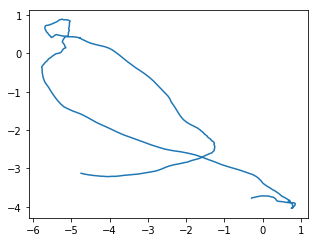

In [148]:
vlp = data_section_data[('vehicle_local_position',0)]
plt.figure(figsize=(5,5))
plt.plot(vlp['x'], vlp['y'])
# config the x-axis and y-axis with equal size
plt.gca().set_aspect('equal', adjustable='box')

### Check the result 
Comparing the result with the result achieved by pyulog

In [145]:
pu_data = ULog('./data/06_42_08.ulg')
for data in pu_data.data_list:
    print(data.name)

ekf2_timestamps
vehicle_status_flags
vehicle_rates_setpoint
vehicle_magnetometer
vehicle_local_position_setpoint
vehicle_local_position
vehicle_land_detected
vehicle_gps_position
vehicle_command
vehicle_attitude_setpoint
vehicle_attitude
vehicle_air_data
telemetry_status
trajectory_setpoint
system_power
sensor_preflight
sensor_combined
rate_ctrl_status
position_setpoint_triplet
manual_control_setpoint
input_rc
home_position
estimator_status
ekf_gps_drift
ekf2_innovations
cpuload
battery_status
battery_status
actuator_outputs
actuator_outputs
actuator_controls_0
vehicle_status
vehicle_global_position
mission_result


In [52]:
pu_data.get_dataset('vehicle_local_position').data.keys()

dict_keys(['timestamp', 'ref_timestamp', 'ref_lat', 'ref_lon', 'x', 'y', 'z', 'delta_xy[0]', 'delta_xy[1]', 'delta_z', 'vx', 'vy', 'vz', 'z_deriv', 'delta_vxy[0]', 'delta_vxy[1]', 'delta_vz', 'ax', 'ay', 'az', 'yaw', 'ref_alt', 'dist_bottom', 'dist_bottom_rate', 'eph', 'epv', 'evh', 'evv', 'vxy_max', 'vz_max', 'hagl_min', 'hagl_max', 'xy_valid', 'z_valid', 'v_xy_valid', 'v_z_valid', 'xy_reset_counter', 'z_reset_counter', 'vxy_reset_counter', 'vz_reset_counter', 'xy_global', 'z_global', 'dist_bottom_valid'])

In [51]:
pu_data.get_dataset('position_setpoint_triplet').data.keys()

dict_keys(['timestamp', 'previous.timestamp', 'previous.lat', 'previous.lon', 'previous.x', 'previous.y', 'previous.z', 'previous.vx', 'previous.vy', 'previous.vz', 'previous.alt', 'previous.yaw', 'previous.yawspeed', 'previous.loiter_radius', 'previous.pitch_min', 'previous.a_x', 'previous.a_y', 'previous.a_z', 'previous.acceptance_radius', 'previous.cruising_speed', 'previous.cruising_throttle', 'previous.valid', 'previous.type', 'previous.position_valid', 'previous.velocity_valid', 'previous.velocity_frame', 'previous.alt_valid', 'previous.yaw_valid', 'previous.yawspeed_valid', 'previous.landing_gear', 'previous.loiter_direction', 'previous.acceleration_valid', 'previous.acceleration_is_force', 'current.timestamp', 'current.lat', 'current.lon', 'current.x', 'current.y', 'current.z', 'current.vx', 'current.vy', 'current.vz', 'current.alt', 'current.yaw', 'current.yawspeed', 'current.loiter_radius', 'current.pitch_min', 'current.a_x', 'current.a_y', 'current.a_z', 'current.acceptance_

In [115]:
data_section_data.keys()

dict_keys([('mission_result', 0), ('vehicle_global_position', 0), ('vehicle_status', 0), ('actuator_controls_0', 0), ('actuator_outputs', 0), ('actuator_outputs', 1), ('battery_status', 0), ('battery_status', 1), ('cpuload', 0), ('ekf2_innovations', 0), ('ekf_gps_drift', 0), ('estimator_status', 0), ('home_position', 0), ('input_rc', 0), ('manual_control_setpoint', 0), ('position_setpoint_triplet', 0), ('rate_ctrl_status', 0), ('sensor_combined', 0), ('sensor_preflight', 0), ('system_power', 0), ('telemetry_status', 0), ('vehicle_air_data', 0), ('vehicle_attitude', 0), ('vehicle_attitude_setpoint', 0), ('vehicle_command', 0), ('vehicle_gps_position', 0), ('vehicle_land_detected', 0), ('vehicle_local_position', 0), ('vehicle_magnetometer', 0), ('vehicle_rates_setpoint', 0), ('vehicle_status_flags', 0), ('ekf2_timestamps', 0), ('trajectory_setpoint', 0), ('vehicle_local_position_setpoint', 0)])

In [116]:
data_section_data[('actuator_outputs', 1)]

{'timestamp': [92275457,
  92370489,
  92471905,
  92579440,
  92682489,
  92780244,
  92888665,
  92987485,
  93088671,
  93187485,
  93284251,
  93393488,
  93496624,
  93597915,
  93696627,
  93794330,
  93896486,
  93997917,
  94104486,
  94201485,
  94302701,
  94406654,
  94505491,
  94606668,
  94715200,
  94814491,
  94911443,
  95010486,
  95111419,
  95219942,
  95318486,
  95419749,
  95525488,
  95626487,
  95724757,
  95823493,
  95930486,
  96028655,
  96130487,
  96228718,
  96338493,
  96436488,
  96542318,
  96640485,
  96742143,
  96840489,
  96943938,
  97048484,
  97150486,
  97251494,
  97350494,
  97447916,
  97556264,
  97654485,
  97753013,
  97854493,
  97956276,
  98059486,
  98160755,
  98259487,
  98364488,
  98466298,
  98568487,
  98671488,
  98768488,
  98870674,
  98969486,
  99077486,
  99174652,
  99277491,
  99379141,
  99477496,
  99579093,
  99678487,
  99779829,
  99887443,
  99986487,
  100083982,
  100195902,
  100295452,
  100395486,
  100499487

In [118]:
pu_data.get_dataset('actuator_outputs', 1).data['timestamp']

array([ 92275457,  92370489,  92471905,  92579440,  92682489,  92780244,
        92888665,  92987485,  93088671,  93187485,  93284251,  93393488,
        93496624,  93597915,  93696627,  93794330,  93896486,  93997917,
        94104486,  94201485,  94302701,  94406654,  94505491,  94606668,
        94715200,  94814491,  94911443,  95010486,  95111419,  95219942,
        95318486,  95419749,  95525488,  95626487,  95724757,  95823493,
        95930486,  96028655,  96130487,  96228718,  96338493,  96436488,
        96542318,  96640485,  96742143,  96840489,  96943938,  97048484,
        97150486,  97251494,  97350494,  97447916,  97556264,  97654485,
        97753013,  97854493,  97956276,  98059486,  98160755,  98259487,
        98364488,  98466298,  98568487,  98671488,  98768488,  98870674,
        98969486,  99077486,  99174652,  99277491,  99379141,  99477496,
        99579093,  99678487,  99779829,  99887443,  99986487, 100083982,
       100195902, 100295452, 100395486, 100499487, 

In [143]:
# each data check the result
import logging
import colorlog
from colorlog import ColoredFormatter
# refer to https://github.com/borntyping/python-colorlog/blob/master/doc/example.py
def setup_logger():
    """Return a logger with a default ColoredFormatter."""
    formatter = ColoredFormatter(
        "%(log_color)s%(levelname)-8s%(reset)s %(blue)s%(message)s",
        datefmt=None,
        reset=True,
        log_colors={
            'DEBUG':    'cyan',
            'INFO':     'green',
            'WARNING':  'yellow',
            'ERROR':    'red',
            'CRITICAL': 'red',
        }
    )

    logger = logging.getLogger('example')
    handler = logging.StreamHandler()
    handler.setFormatter(formatter)
    logger.addHandler(handler)
    logger.setLevel(logging.DEBUG)

    return logger
logger = setup_logger()

def is_numeric(obj):
    attrs = ['__add__', '__sub__', '__mul__', '__truediv__', '__pow__']
    return all(hasattr(obj, attr) for attr in attrs)

for key, value in data_section_data.items():
    pu_according_data = pu_data.get_dataset(key[0], key[1]).data
    for key_item, value_item in value.items():
        info_str = '{0}->{1}'.format(key, key_item)
        try:
            if isinstance(pu_according_data[key_item], np.ndarray):
                dtype = pu_according_data[key_item].dtype
                value_item_np = np.array(value_item, dtype=dtype)
                equal = True
                if is_numeric(value_item_np):
                    # remove the nan number and infinitive number.
                    diff = np.abs(value_item_np - pu_according_data[key_item])
                    if not np.all(diff[~np.isnan(diff)] < 1e-4):
                        equal = False
                else:
                    if not np.all(value_item_np == pu_according_data[key_item]):
                        equal = False
                if equal:
                    logger.info(info_str + ' is equal')
                else:
                    logger.error(info_str + ' not equal {0} {1} '.format(len(value_item_np), 
                                                                       len(pu_according_data[key_item])))
        except KeyError:
            logger.debug(key_item)
            pass

f:\pyenvs\research\lib\site-packages\ipykernel_launcher.py:45: RuntimeWarning: invalid value encountered in subtract


[1] https://dev.px4.io/en/log/ulog_file_format.html

[2] https://github.com/PX4/pyulog

[3] https://docs.python.org/3/library/struct.html2

[4] https://www.w3.org/XML/

[5] https://github.com/borntyping/python-colorlog/blob/master/doc/example.py

[6] https://stackoverflow.com/questions/500328/identifying-numeric-and-array-types-in-numpy